# עבודת סיכום מס' 4

In [2]:
library(DBI)
library(odbc)
library(RSQLite)
library(dplyr)
library(ggplot2)

In [11]:
#sort(unique(odbcListDrivers()[[1]]))

In [12]:
#con <- dbConnect(odbc(), 
     #            Driver = "SQL Server", 
      #           Server = "DESKTOP-AAGNMGA\\SQLEXPRESS", 
       #          Database = "BoxOffice", 
        #         Trusted_Connection = "True")

In [13]:
 #movies_ff <- dbReadTable(con,"movies_ff_v")

In [14]:
 #save(movies_ff,file="C:/Users/Mayer/Documents/DataScience/data/BoxOffice_ff.RData")

In [2]:
 BoxOffice_ff <- load("C:/Users/Mayer/Documents/DataScience/data/BoxOffice_ff.RData")

In [24]:
head(movies_ff)

,movie_id,original_language,release_date,runtime_cat,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<dbl>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,1,en,2015-02-20,Short,93,14000000,6.575393,12314651,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2,en,2004-08-06,Medium,113,40000000,8.248895,95149435,1,0,...,0,0,0,0,0,0,3,0,0,1
3,3,en,2014-10-10,Medium,105,3300000,64.299990,13092000,1,1,...,0,1,0,0,0,0,2,0,0,0
4,4,hi,2012-03-09,Large,122,1200000,3.174936,16000000,0,1,...,0,0,0,0,0,0,0,0,0,0
5,5,ko,2009-02-05,Medium,118,0,1.148070,3923970,0,0,...,0,0,0,0,0,0,0,0,0,0
6,6,en,1987-08-06,Short,83,8000000,0.743274,3261638,1,0,...,0,0,0,0,0,0,0,0,0,0


# Exploratory data analysis - חלק 2 - בדיקת הנתונים

##  2.1 Descriptive Statistics for BoxOffice

In [17]:
report_path <- 'C:\\Users\\Mayer\\Documents\\DataScience\\stats\\report\\report.html'

In [25]:
summary(movies_ff)

    movie_id    original_language  release_date       runtime_cat       
 Min.   :   1   Length:7375        Length:7375        Length:7375       
 1st Qu.:1848   Class :character   Class :character   Class :character  
 Median :3696   Mode  :character   Mode  :character   Mode  :character  
 Mean   :3698                                                           
 3rd Qu.:5550                                                           
 Max.   :7398                                                           
                                                                        
    runtime          budget            popularity         revenue         
 Min.   :  0.0   Min.   :        0   Min.   :  0.000   Min.   :1.000e+00  
 1st Qu.: 94.0   1st Qu.:        0   1st Qu.:  3.970   1st Qu.:2.405e+06  
 Median :104.0   Median :  8000000   Median :  7.456   Median :1.693e+07  
 Mean   :107.7   Mean   : 22666657   Mean   :  8.540   Mean   :6.688e+07  
 3rd Qu.:118.0   3rd Qu.: 29000000   3rd 

In [19]:
rapply(movies_ff,function(x)length(unique(x)))

movie_id            original_language 
                        7375                           44 
                release_date                  runtime_cat 
                        4697                            3 
                     runtime                       budget 
                         168                          704 
                  popularity                      revenue 
                        7371                         2845 
                  sw_lang_en              sw_web_presence 
                           2                            2 
               sw_has_poster                   sw_tagline 
                           2                            2 
                release_year                release_month 
                          99                           13 
          high_release_month                  release_day 
                           2                           32 
                 seasonality                sw_collection 
                          13                            3 
               producers_cnt                countries_cnt 
                          25                           12 
                     lang_US                      lang_FR 
                           2                            2 
                     lang_RU                      lang_ES 
                           2                            2 
                     lang_JA                 keywords_cnt 
                           2                           46 
           actor0_movies_cnt         actor0_movies_5y_cnt 
                          61                           17 
           actor1_movies_cnt         actor1_movies_5y_cnt 
                          59                           18 
           actor2_movies_cnt         actor2_movies_5y_cnt 
                          53                           16 
            sw_female_actor0             sw_female_actor1 
                           3                            3 
            sw_female_actor2               sw_male_actor0 
                           3                            3 
              sw_male_actor1               sw_male_actor2 
                           3                            3 
         actor0_prev_revenue          actor1_prev_revenue 
                        1152                         1265 
         actor2_prev_revenue          director_movies_cnt 
                        1341                           30 
      director_movies_5y_cnt              genre_adventure 
                           7                            2 
               genre_fantasy              genre_animation 
                           2                            2 
                 genre_drama                 genre_horror 
                           2                            2 
                genre_action                 genre_comedy 
                           2                            2 
               genre_history                genre_western 
                           2                            2 
              genre_thriller                  genre_crime 
                           2                            2 
           genre_documentary        genre_science_fiction 
                           2                            2 
               genre_mystery                  genre_music 
                           2                            2 
               genre_romance                 genre_family 
                           2                            2 
                   genre_war                genre_foreign 
                           2                            2 
                  depart_Art                depart_Camera 
                          35                           24 
                 depart_Crew           depart_Custom_Mkup 
                          51                           28 
            depart_Directing               depart_Editing 
                          24                           17 
        

In [11]:
#install.packages("pastecs")
library(pastecs)
options(scipen=100)
options(digits=2)
stat.desc(movies_ff[,5:84], basic=TRUE, desc=TRUE, norm=FALSE, p=0.95)

,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,sw_has_poster,sw_tagline,release_year,release_month,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
nbr.val,7370.00,7375.0,7375.000000,2993.0,7375.0000,7375.0000,7375.00000,7375.0000,7374.0000,7374.000,...,7341.0000,7341.0000,7341.0000,7341.0000,7341.0000,7341.00000,7341.000,7341.0000,7341.0000,7341.0000
nbr.null,19.00,2012.0,0.000000,0.0,1039.0000,5012.0000,2.00000,1442.0000,0.0000,0.000,...,7194.0000,6971.0000,5293.0000,6297.0000,6516.0000,7336.00000,3872.000,6840.0000,7281.0000,6578.0000
nbr.na,5.00,0.0,0.000000,4382.0,0.0000,0.0000,0.00000,0.0000,1.0000,1.000,...,34.0000,34.0000,34.0000,34.0000,34.0000,34.00000,34.000,34.0000,34.0000,34.0000
min,0.00,0.0,0.000001,1.0,0.0000,0.0000,0.00000,0.0000,1918.0000,1.000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.00000,0.000,0.0000,0.0000,0.0000
max,338.00,380000000.0,547.488298,1519557910.0,1.0000,1.0000,1.00000,1.0000,2017.0000,12.000,...,3.0000,10.0000,6.0000,4.0000,5.0000,1.00000,12.000,6.0000,2.0000,5.0000
range,338.00,380000000.0,547.488297,1519557909.0,1.0000,1.0000,1.00000,1.0000,99.0000,11.000,...,3.0000,10.0000,6.0000,4.0000,5.0000,1.00000,12.000,6.0000,2.0000,5.0000
sum,794097.00,167166594664.0,62980.853408,200169779760.0,6336.0000,2363.0000,7373.00000,5933.0000,14745625.0000,50471.000,...,150.0000,473.0000,2595.0000,1127.0000,893.0000,5.00000,6898.000,581.0000,62.0000,912.0000
median,104.00,8000000.0,7.455875,16928137.0,1.0000,0.0000,1.00000,1.0000,2004.0000,7.000,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.00000,0.000,0.0000,0.0000,0.0000
mean,107.75,22666656.9,8.539777,66879311.6,0.8591,0.3204,0.99973,0.8045,1999.6779,6.844,...,0.0204,0.0644,0.3535,0.1535,0.1216,0.00068,0.940,0.0791,0.0084,0.1242


###  2.2 Plots

Warning message:
"Ignoring unknown parameters: main"


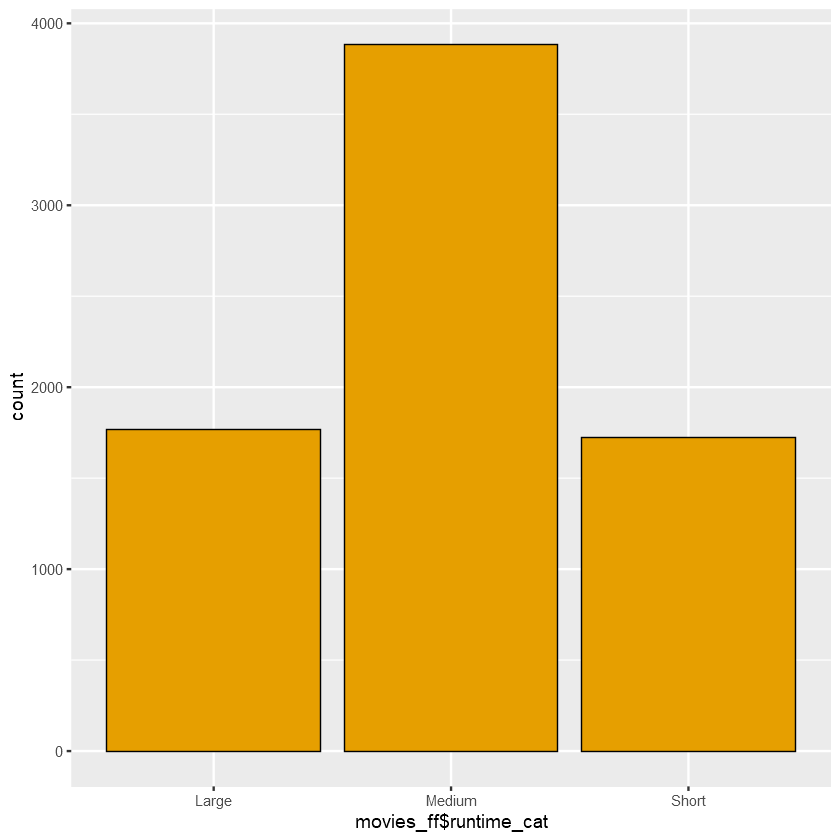

In [5]:
#Runtime_cat
ggplot(movies_ff, aes(movies_ff$runtime_cat)) +
  geom_bar(fill = "#E69F00",color = "black",size = 0.3, main = "runtime_cat")  + theme_get()
options(repr.plot.width = 8, repr.plot.height = 4)

### Runtime Analysis

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
"Removed 5 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 5 rows containing non-finite values (stat_density)."


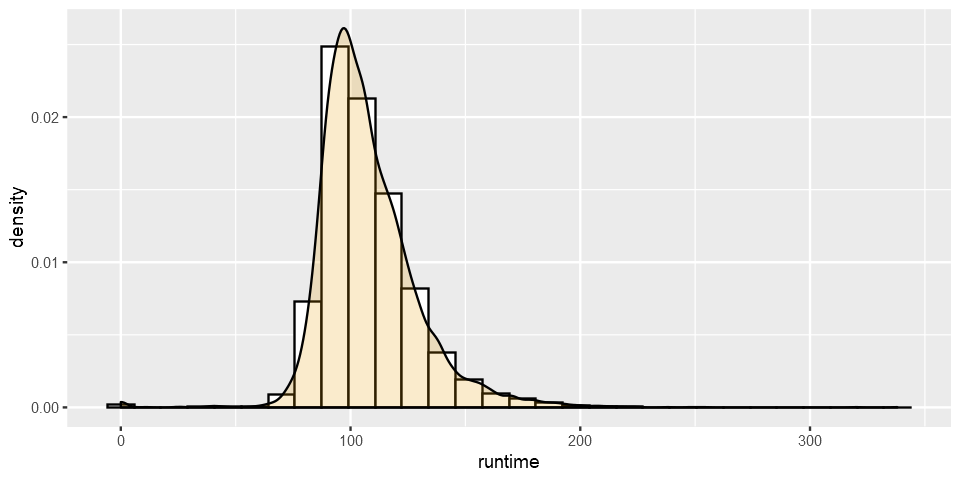

In [51]:
# Runtime
ggplot(movies_ff, aes(x=runtime)) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white")+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()
options(repr.plot.width = 10, repr.plot.height = 4)

Warning message:
"Removed 5 rows containing missing values (geom_point)."


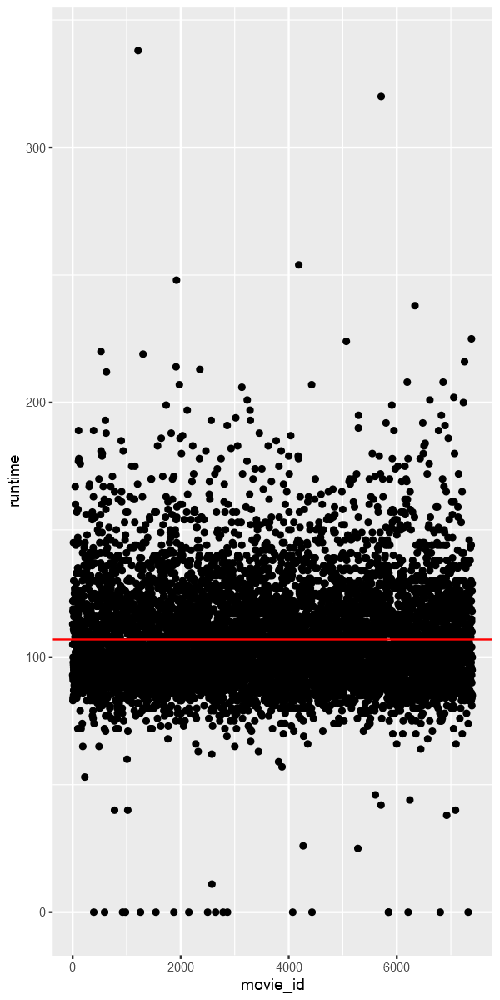

In [68]:
#Runtime Outliers
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=runtime)) +
    geom_hline(yintercept = 107 ,color="red")

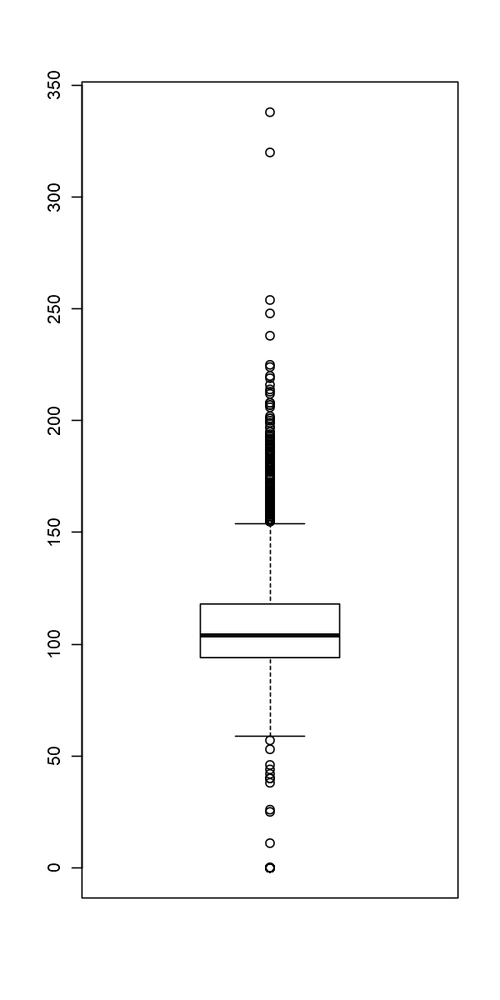

In [93]:
out_runtime <- boxplot(movies_ff$runtime)
options(repr.plot.width = 5, repr.plot.height =10)

In [94]:
head(out_runtime$out) # outlier
min(out_runtime$out) #  minimum outlier
max(out_runtime$out)
median(out_runtime$out)
mean(out_runtime$out)
length(out_runtime$out)

[1] 167 160 157 158 177 189

[1] 0

[1] 338

[1] 165

[1] 156.1127

[1] 275

### Budget Analysis

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
"Removed 2012 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 2012 rows containing non-finite values (stat_density)."


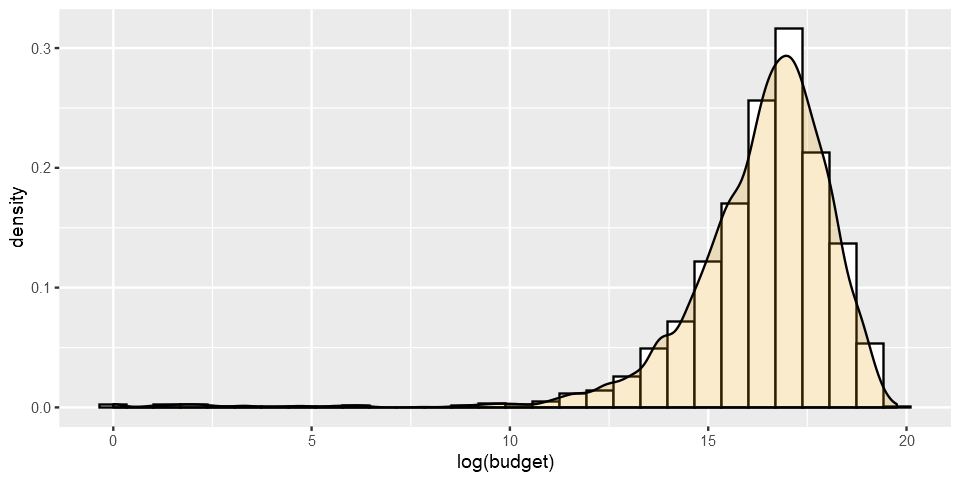

In [29]:
# Budget
ggplot(movies_ff, aes(x=log(budget))) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white")+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()
options(repr.plot.width = 5, repr.plot.height = 3)

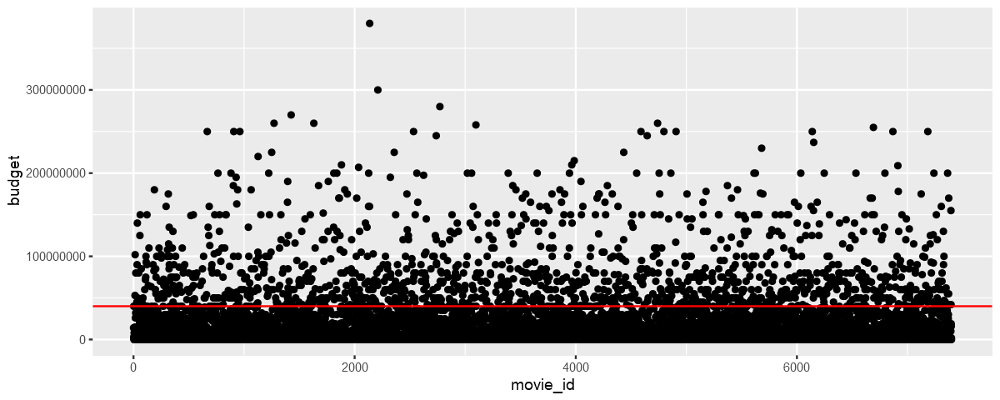

In [56]:
#Budget Outliers
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=budget)) +
    geom_hline(yintercept = 40000000 ,color="red")

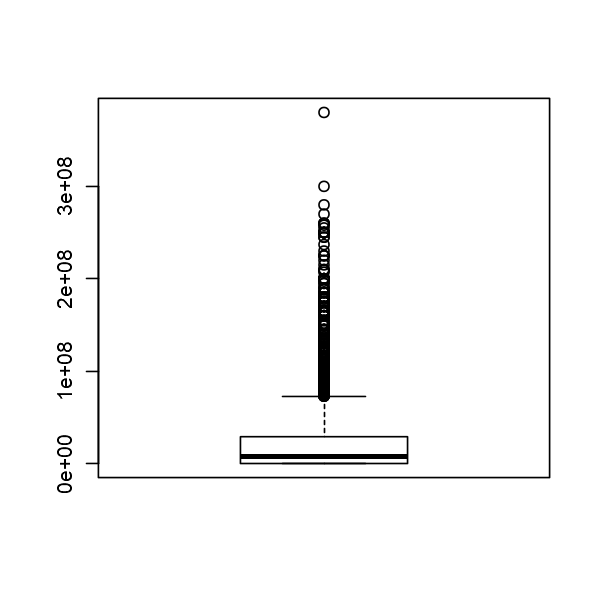

In [91]:
out_budget <- boxplot(movies_ff$budget)
options(repr.plot.width = 5, repr.plot.height =10)

In [92]:
head(out_budget$out) # outlier
min(out_budget$out) #  minimum outlier
max(out_budget$out) 
median(out_budget$out)
mean(out_budget$out)
length(out_budget$out)

[1] 1.02e+08 8.00e+07 9.00e+07 1.40e+08 8.00e+07 1.25e+08

[1] 7.3e+07

[1] 3.8e+08

[1] 1.05e+08

[1] 121655977

[1] 624

### Original_language Analysis

In [72]:
table(movies_ff$original_language)


  af   ar   bm   bn   ca   cn   cs   da   de   el   en   es   fa   fi   fr   he 
   1    1    2    3    1   41    3   17   49    3 6336   95    5    3  199    6 
  hi   hu   id   is   it   ja   ka   kn   ko   ml   mr   nb   nl   no   pl   pt 
 118    4    3    1   55   90    1    1   48   12    1    1   11    5    5   13 
  ro   ru   sr   sv   ta   te   th   tr   ur   vi   xx   zh 
   8  105    3   20   31    9    5    9    2    1    2   46 

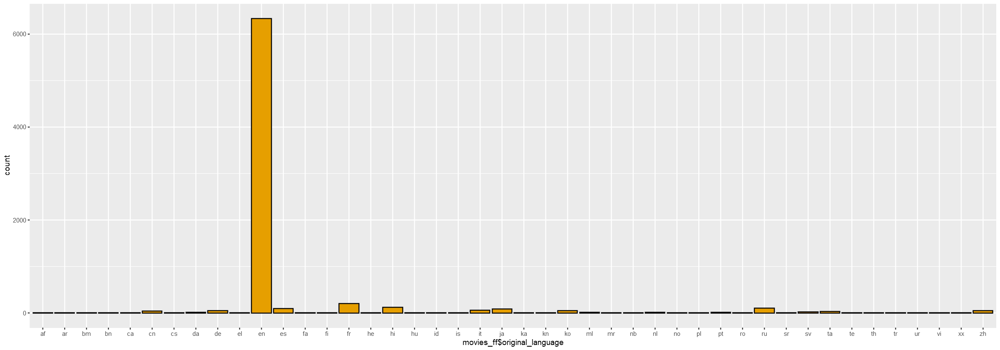

In [20]:
#Original_language
ggplot(movies_ff, aes(movies_ff$original_language)) +
  geom_bar(color = "black", fill = "#E69F00")  + theme_get()
options(repr.plot.width = 20, repr.plot.height = 7)

### Popularity Analysis

Warning message in sqrt(log(popularity)):
"NaNs produced"
Warning message in sqrt(log(popularity)):
"NaNs produced"
Warning message in sqrt(log(popularity)):
"NaNs produced"
`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
"Removed 573 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 573 rows containing non-finite values (stat_density)."


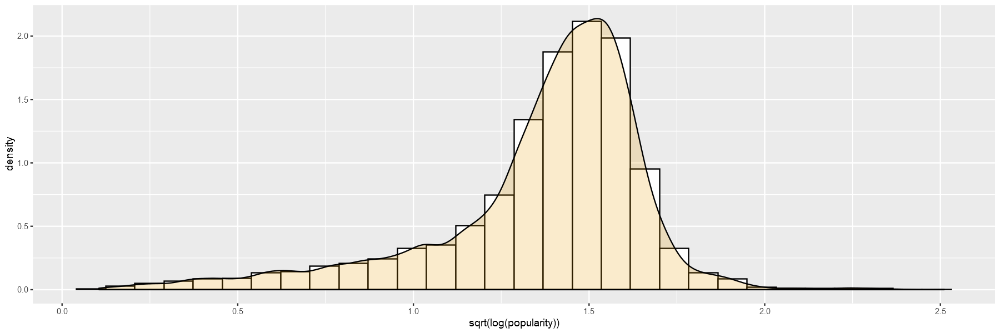

In [18]:
#Popularity
ggplot(movies_ff, aes(sqrt(log(popularity)))) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white")+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()

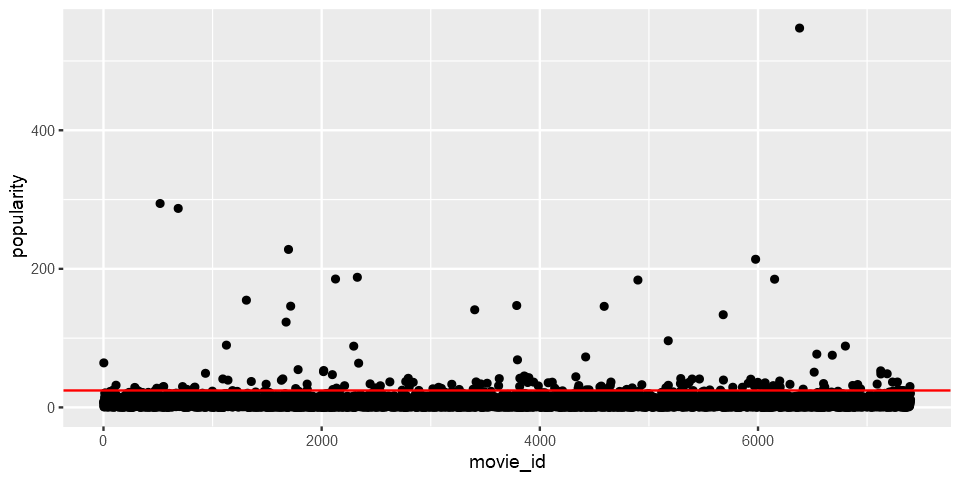

In [25]:
#Popularity Outliers
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=popularity)) +
    geom_hline(yintercept = 25 ,color="red")

In [28]:
#Popularity Outliers
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=popularity)) +
    geom_hline(yintercept = 25 ,color)

Warning message in geom_hline(yintercept = 25, color):
"Using both `yintercept` and `mapping` may not have the desired result as mapping is overwritten if `yintercept` is specified
"


ERROR: Error in file(con, "rb"): cannot open the connection


plot without title

In [29]:
head(movies_ff)

,movie_id,original_language,release_date,runtime_cat,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<dbl>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,1,en,2015-02-20,Short,93,14000000,6.575393,12314651,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2,en,2004-08-06,Medium,113,40000000,8.248895,95149435,1,0,...,0,0,0,0,0,0,3,0,0,1
3,3,en,2014-10-10,Medium,105,3300000,64.299990,13092000,1,1,...,0,1,0,0,0,0,2,0,0,0
4,4,hi,2012-03-09,Large,122,1200000,3.174936,16000000,0,1,...,0,0,0,0,0,0,0,0,0,0
5,5,ko,2009-02-05,Medium,118,0,1.148070,3923970,0,0,...,0,0,0,0,0,0,0,0,0,0
6,6,en,1987-08-06,Short,83,8000000,0.743274,3261638,1,0,...,0,0,0,0,0,0,0,0,0,0


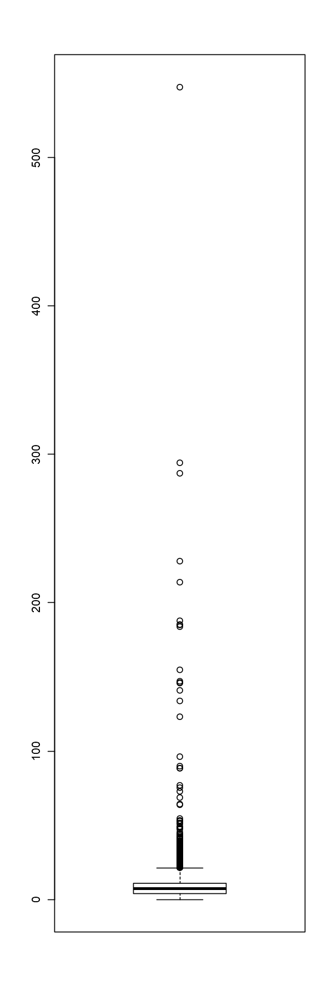

In [89]:
out_popularity <- boxplot(movies_ff$popularity)
options(repr.plot.width = 5, repr.plot.height =5)

In [90]:
head(out_popularity$out) # outlier
min(out_popularity$out) #  minimum outlier
max(out_popularity$out) #  maximum outlier
median(out_popularity$out)
mean(out_popularity$out)
length(out_popularity$out)

[1] 64.29999 23.06508 25.26187 32.07073 21.79111 28.92084

[1] 21.46346

[1] 547.4883

[1] 30.12129

[1] 46.8045

[1] 201

### Revenue Analysis

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
"Removed 4382 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."


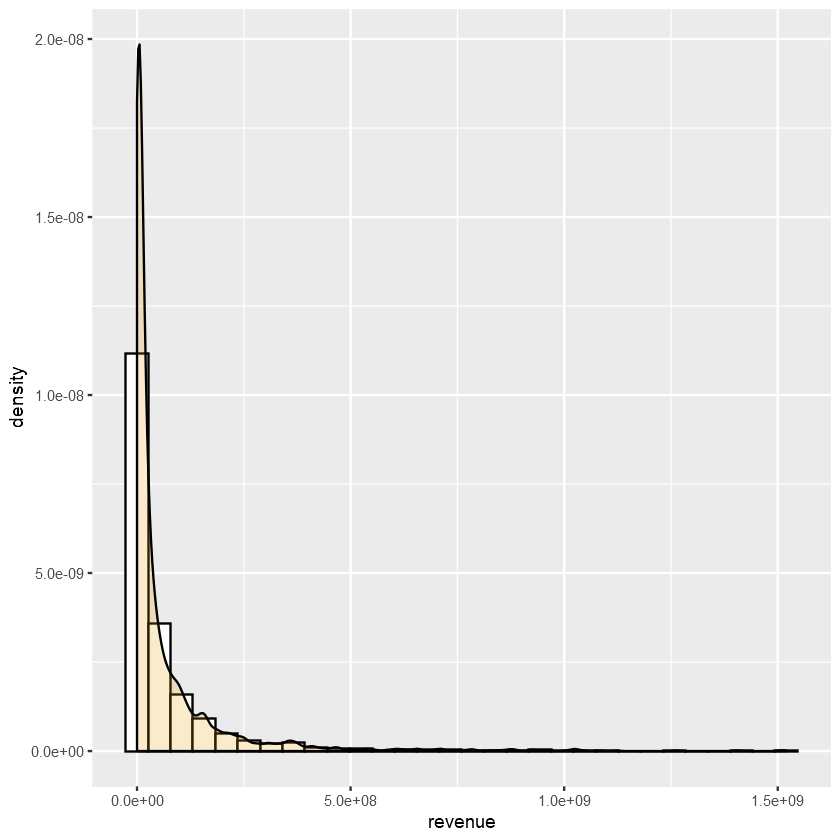

In [3]:
ggplot(movies_ff, aes(x=revenue)) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white")+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()


`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.

Warning message:
"Removed 4382 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."


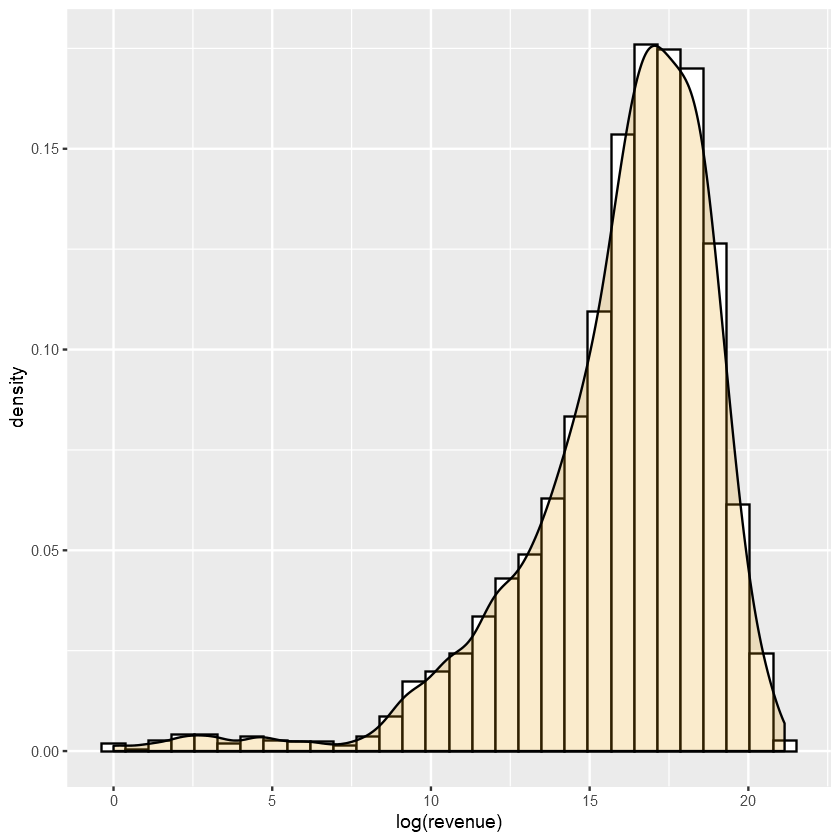

In [4]:
# Revenue
ggplot(movies_ff, aes(x=log(revenue))) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white")+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()
options(repr.plot.width = 15, repr.plot.height = 9)

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


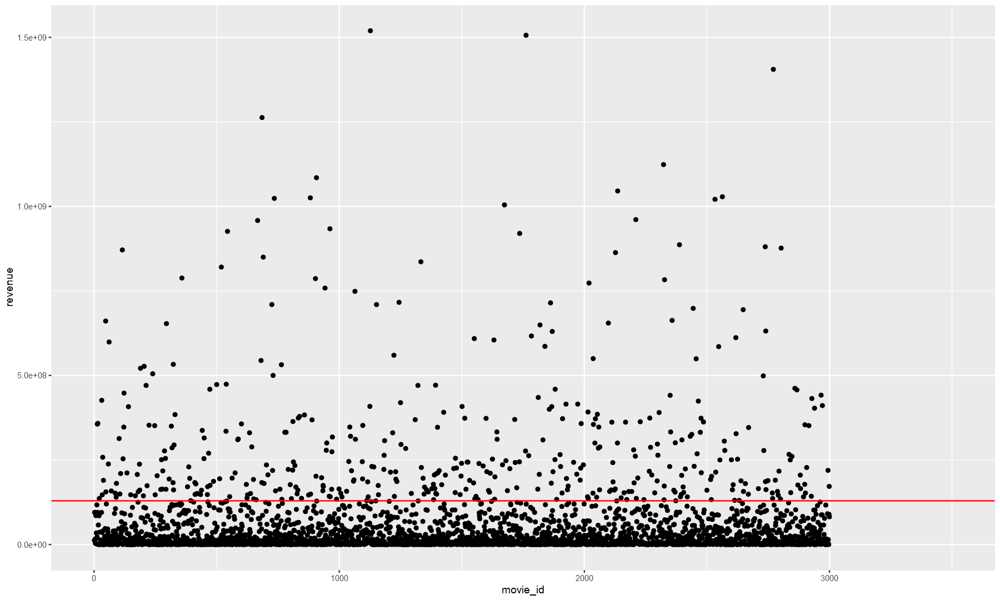

In [5]:
#Revenue Outliers
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=revenue)) + 
    xlim (0,3500) +
    geom_hline(yintercept = 130000000 ,color="red")

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


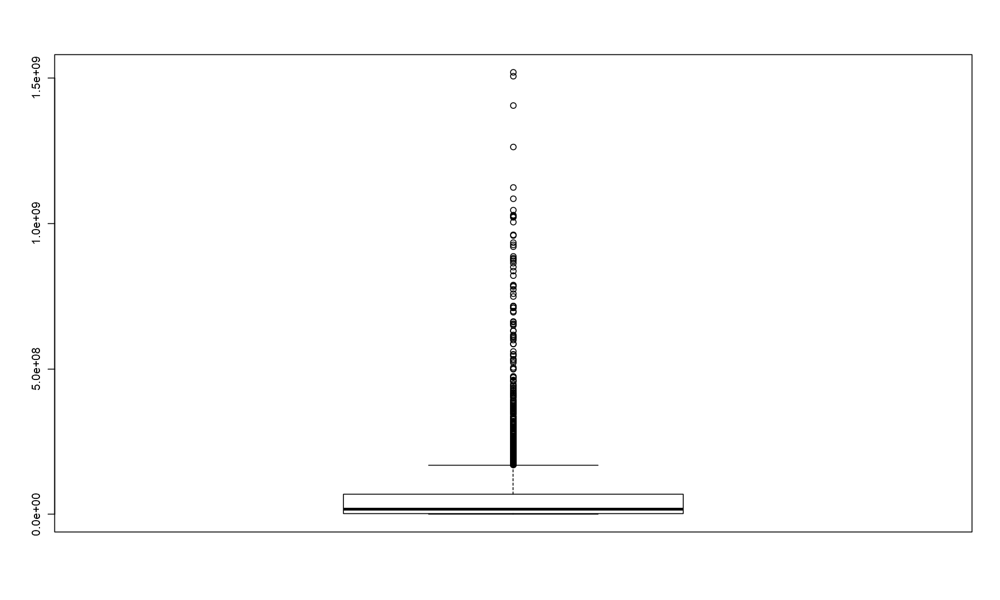

In [6]:
out_revenue <- boxplot(movies_ff$revenue)
options(repr.plot.width = 5, repr.plot.height =15)

In [7]:
head(out_revenue$out) # outlier
min(out_revenue$out) #  minimum outlier
max(out_revenue$out) #  maximum outlier
median(out_revenue$out)
mean(out_revenue$out)
length(out_revenue$out)

[1] 356296601 358372926 426480871 258022233 189859560 660940780

[1] 169852759

[1] 1519557910

[1] 288752301

[1] 376550319

[1] 315

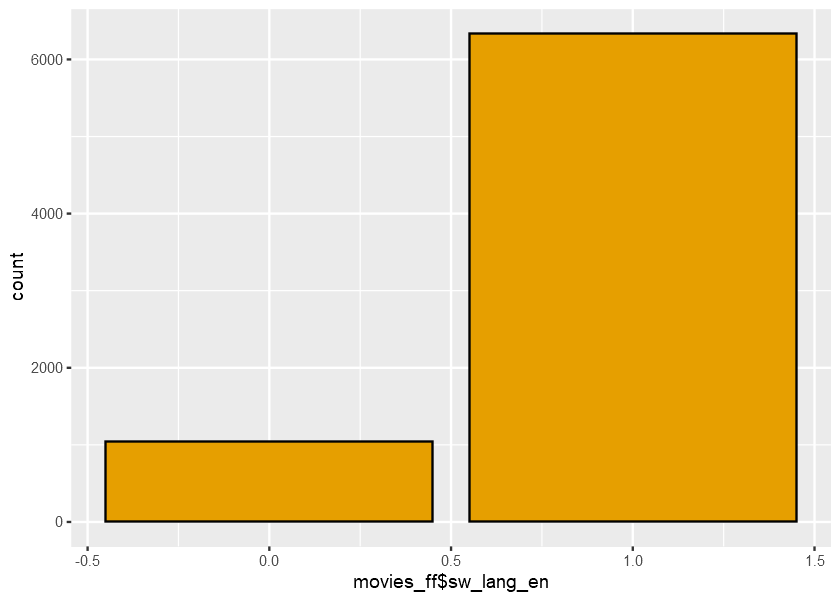

In [43]:
# sw_lang_en
ggplot(movies_ff, aes(movies_ff$sw_lang_en)) + 
    geom_bar(color = "black", fill = "#E69F00")  + 
    theme_get()
   options(repr.plot.width = 7, repr.plot.height = 5)

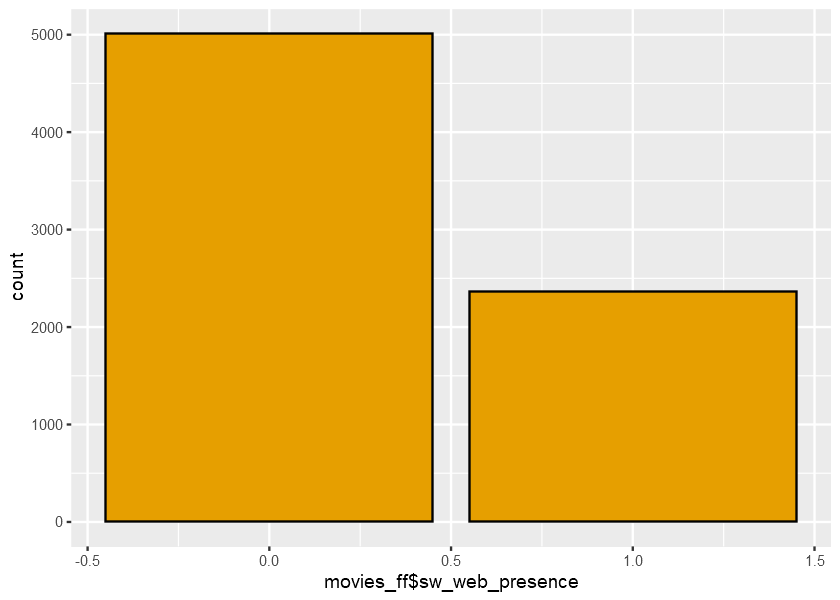

In [71]:
# sw_web_presence
ggplot(movies_ff, aes(movies_ff$sw_web_presence)) + 
    geom_bar(color = "black", fill = "#E69F00")  + 
    theme_get()
   options(repr.plot.width = 7, repr.plot.height = 5)

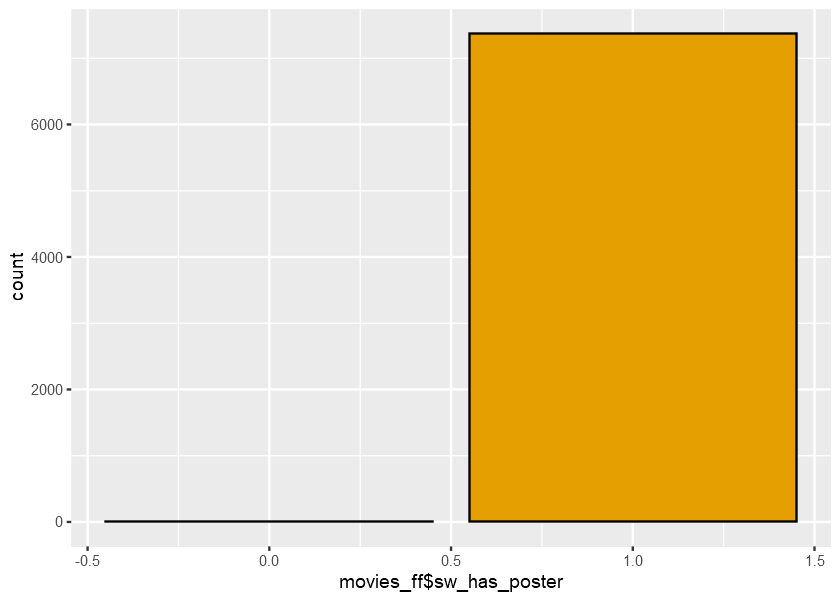

In [46]:
# sw_has_poster
ggplot(movies_ff, aes(movies_ff$sw_has_poster)) + 
    geom_bar(color = "black", fill = "#E69F00")  + 
    theme_get()
   options(repr.plot.width = 7, repr.plot.height = 5)

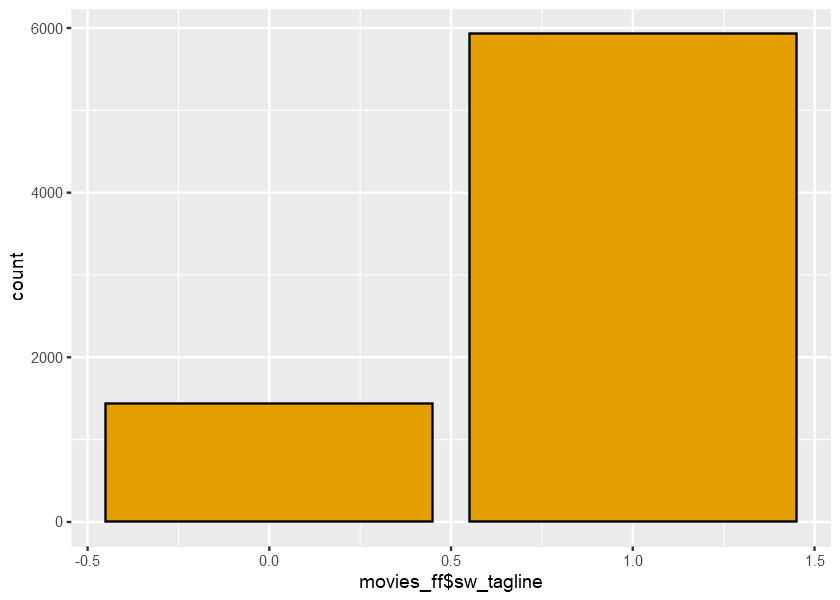

In [48]:
# sw_tagline
ggplot(movies_ff, aes(movies_ff$sw_tagline)) + 
    geom_bar(color = "black", fill = "#E69F00")  + 
    theme_get()
   options(repr.plot.width = 7, repr.plot.height = 5)

### Release Date Analysis

Warning message:
"Removed 1 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 1 rows containing non-finite values (stat_density)."


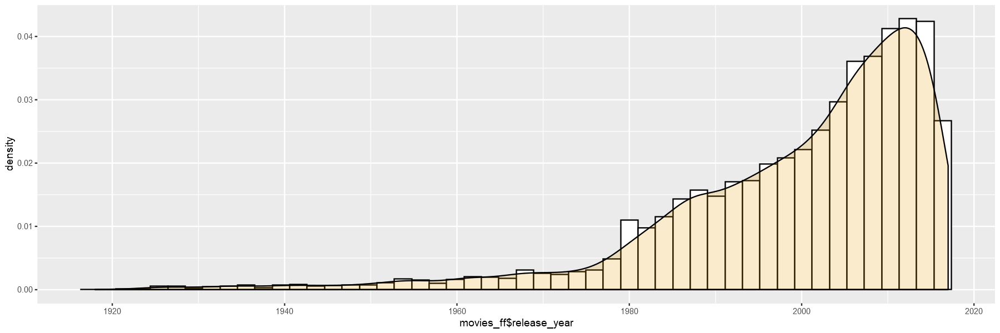

In [77]:
# release_year
ggplot(movies_ff, aes(x=movies_ff$release_year)) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()
options(repr.plot.width = 15, repr.plot.height = 5)

Warning message:
"Removed 1 rows containing non-finite values (stat_count)."


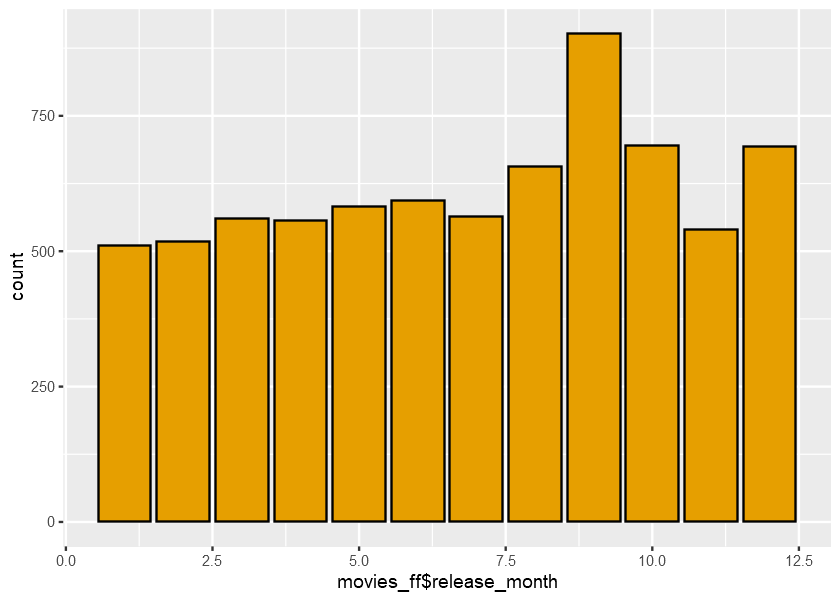

In [78]:
# release_month
ggplot(movies_ff, aes(movies_ff$release_month)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()+
    geom_hline(yintercept =  mean(movies_ff$release_month),na.rm=T,col="red")
   options(repr.plot.width = 7, repr.plot.height = 5)


  1   2   3   4   5   6   7   8   9  10  11  12 
510 518 561 557 582 594 564 657 902 695 540 694 

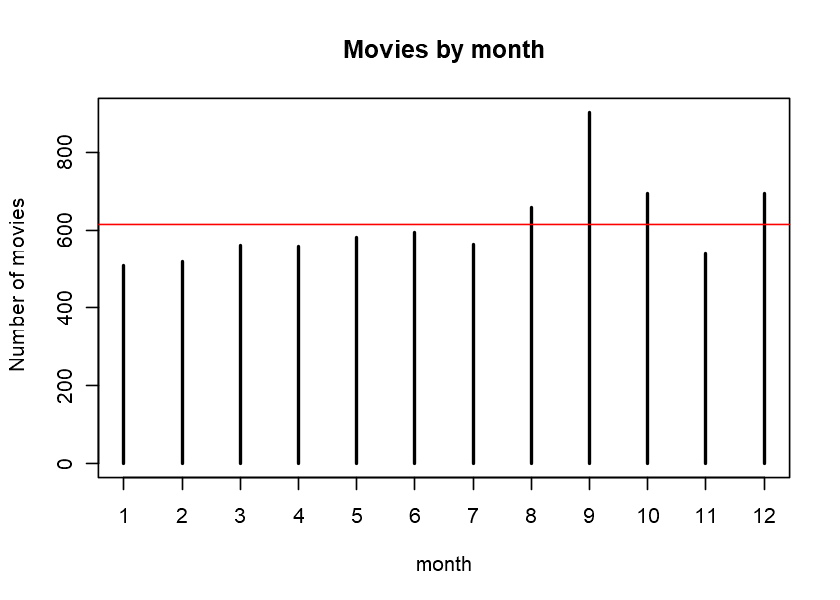

In [89]:
table(movies_ff$release_month)
plot(table(movies_ff$release_month), ylab="Number of movies",xlab="month",main="Movies by month")
abline(h=mean(table(movies_ff$release_month),na.rm = TRUE),col="red")

Warning message:
"Removed 1 rows containing non-finite values (stat_count)."


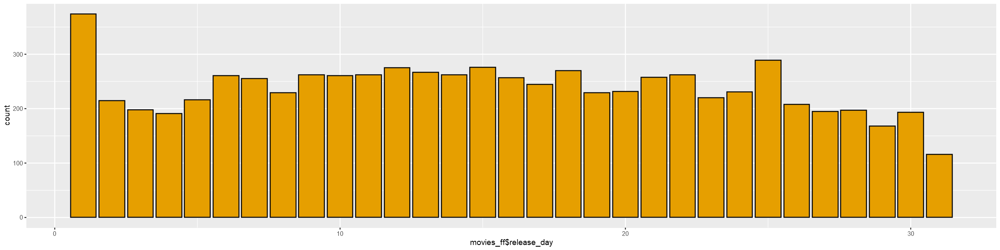

In [104]:
# release_day
ggplot(movies_ff, aes(movies_ff$release_day)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 20, repr.plot.height = 5)


  1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19  20 
374 215 198 191 216 261 255 229 262 261 262 275 267 262 276 257 245 270 229 232 
 21  22  23  24  25  26  27  28  29  30  31 
258 262 220 231 289 208 195 197 168 193 116 

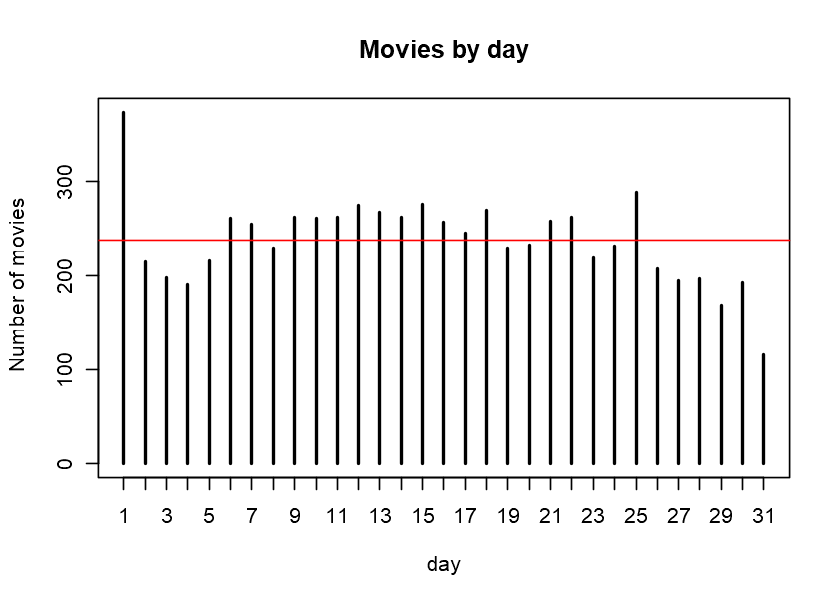

In [91]:
table(movies_ff$release_day)
plot(table(movies_ff$release_day), ylab="Number of movies",xlab="day",main="Movies by day")
abline(h=mean(table(movies_ff$release_day),na.rm = TRUE),col="red")

### Seasonality Analysis

Warning message:
"Removed 1 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 1 rows containing non-finite values (stat_density)."


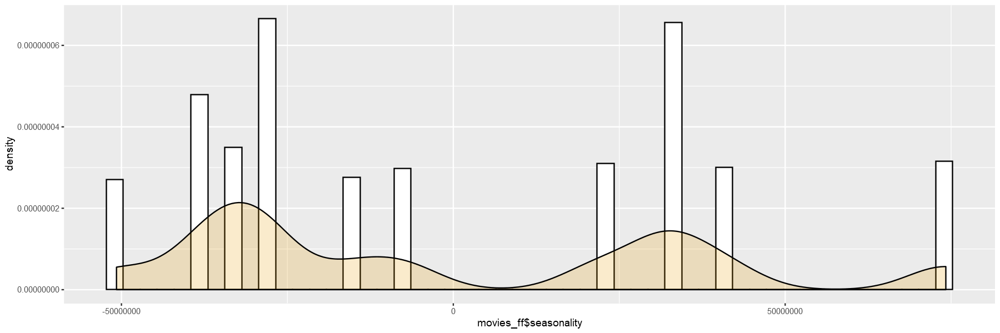

In [138]:
# seasonality
ggplot(movies_ff, aes(x=movies_ff$seasonality)) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()

In [145]:
movie.time <- movies_ff %>% 
    mutate(release_year,release_month) %>%
    group_by(release_year,release_month) %>%
    summarise(n=n(),revenue_mean=mean(revenue,na.rm=T)) %>%
    select(release_year,release_month,n,revenue_mean) %>%
    filter(between(release_year,1985,2016))

movie.time$revenue_mean <- ifelse(is.na(movie.time$revenue_mean),0,movie.time$revenue_mean)

movie.ts <- ts(movie.time$revenue_mean, start = c(1995, 1), end=c(2016,12), frequency = 12)

In [148]:
movie.ts

,Jan,Feb,Mar,Apr,May,Jun,Jul,Aug,Sep,Oct,Nov,Dec
1995,7,27233140,20325078,390659,102655171,43092109,35269132,9014279,10609321,5818146,20032287,40555964
1996,0,15377563,43077666,5239644,102281980,34245468,45464460,19927038,750000,46838412,36949300,35539822
1997,3200000,9518342,47771934,46682407,4738953,89026107,28382331,31309195,88981269,13119518,11294901,55617613
1998,5943231,26998319,22785921,12120007,142984274,127698510,11404671,10552278,2252640,14481664,30978712,76231706
1999,12404204,31613134,15869677,35859929,237182311,134387126,80806356,5422857,39485040,85983742,139434862,31589510
2000,17030246,15090574,1305887,15774500,66171445,120099325,505000000,40747115,2244231,42088087,172364257,43665526
2001,6853159,47364375,65595485,14306524,34356941,207845079,30102717,7332090,11078252,707701,198461,2358239
2002,21621000,0,128423253,35869301,41940207,229025794,31823577,15394379,24993547,11864944,114758510,107764097
2003,5491903,83964186,9656091,9730837,46769121,203906638,80976750,9459298,24768048,40119046,40093966,33268915
2004,1653565,31836719,91361221,11733804,6918587,406287050,184127456,0,18346899,8112656,60912004,59239151


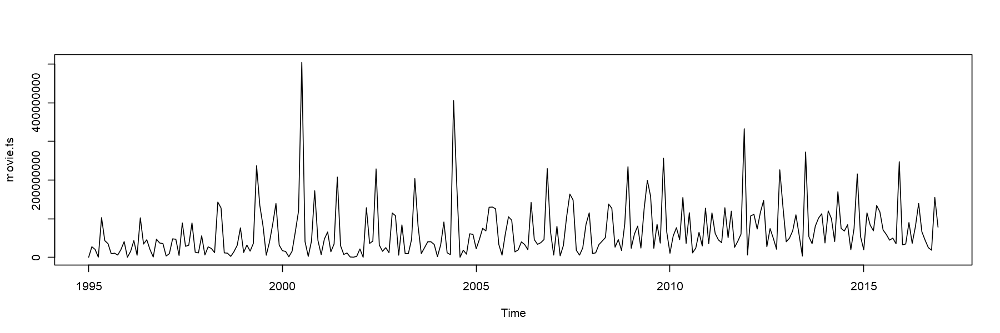

In [150]:
plot(movie.ts)

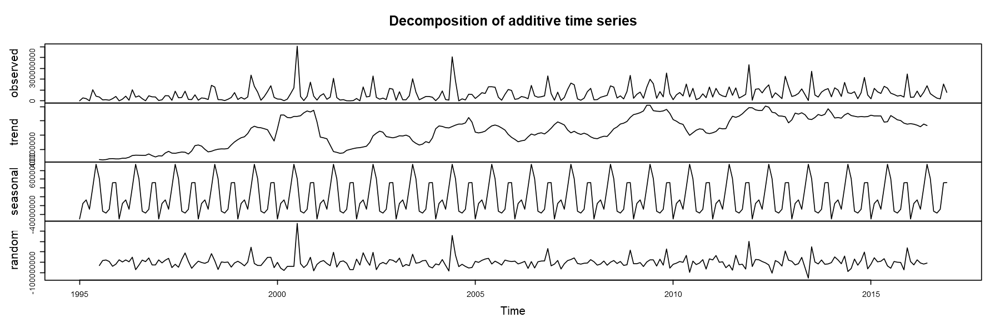

In [152]:
plot(decompose(movie.ts))

In [159]:
movie.dec <- decompose(movie.ts)
head(movie.dec$seasonal)
montly_trend <- data.frame(month=c(1:12),season=movie.dec$seasonal[1:12]) # season=movie.dec$seasonal[1:12]) ts is matrix since we want only the first line we take the first 12 varibles 
montly_trend

[1] -50832969 -15414392  -7254937 -28510946  21652661  74099998

month,season
<int>,<dbl>
1,-50832969
2,-15414392
3,-7254937
4,-28510946
5,21652661
6,74099998
7,41133257
8,-33067831
9,-37243111


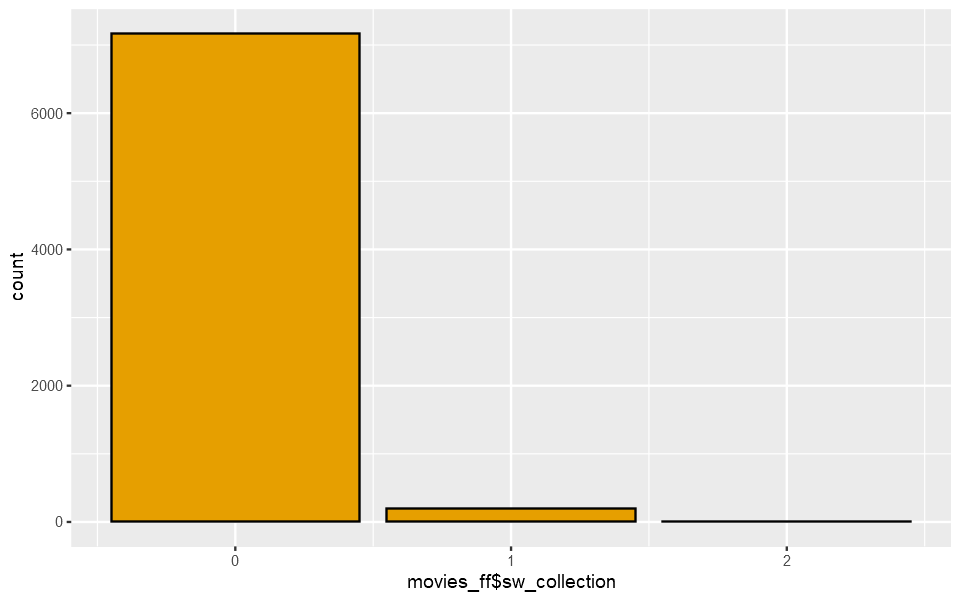

In [122]:
# sw_collection
ggplot(movies_ff, aes(movies_ff$sw_collection)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### producers_cnt Analysis

Warning message:
"Removed 395 rows containing non-finite values (stat_count)."


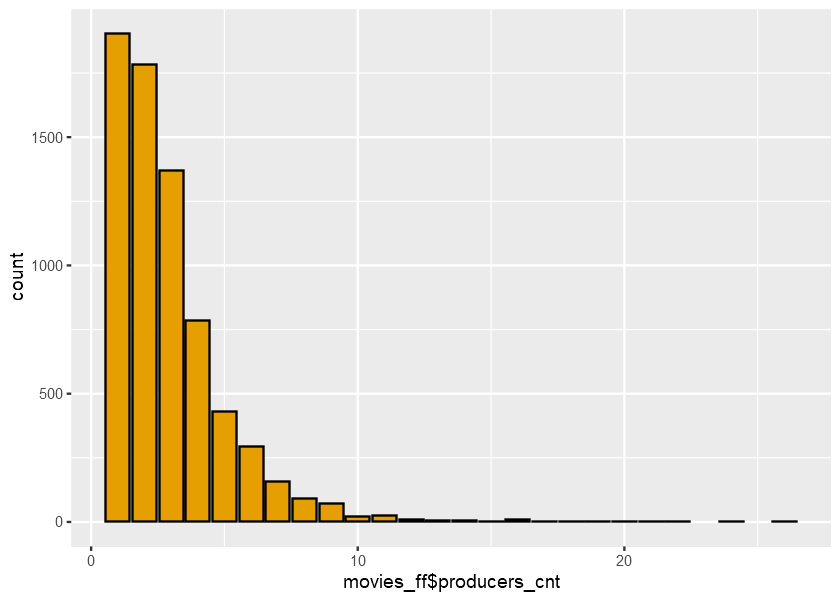

In [93]:
# producers_cnt
ggplot(movies_ff, aes(movies_ff$producers_cnt)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

Warning message:
"Removed 395 rows containing missing values (geom_point)."


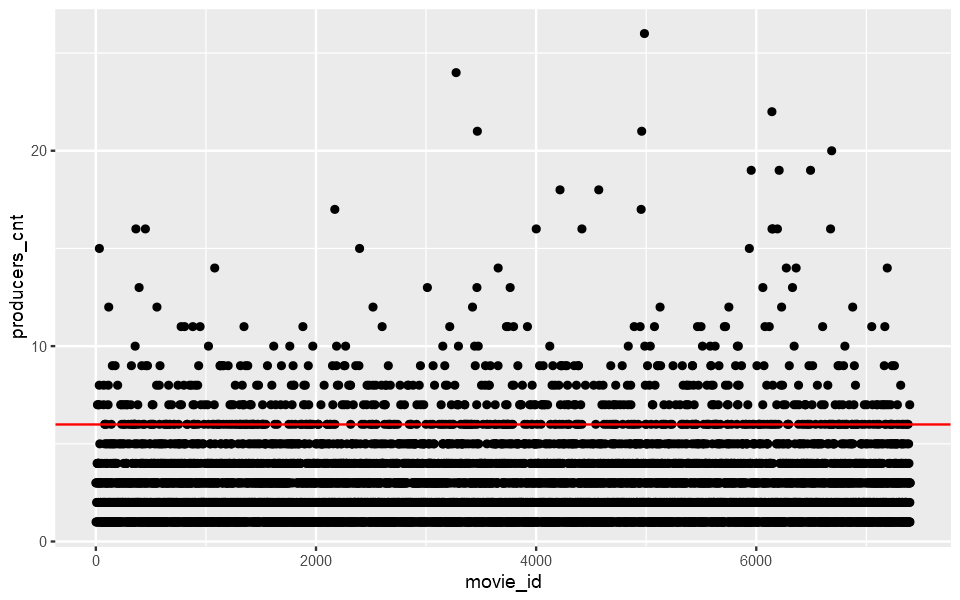

In [101]:
#producers_cnt Outliers
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=producers_cnt)) + 
    geom_hline(yintercept = 6 ,color="red")

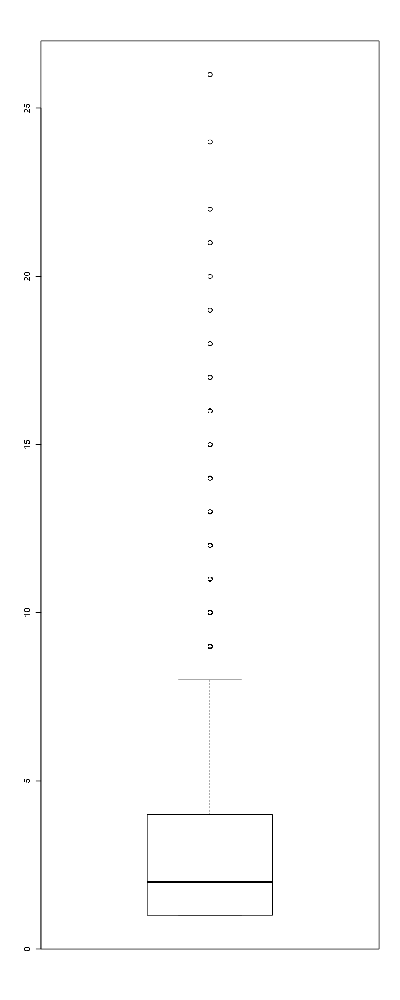

In [85]:
out_producers_cnt <- boxplot(movies_ff$producers_cnt)
options(repr.plot.width = 5, repr.plot.height = 5)

In [86]:
head(out_producers_cnt$out) # outlier
min(out_producers_cnt$out) #  minimum outlier
max(out_producers_cnt$out) #  maximum outlier
median(out_producers_cnt$out)
mean(out_producers_cnt$out)
length(out_producers_cnt$out)

[1] 15 12  9  9  9 10

[1] 9

[1] 26

[1] 10

[1] 11.21472

[1] 163

### countries_cnt Analysis

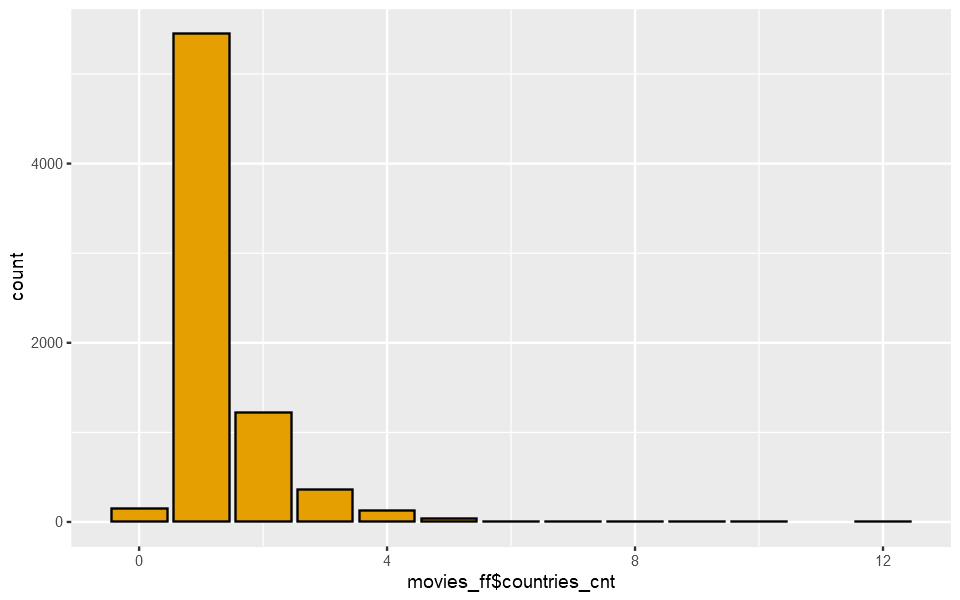

In [134]:
# countries_cnt
ggplot(movies_ff, aes(movies_ff$countries_cnt)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

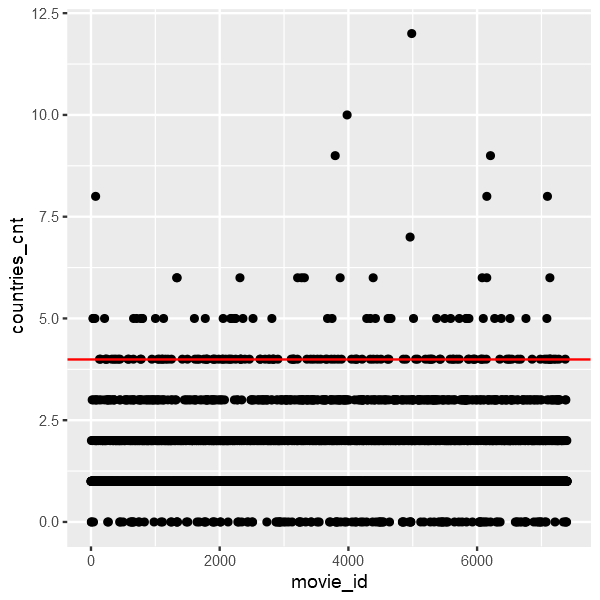

In [110]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=countries_cnt)) + 
    geom_hline(yintercept = 4 ,color="red")

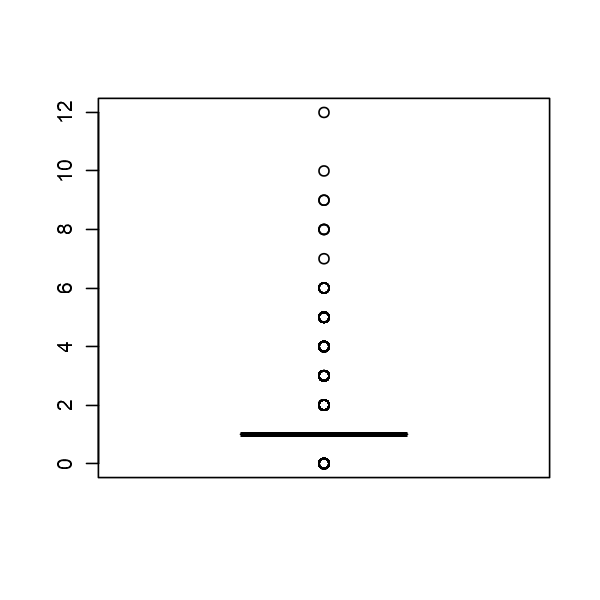

In [83]:
out_countries_cnt <- boxplot(movies_ff$countries_cnt)
options(repr.plot.width = 8, repr.plot.height = 20)

In [84]:
head(out_countries_cnt$out) # outlier head list
min(out_countries_cnt$out) #  minimum outlier
max(out_countries_cnt$out) #  maximum outlier
median(out_countries_cnt$out)
mean(out_countries_cnt$out)
length(out_countries_cnt$out)

[1] 0 2 0 3 2 2

[1] 0

[1] 12

[1] 2

[1] 2.284971

[1] 1923

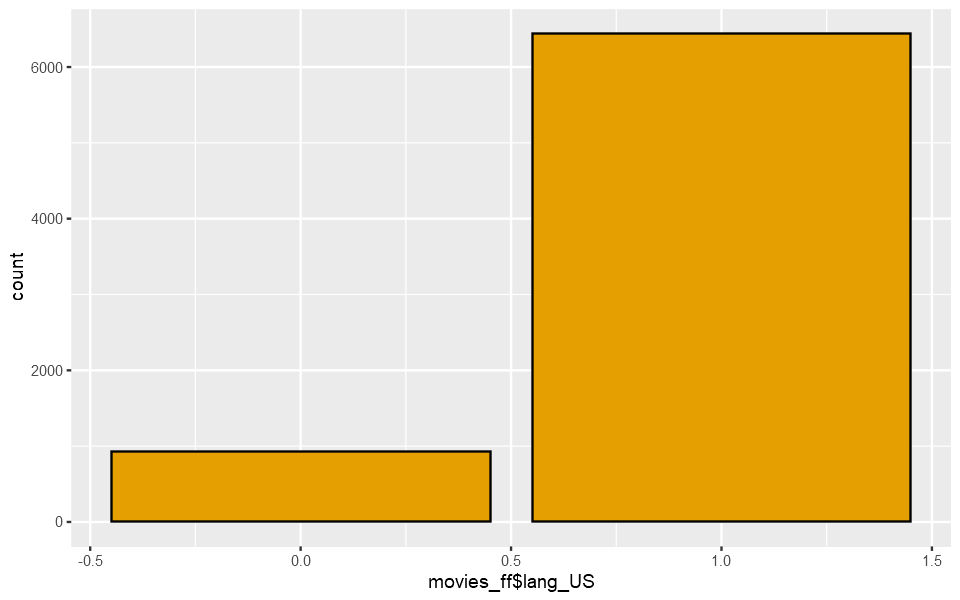

In [136]:
# lang_US
ggplot(movies_ff, aes(movies_ff$lang_US)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

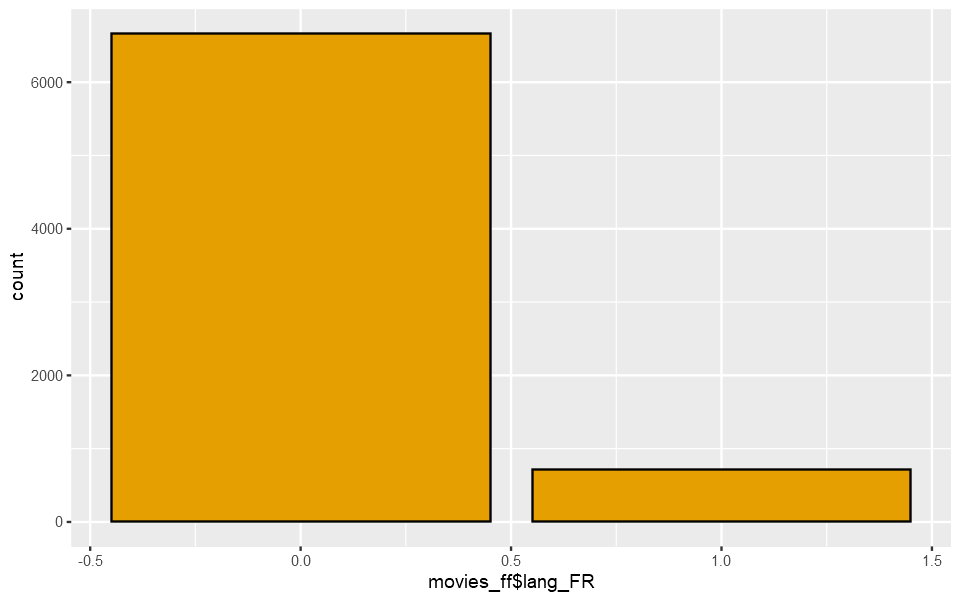

In [138]:
# lang_FR
ggplot(movies_ff, aes(movies_ff$lang_FR)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

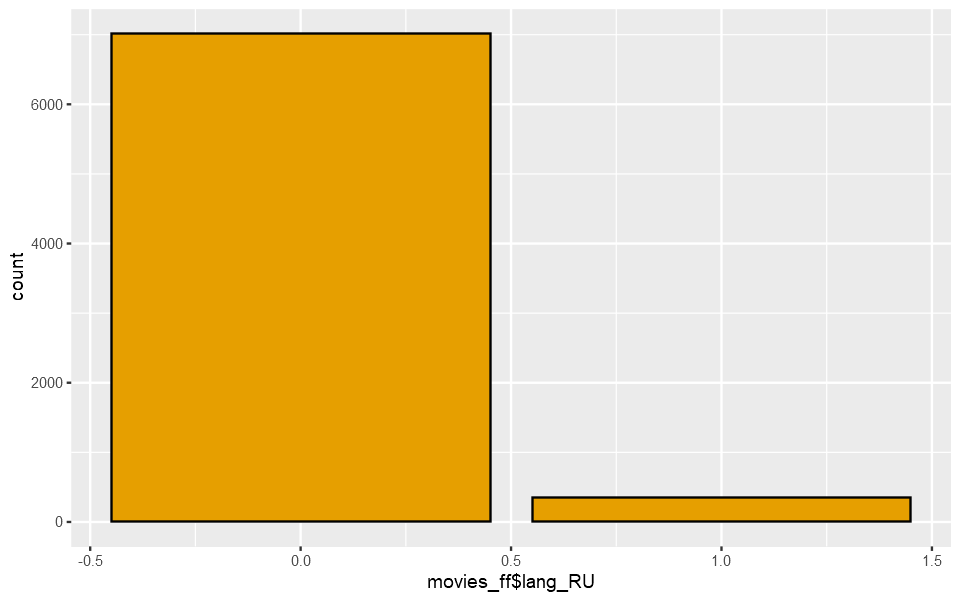

In [140]:
# lang_RU
ggplot(movies_ff, aes(movies_ff$lang_RU)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

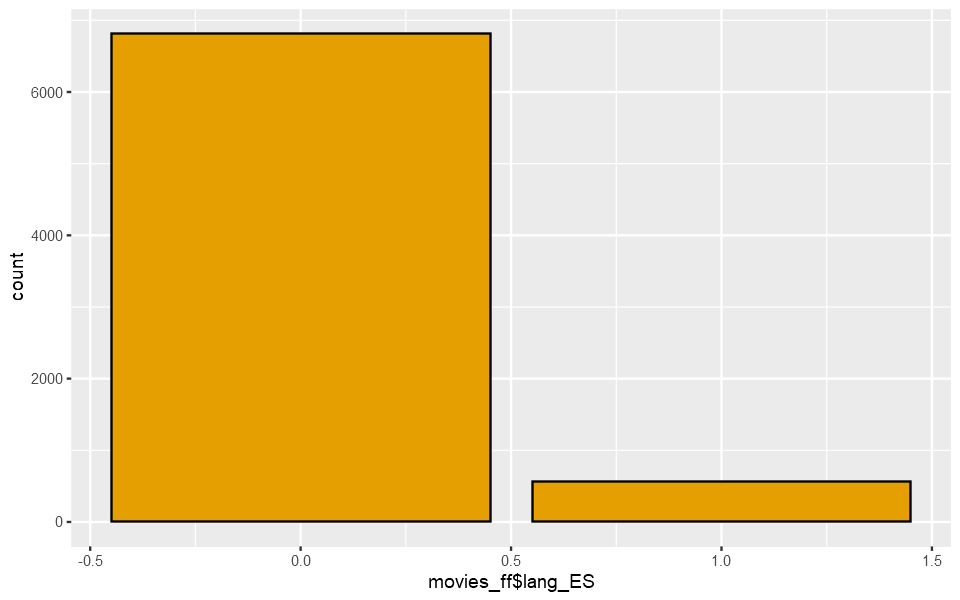

In [142]:
# lang_ES
ggplot(movies_ff, aes(movies_ff$lang_ES)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

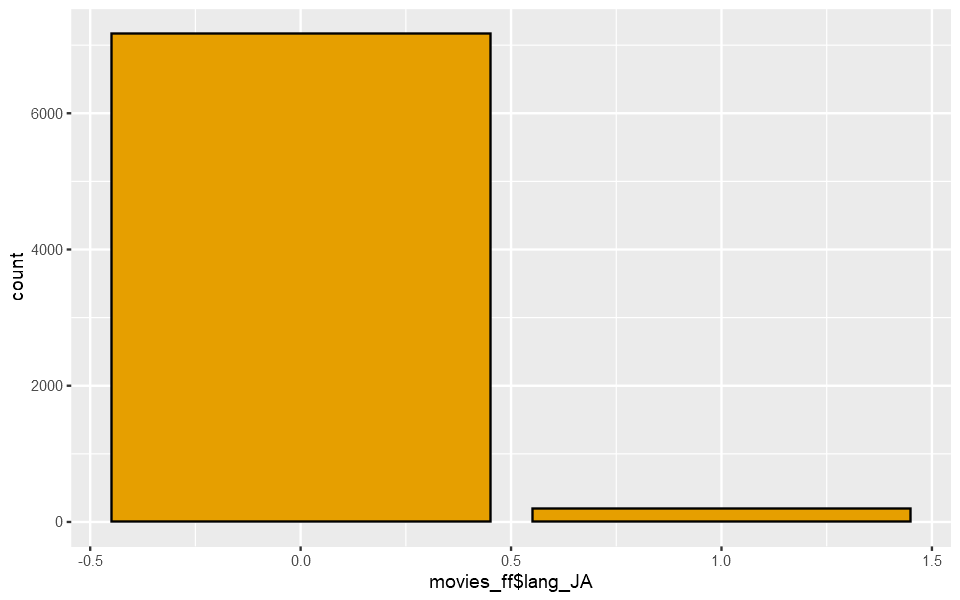

In [144]:
# lang_JA
ggplot(movies_ff, aes(movies_ff$lang_JA)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### keyword_cnt Analysis

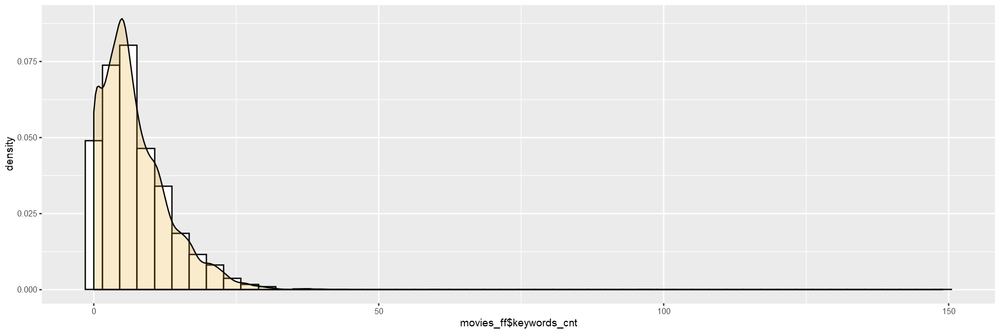

In [164]:
# keyword_cnt
ggplot(movies_ff, aes(x=movies_ff$keywords_cnt)) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()

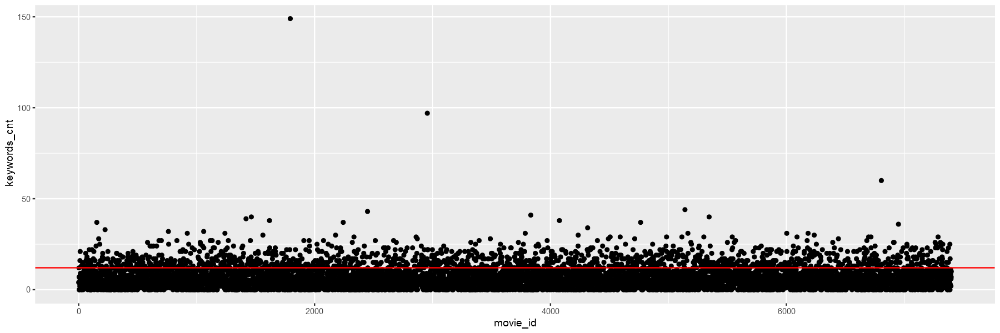

In [170]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=keywords_cnt)) + 
    geom_hline(yintercept = 12 ,color="red")

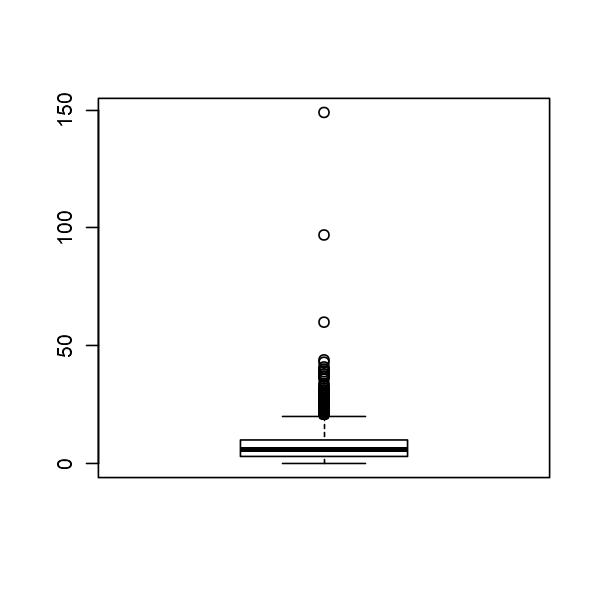

In [81]:
out_keywords_cnt <- boxplot(movies_ff$keywords_cnt) 
options(repr.plot.width = 5, repr.plot.height = 5)

In [82]:
head(out_keywords_cnt$out)
min(out_keywords_cnt$out)
max(out_keywords_cnt$out)
median(out_keywords_cnt$out)
mean(out_keywords_cnt$out)
length(out_keywords_cnt$out)

[1] 21 22 22 21 24 37

[1] 21

[1] 149

[1] 23

[1] 25.33453

[1] 278

### actor0_movies_cnt Analysis

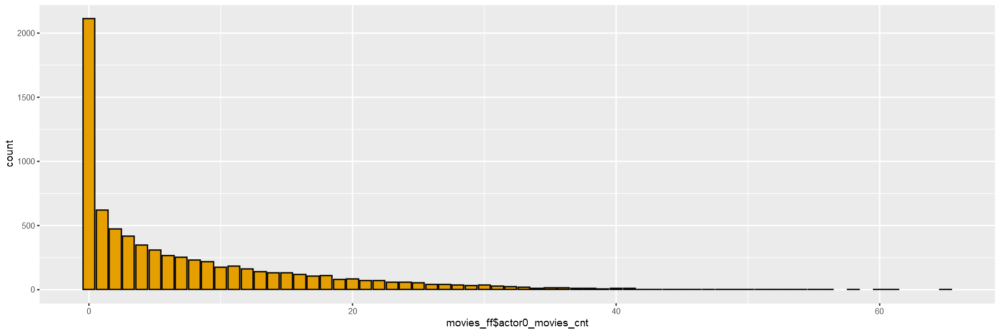

In [153]:
# actor0_movies_cnt
ggplot(movies_ff, aes(movies_ff$actor0_movies_cnt)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

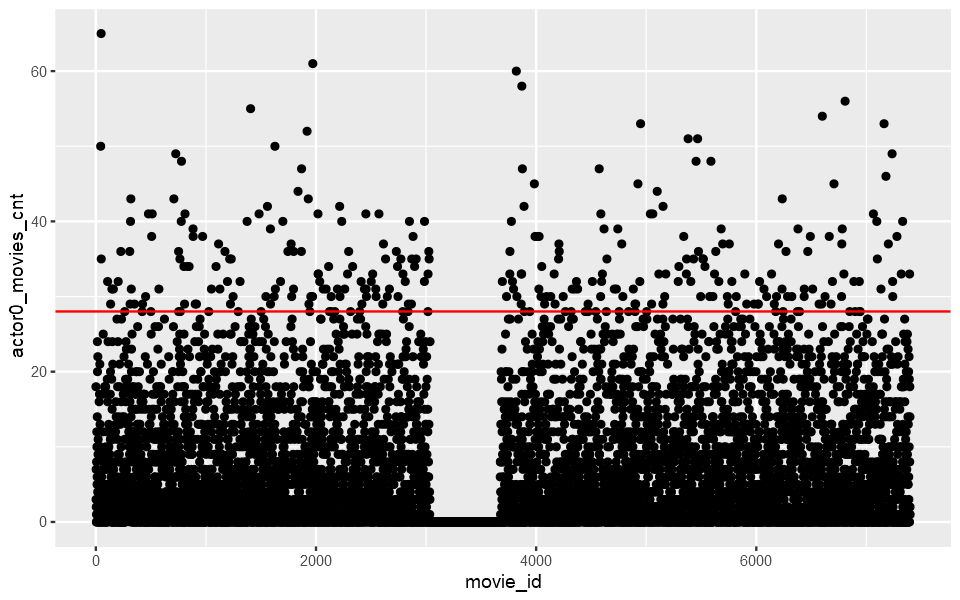

In [194]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=actor0_movies_cnt)) + 
    geom_hline(yintercept = 28 ,color="red")

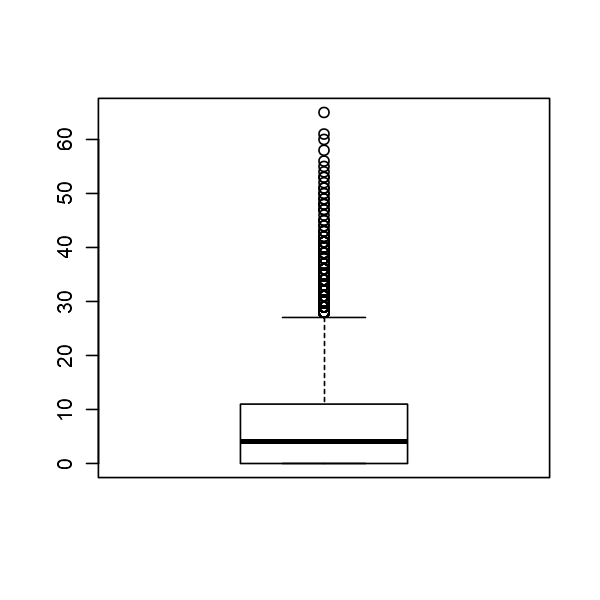

In [79]:
out_actor0_movies_cnt <- boxplot(movies_ff$actor0_movies_cnt) 
options(repr.plot.width = 5, repr.plot.height = 5)

In [80]:
head(out_actor0_movies_cnt$out)
min(out_actor0_movies_cnt$out)
max(out_actor0_movies_cnt$out)
median(out_actor0_movies_cnt$out)
mean(out_actor0_movies_cnt$out)
length(out_actor0_movies_cnt$out)

[1] 50 65 35 32 29 31

[1] 28

[1] 65

[1] 32

[1] 34.49346

[1] 306

### actor0_movies_5y_cnt Analysis

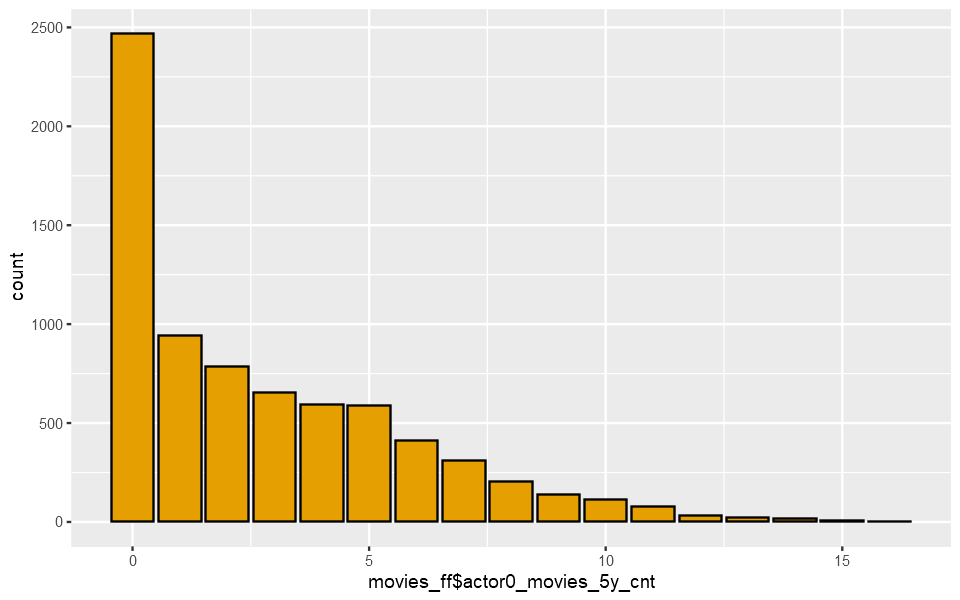

In [187]:
# actor0_movies_5y_cnt
ggplot(movies_ff, aes(movies_ff$actor0_movies_5y_cnt)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

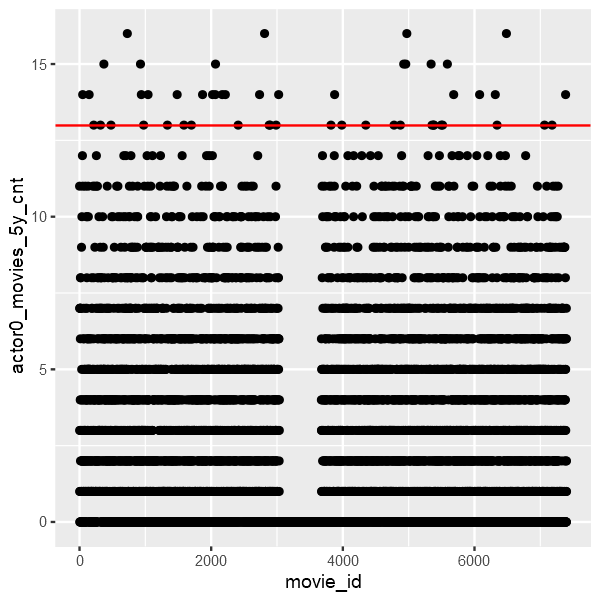

In [199]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=actor0_movies_5y_cnt)) + 
    geom_hline(yintercept = 13 ,color="red")

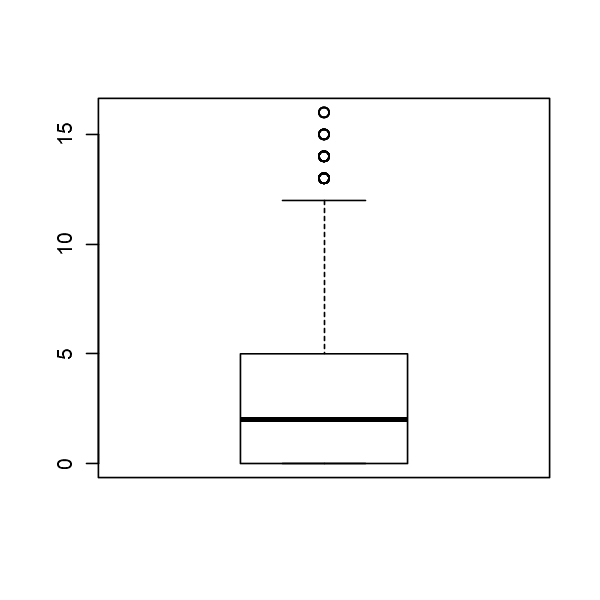

In [77]:
out_actor0_movies_5y_cnt <- boxplot(movies_ff$actor0_movies_5y_cnt) 
options(repr.plot.width = 5, repr.plot.height = 5)

In [78]:
head(out_actor0_movies_5y_cnt$out)
min(out_actor0_movies_5y_cnt$out)
max(out_actor0_movies_5y_cnt$out)
median(out_actor0_movies_5y_cnt$out)
mean(out_actor0_movies_5y_cnt$out)
length(out_actor0_movies_5y_cnt$out)

[1] 14 14 13 13 15 13

[1] 13

[1] 16

[1] 14

[1] 13.82692

[1] 52

### actor1_movies_cnt Analysis

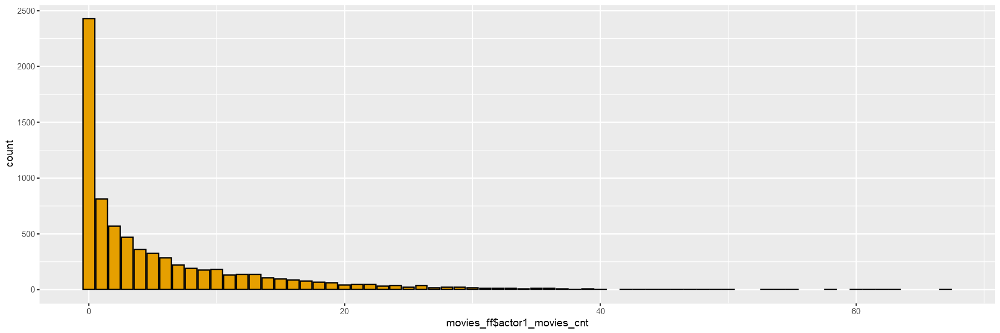

In [158]:
# actor1_movies_cnt
ggplot(movies_ff, aes(movies_ff$actor1_movies_cnt)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 20, repr.plot.height = 5)

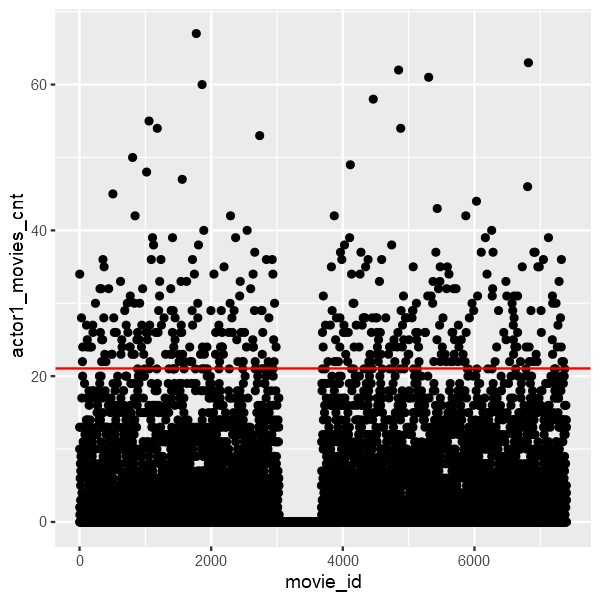

In [208]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=actor1_movies_cnt)) + 
    geom_hline(yintercept = 21 ,color="red")

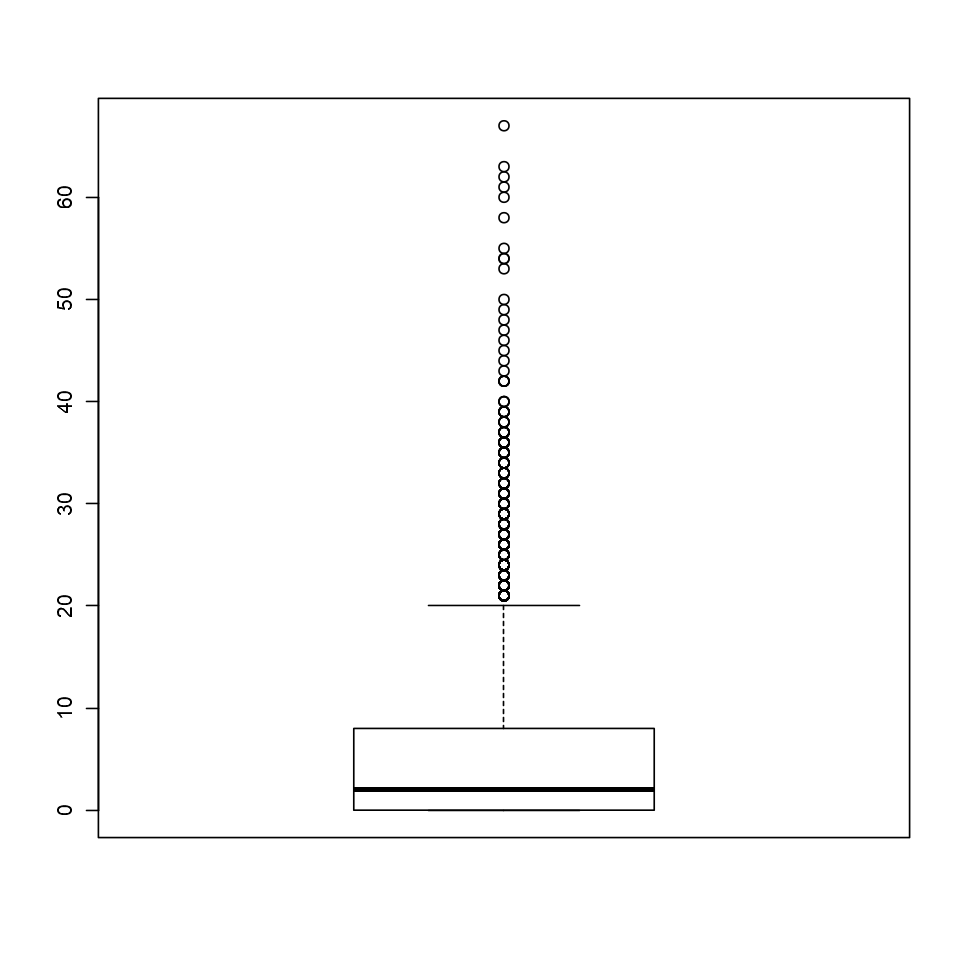

In [75]:
out_actor1_movies_cnt <- boxplot(movies_ff$actor1_movies_cnt) 
options(repr.plot.width = 5, repr.plot.height = 5)

In [76]:
head(out_actor1_movies_cnt$out)
min(out_actor1_movies_cnt$out)
max(out_actor1_movies_cnt$out)
median(out_actor1_movies_cnt$out)
mean(out_actor1_movies_cnt$out)
length(out_actor1_movies_cnt$out)

[1] 34 28 22 24 27 24

[1] 21

[1] 67

[1] 26

[1] 28.09002

[1] 411

### actor1_movies_5y_cnt

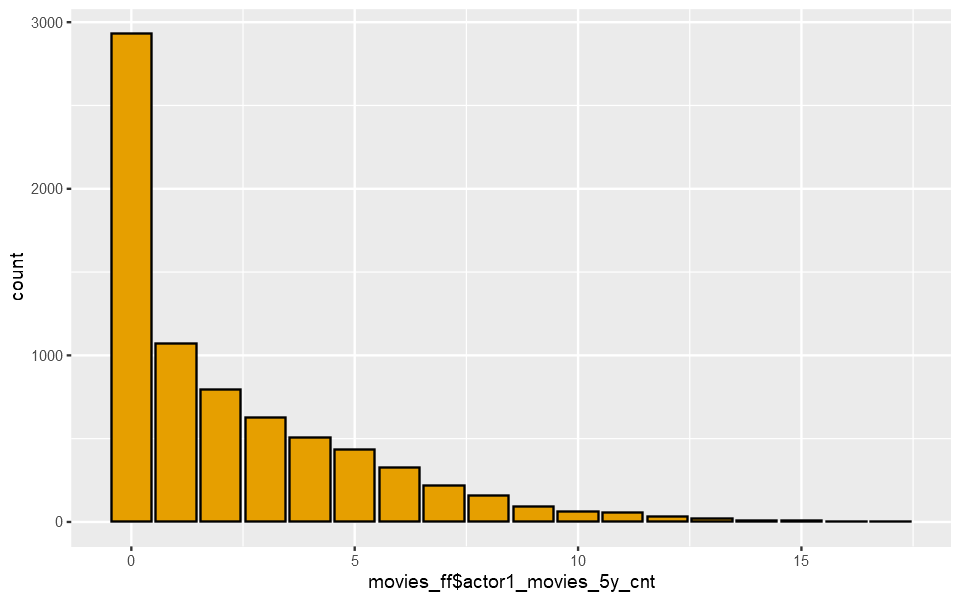

In [160]:
# actor1_movies_5y_cnt
ggplot(movies_ff, aes(movies_ff$actor1_movies_5y_cnt)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

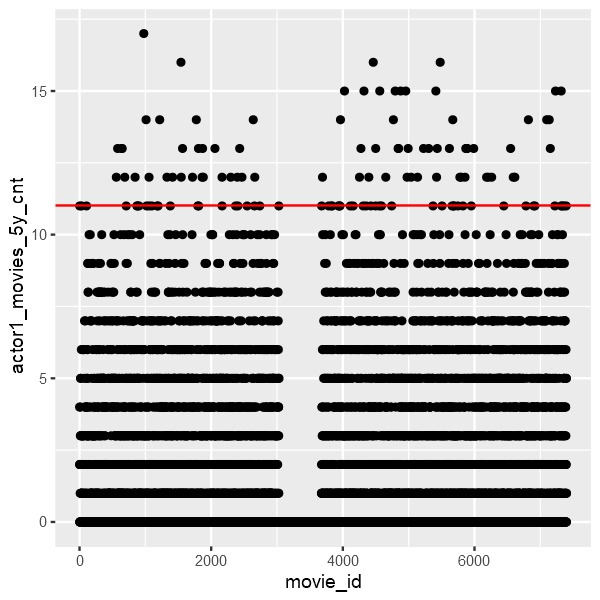

In [215]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=actor1_movies_5y_cnt)) + 
    geom_hline(yintercept = 11 ,color="red")

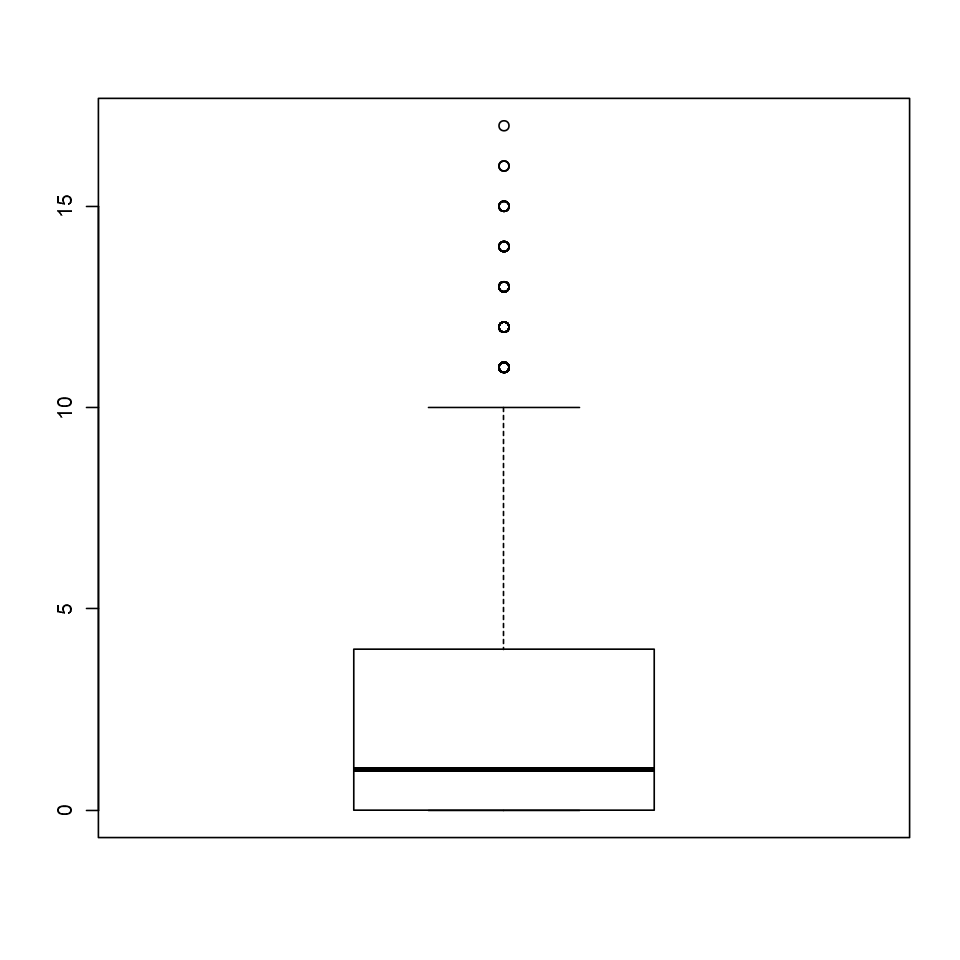

In [73]:
out_actor1_movies_5y_cnt <- boxplot(movies_ff$actor1_movies_5y_cnt) 

In [74]:
head(out_actor1_movies_5y_cnt$out)
min(out_actor1_movies_5y_cnt$out)
max(out_actor1_movies_5y_cnt$out)
median(out_actor1_movies_5y_cnt$out)
mean(out_actor1_movies_5y_cnt$out)
length(out_actor1_movies_5y_cnt$out)

[1] 11 11 11 12 13 13

[1] 11

[1] 17

[1] 12

[1] 12.24242

[1] 132

### actor2_movies_cnt

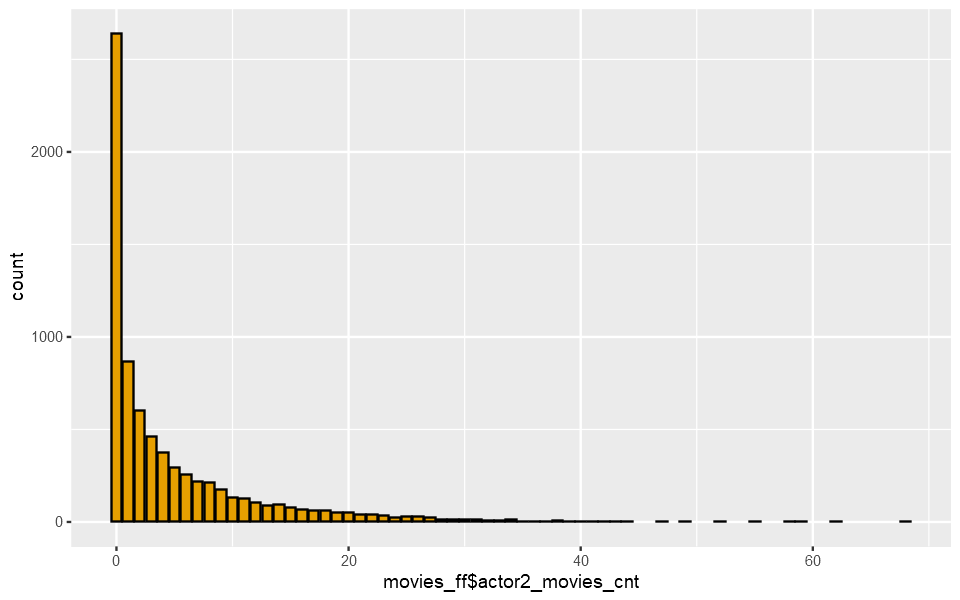

In [161]:
# actor2_movies_cnt
ggplot(movies_ff, aes(movies_ff$actor2_movies_cnt)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 20, repr.plot.height = 5)

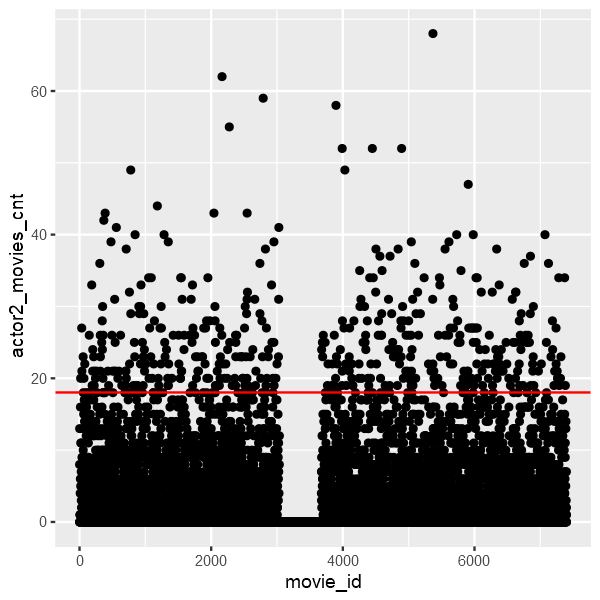

In [221]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=actor2_movies_cnt)) + 
    geom_hline(yintercept = 18 ,color="red")

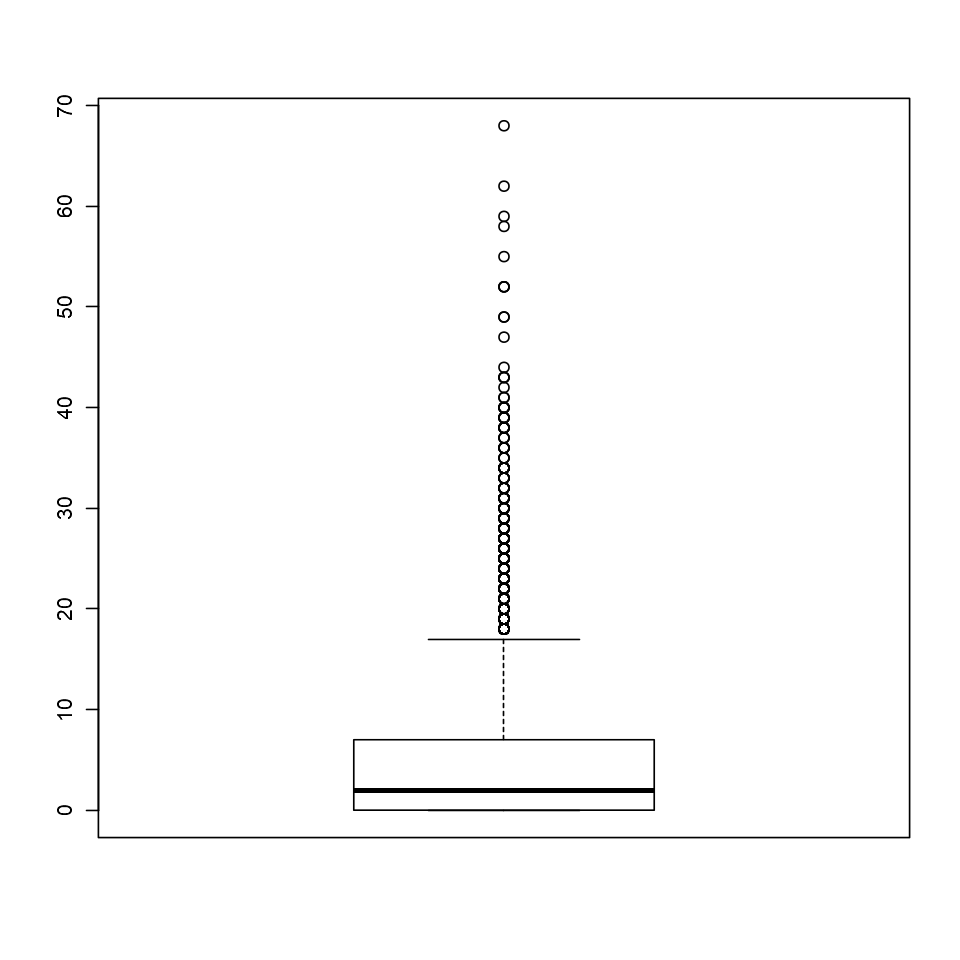

In [71]:
out_actor2_movies_cnt <- boxplot(movies_ff$actor2_movies_cnt) 

In [72]:
head(out_actor2_movies_cnt$out)
min(out_actor2_movies_cnt$out)
max(out_actor2_movies_cnt$out)
median(out_actor2_movies_cnt$out)
mean(out_actor2_movies_cnt$out)
length(out_actor2_movies_cnt$out)

[1] 20 27 21 23 18 20

[1] 18

[1] 68

[1] 23

[1] 24.87377

[1] 507

### actor2_movies_5y_cnt Analysis

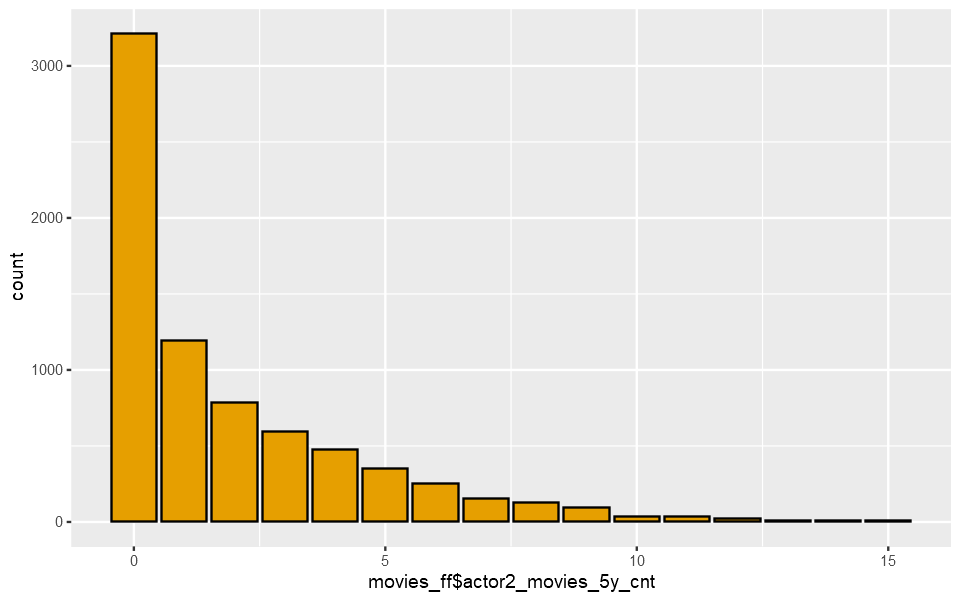

In [164]:
# actor2_movies_5y_cnt
ggplot(movies_ff, aes(movies_ff$actor2_movies_5y_cnt)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

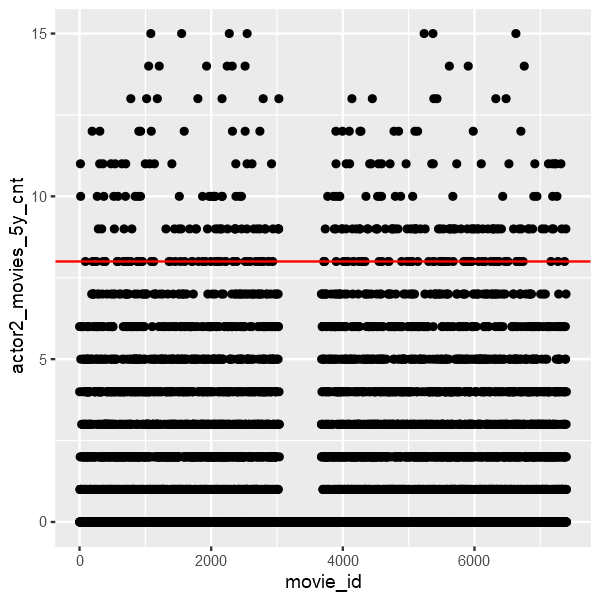

In [225]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=actor2_movies_5y_cnt)) + 
    geom_hline(yintercept = 8 ,color="red")

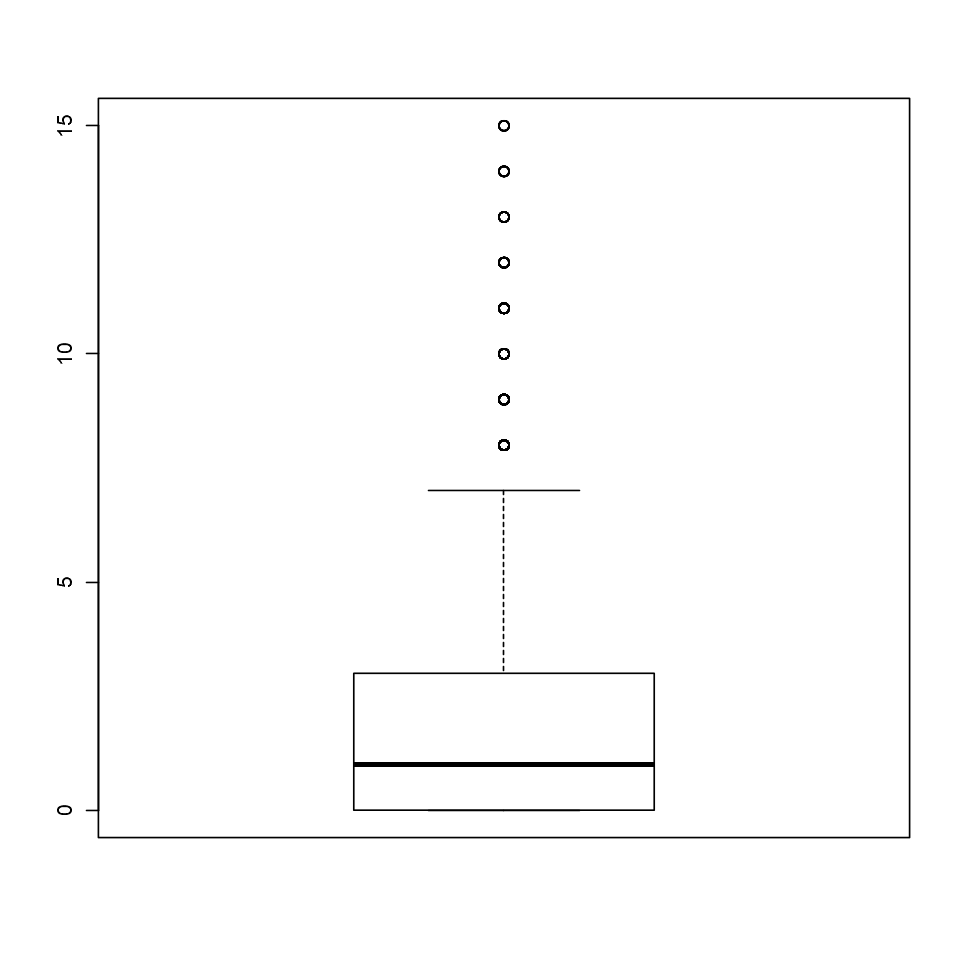

In [69]:
out_actor2_movies_5y_cnt <- boxplot(movies_ff$actor2_movies_5y_cnt) 

In [70]:
head(out_actor2_movies_5y_cnt$out)
min(out_actor2_movies_5y_cnt$out)
max(out_actor2_movies_5y_cnt$out)
median(out_actor2_movies_5y_cnt$out)
mean(out_actor2_movies_5y_cnt$out)
length(out_actor2_movies_5y_cnt$out)

[1] 11 10  8 12  8  8

[1] 8

[1] 15

[1] 9

[1] 9.530435

[1] 345

Warning message:
"Removed 934 rows containing non-finite values (stat_count)."


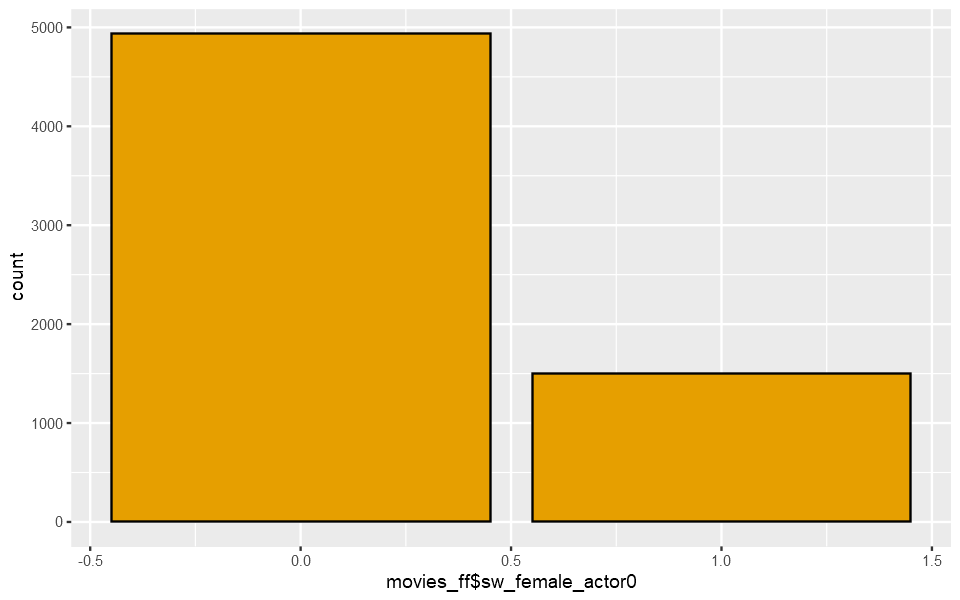

In [166]:
# sw_female_actor0
ggplot(movies_ff, aes(movies_ff$sw_female_actor0)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

Warning message:
"Removed 782 rows containing non-finite values (stat_count)."


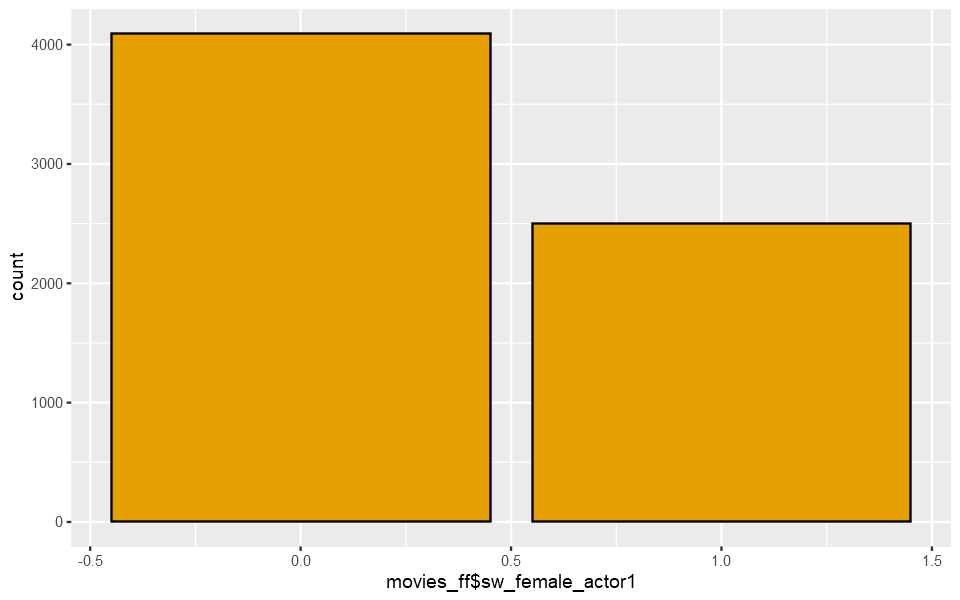

In [167]:
# sw_female_actor1
ggplot(movies_ff, aes(movies_ff$sw_female_actor1)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

Warning message:
"Removed 788 rows containing non-finite values (stat_count)."


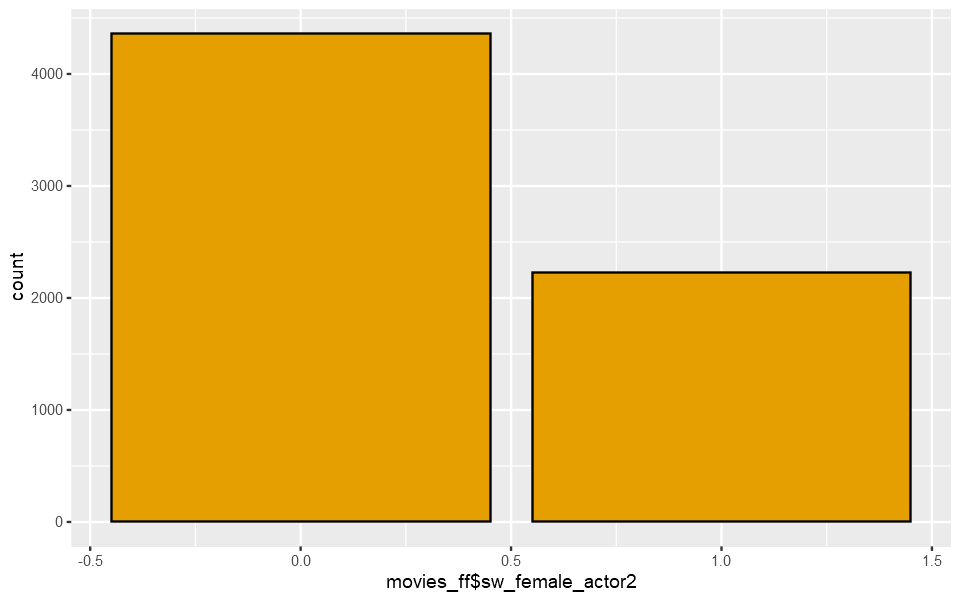

In [168]:
# sw_female_actor2
ggplot(movies_ff, aes(movies_ff$sw_female_actor2)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

Warning message:
"Removed 934 rows containing non-finite values (stat_count)."


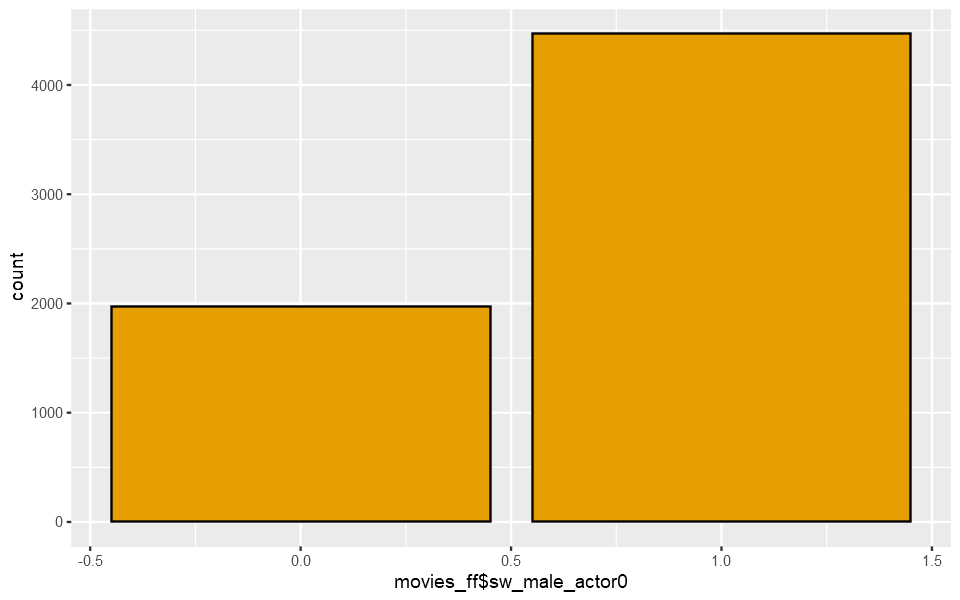

In [169]:
# sw_male_actor0
ggplot(movies_ff, aes(movies_ff$sw_male_actor0)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

Warning message:
"Removed 782 rows containing non-finite values (stat_count)."


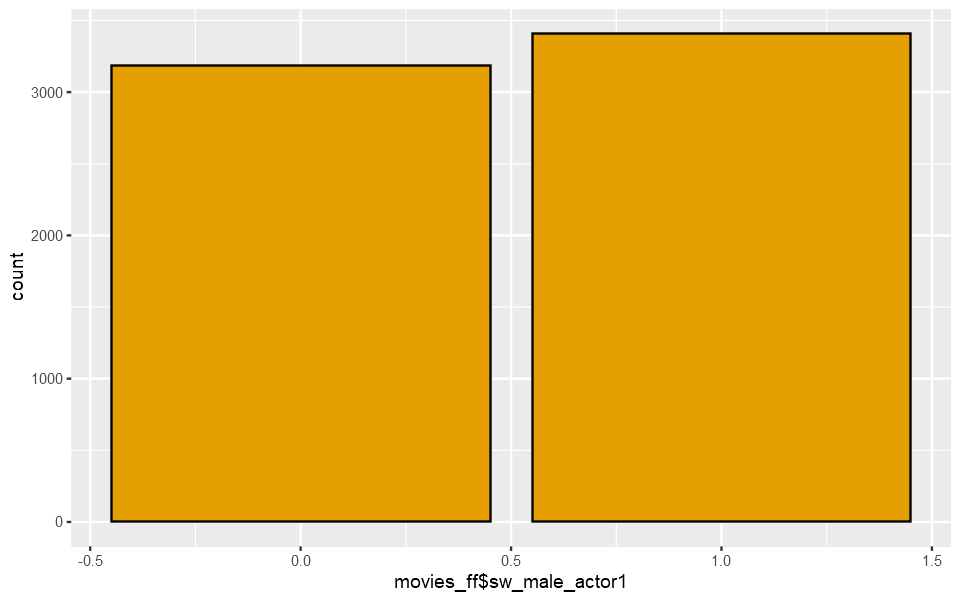

In [171]:
# sw_male_actor1
ggplot(movies_ff, aes(movies_ff$sw_male_actor1)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

Warning message:
"Removed 788 rows containing non-finite values (stat_count)."


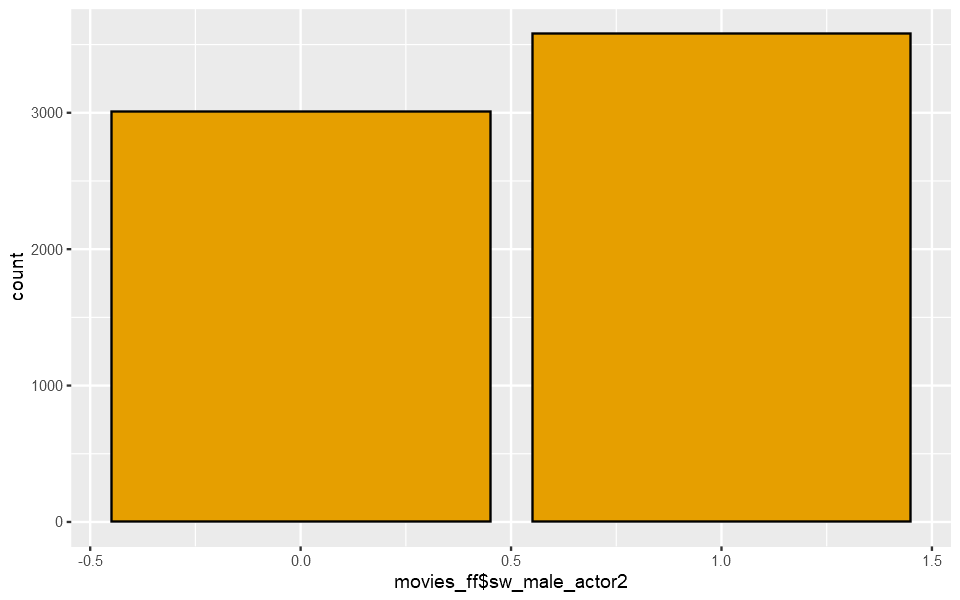

In [172]:
# sw_male_actor2
ggplot(movies_ff, aes(movies_ff$sw_male_actor2)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

### # actor0_prev_revenue Analysis

Warning message:
"Removed 2752 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 2752 rows containing non-finite values (stat_density)."


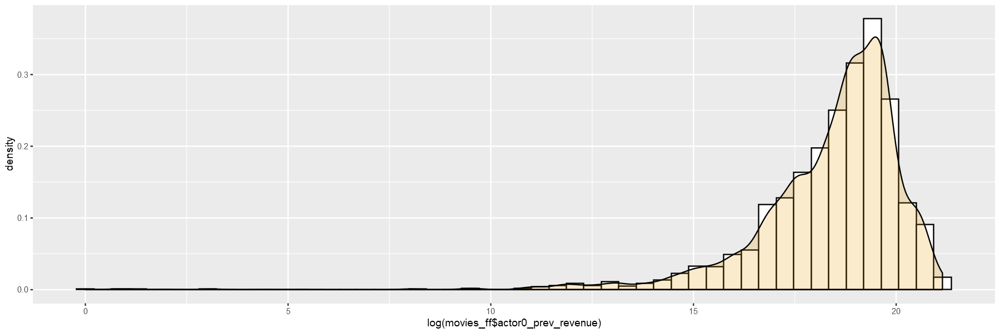

In [181]:
# actor0_prev_revenue
ggplot(movies_ff, aes(x=log(movies_ff$actor0_prev_revenue))) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()
options(repr.plot.width = 15, repr.plot.height = 5)

Warning message:
"Removed 2752 rows containing missing values (geom_point)."


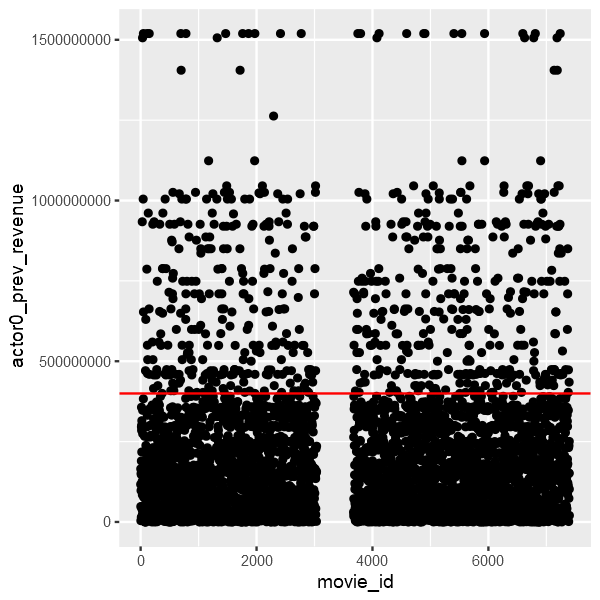

In [235]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=actor0_prev_revenue)) + 
    geom_hline(yintercept = 400000000 ,color="red")

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


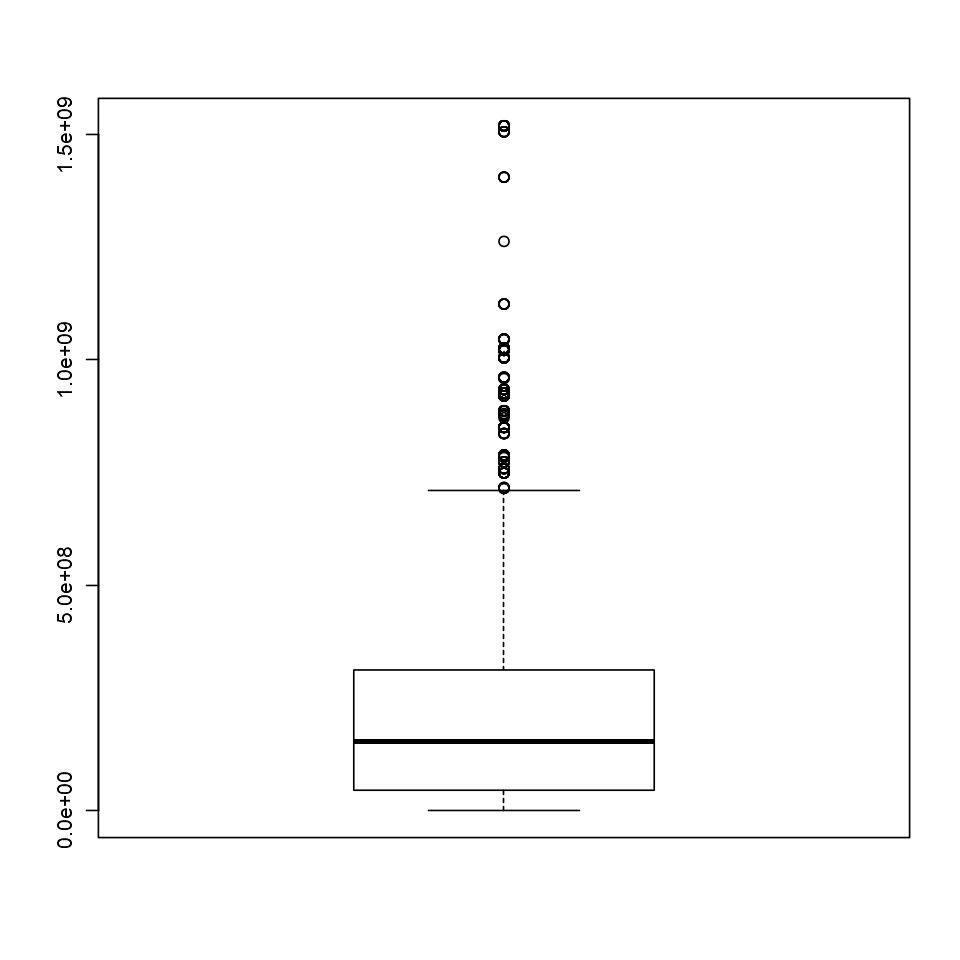

In [67]:
out_actor0_prev_revenue <- boxplot(movies_ff$actor0_prev_revenue) 

In [68]:
head(out_actor0_prev_revenue$out)
min(out_actor0_prev_revenue$out)
max(out_actor0_prev_revenue$out)
median(out_actor0_prev_revenue$out)
mean(out_actor0_prev_revenue$out)
length(out_actor0_prev_revenue$out)

[1]  933959197 1506249360 1004558444 1519557910  786636033 1519557910

[1] 714766572

[1] 1519557910

[1] 926287400

[1] 970535871

[1] 281

### actor1_prev_revenue Analysis

Warning message:
"Removed 3201 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 3201 rows containing non-finite values (stat_density)."


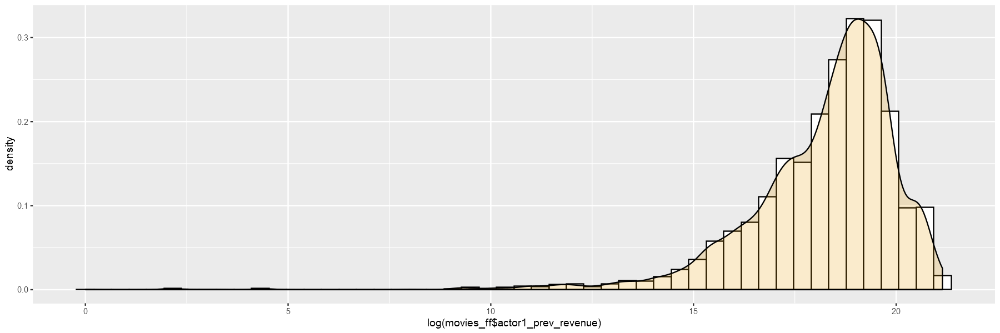

In [182]:
# actor1_prev_revenue
ggplot(movies_ff, aes(x=log(movies_ff$actor1_prev_revenue))) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()
options(repr.plot.width = 15, repr.plot.height = 5)

Warning message:
"Removed 3201 rows containing missing values (geom_point)."


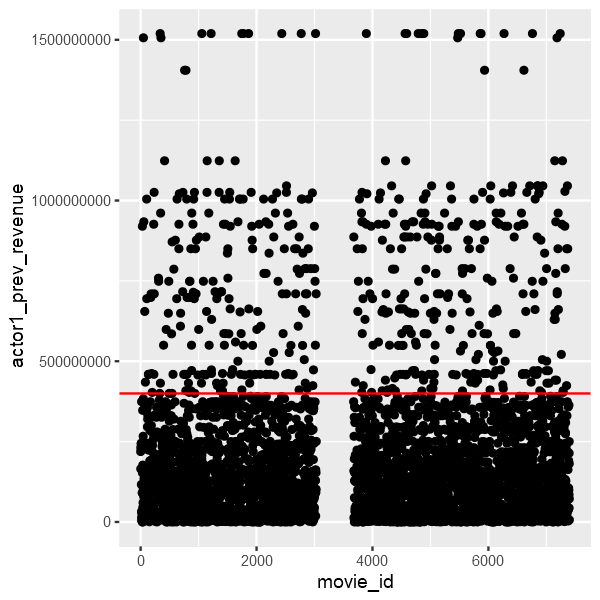

In [237]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=actor1_prev_revenue)) + 
    geom_hline(yintercept = 400000000 ,color="red")

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


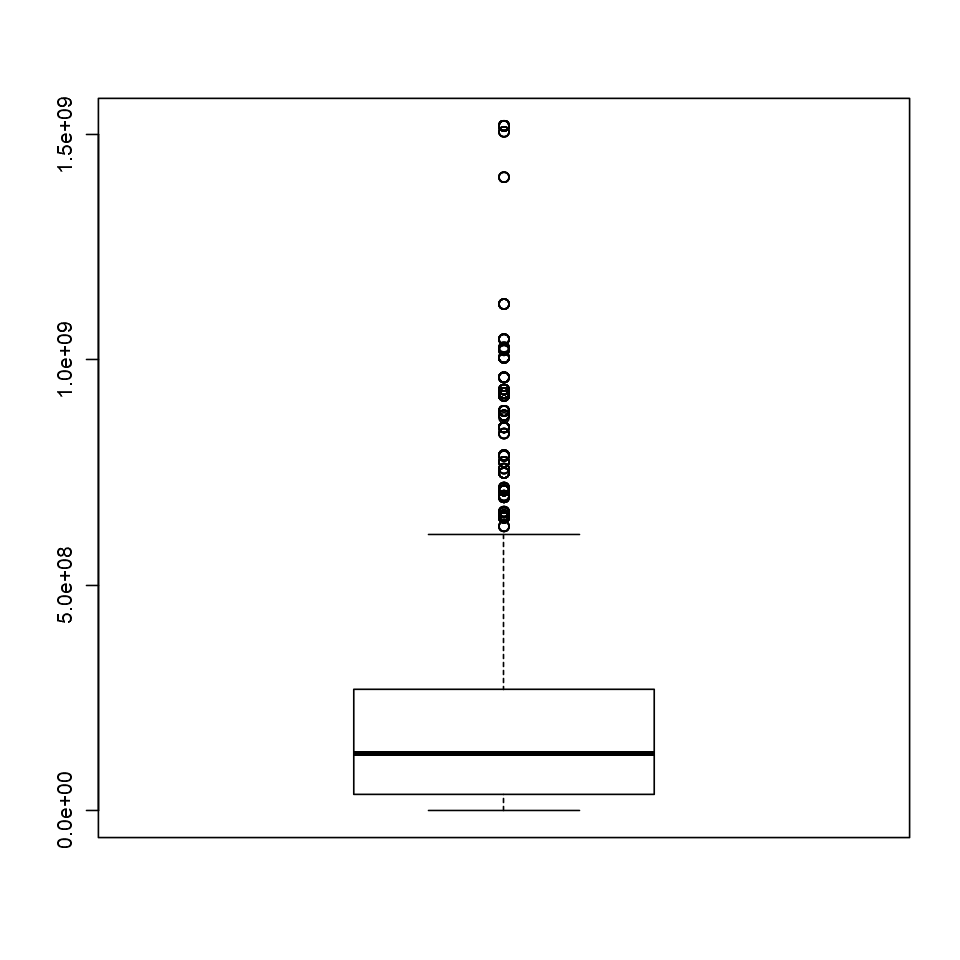

In [65]:
out_actor1_prev_revenue <- boxplot(movies_ff$actor1_prev_revenue) 

In [66]:
head(out_actor1_prev_revenue$out)
min(out_actor1_prev_revenue$out)
max(out_actor1_prev_revenue$out)
median(out_actor1_prev_revenue$out)
mean(out_actor1_prev_revenue$out)
length(out_actor1_prev_revenue$out)

[1]  920100000 1506249360  933959197  655011224 1004558444  694713380

[1] 630161890

[1] 1519557910

[1] 886686817

[1] 913759883

[1] 326

### actor2_prev_revenue

Warning message:
"Removed 3423 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 3423 rows containing non-finite values (stat_density)."


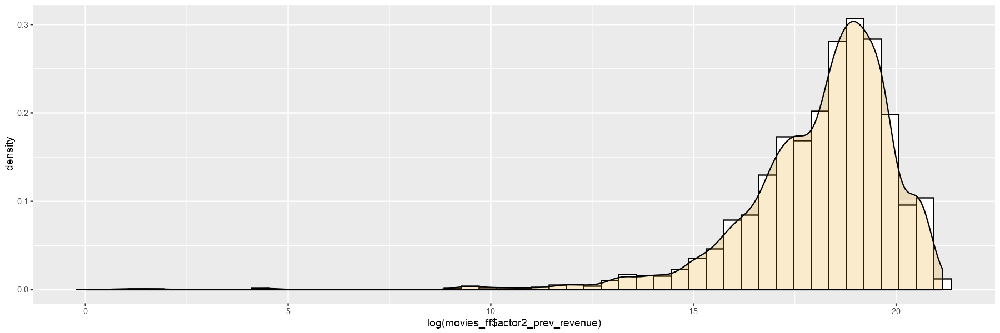

In [183]:
# actor2_prev_revenue
ggplot(movies_ff, aes(x=log(movies_ff$actor2_prev_revenue))) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 50)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()
options(repr.plot.width = 15, repr.plot.height = 5)

Warning message:
"Removed 3423 rows containing missing values (geom_point)."


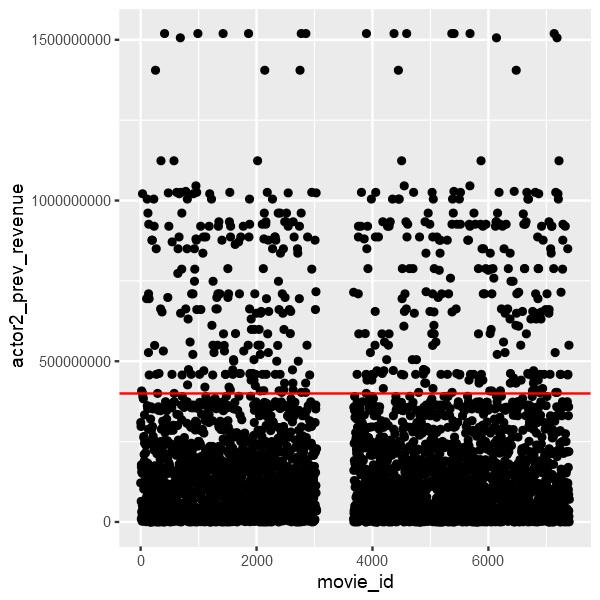

In [241]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=actor2_prev_revenue)) + 
    geom_hline(yintercept = 400000000 ,color="red")

Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


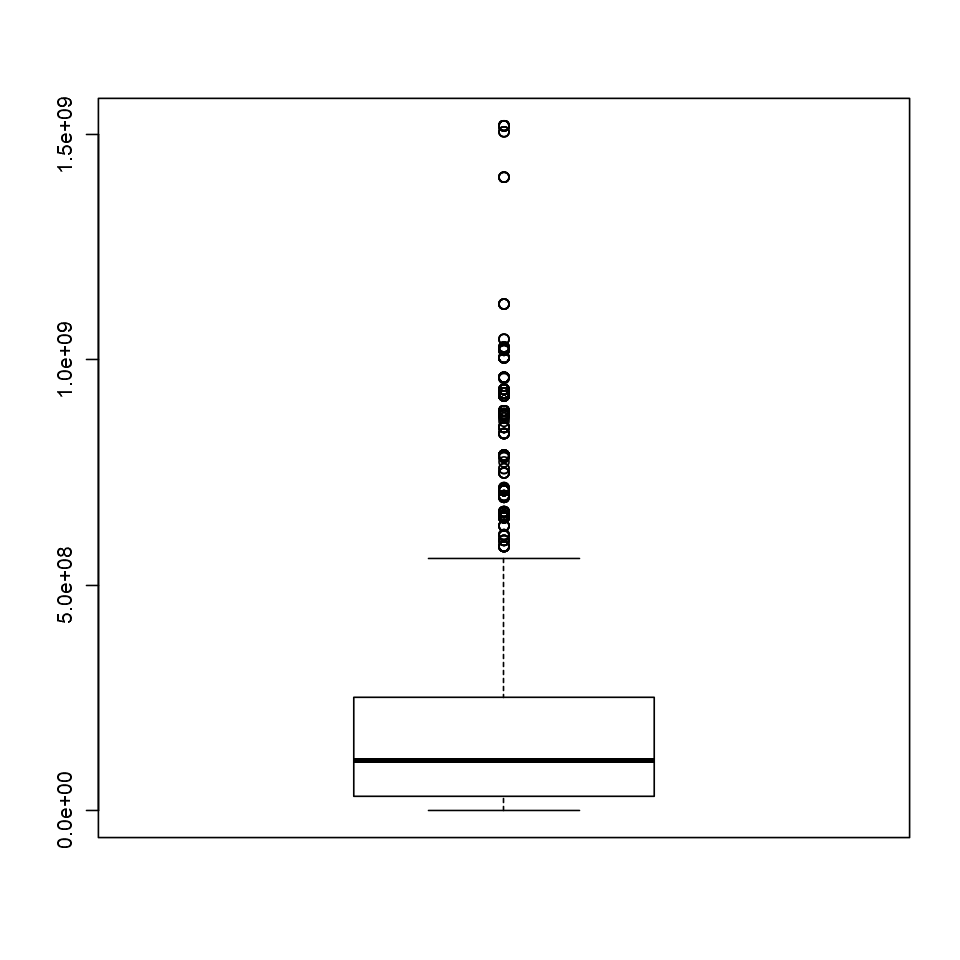

In [63]:
out_actor2_prev_revenue <- boxplot(movies_ff$actor2_prev_revenue) 

In [64]:
head(out_actor2_prev_revenue$out)
min(out_actor2_prev_revenue$out)
max(out_actor2_prev_revenue$out)
median(out_actor2_prev_revenue$out)
mean(out_actor2_prev_revenue$out)
length(out_actor2_prev_revenue$out)

[1] 1021103568  694713380 1004558444  961000000  709827462  926287400

[1] 585349010

[1] 1519557910

[1] 876688482

[1] 873059048

[1] 331

### director_movies_cnt Analysis

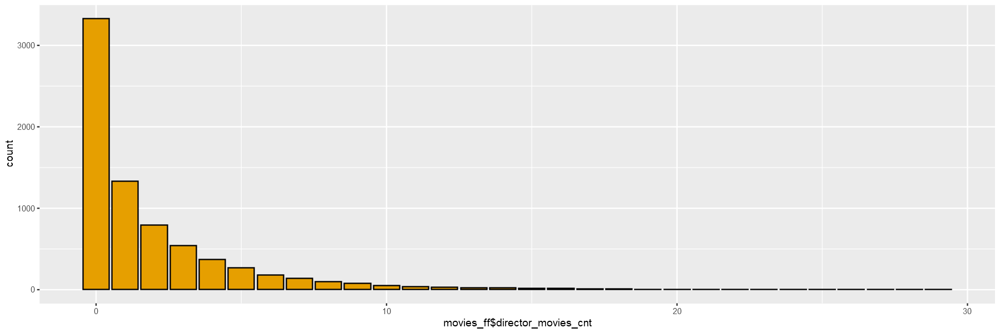

In [185]:
# director_movies_cnt
ggplot(movies_ff, aes(movies_ff$director_movies_cnt)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

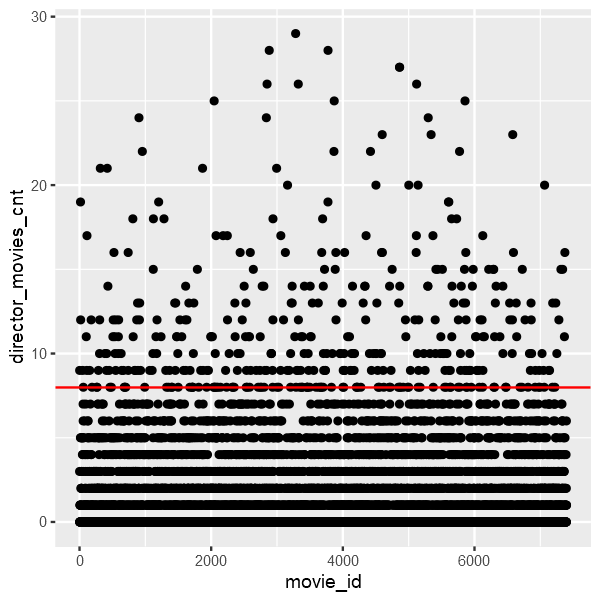

In [253]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=director_movies_cnt)) + 
    geom_hline(yintercept = 8 ,color="red")

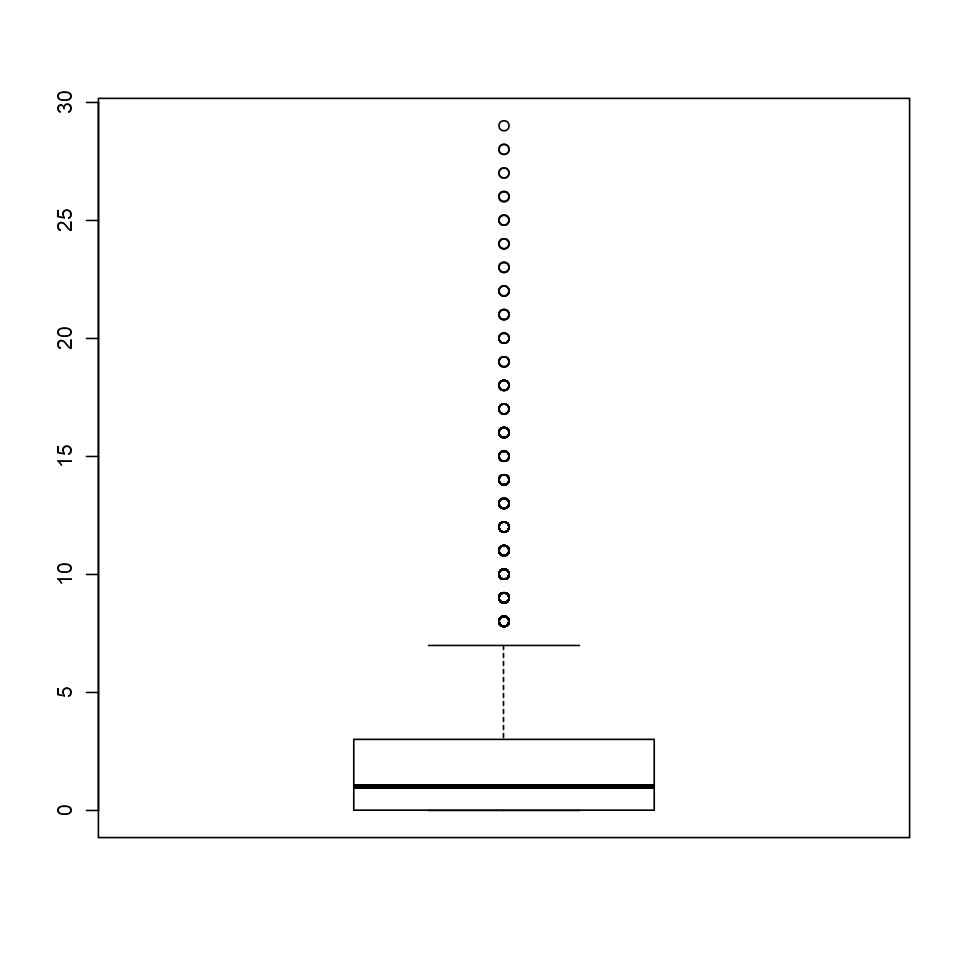

In [61]:
out_director_movies_cnt <- boxplot(movies_ff$director_movies_cnt) 

In [62]:
head(out_director_movies_cnt$out)
min(out_director_movies_cnt$out)
max(out_director_movies_cnt$out)
median(out_director_movies_cnt$out)
mean(out_director_movies_cnt$out)
length(out_director_movies_cnt$out)

[1]  9 19 12  9  8 11

[1] 8

[1] 29

[1] 10

[1] 11.6815

[1] 427

### director_movies_5y_cnt Analysis

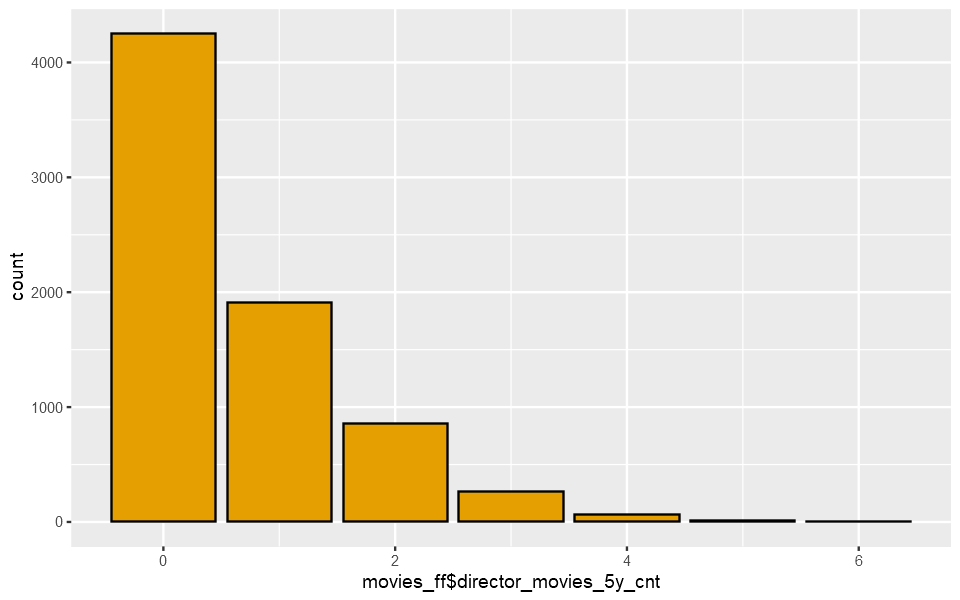

In [186]:
# director_movies_5y_cnt
ggplot(movies_ff, aes(movies_ff$director_movies_5y_cnt)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    theme_get()
   options(repr.plot.width = 8, repr.plot.height = 5)

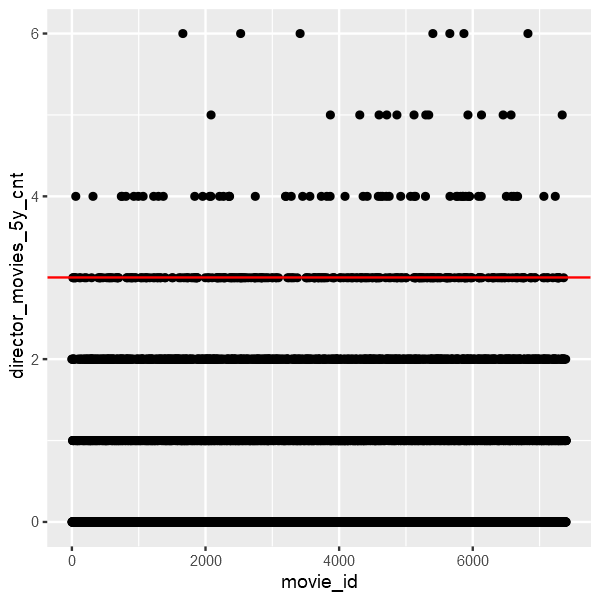

In [255]:
ggplot(data=movies_ff) +
    geom_point(aes(x=movie_id, y=director_movies_5y_cnt)) + 
    geom_hline(yintercept = 3 ,color="red")

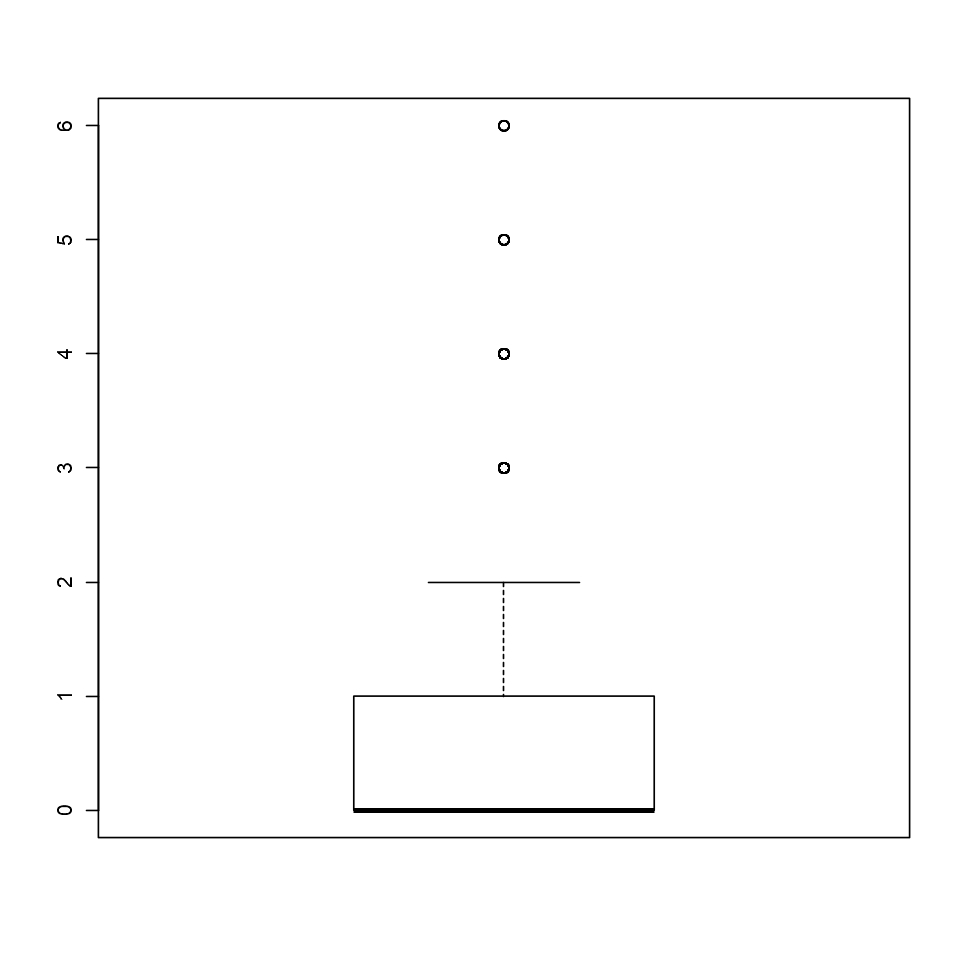

In [57]:
out_director_movies_5y_cnt <- boxplot(movies_ff$director_movies_5y_cnt) 

In [60]:
head(out_director_movies_5y_cnt$out)
min(out_director_movies_5y_cnt$out)
max(out_director_movies_5y_cnt$out)
median(out_director_movies_5y_cnt$out)
mean(out_director_movies_5y_cnt$out)
length(out_director_movies_5y_cnt$out)

[1] 3 3 3 3 3 4

[1] 3

[1] 6

[1] 3

[1] 3.314286

[1] 350

### Ganres

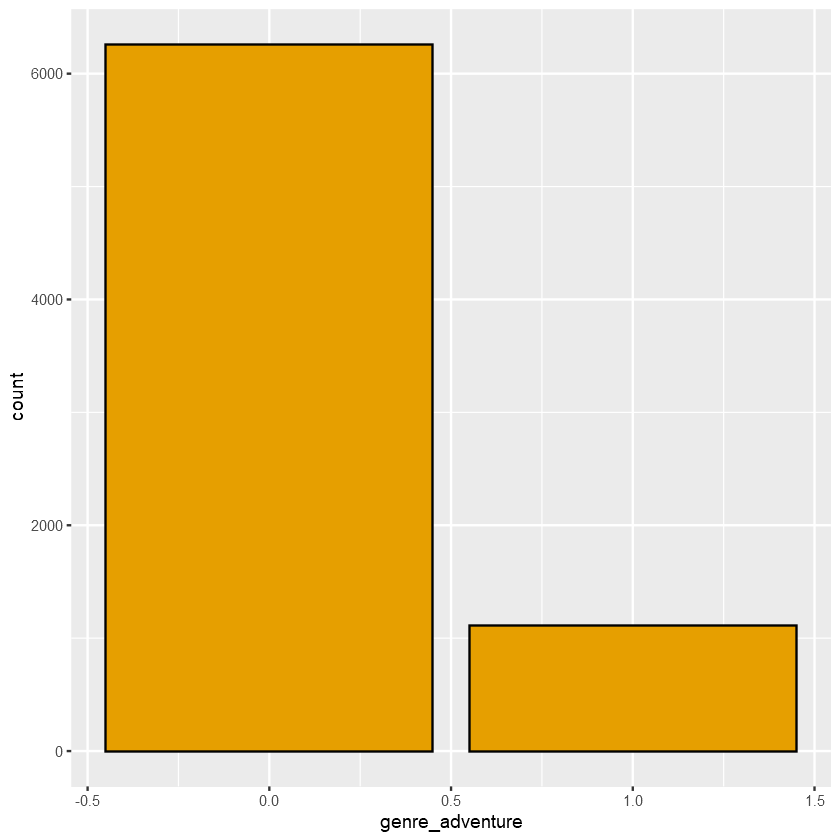

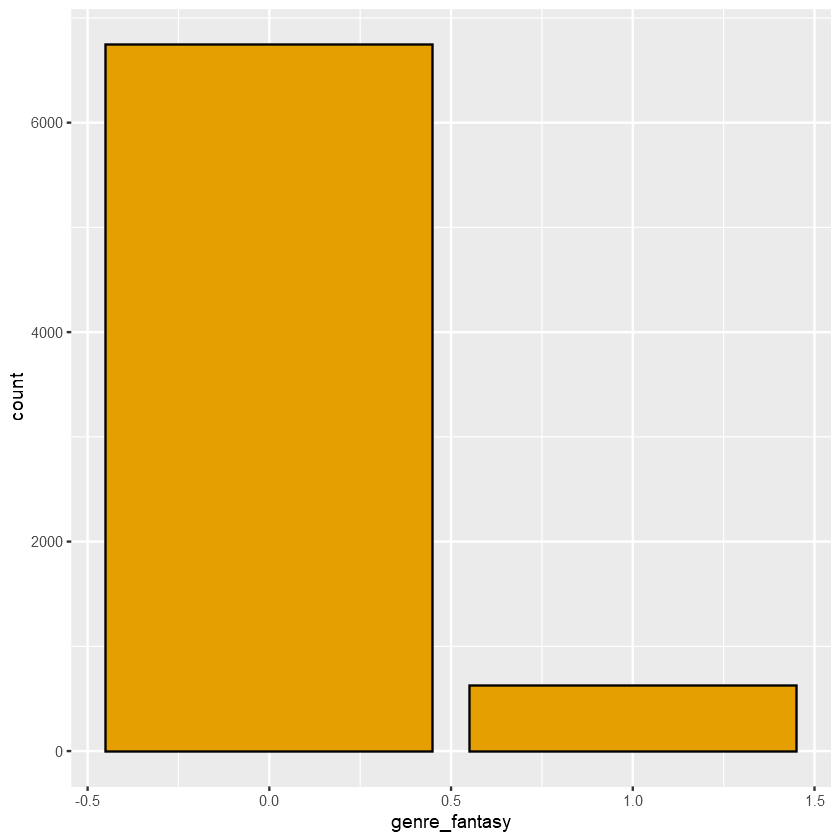

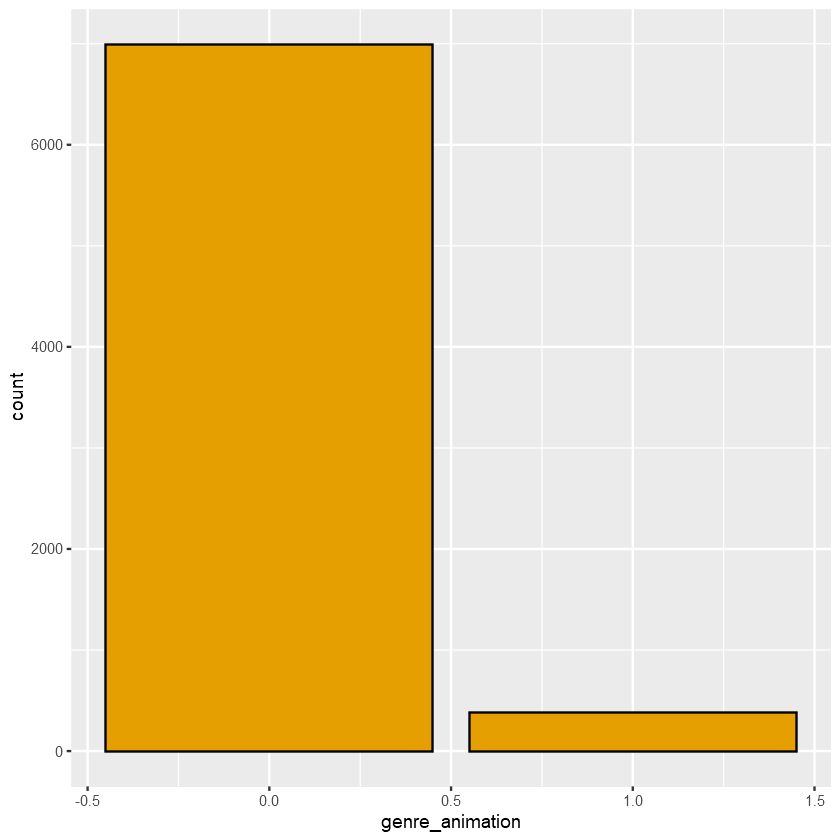

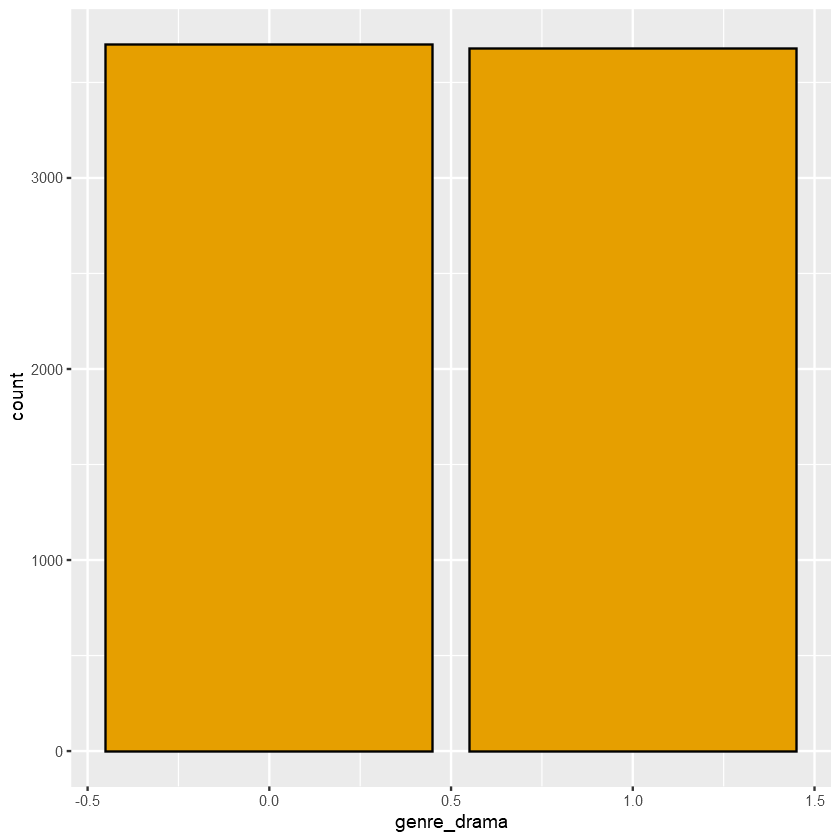

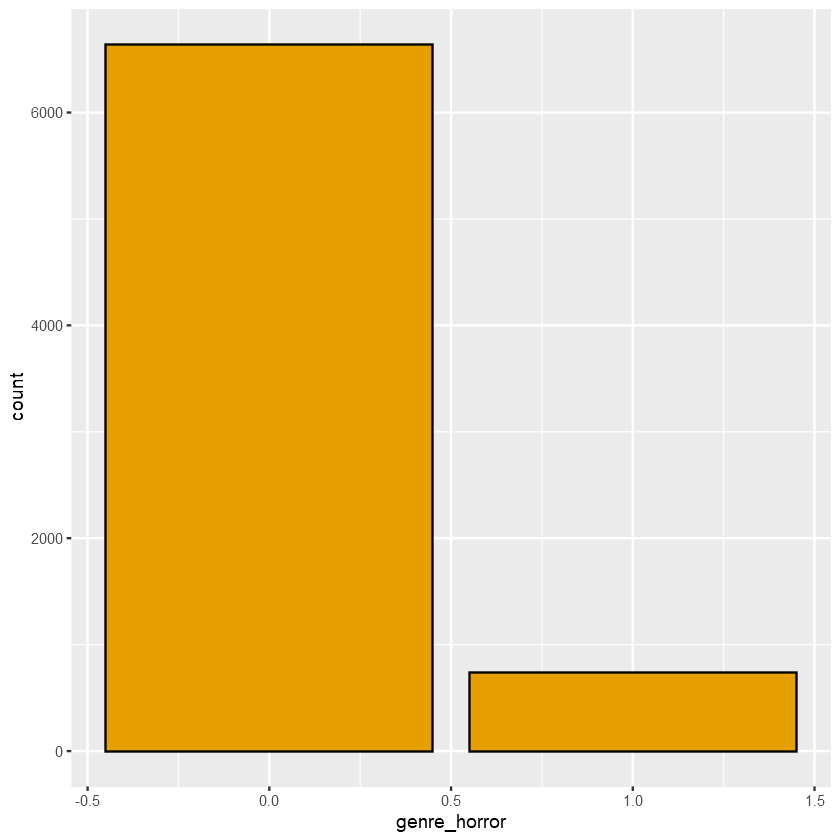

...

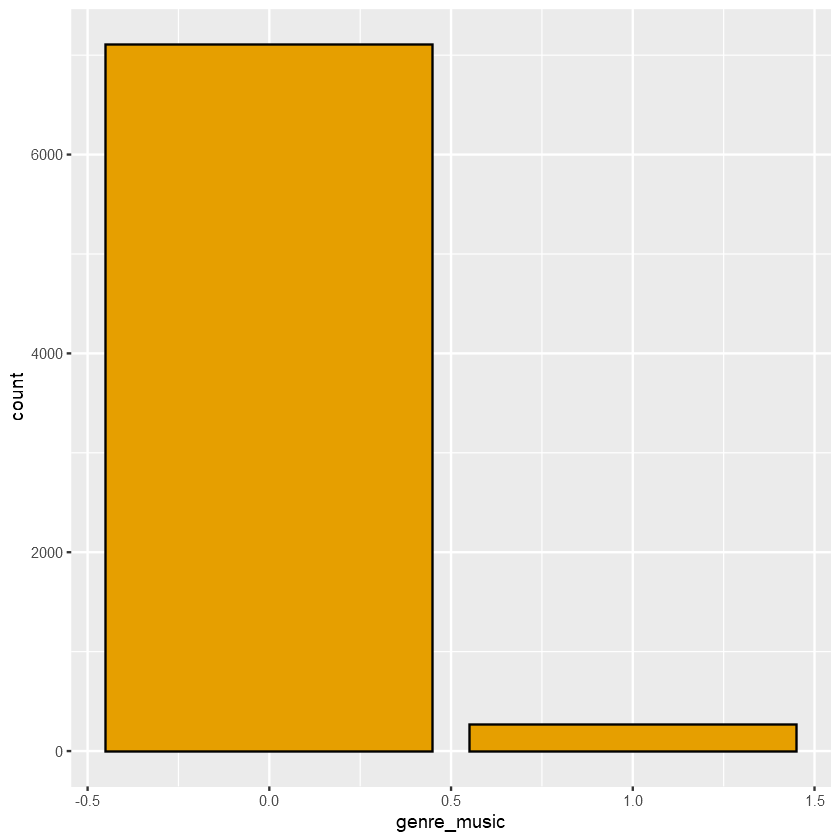

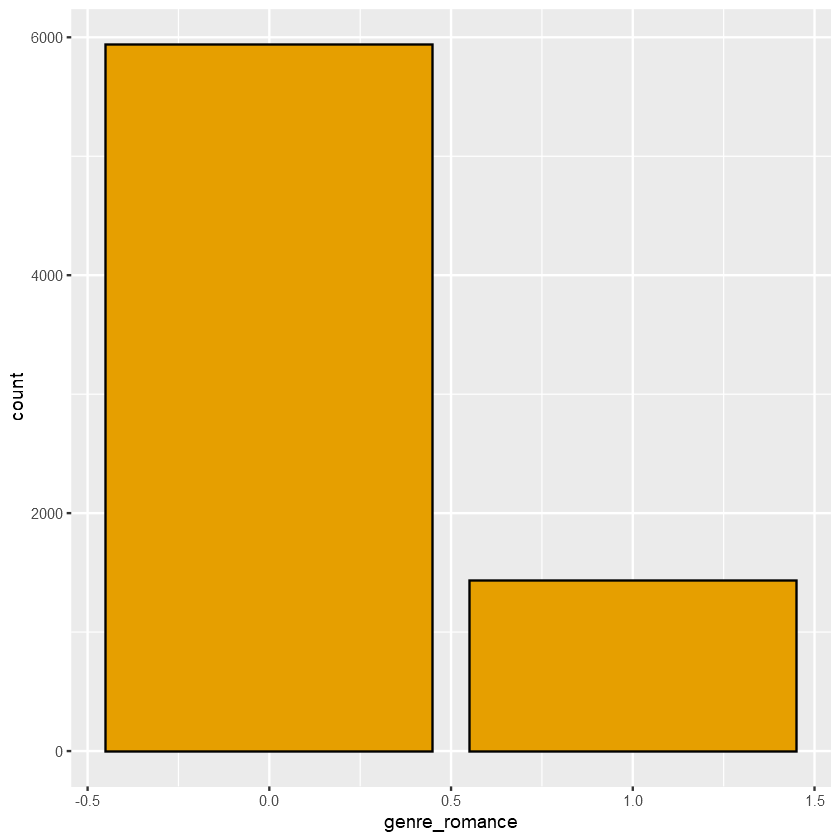

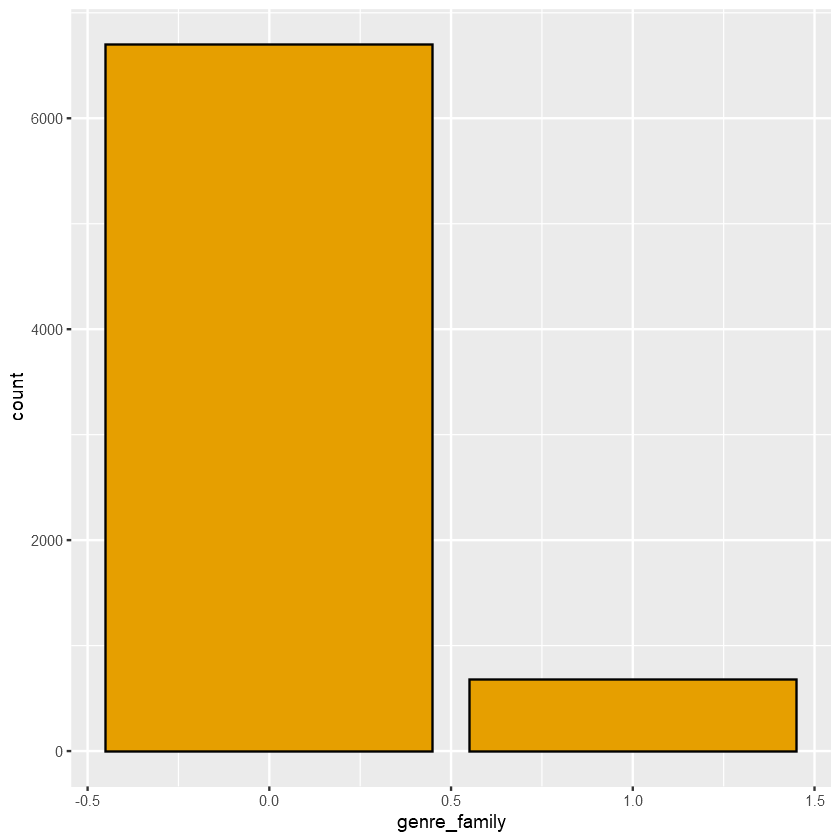

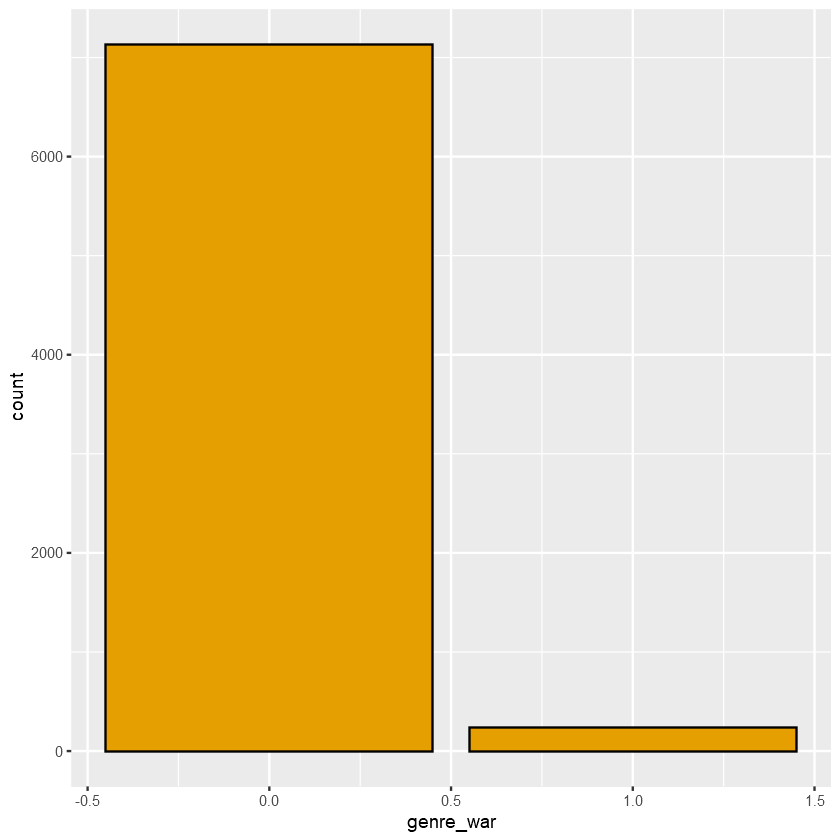

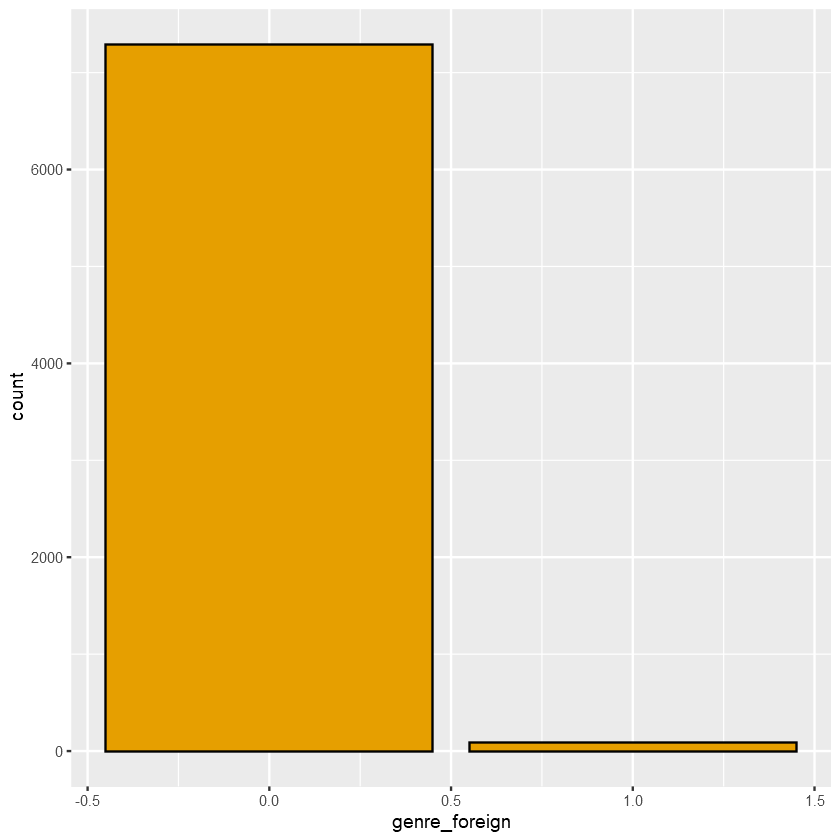

In [14]:
par(mfrow=c(2,5))

nm <- names(movies_ff[,1:84])

for (i in 44:62) {
    x <- movies_ff[,i]
    print( ggplot(movies_ff, aes(x)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    xlab(nm[i]) +
    theme_get())
    }

### Departments Analysis

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."
Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


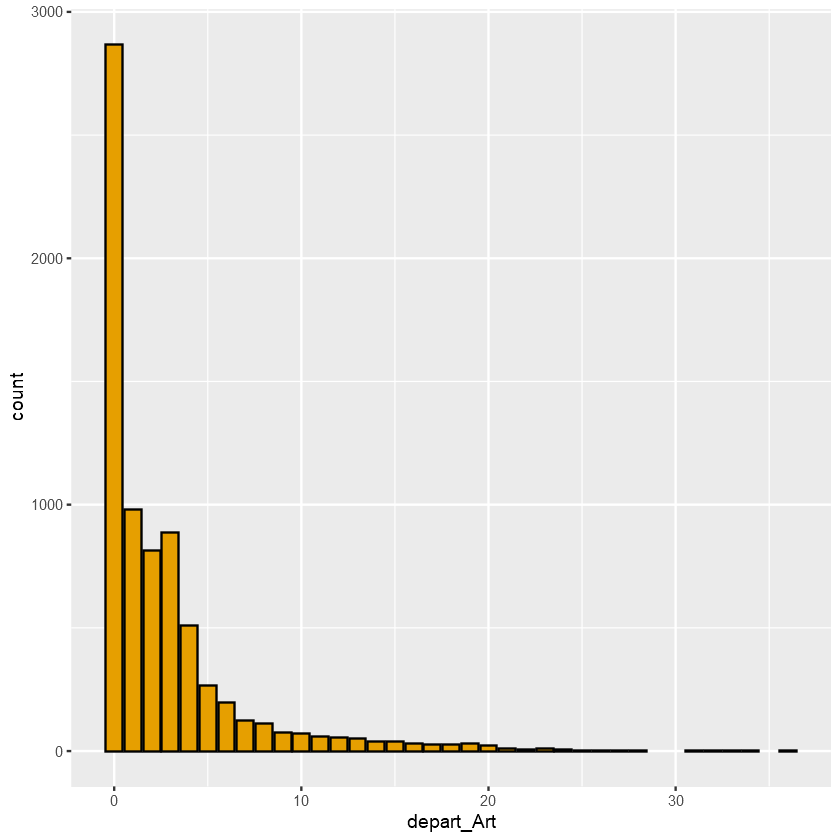

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


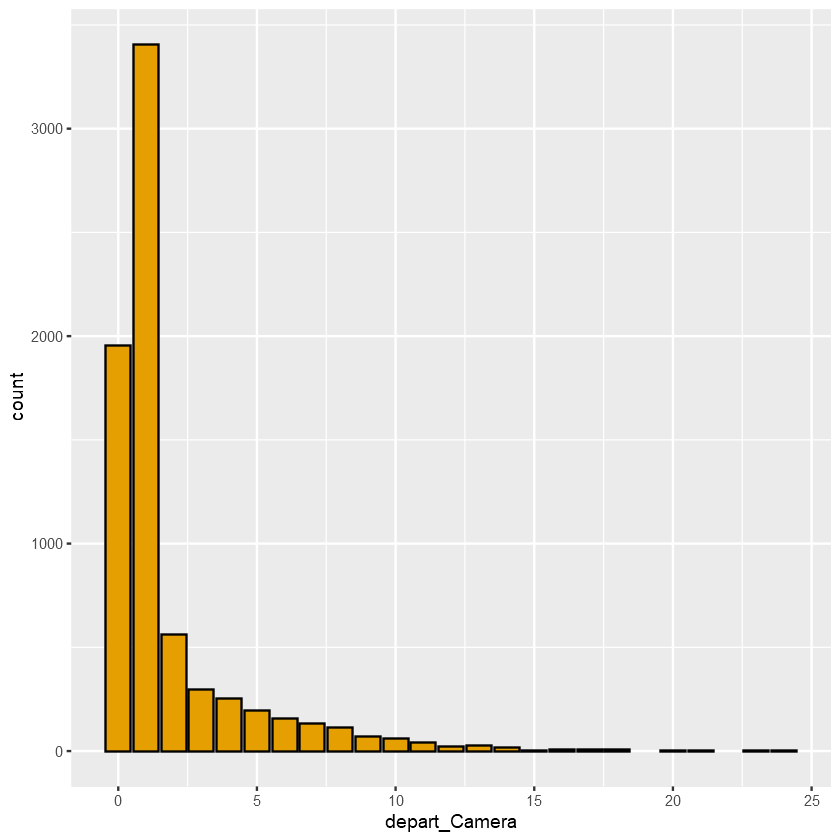

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


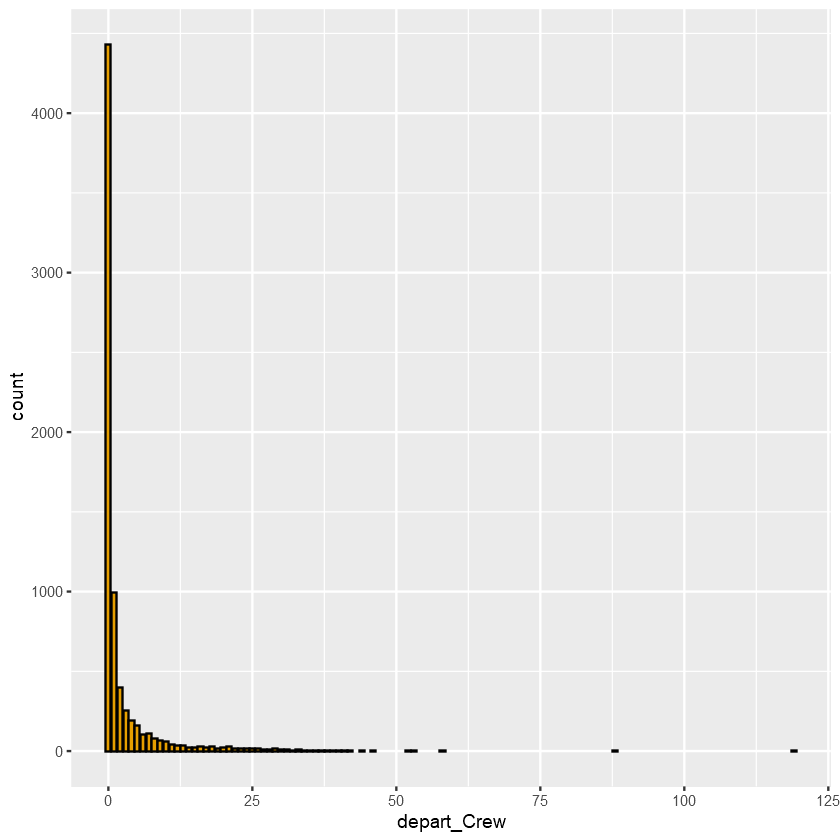

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


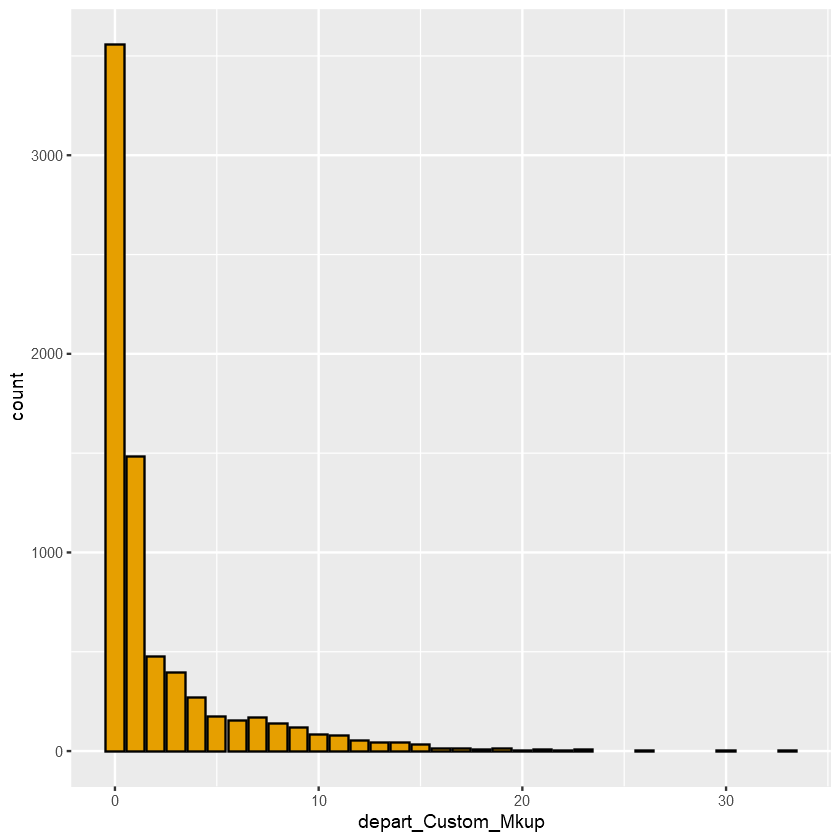

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


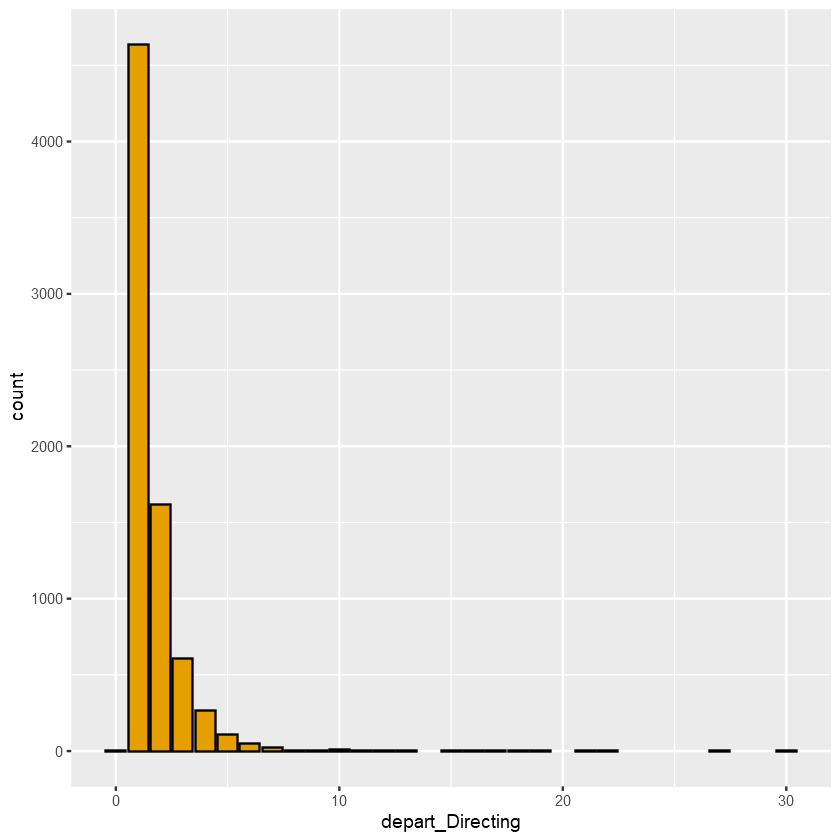

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


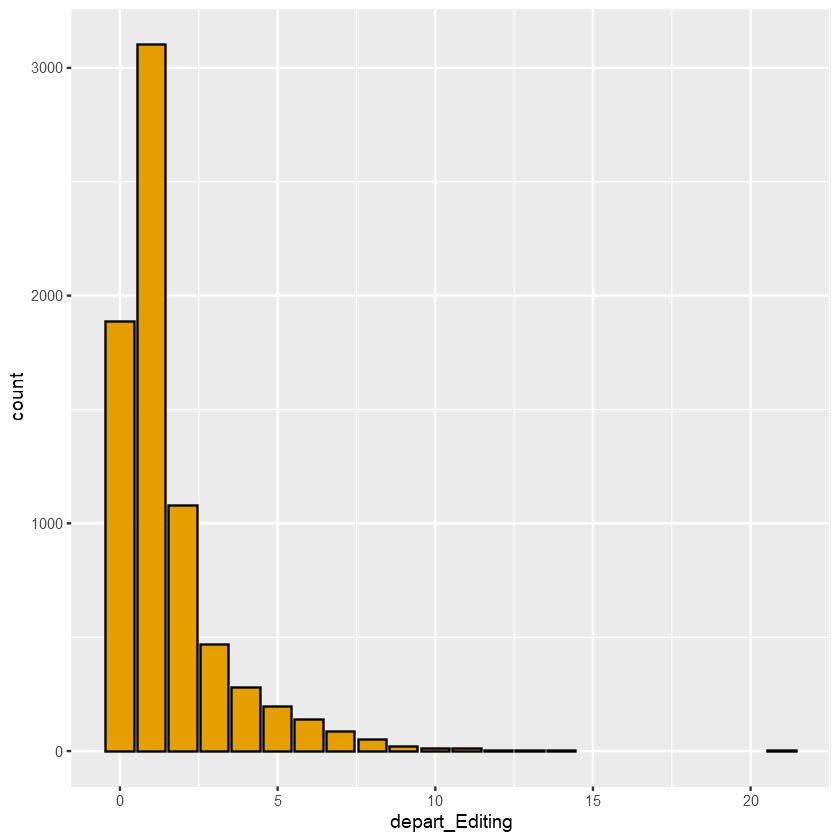

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


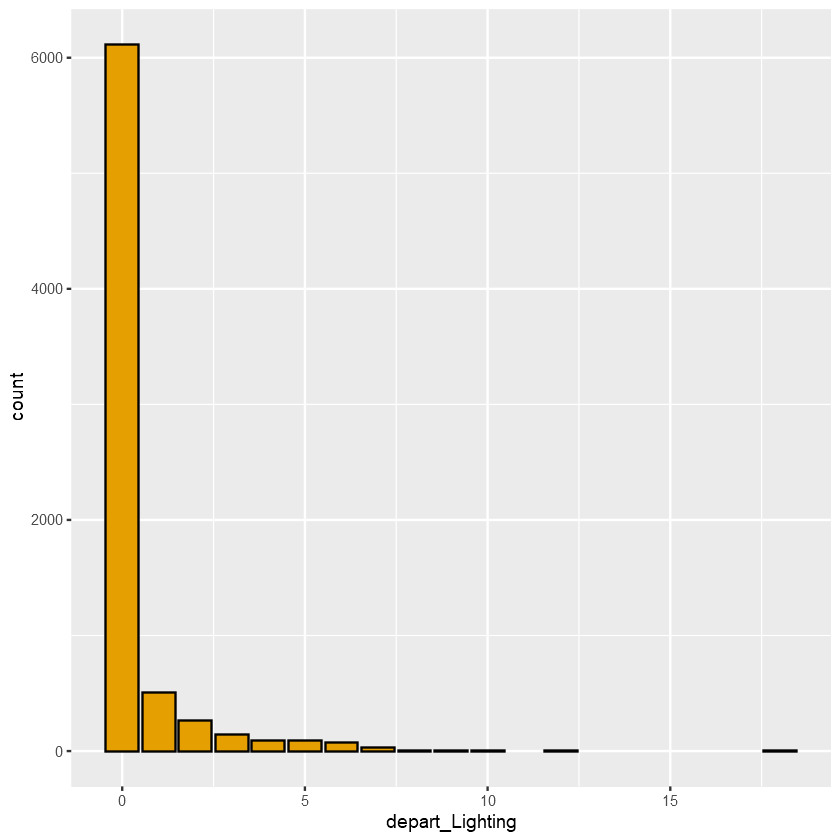

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


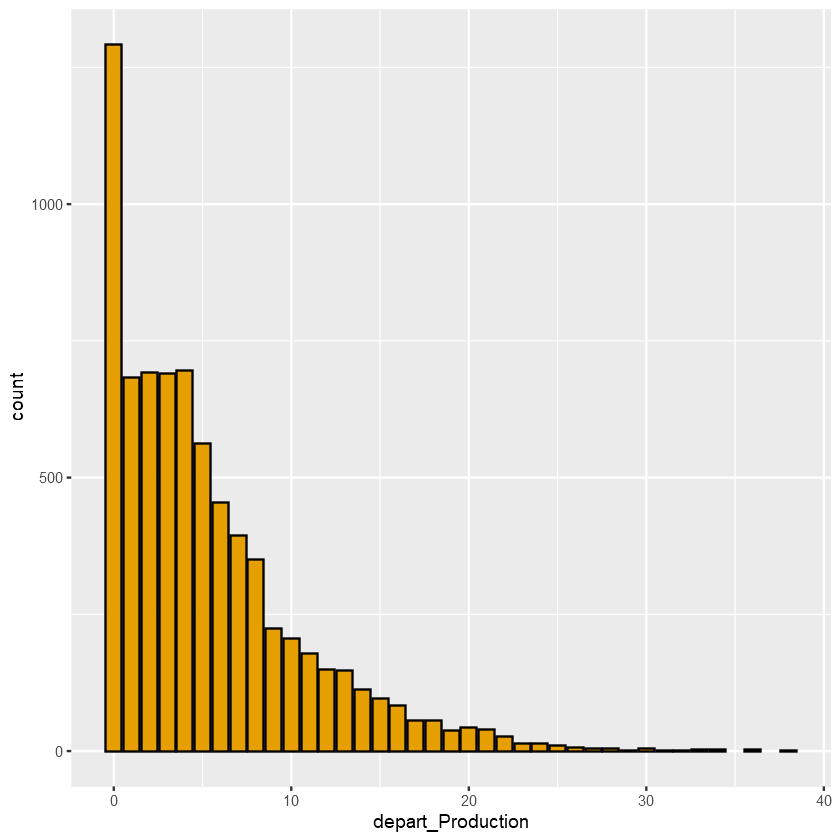

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


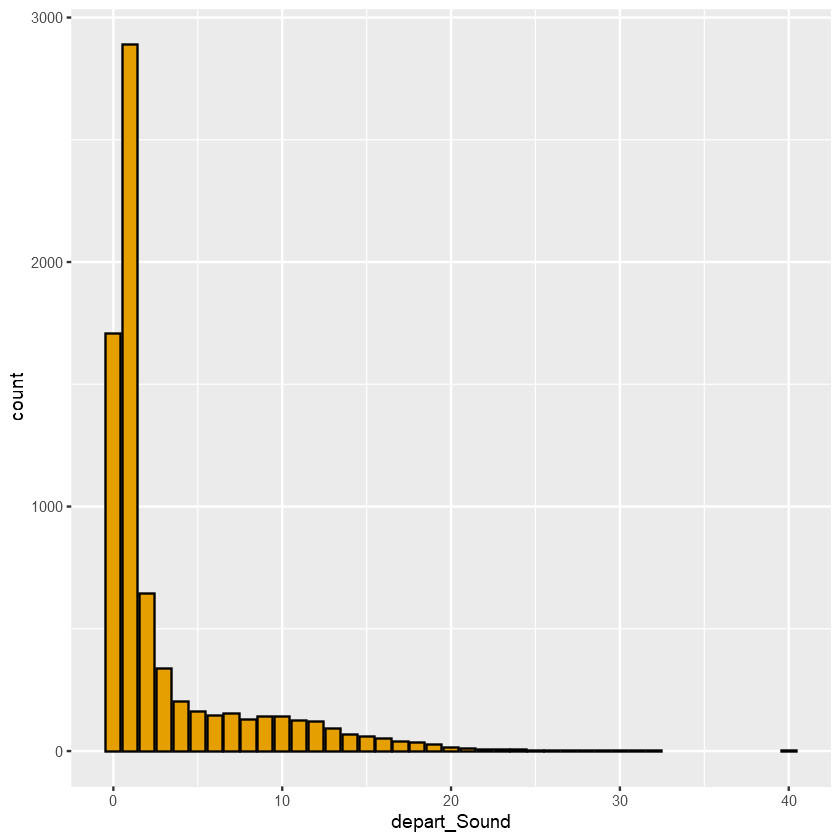

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


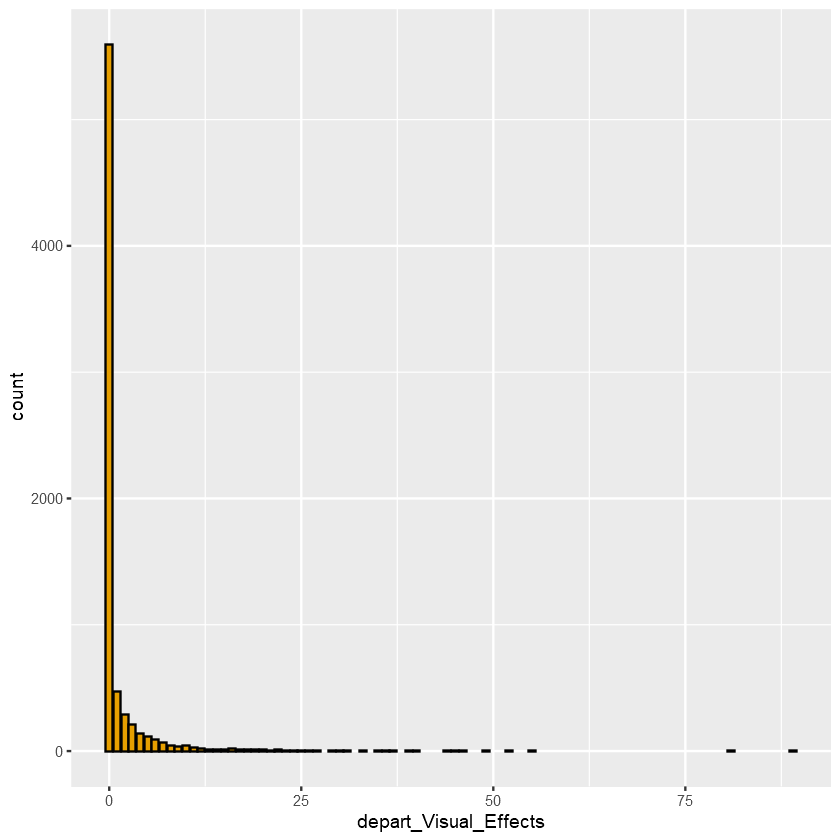

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


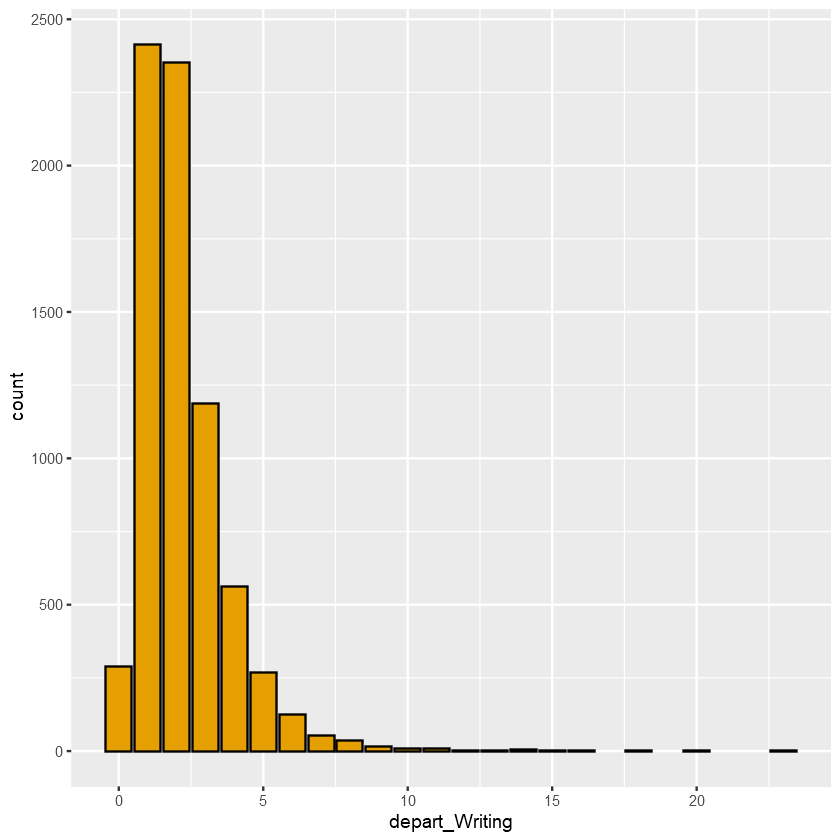

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


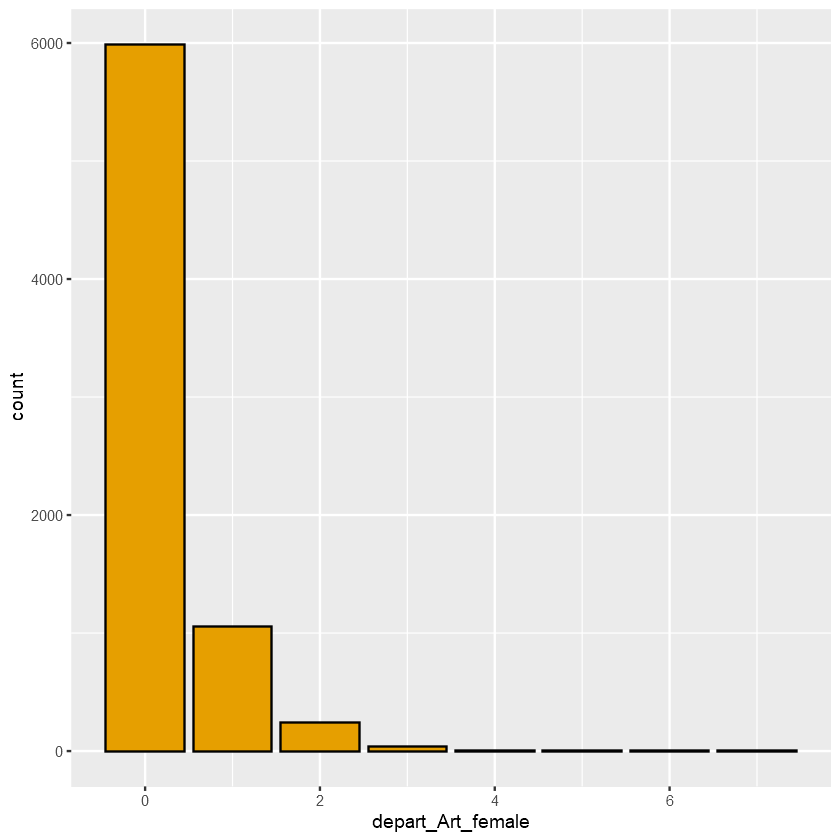

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


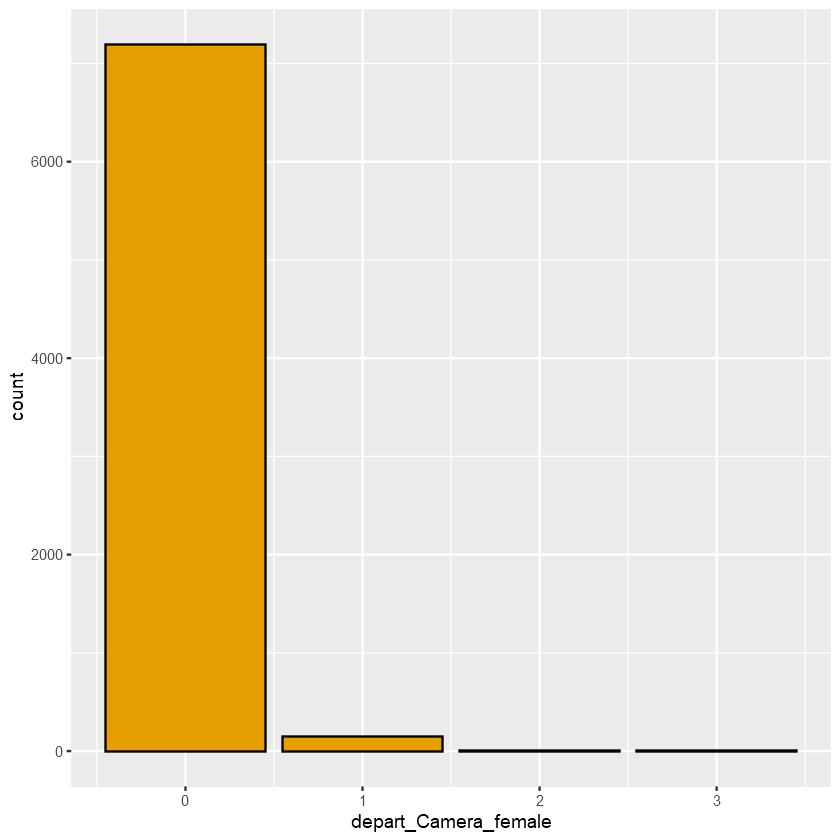

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


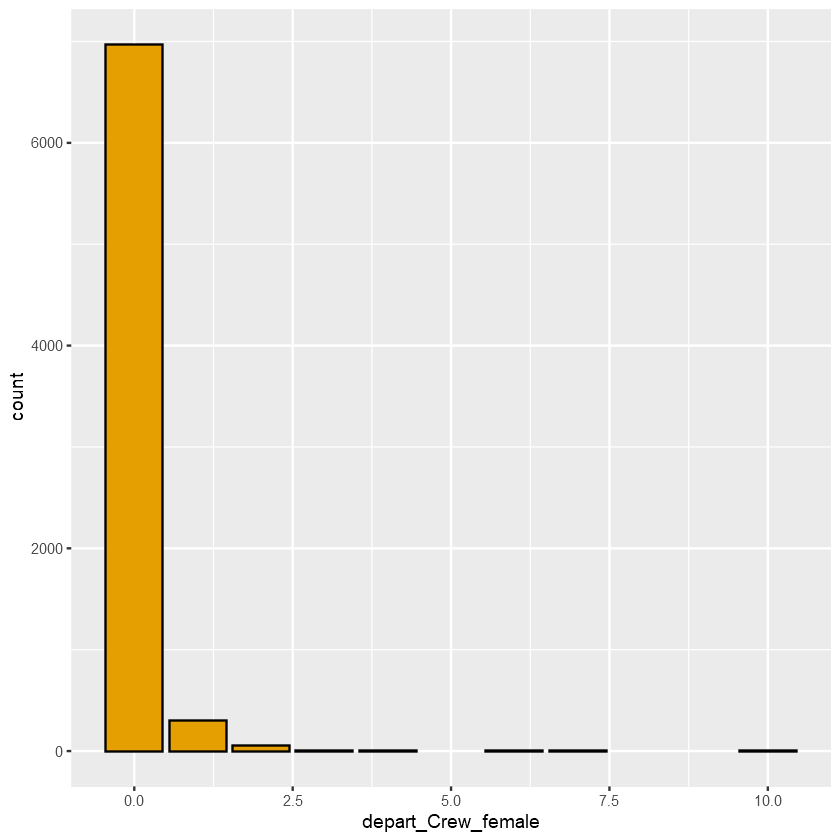

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


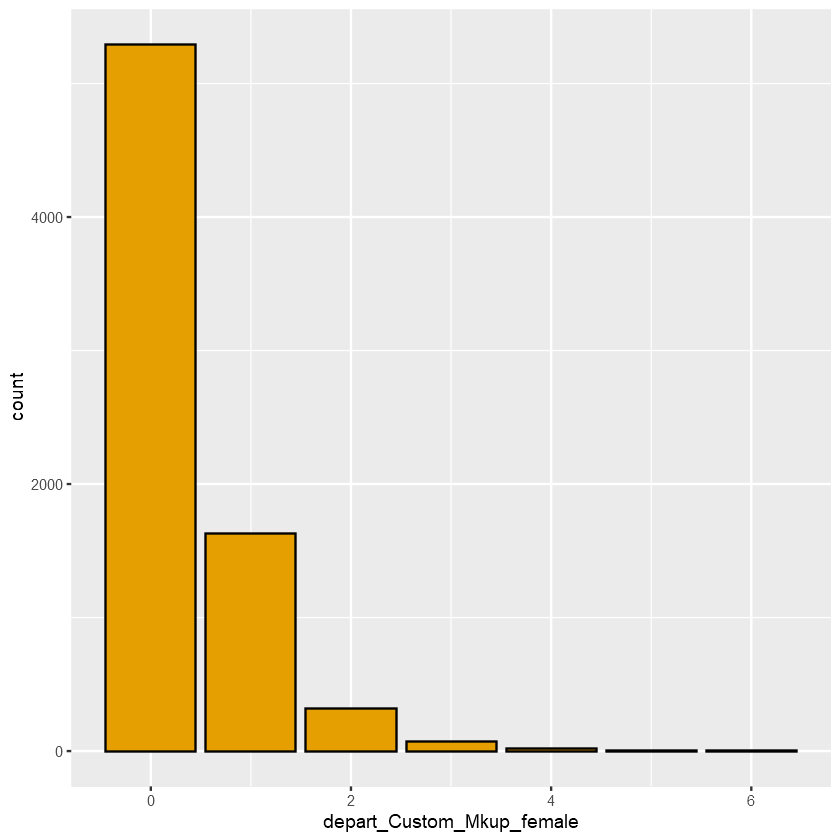

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


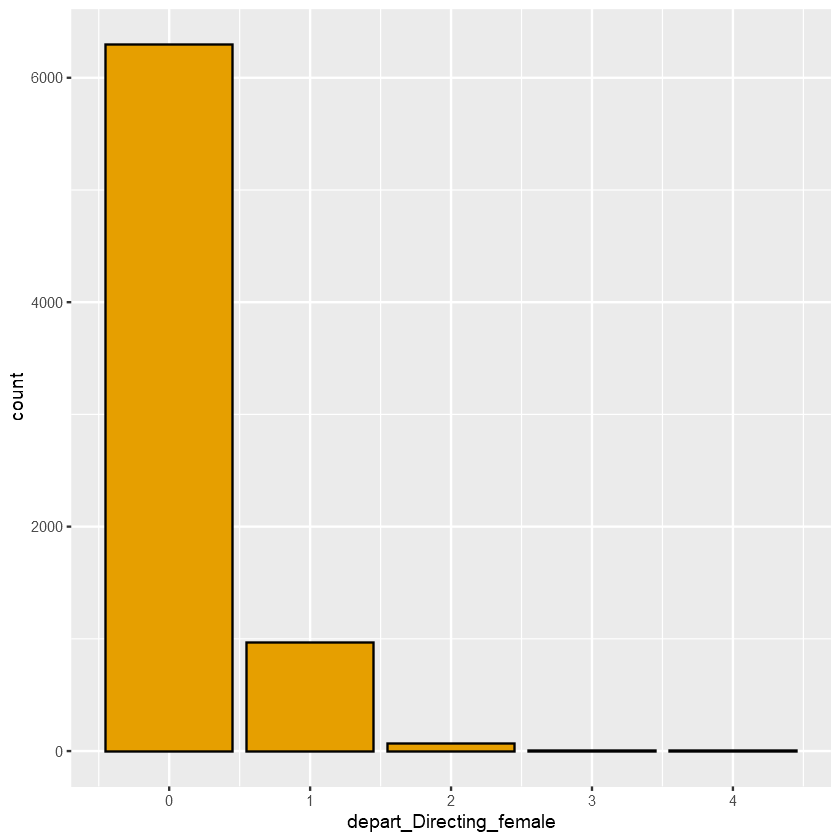

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


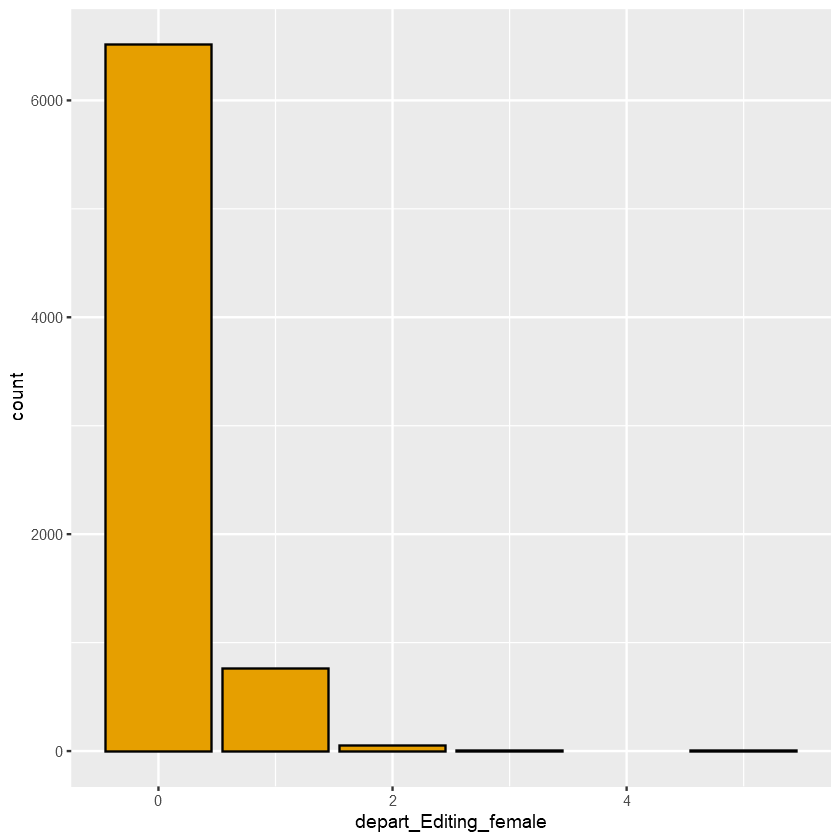

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


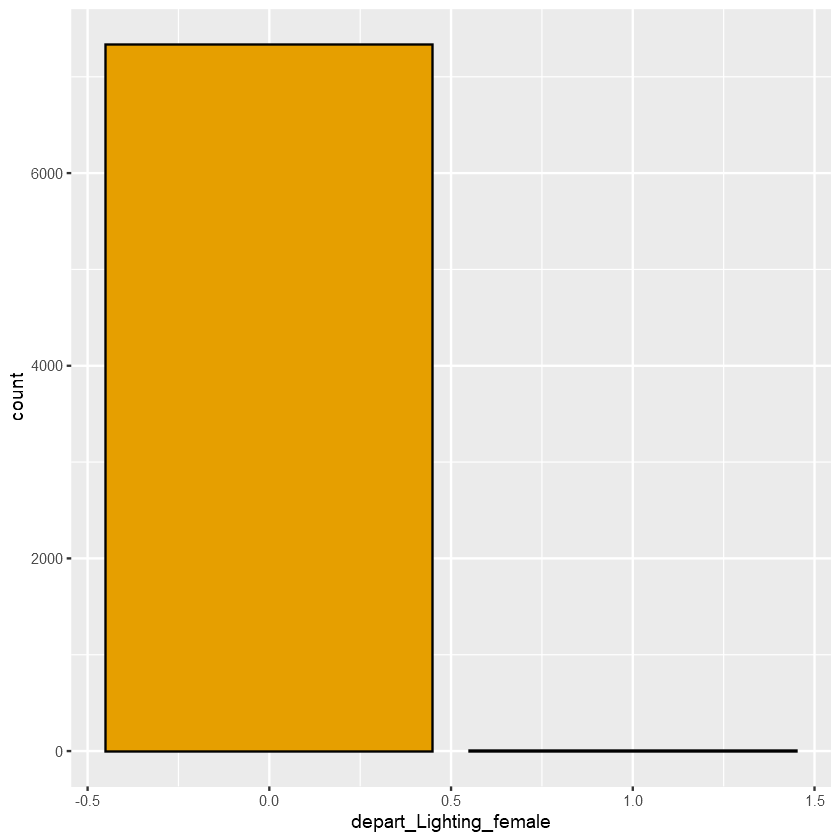

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


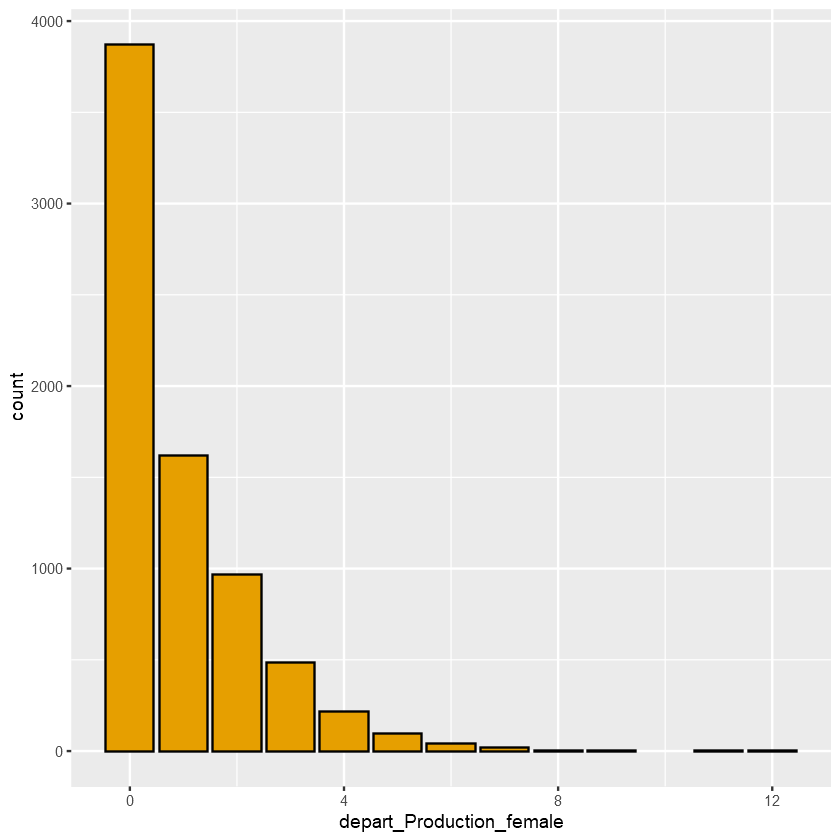

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


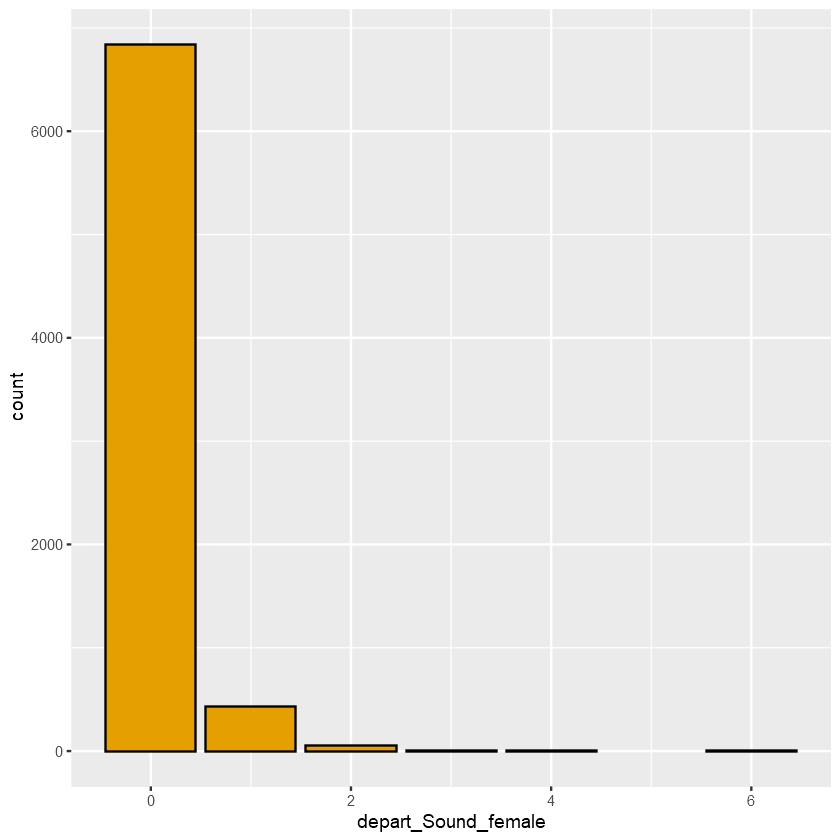

Warning message:
"Removed 34 rows containing non-finite values (stat_count)."


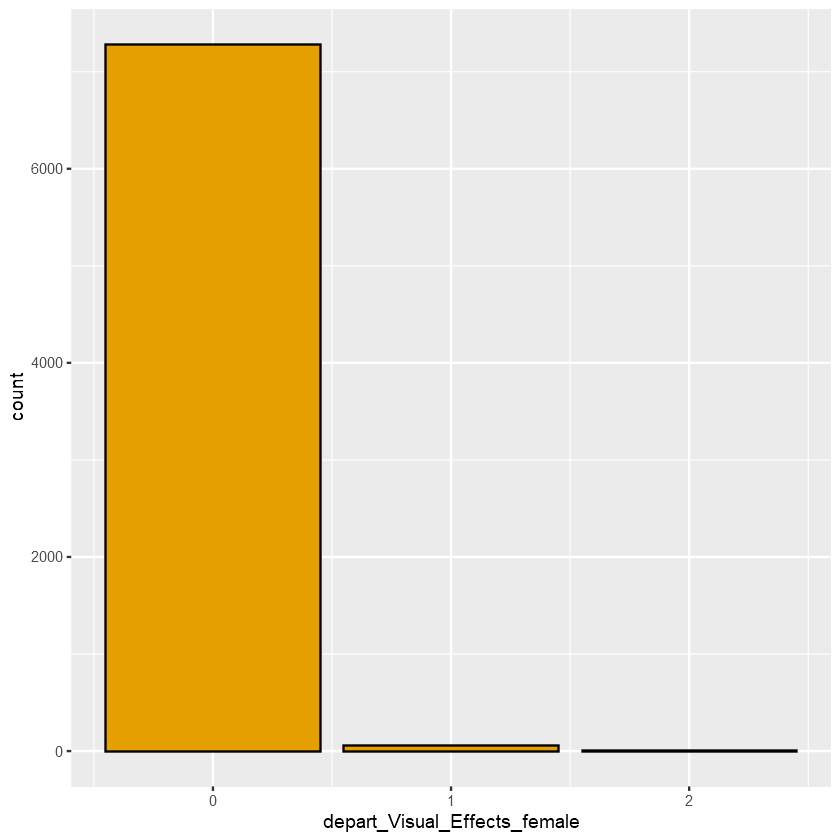

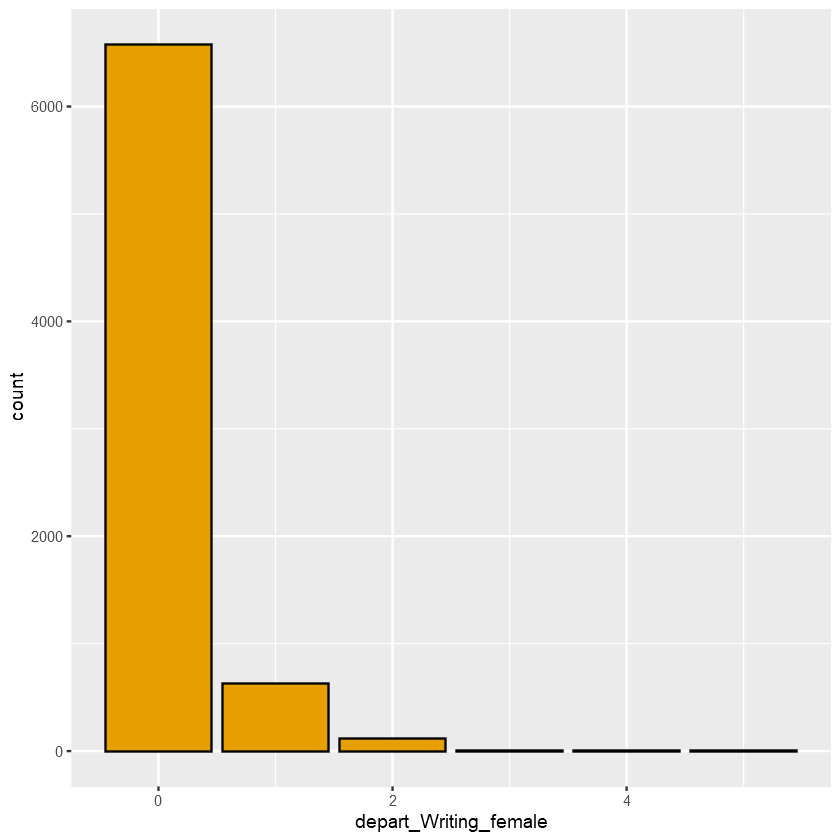

In [15]:
par(mfrow=c(2,5))

nm <- names(movies_ff[,1:84])

for (i in 63:84) {
    x <- movies_ff[,i]
    print( ggplot(movies_ff, aes(x)) + 
    geom_bar(color = "black", fill = "#E69F00")  +
    xlab(nm[i]) +
    theme_get())

}

Warning message:
"Removed 34 rows containing missing values (geom_point)."
Warning message:
"Removed 34 rows containing missing values (geom_point)."


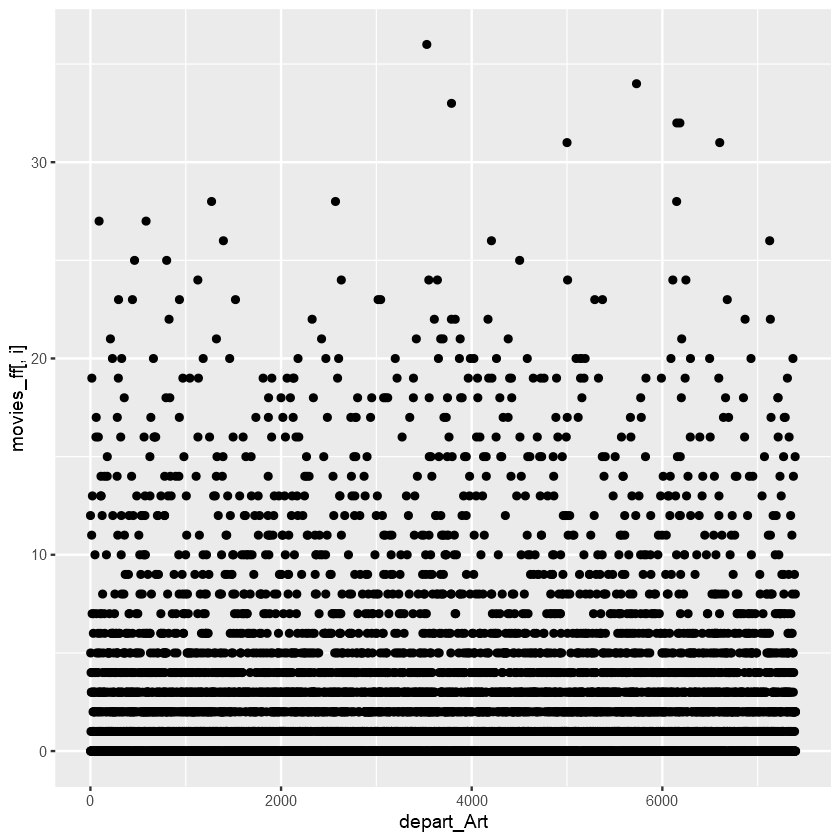

Warning message:
"Removed 34 rows containing missing values (geom_point)."


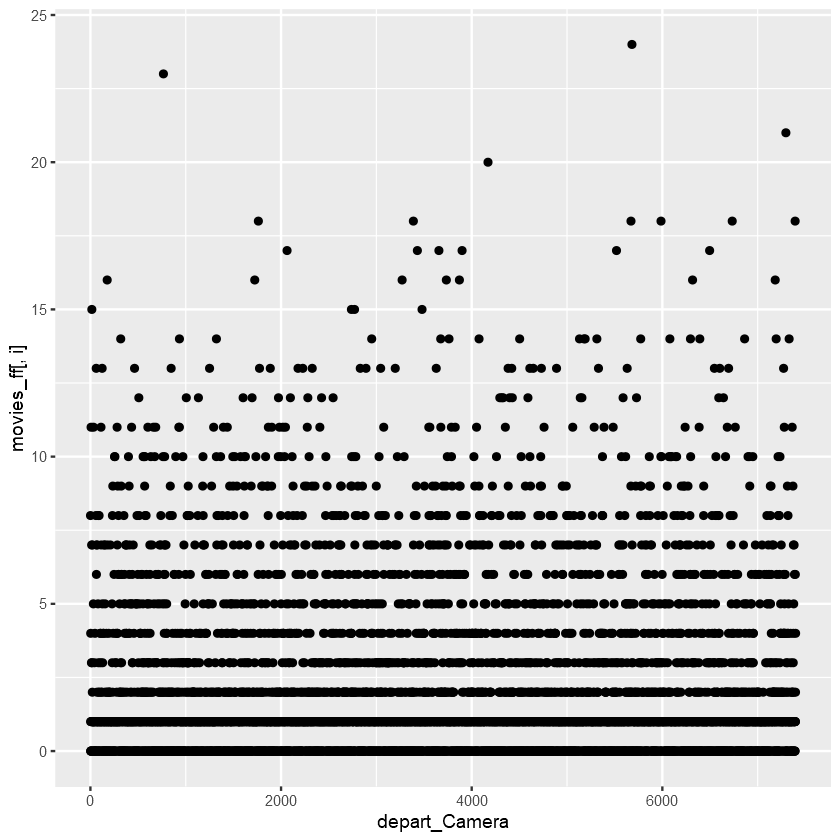

Warning message:
"Removed 34 rows containing missing values (geom_point)."


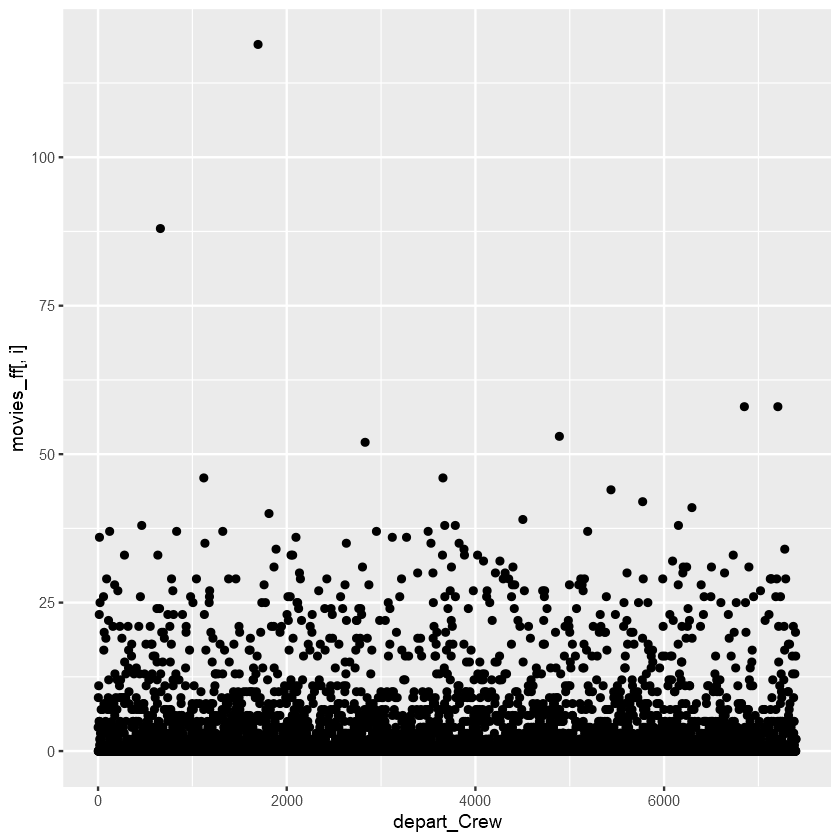

Warning message:
"Removed 34 rows containing missing values (geom_point)."


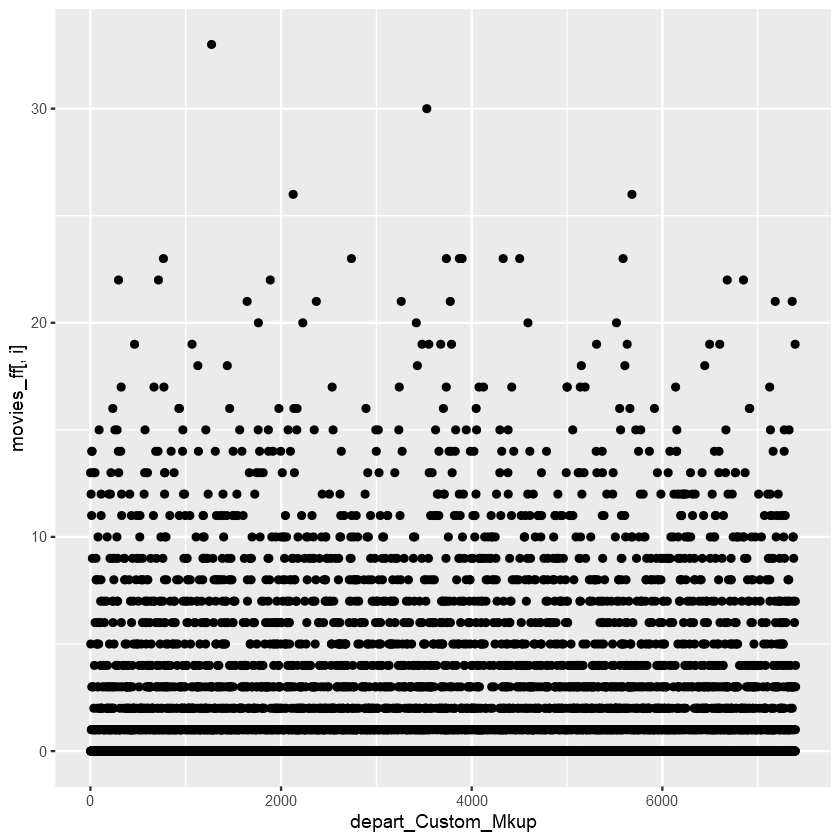

Warning message:
"Removed 34 rows containing missing values (geom_point)."


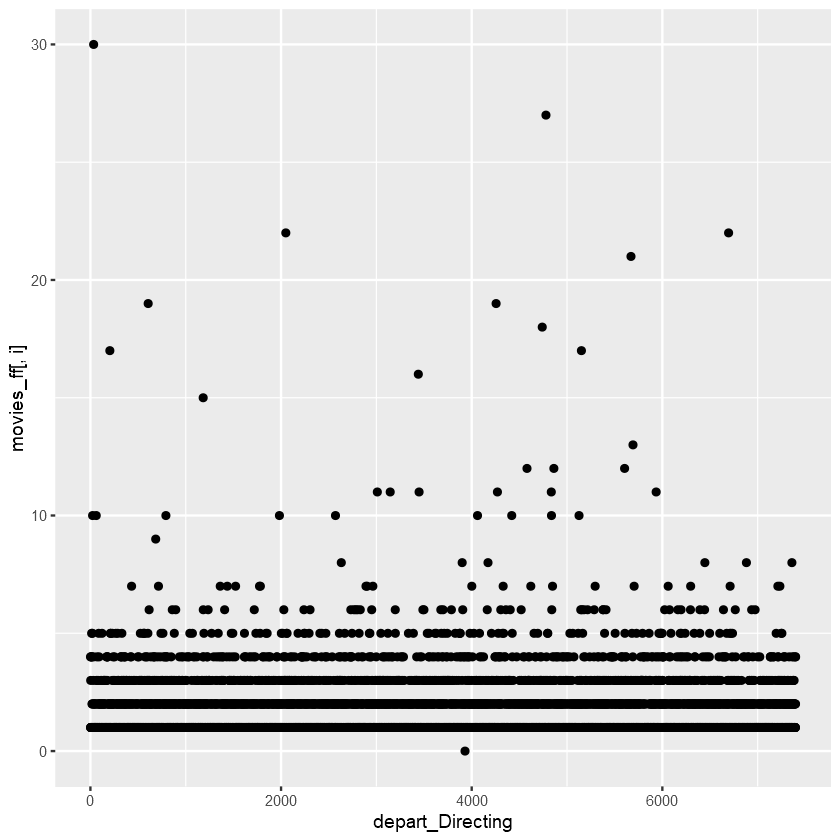

Warning message:
"Removed 34 rows containing missing values (geom_point)."


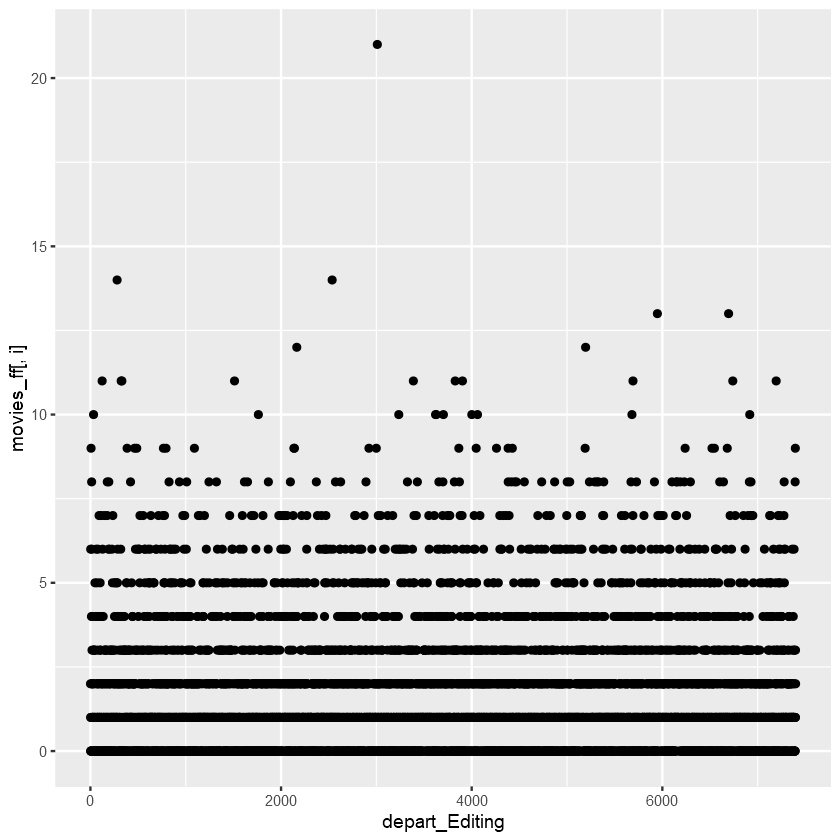

Warning message:
"Removed 34 rows containing missing values (geom_point)."


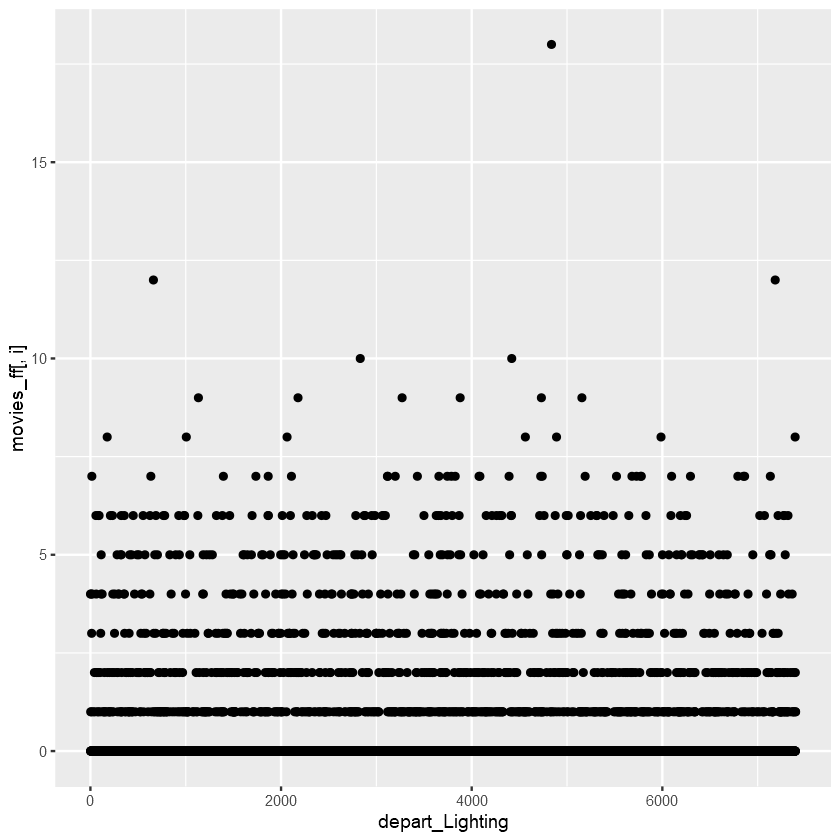

Warning message:
"Removed 34 rows containing missing values (geom_point)."


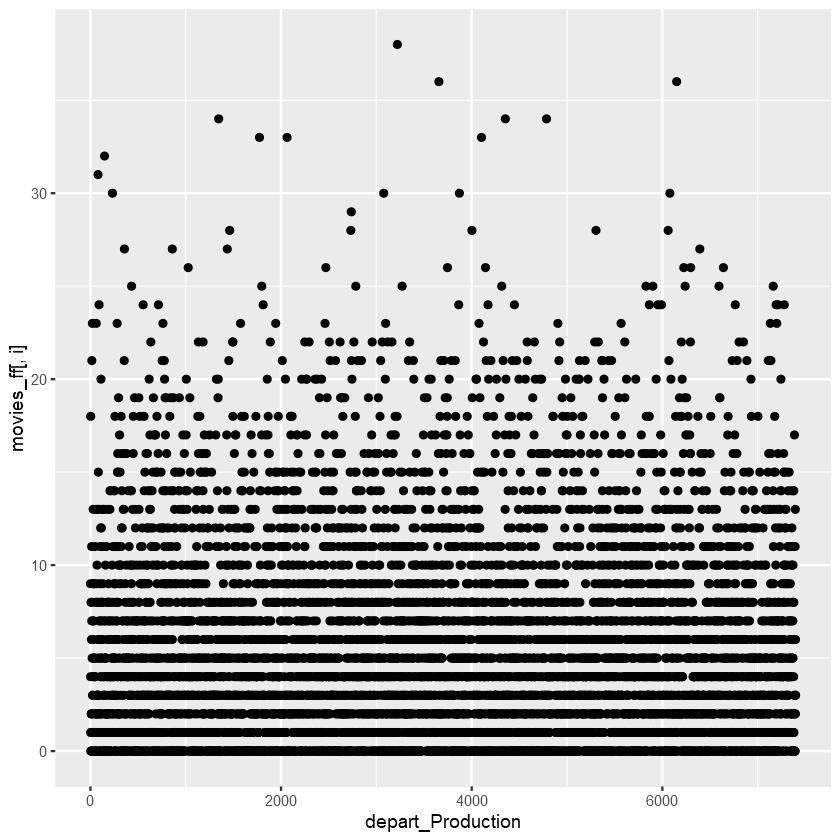

Warning message:
"Removed 34 rows containing missing values (geom_point)."


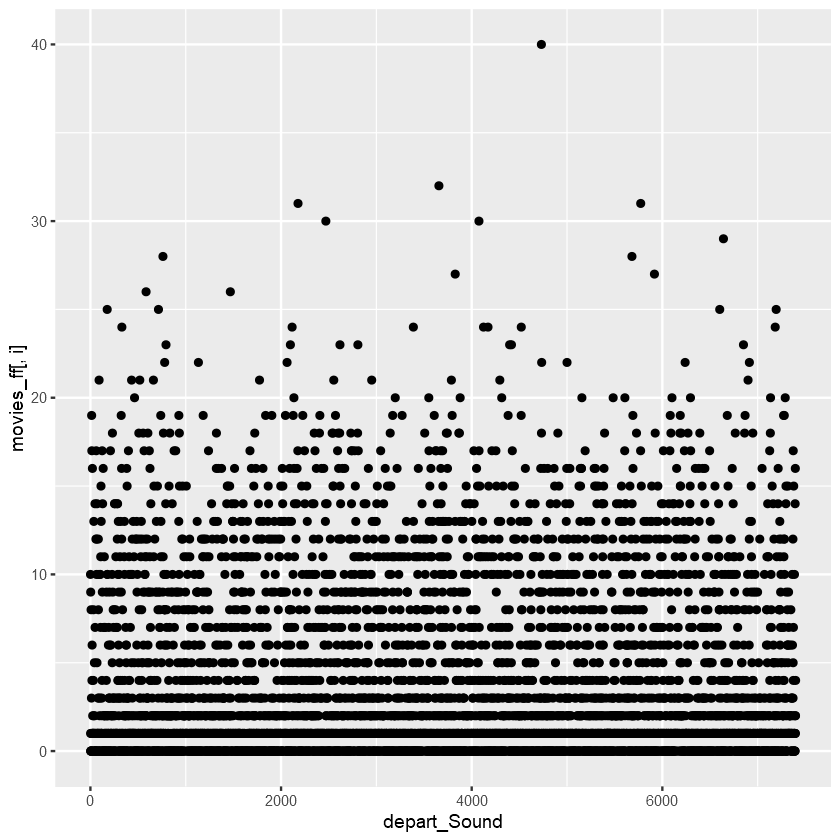

Warning message:
"Removed 34 rows containing missing values (geom_point)."


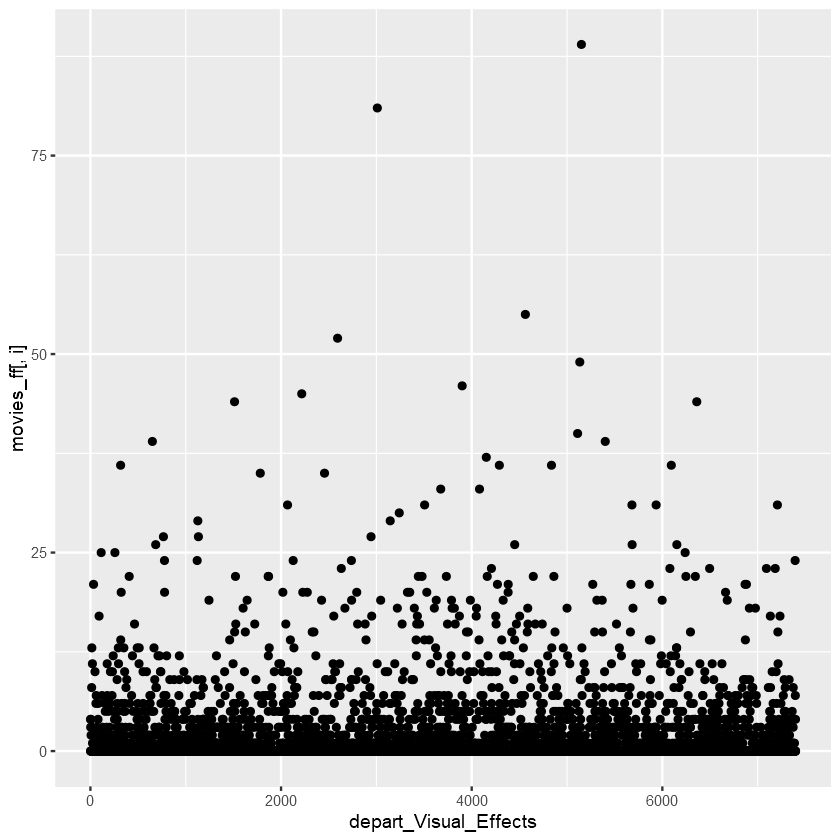

Warning message:
"Removed 34 rows containing missing values (geom_point)."


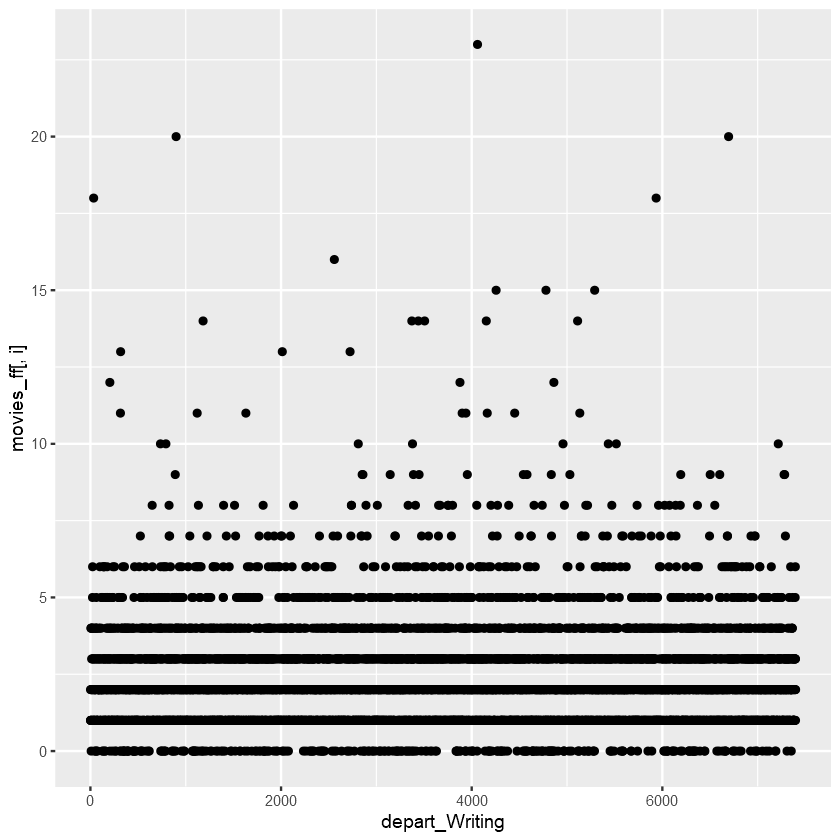

Warning message:
"Removed 34 rows containing missing values (geom_point)."


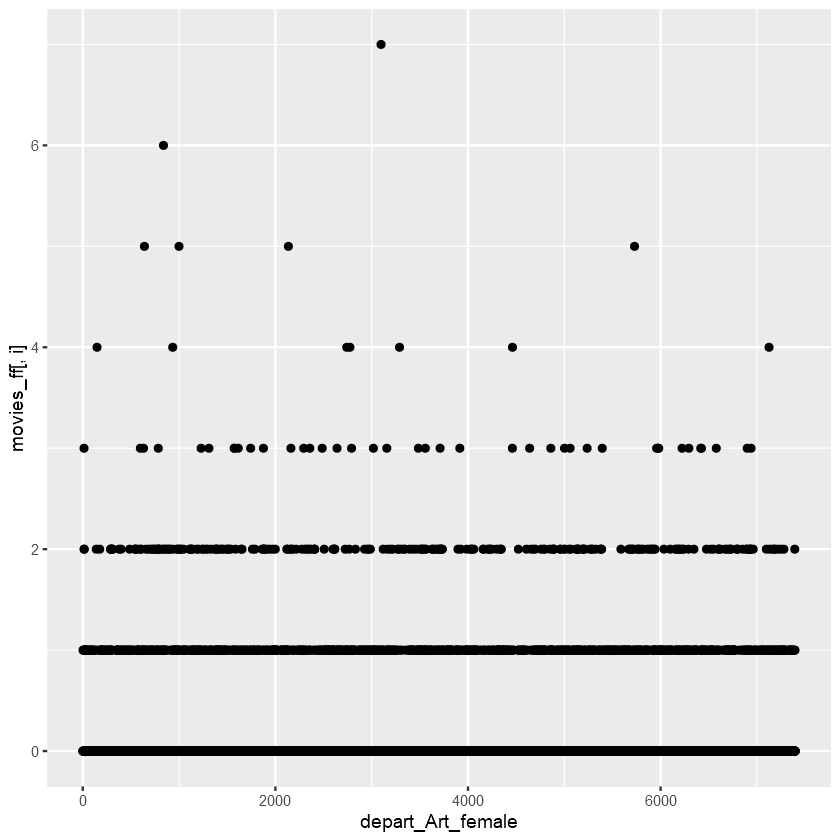

Warning message:
"Removed 34 rows containing missing values (geom_point)."


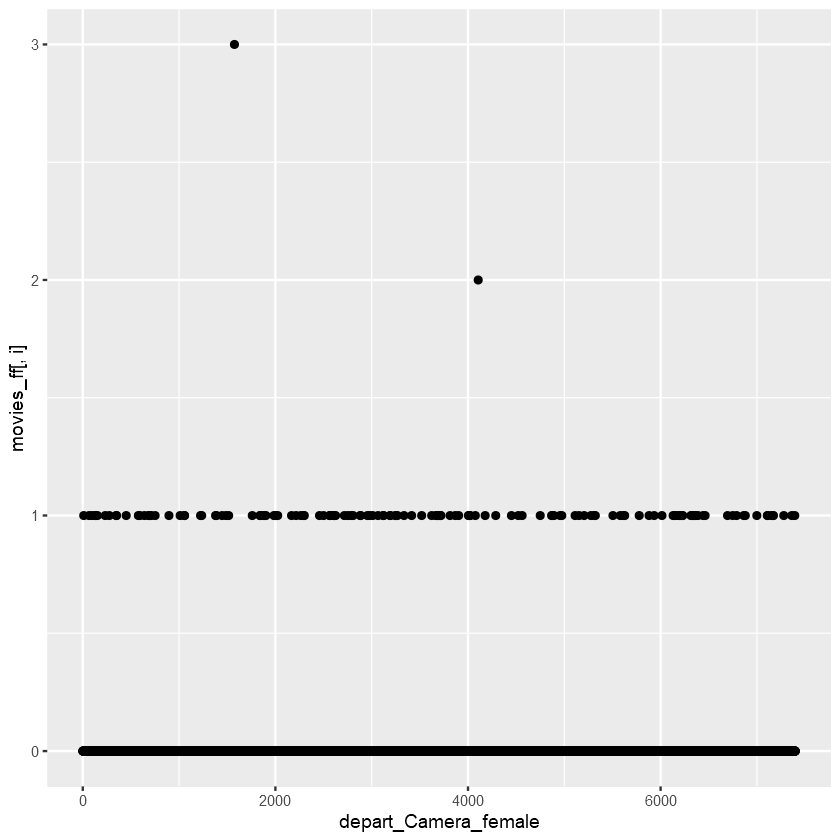

Warning message:
"Removed 34 rows containing missing values (geom_point)."


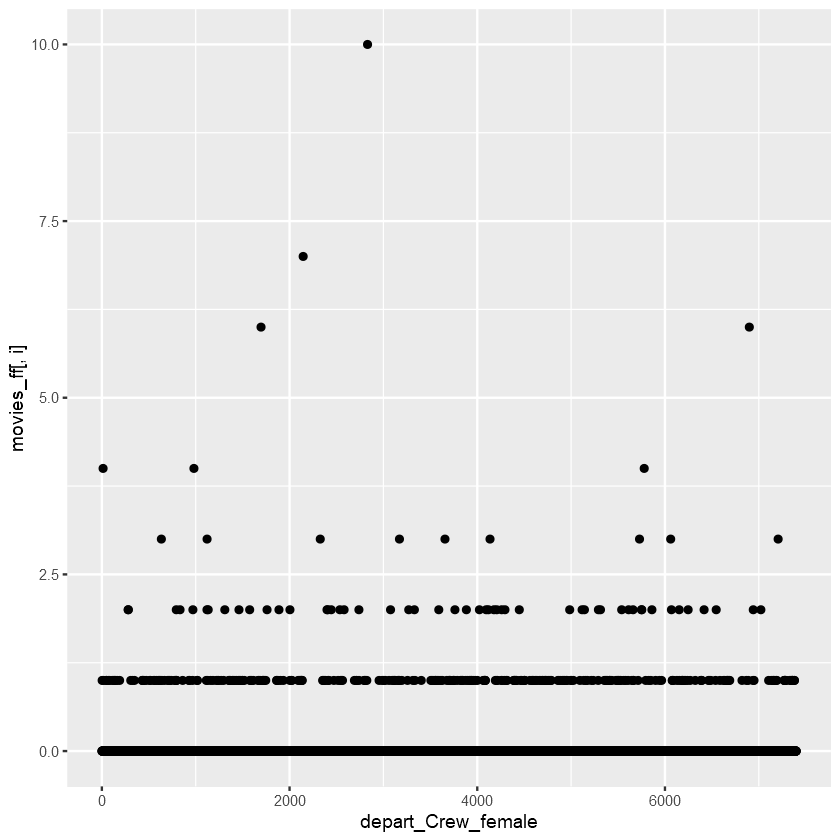

Warning message:
"Removed 34 rows containing missing values (geom_point)."


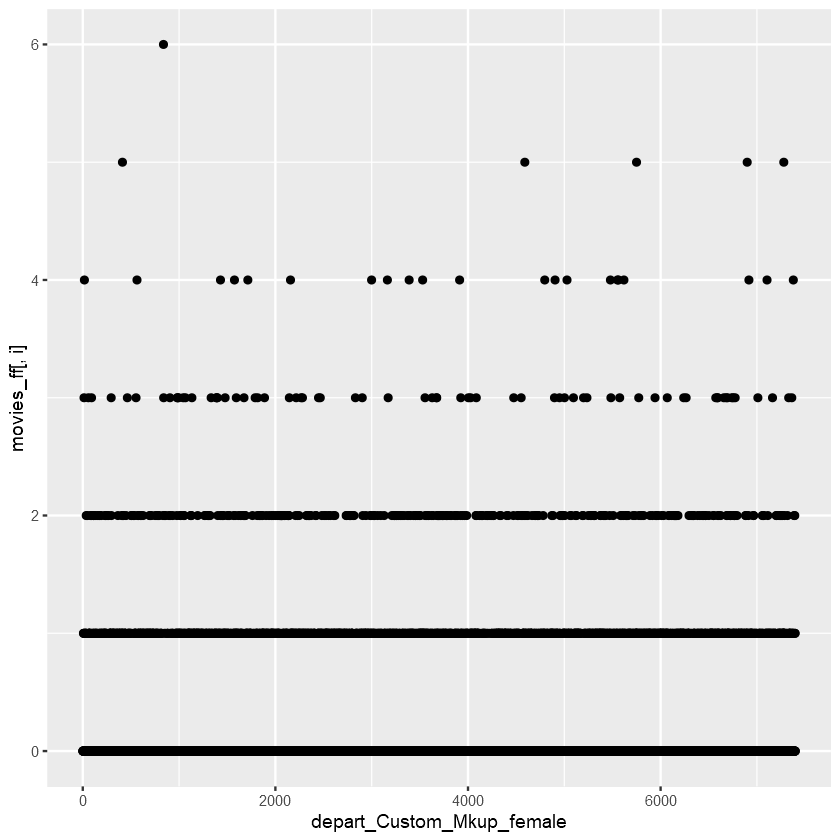

Warning message:
"Removed 34 rows containing missing values (geom_point)."


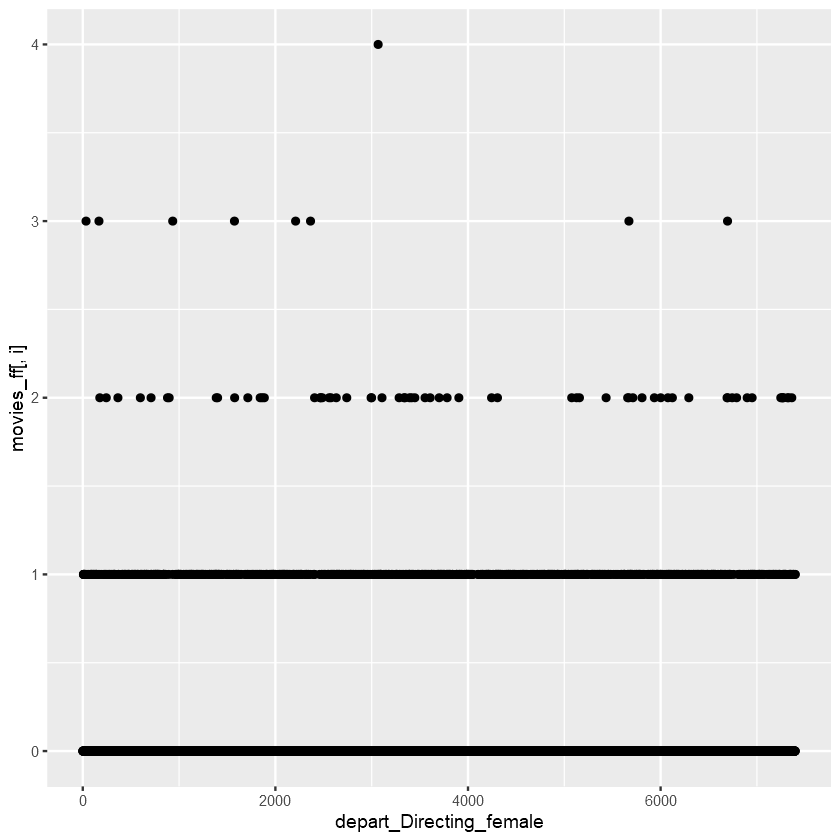

Warning message:
"Removed 34 rows containing missing values (geom_point)."


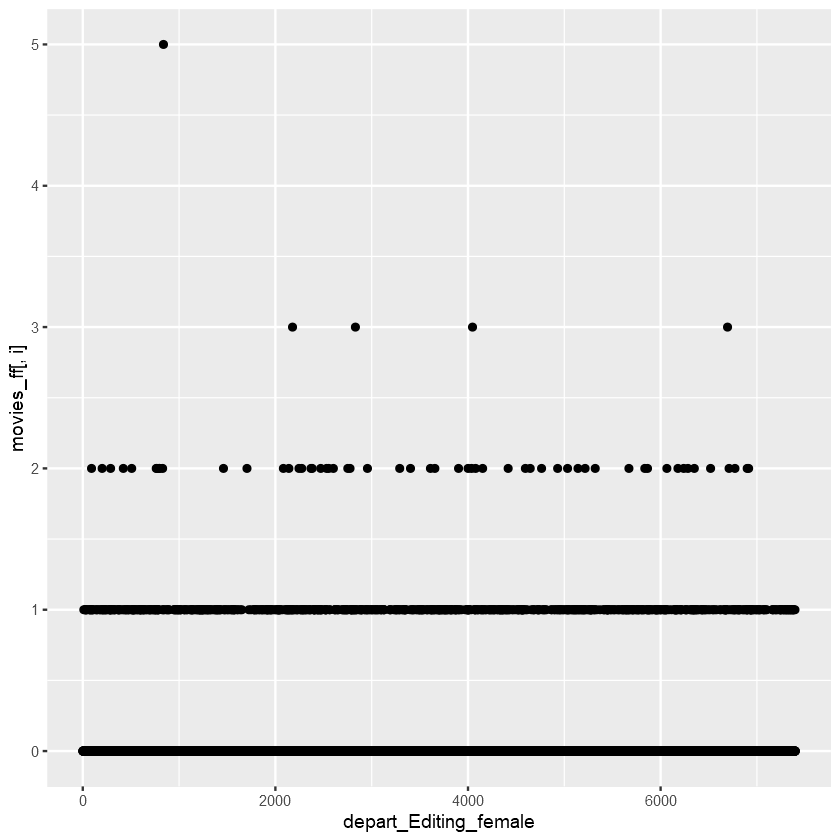

Warning message:
"Removed 34 rows containing missing values (geom_point)."


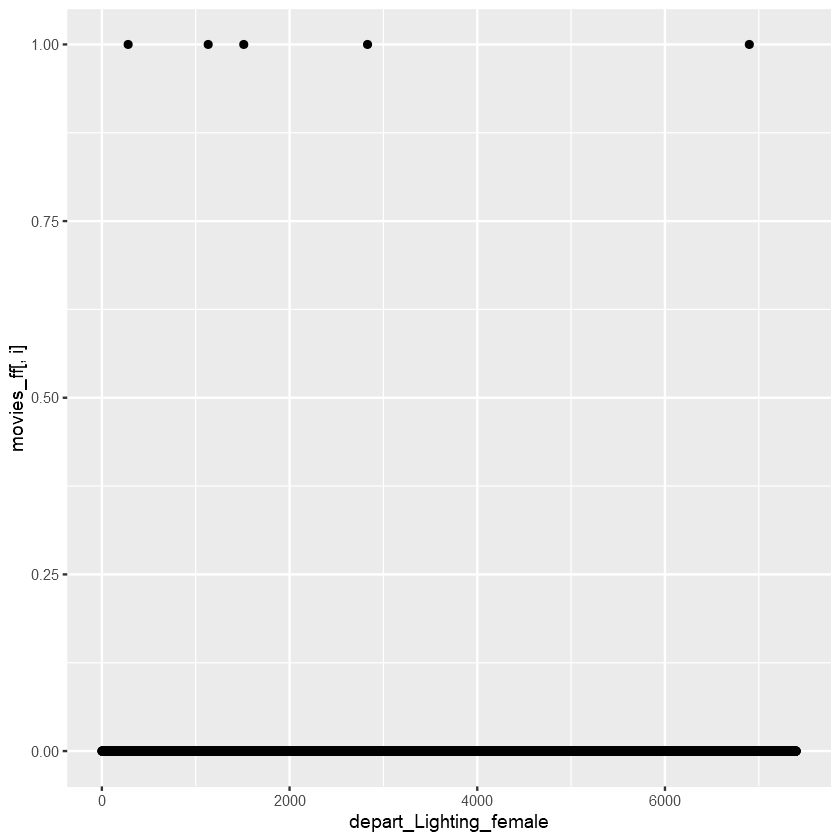

Warning message:
"Removed 34 rows containing missing values (geom_point)."


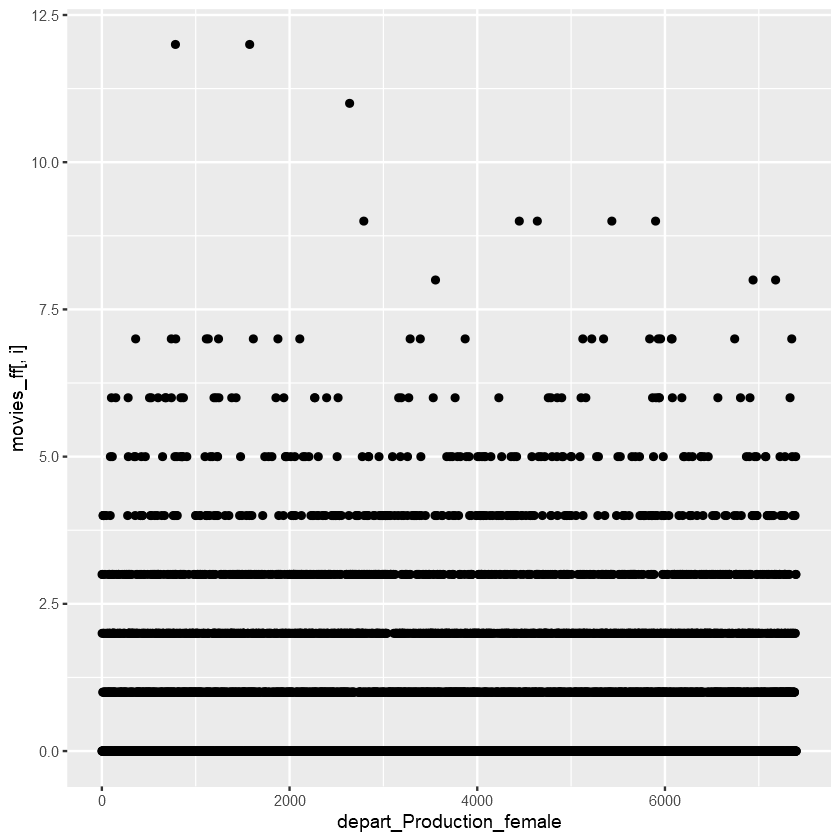

Warning message:
"Removed 34 rows containing missing values (geom_point)."


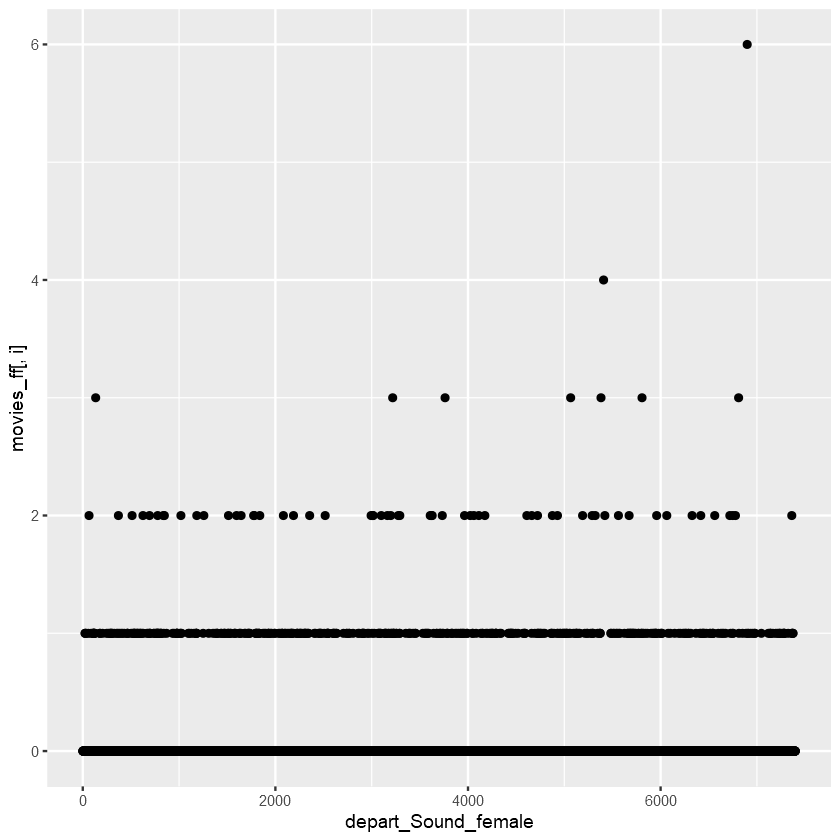

Warning message:
"Removed 34 rows containing missing values (geom_point)."


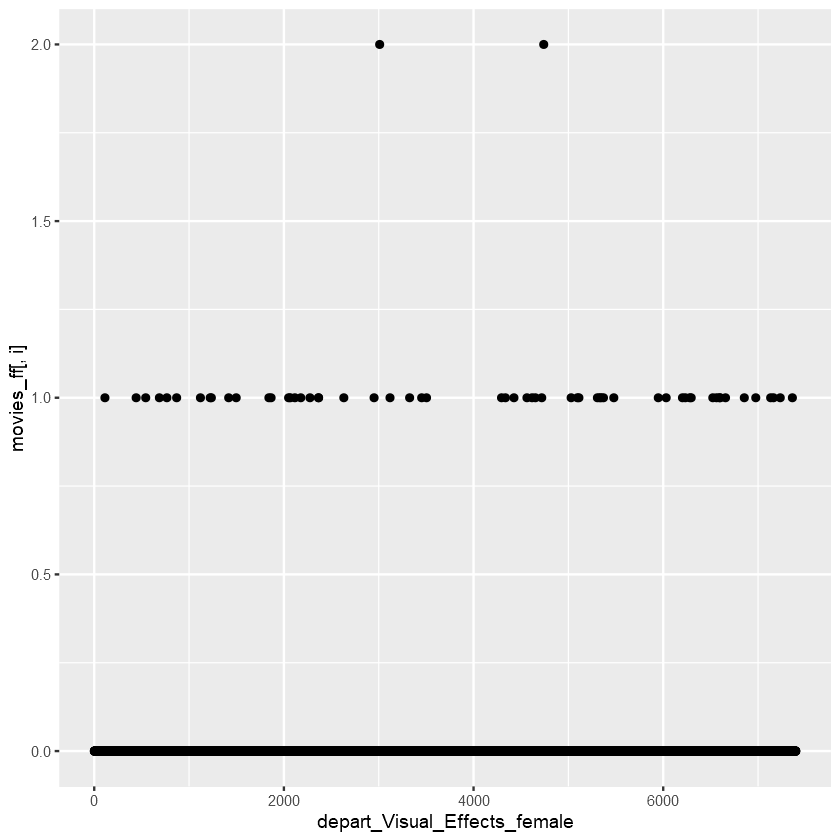

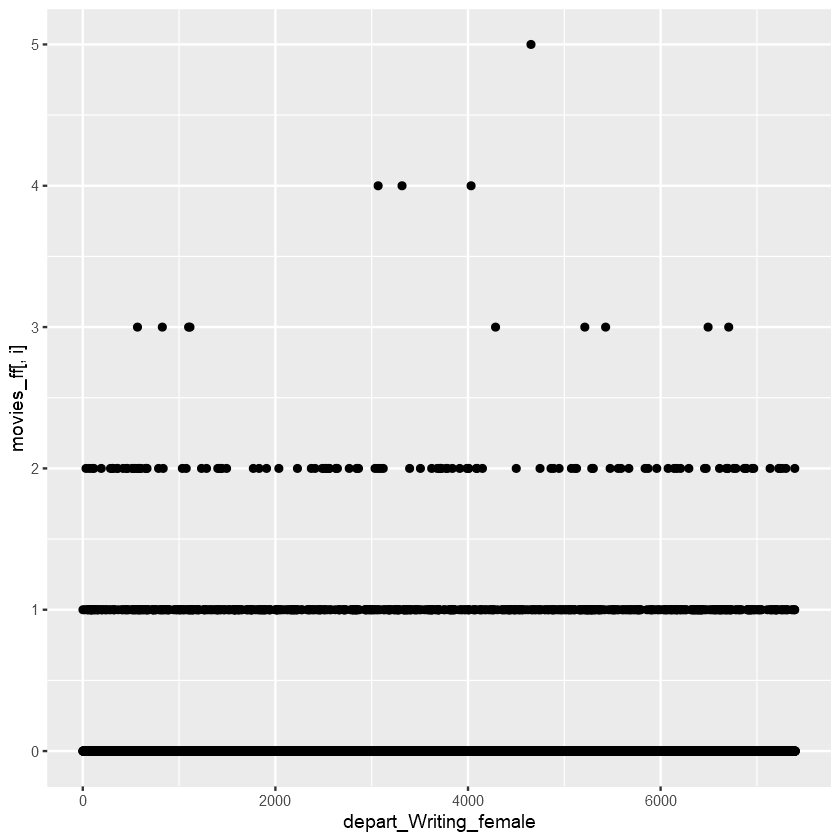

In [16]:
par(mfrow=c(2,5))

for (i in 63:84) {
    print(ggplot(data=movies_ff) +
          geom_point(aes(x=movie_id, y=movies_ff[,i])) +
          xlab(nm[i]))
} 


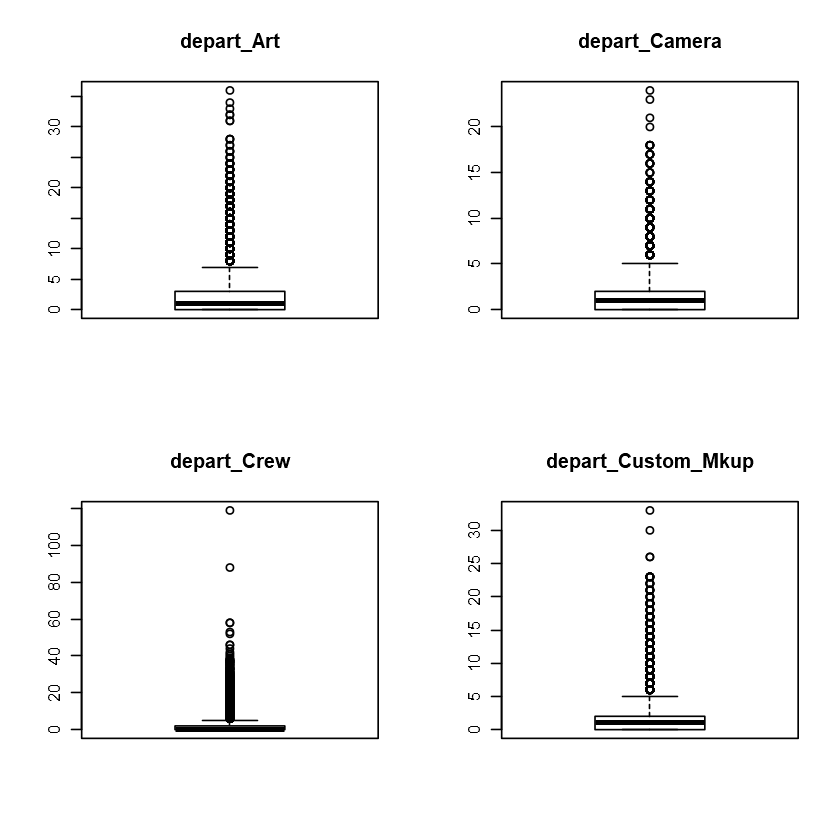

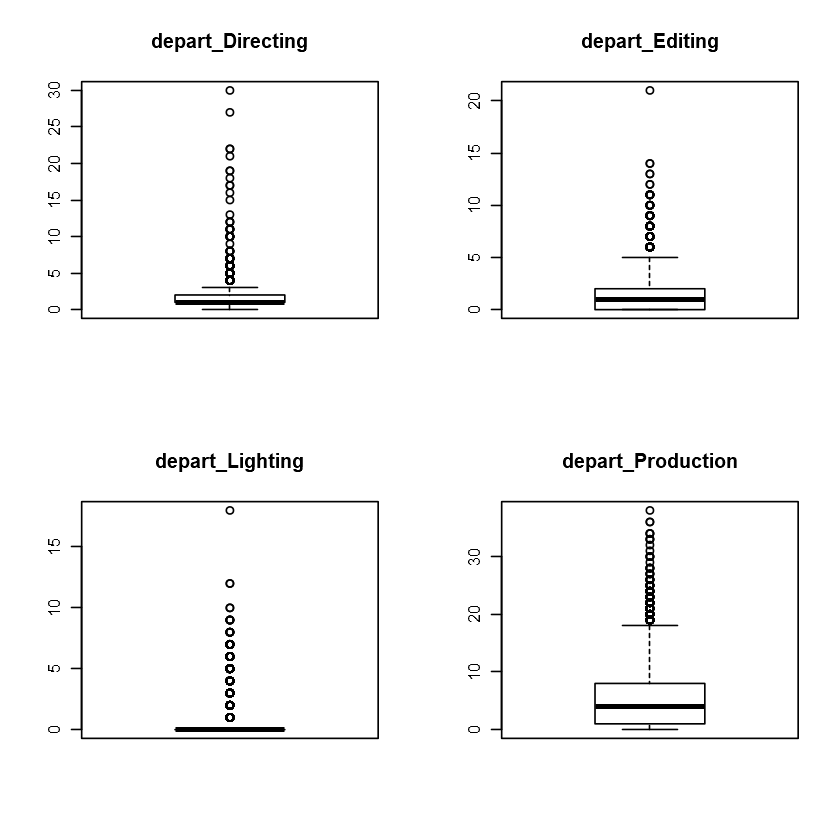

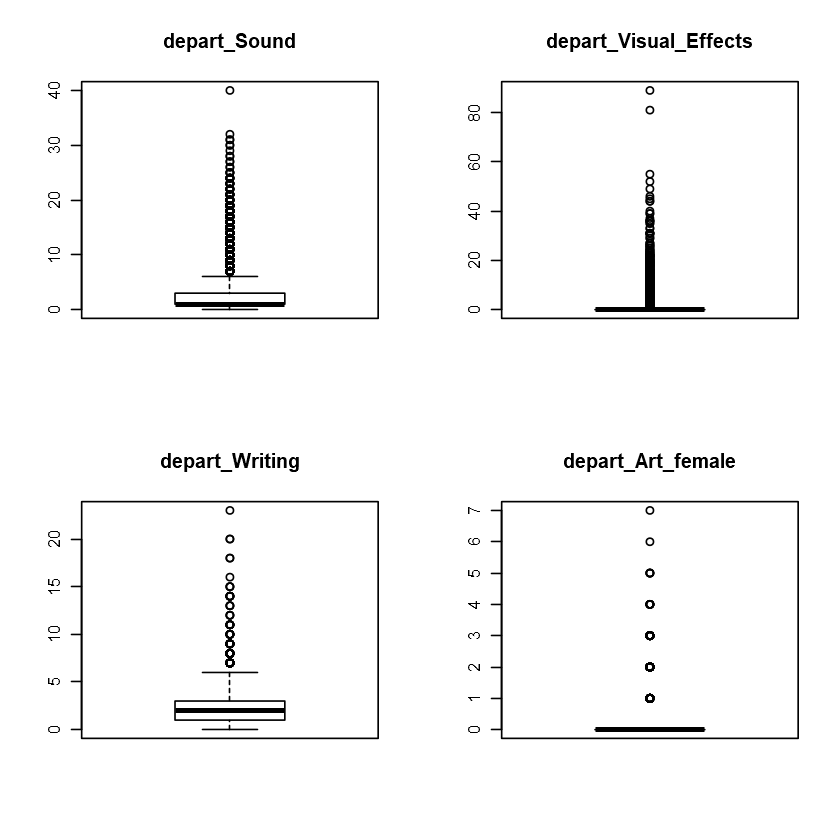

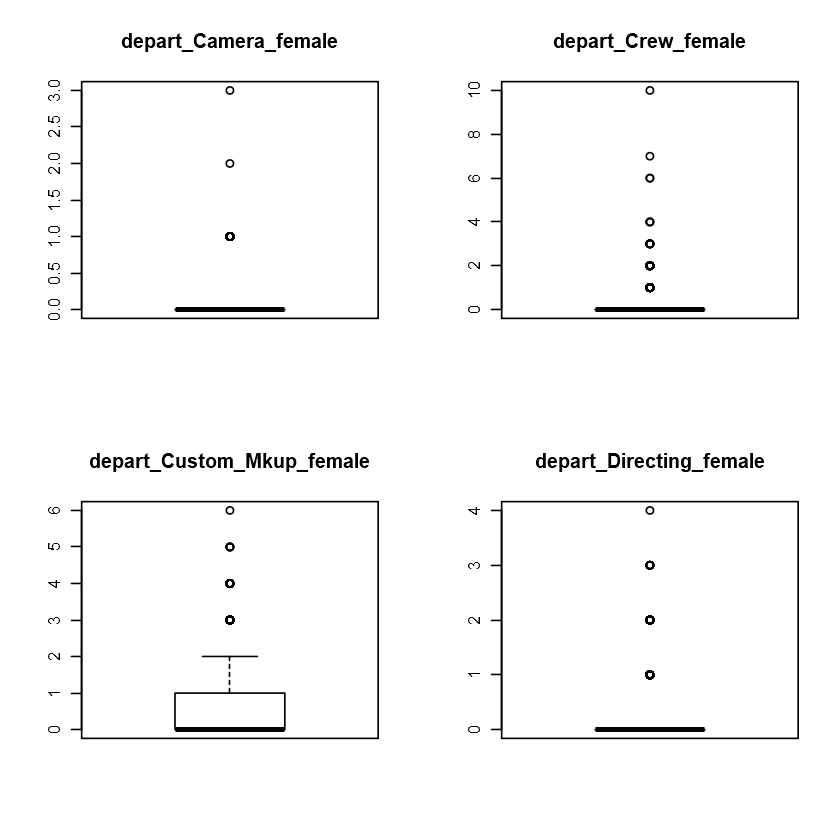

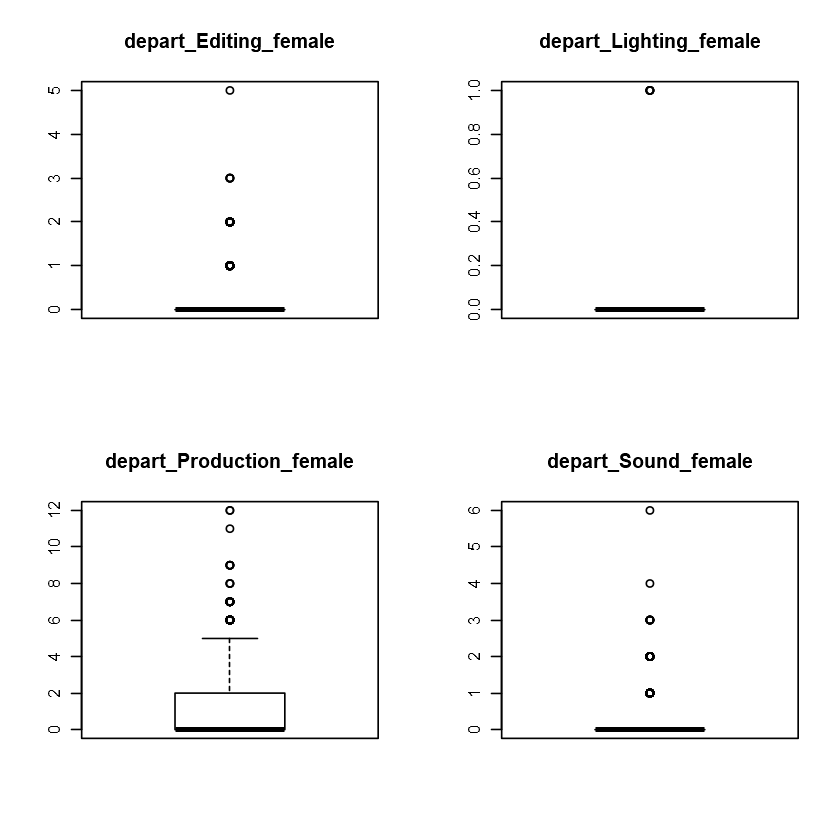

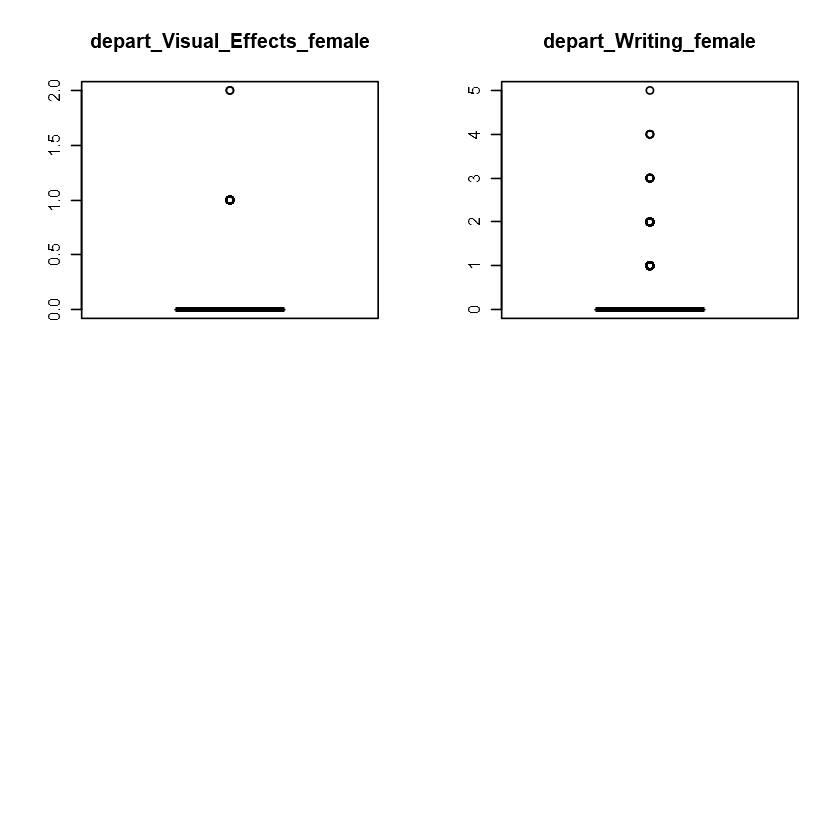

In [17]:
par(mfrow=c(2,2))

for (i in 63:84) {
   boxplot(movies_ff[,i], main = nm[i]) 
} 

##  2.3 Correlation matrix

In [26]:
cor_res_all <- cor(movies_ff[5:84],y=NULL, use ="pairwise.complete.obs",method="s")
head(cor_res)

Warning message in cor(movies_ff[5:84], y = NULL, use = "pairwise.complete.obs", :
"the standard deviation is zero"
Warning message in cor(movies_ff[5:84], y = NULL, use = "pairwise.complete.obs", :
"the standard deviation is zero"
Warning message in cor(movies_ff[5:84], y = NULL, use = "pairwise.complete.obs", :
"the standard deviation is zero"
Warning message in cor(movies_ff[5:84], y = NULL, use = "pairwise.complete.obs", :
"the standard deviation is zero"
Warning message in cor(movies_ff[5:84], y = NULL, use = "pairwise.complete.obs", :
"the standard deviation is zero"
Warning message in cor(movies_ff[5:84], y = NULL, use = "pairwise.complete.obs", :
"the standard deviation is zero"
Warning message in cor(movies_ff[5:84], y = NULL, use = "pairwise.complete.obs", :
"the standard deviation is zero"
Warning message in cor(movies_ff[5:84], y = NULL, use = "pairwise.complete.obs", :
"the standard deviation is zero"
Warning message in cor(movies_ff[5:84], y = NULL, use = "pairwise.comple

,movie_id,runtime,budget,popularity,revenue,release_year,release_month,release_day,seasonality,producers_cnt,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
movie_id,1.0000000000,0.002341803,0.0009736131,0.005477086,0.009997652,0.0004235283,0.01612801,0.030110212,0.02132118,0.01001911,...,-0.005727583,-8.193342e-05,0.003404204,-0.004240663,-0.01086437,-0.014256049,-0.000443574,-0.02289685,0.01435770,-0.009913564
runtime,0.0023418029,1.000000000,0.2505025212,0.171363671,0.261910598,0.0043602185,0.12620765,0.027991214,0.09600864,0.09776720,...,0.001225895,7.042466e-02,0.169646772,0.069858973,0.04849778,-0.011328046,0.126761948,0.07748747,0.00525580,0.026717987
budget,0.0009736131,0.250502521,1.0000000000,0.517639218,0.691007848,0.1571411747,0.06021319,0.034203754,0.13459262,0.27367753,...,0.036589693,1.755995e-01,0.315041130,0.139602278,0.08616299,0.013643802,0.396343510,0.13053200,0.08256478,0.049253239
popularity,0.0054770856,0.171363671,0.5176392179,1.000000000,0.594538732,0.1359659231,0.05394586,0.048233453,0.10436647,0.28542669,...,0.065173132,1.774725e-01,0.294492671,0.126272830,0.10216707,0.014191988,0.395866981,0.13821703,0.07644792,0.060167155
revenue,0.0099976524,0.261910598,0.6910078479,0.594538732,1.000000000,0.0179175976,0.03649203,0.060650392,0.19901310,0.19646784,...,0.032005853,1.628297e-01,0.317688650,0.126197294,0.05829747,0.031355436,0.387482082,0.14117393,0.07706105,0.099745155
release_year,0.0004235283,0.004360218,0.1571411747,0.135965923,0.017917598,1.0000000000,-0.04976514,0.006177444,-0.07860239,0.33851633,...,0.062025697,8.320488e-02,0.068599043,0.085418878,-0.01201915,-0.008337972,0.183404135,0.07537221,0.05227172,0.041967836


In [27]:
cor_res_cont <- cor(movies_continuous,y=NULL, use ="pairwise.complete.obs",method="s")
head(cor_res)

,movie_id,runtime,budget,popularity,revenue,release_year,release_month,release_day,seasonality,producers_cnt,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
movie_id,1.0000000000,0.002341803,0.0009736131,0.005477086,0.009997652,0.0004235283,0.01612801,0.030110212,0.02132118,0.01001911,...,-0.005727583,-8.193342e-05,0.003404204,-0.004240663,-0.01086437,-0.014256049,-0.000443574,-0.02289685,0.01435770,-0.009913564
runtime,0.0023418029,1.000000000,0.2505025212,0.171363671,0.261910598,0.0043602185,0.12620765,0.027991214,0.09600864,0.09776720,...,0.001225895,7.042466e-02,0.169646772,0.069858973,0.04849778,-0.011328046,0.126761948,0.07748747,0.00525580,0.026717987
budget,0.0009736131,0.250502521,1.0000000000,0.517639218,0.691007848,0.1571411747,0.06021319,0.034203754,0.13459262,0.27367753,...,0.036589693,1.755995e-01,0.315041130,0.139602278,0.08616299,0.013643802,0.396343510,0.13053200,0.08256478,0.049253239
popularity,0.0054770856,0.171363671,0.5176392179,1.000000000,0.594538732,0.1359659231,0.05394586,0.048233453,0.10436647,0.28542669,...,0.065173132,1.774725e-01,0.294492671,0.126272830,0.10216707,0.014191988,0.395866981,0.13821703,0.07644792,0.060167155
revenue,0.0099976524,0.261910598,0.6910078479,0.594538732,1.000000000,0.0179175976,0.03649203,0.060650392,0.19901310,0.19646784,...,0.032005853,1.628297e-01,0.317688650,0.126197294,0.05829747,0.031355436,0.387482082,0.14117393,0.07706105,0.099745155
release_year,0.0004235283,0.004360218,0.1571411747,0.135965923,0.017917598,1.0000000000,-0.04976514,0.006177444,-0.07860239,0.33851633,...,0.062025697,8.320488e-02,0.068599043,0.085418878,-0.01201915,-0.008337972,0.183404135,0.07537221,0.05227172,0.041967836


In [5]:
if(!require(corrplot)) {install.packages("corrplot");require(corrplot)}

Loading required package: corrplot

corrplot 0.84 loaded



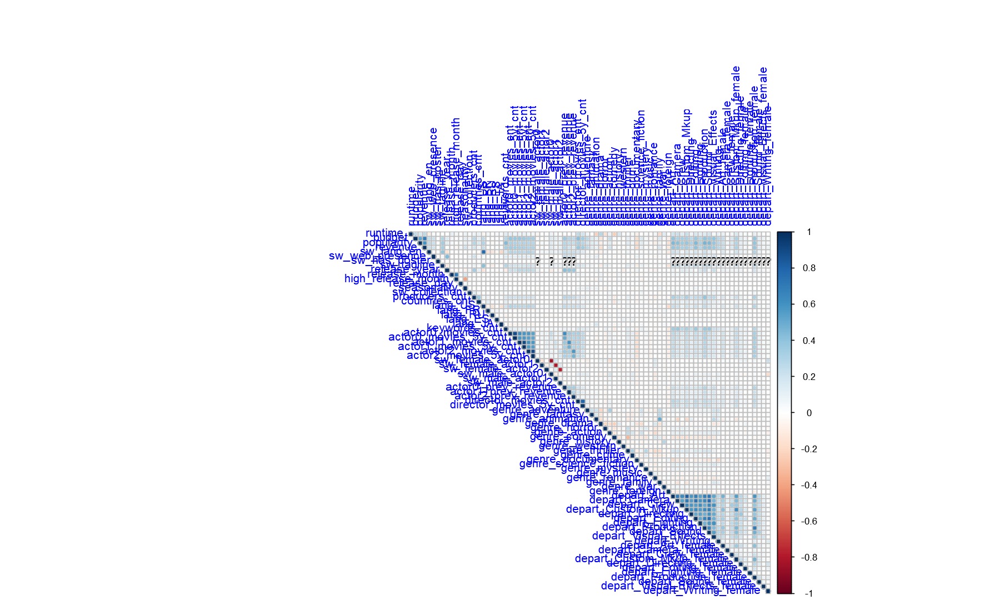

In [28]:
corrplot(cor_res_all, type = "upper", 
         tl.col = "Blue", tl.srt = 90)


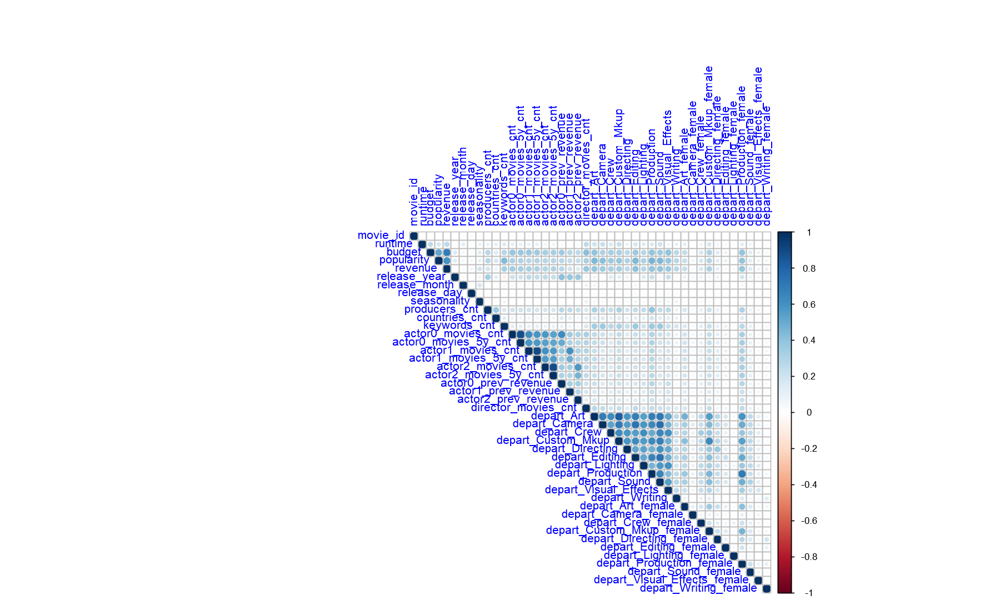

In [29]:
corrplot(cor_res_cont, type = "upper", 
         tl.col = "Blue", tl.srt = 90)

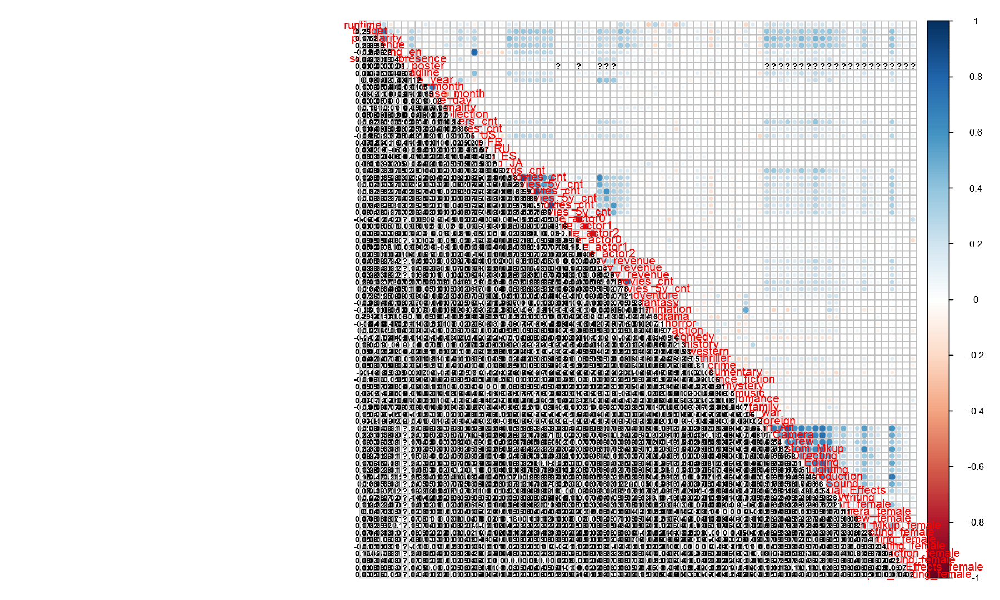

In [30]:
corrplot.mixed(cor_res_all, lower.col = "black", number.cex = .7, tl.srt = 90)

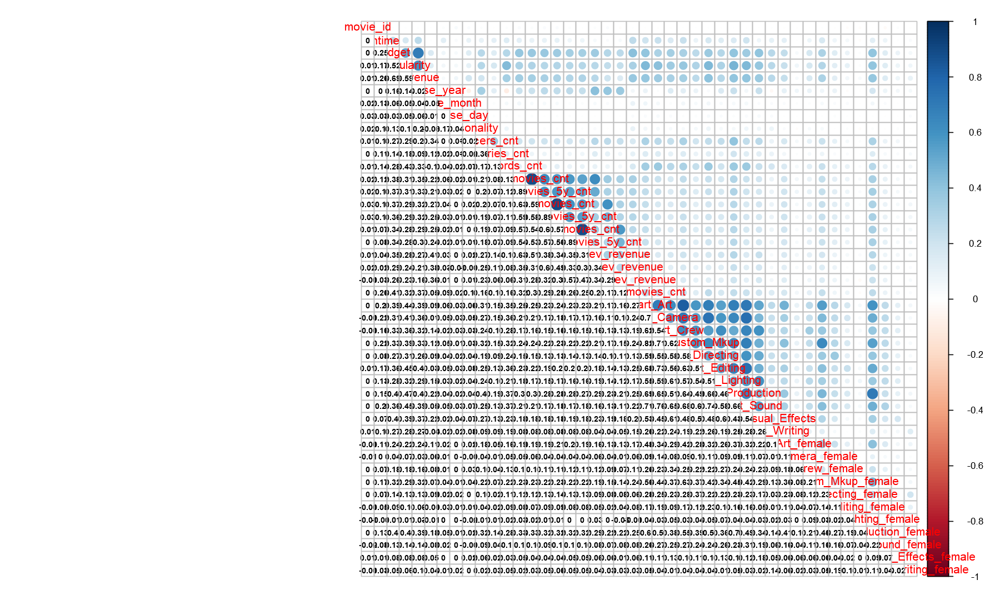

In [31]:
corrplot.mixed(cor_res_cont, lower.col = "black", number.cex = .7, tl.srt = 90)

### 2.4 Revenue Analysis

Warning message:
"Removed 4382 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."


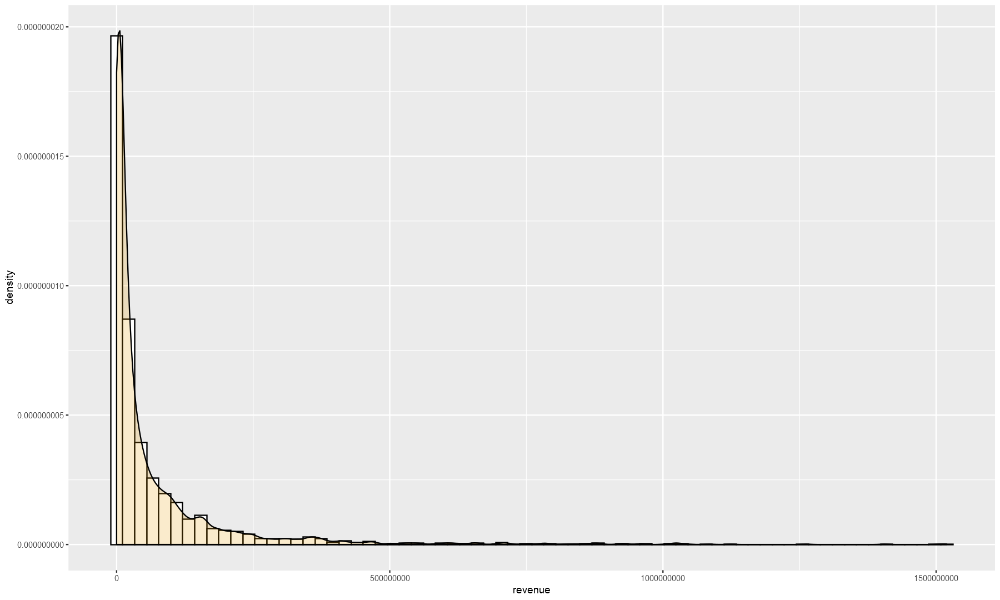

In [348]:
ggplot(movies_ff, aes(x=revenue)) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 70)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()

Warning message:
"Removed 4382 rows containing non-finite values (stat_bin)."
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."


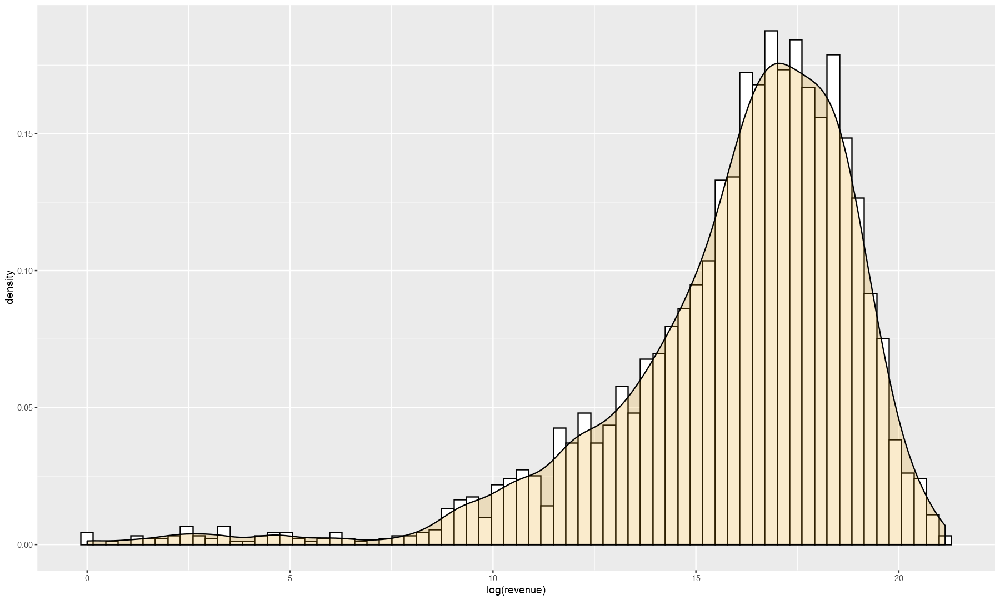

In [360]:
ggplot(movies_ff, aes(x=log(revenue))) + 
 geom_histogram(aes(y=..density..), colour="black", fill="white",bins = 70)+
 geom_density(alpha=0.2, fill="#E69F00") + theme_get()

#### differences between the average revenue by language?

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."
Warning message:
"Groups with fewer than two data points have been dropped."


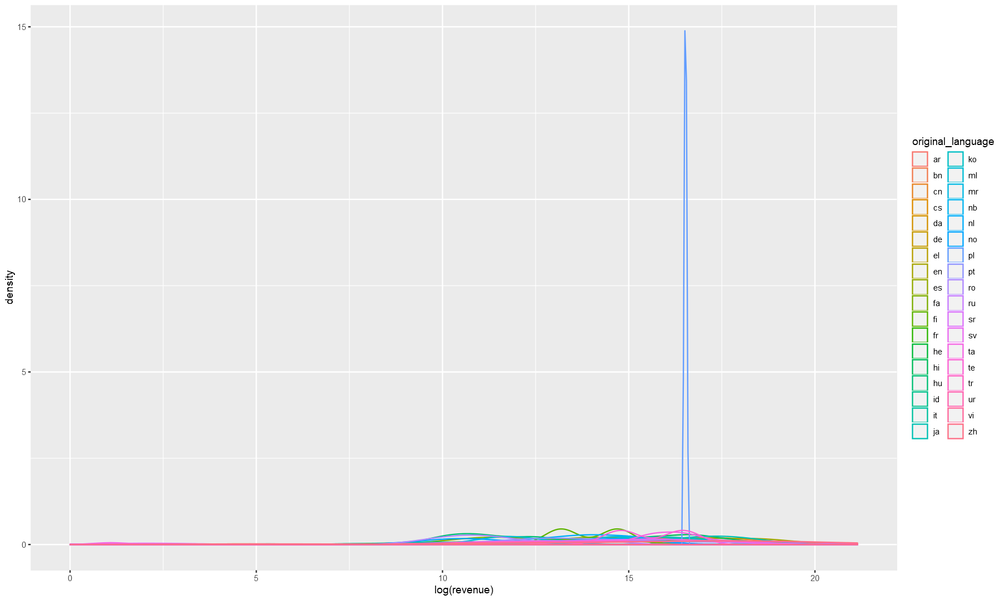

In [361]:
ggplot(data=movies_ff) +
    geom_density(aes(log(revenue), group=original_language, color=original_language))

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


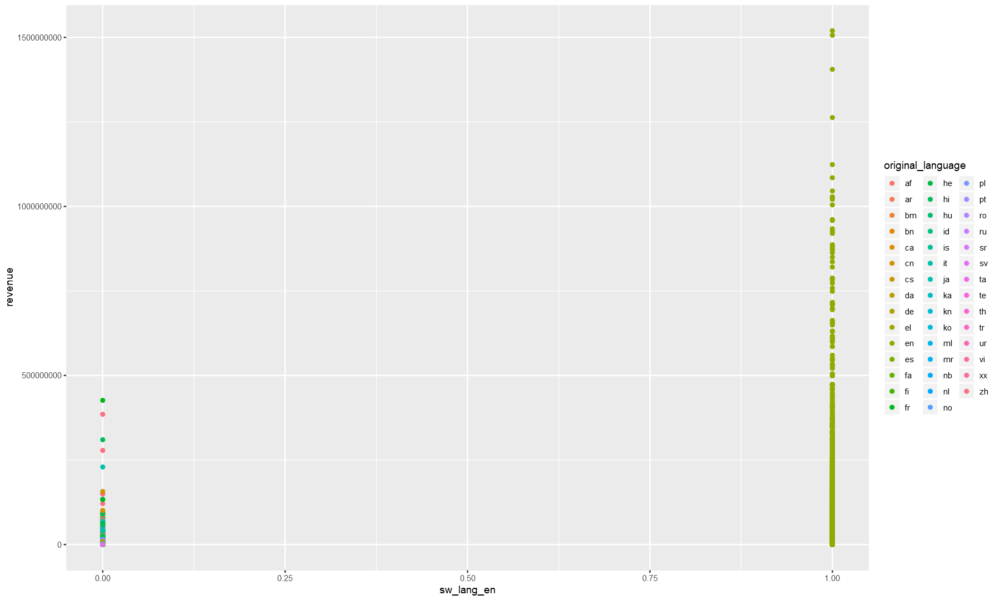

In [370]:
ggplot(data=movies_ff) +
    geom_point(aes(x=sw_lang_en, y=revenue, color = original_language))

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4384 rows containing missing values (geom_point)."


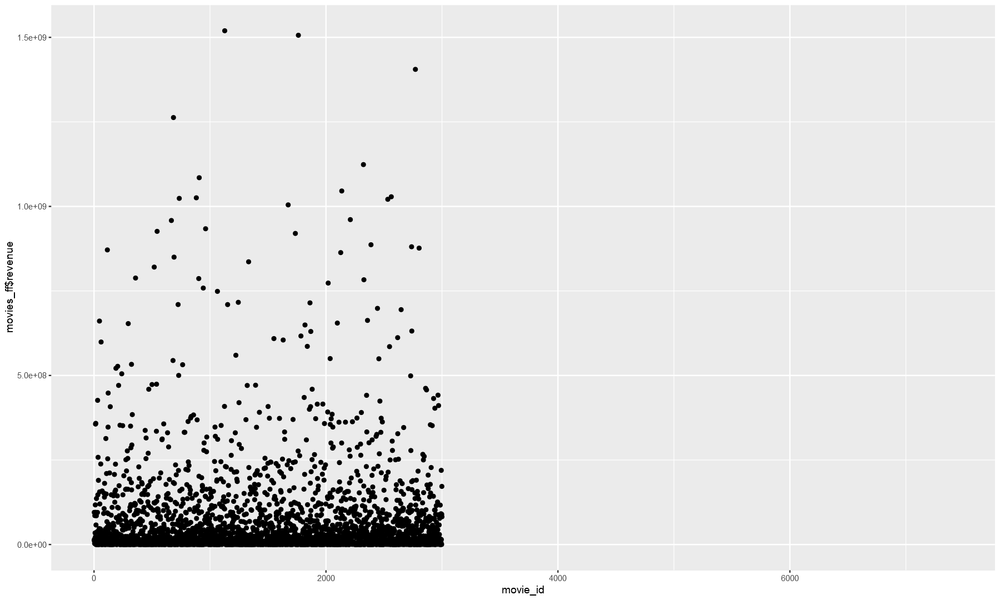

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


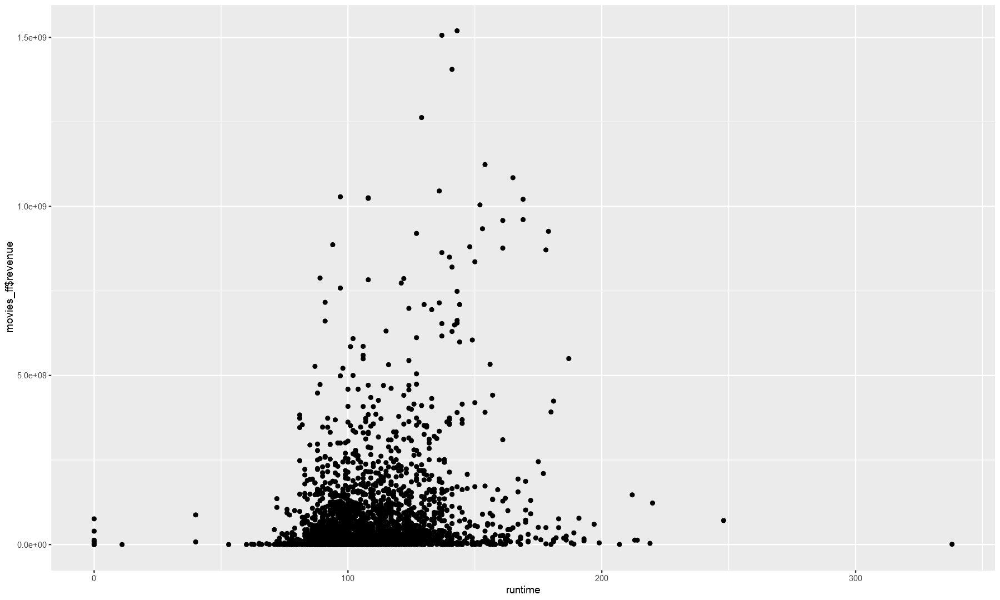

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


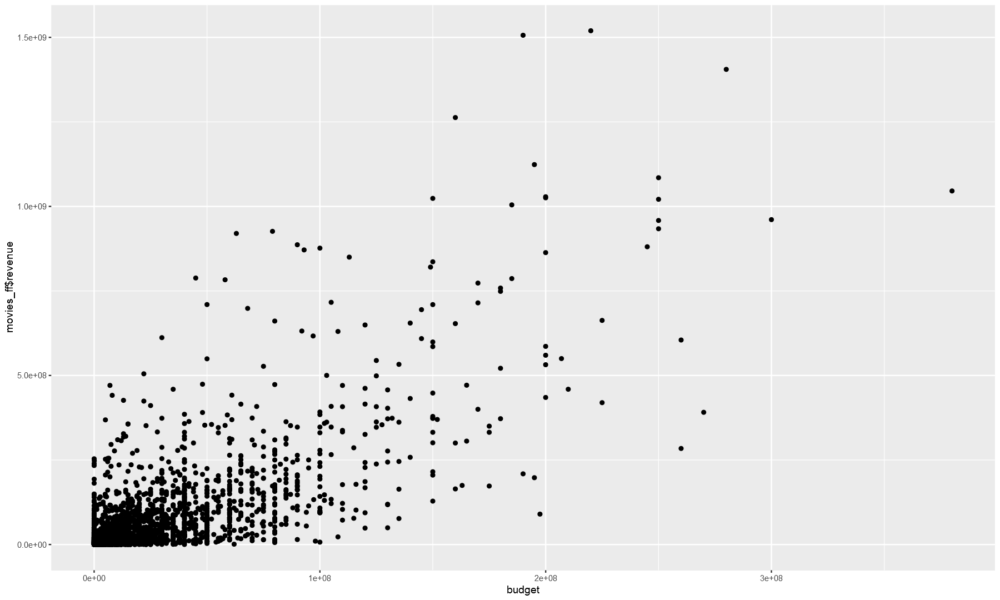

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


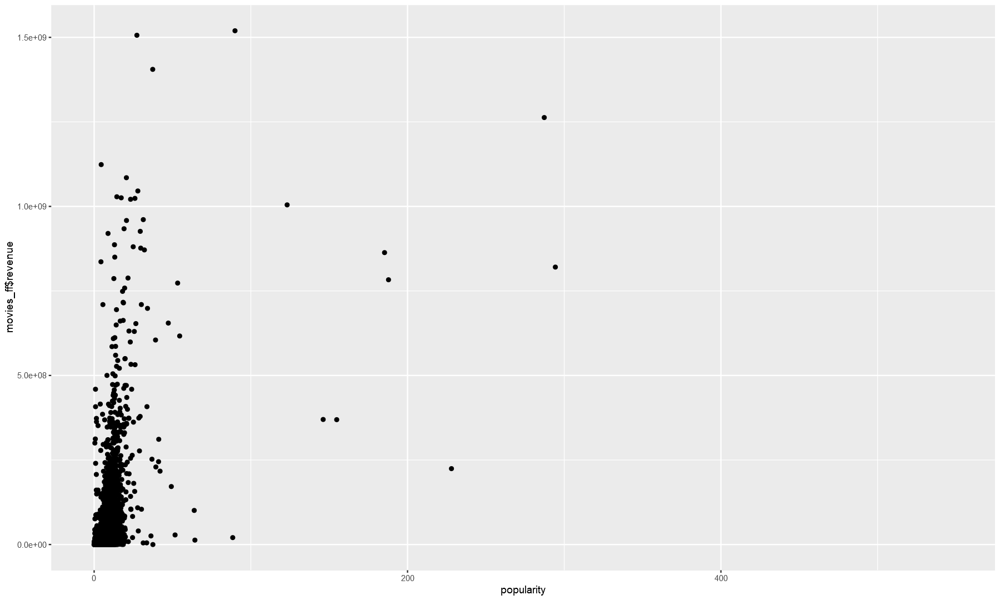

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


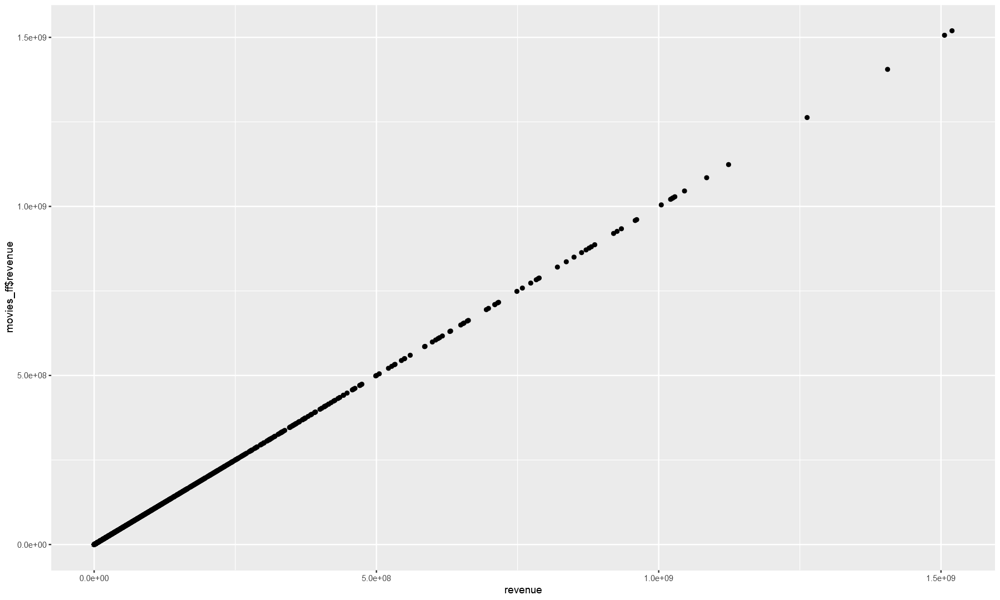

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


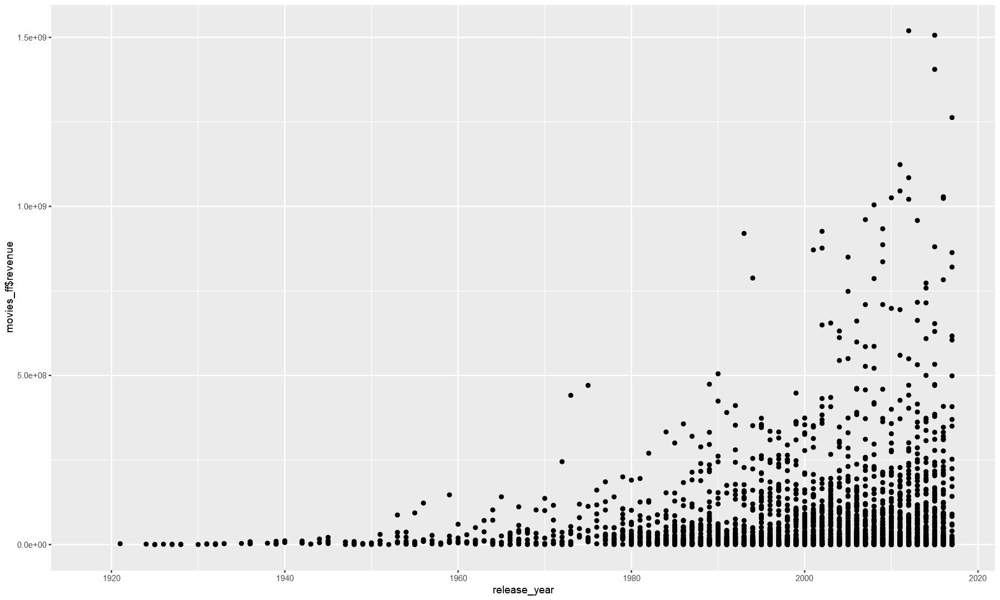

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


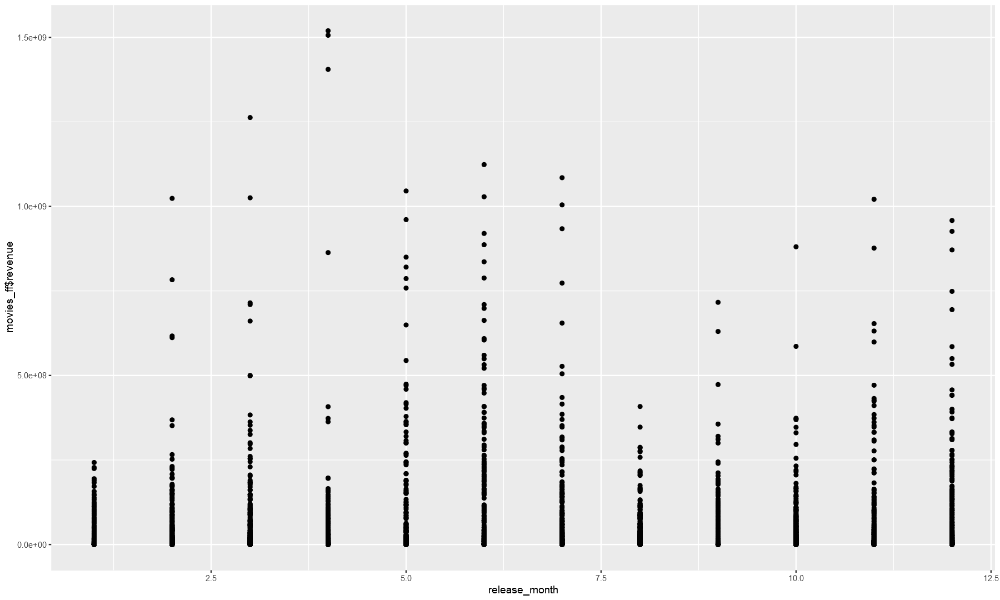

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


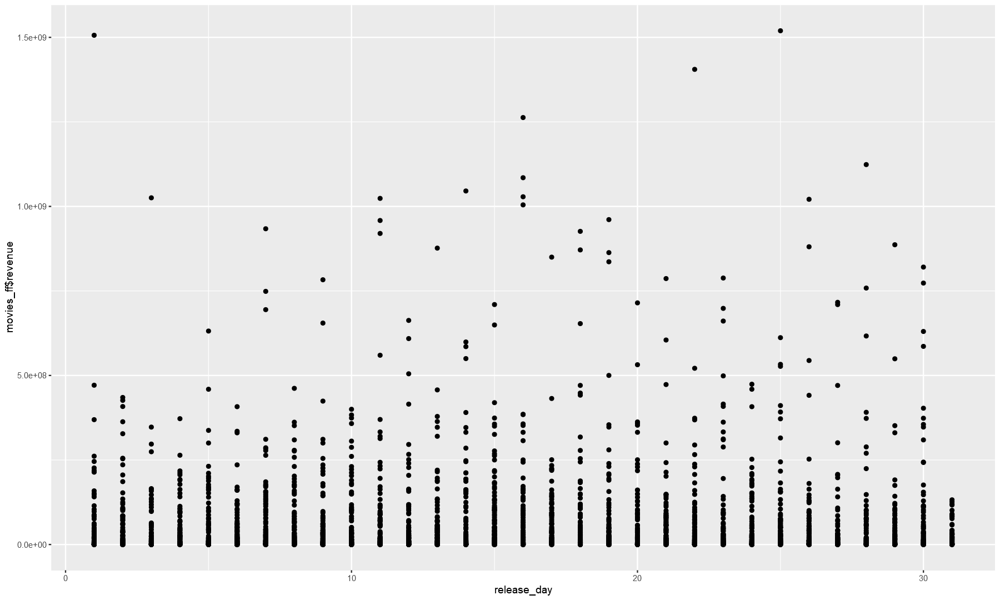

Warning message:
"Removed 4531 rows containing missing values (geom_point)."


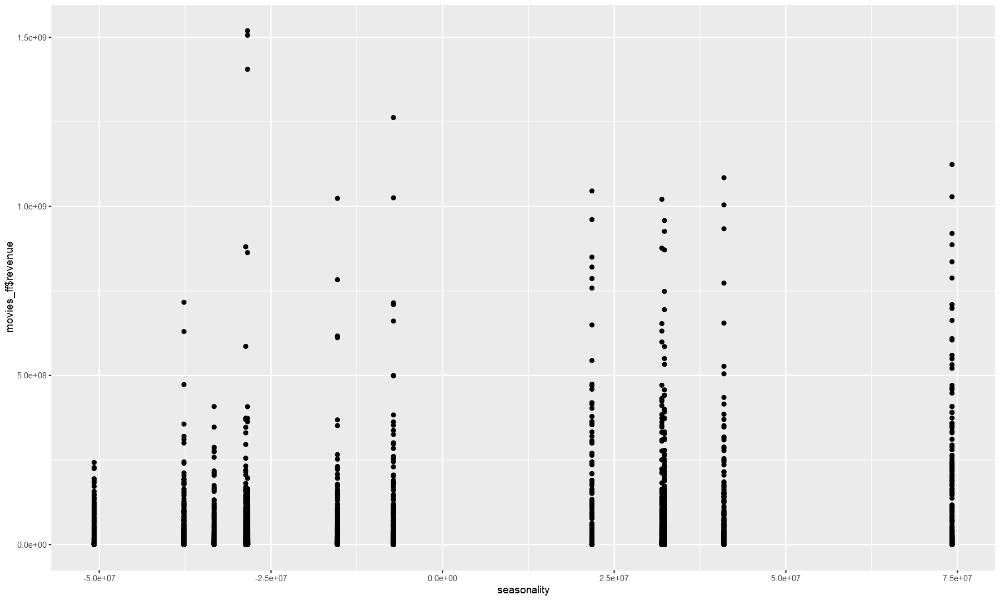

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


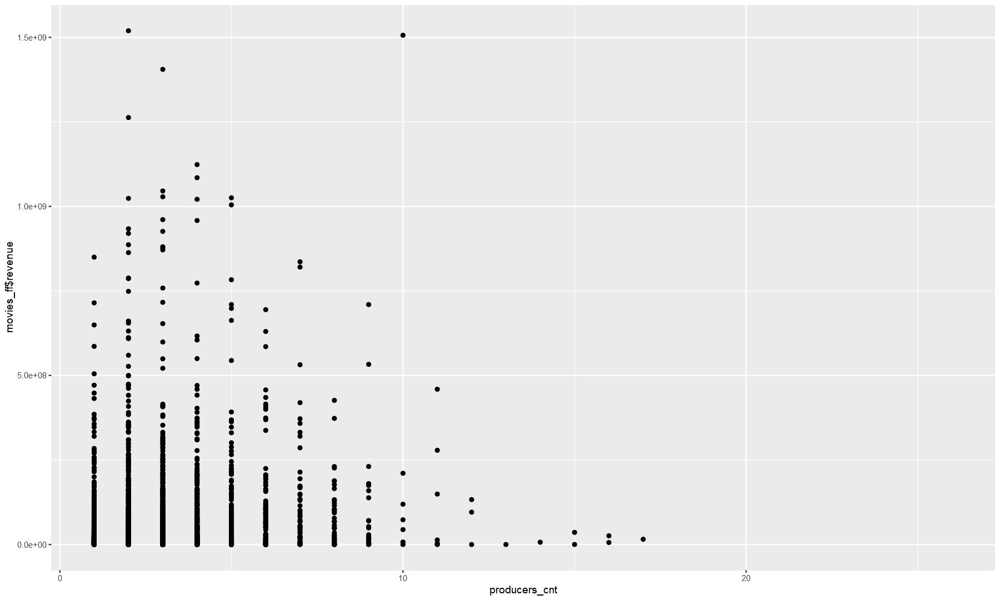

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


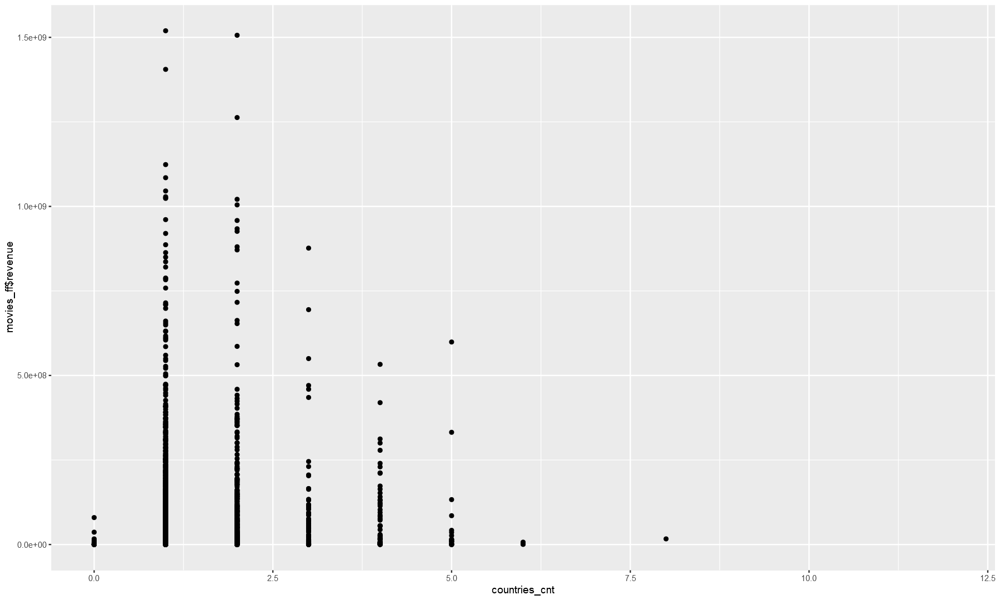

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


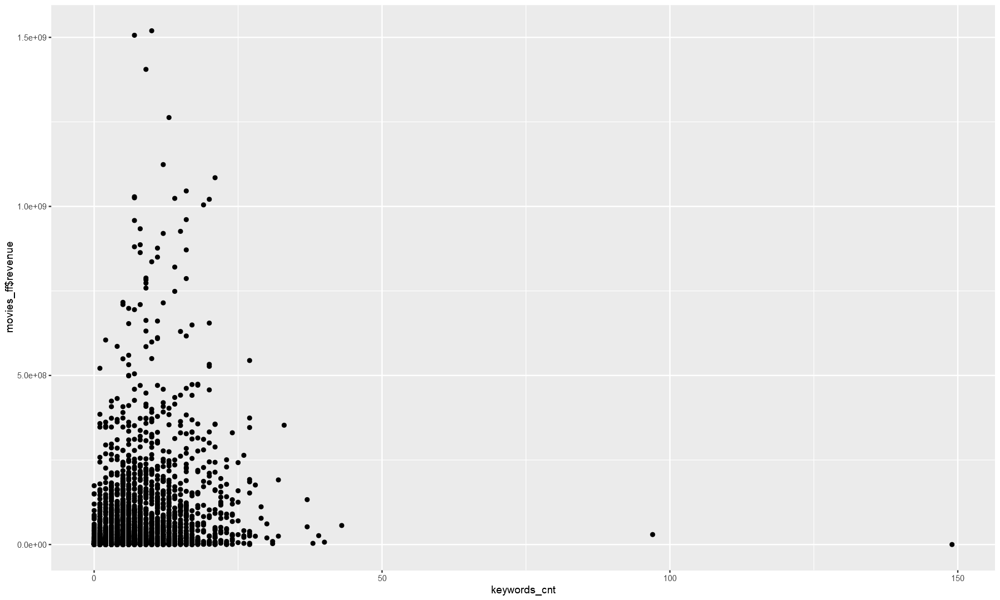

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


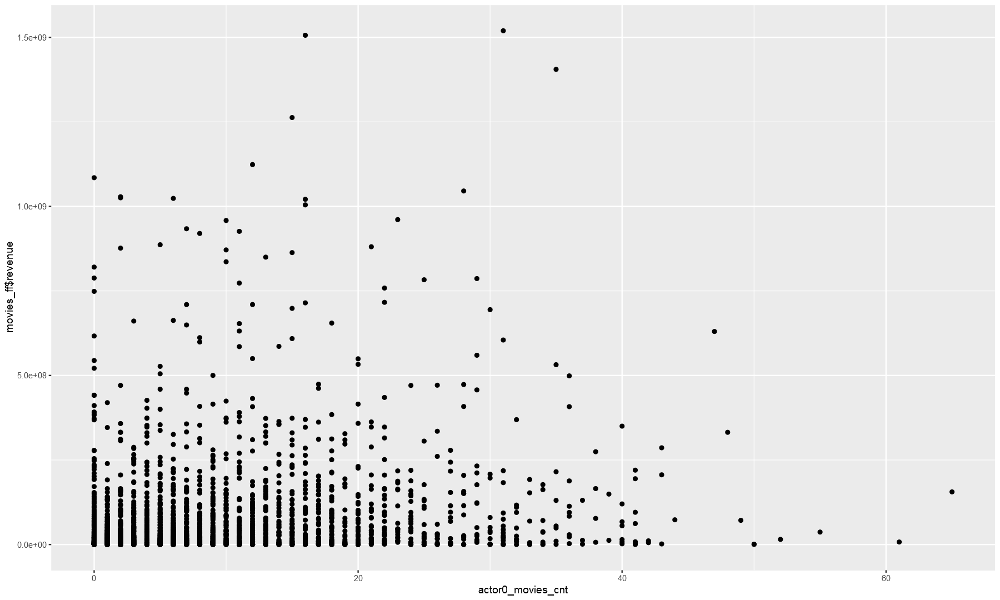

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


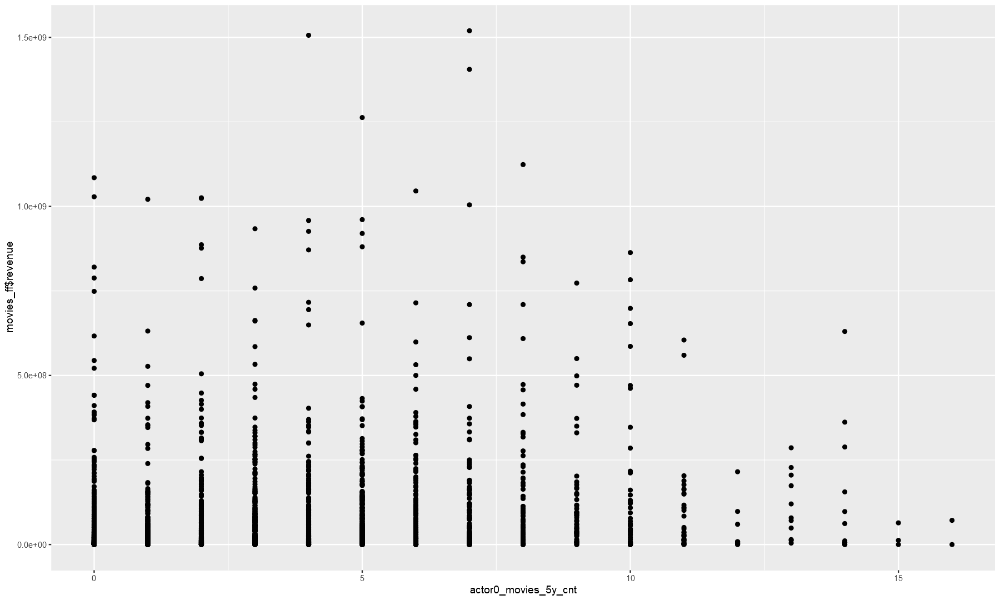

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


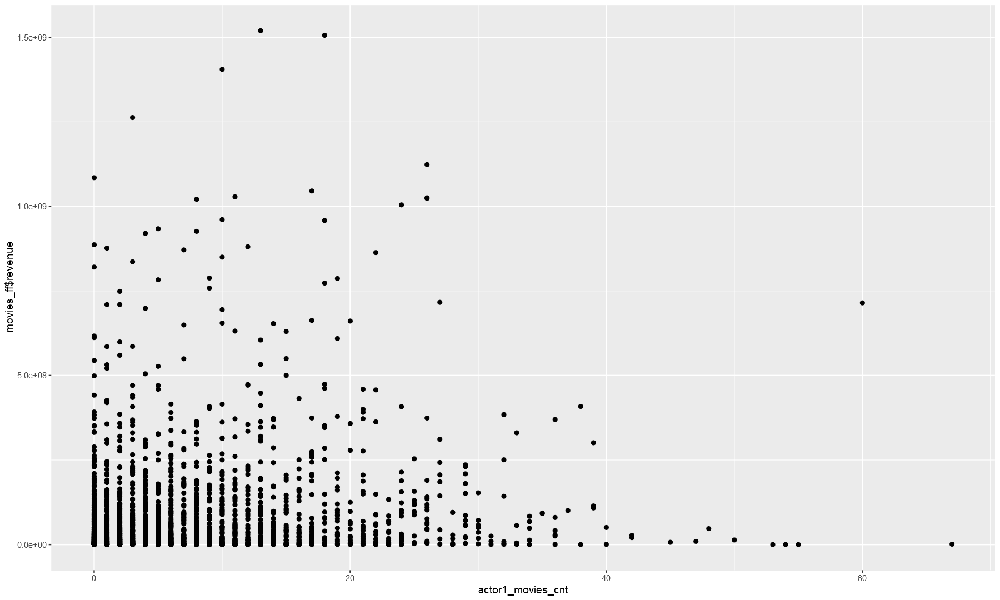

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


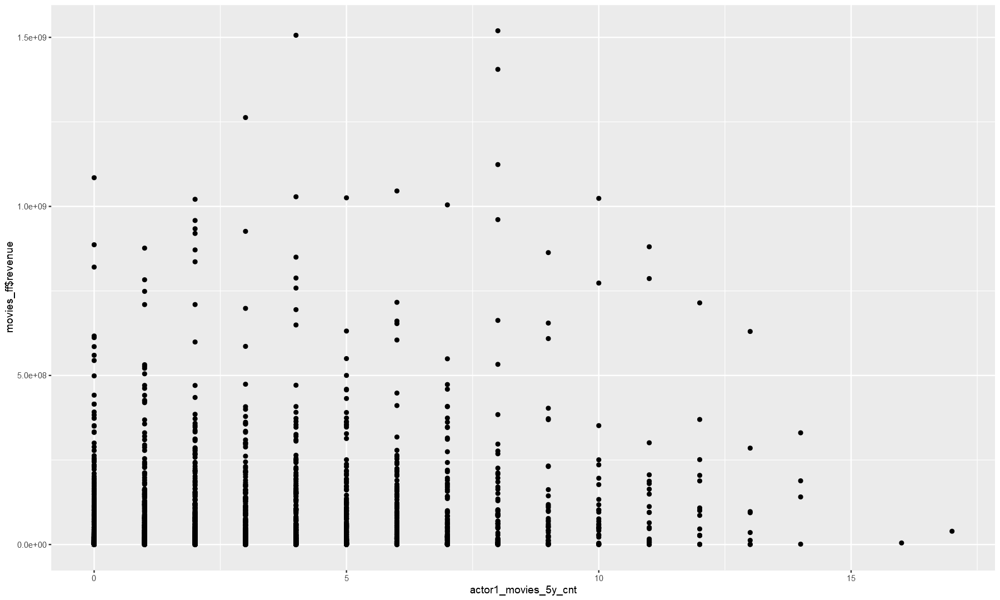

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


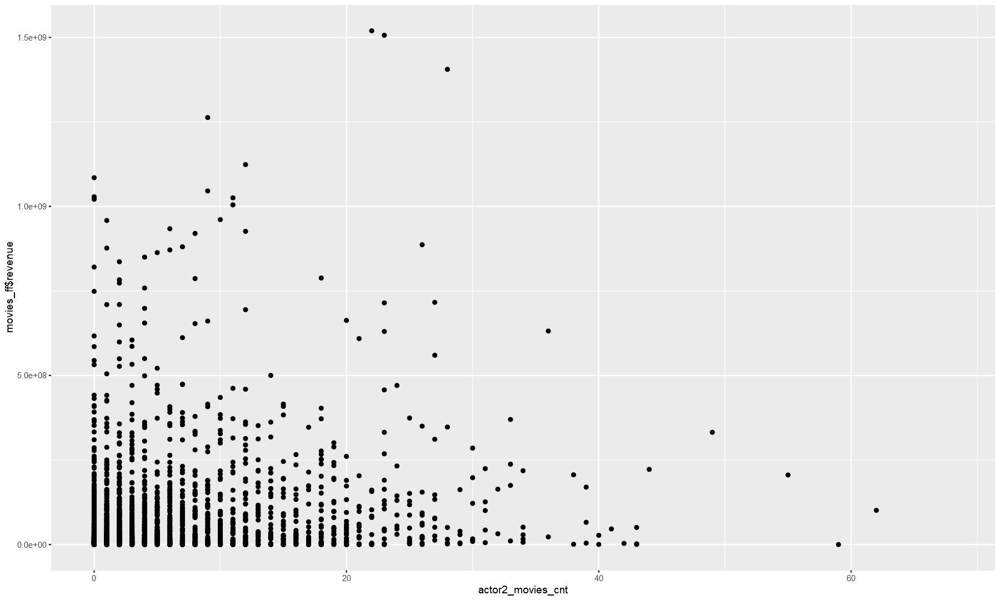

Warning message:
"Removed 5310 rows containing missing values (geom_point)."


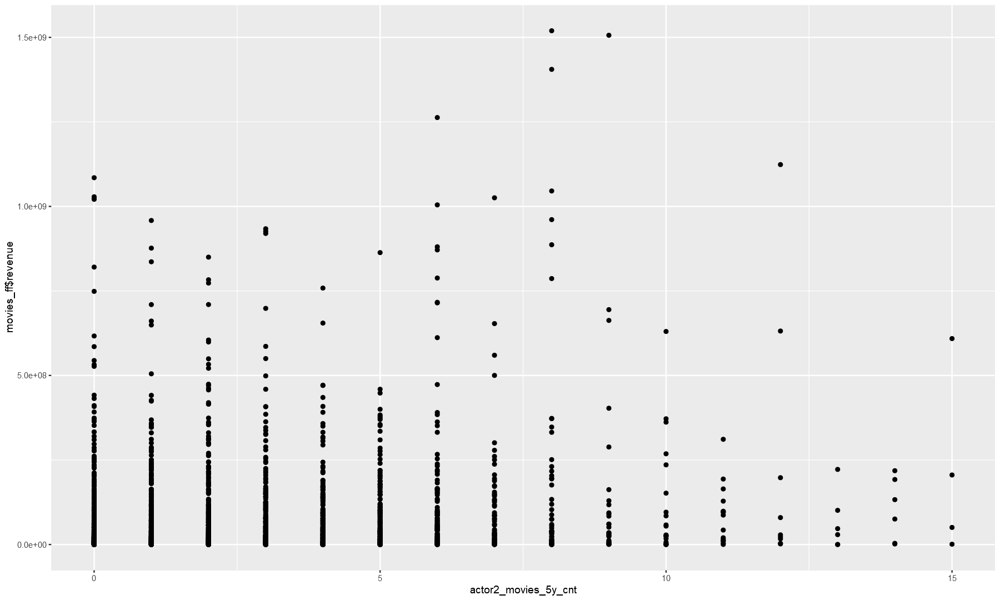

Warning message:
"Removed 5534 rows containing missing values (geom_point)."


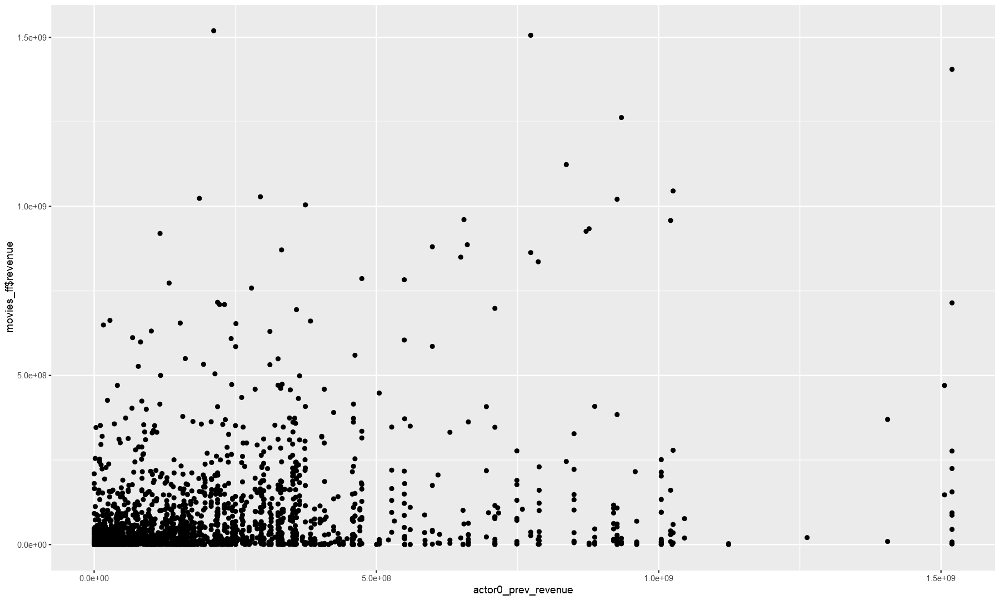

Warning message:
"Removed 5621 rows containing missing values (geom_point)."


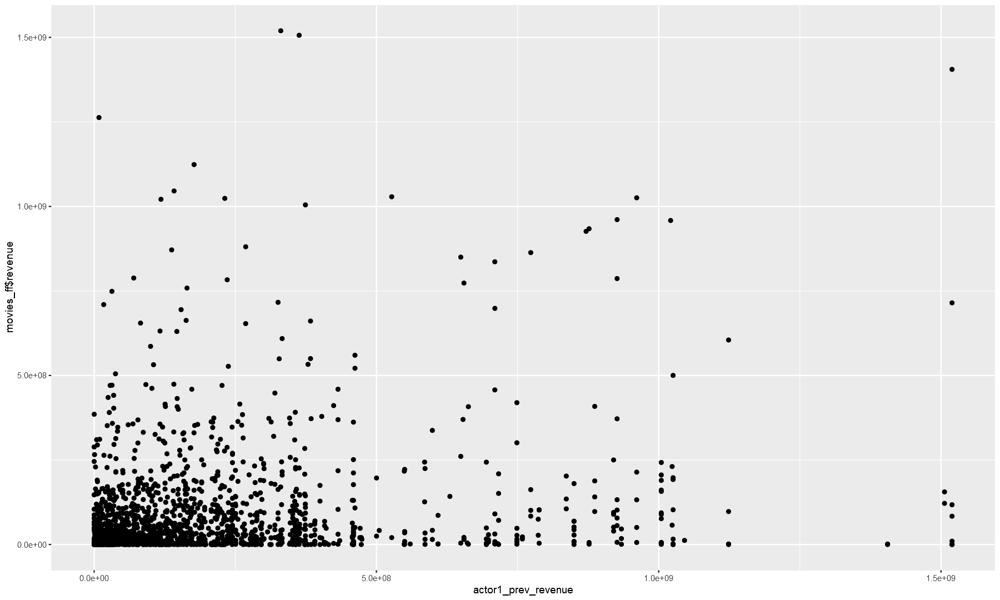

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


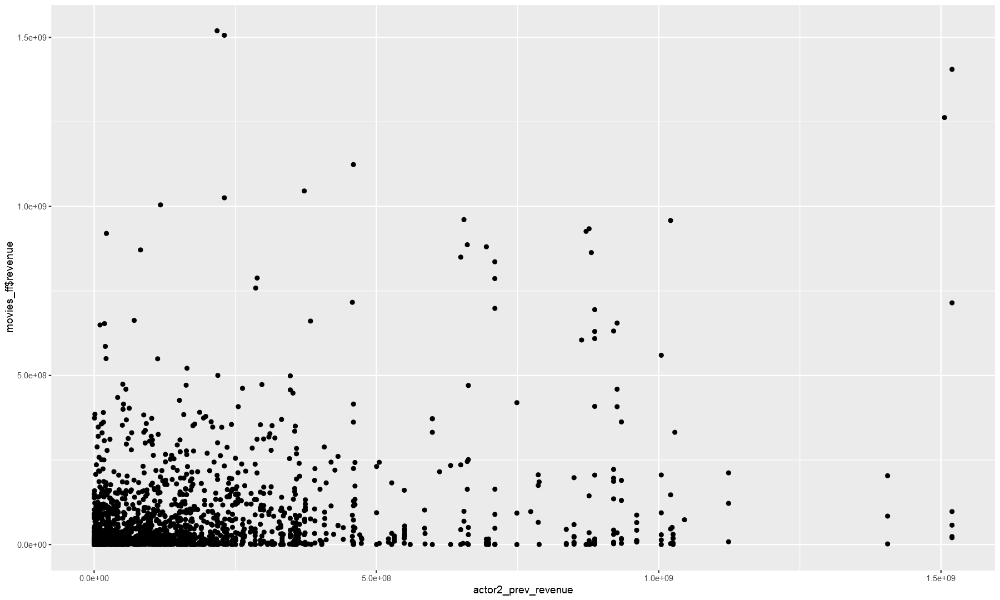

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


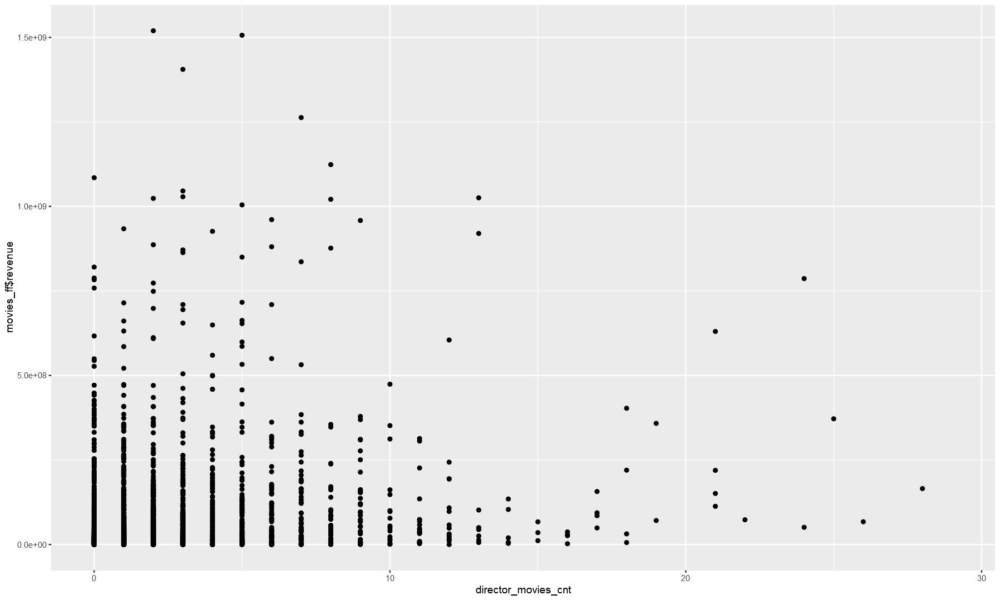

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


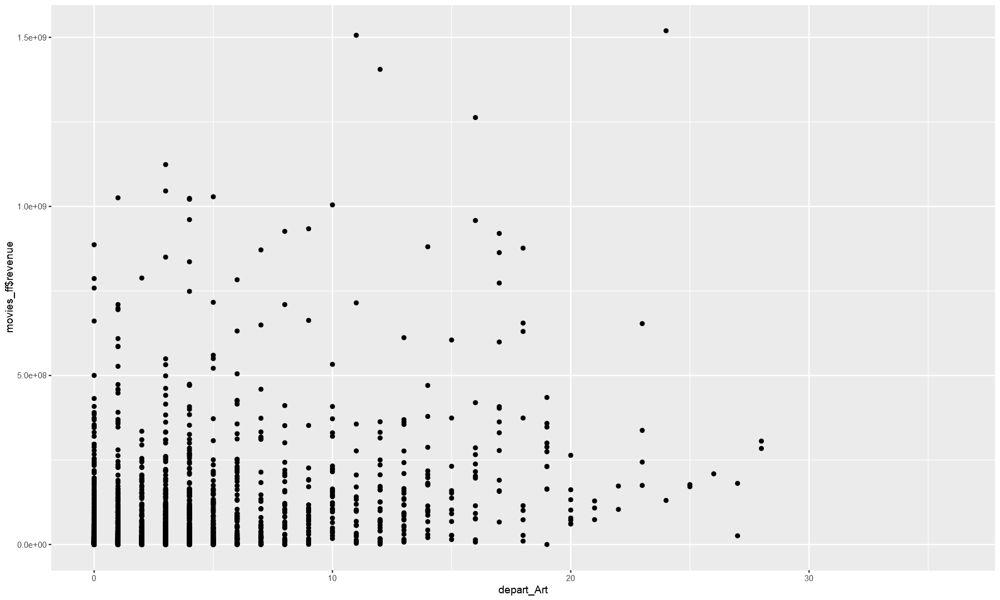

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


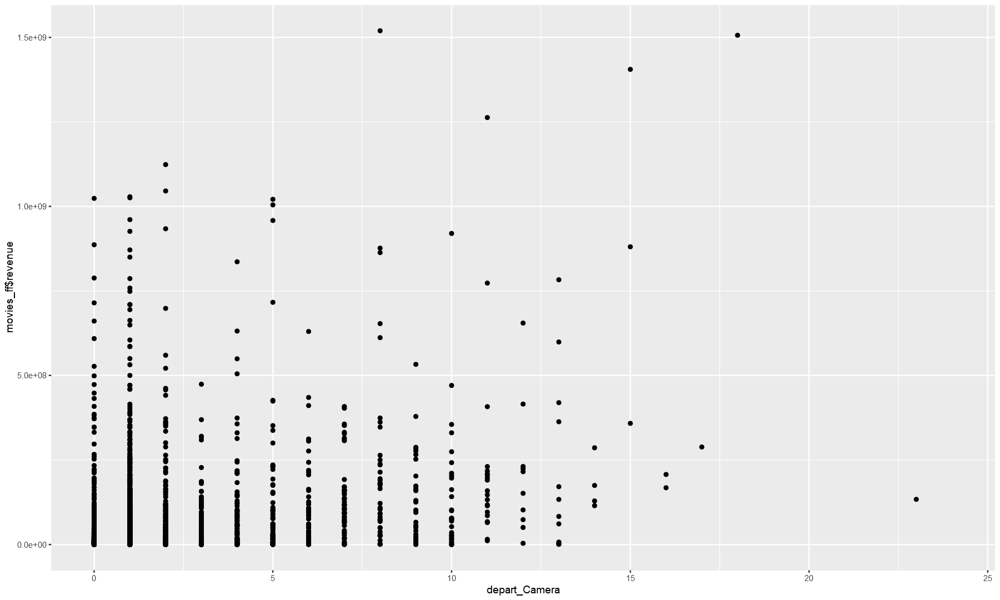

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


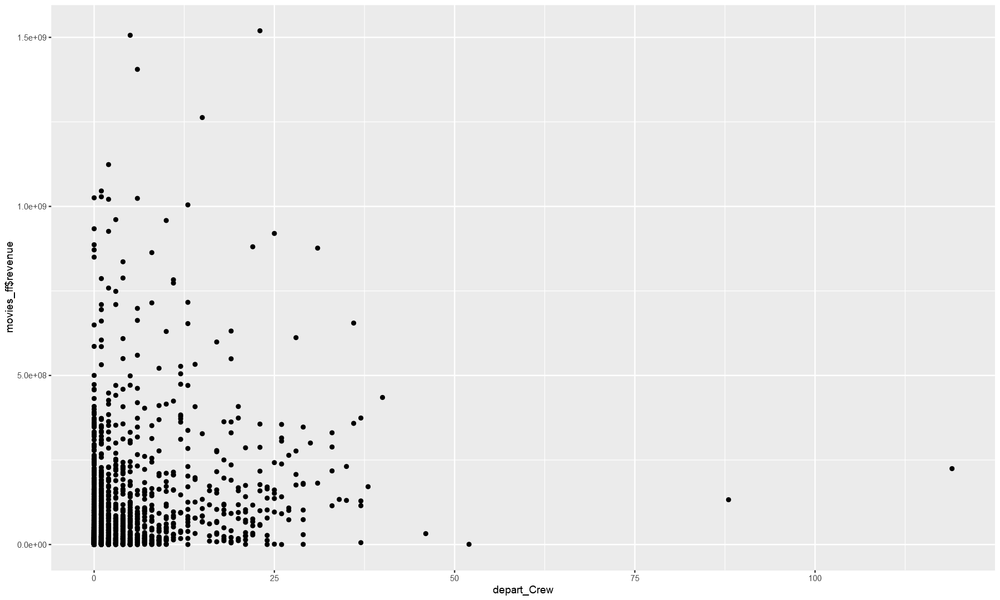

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


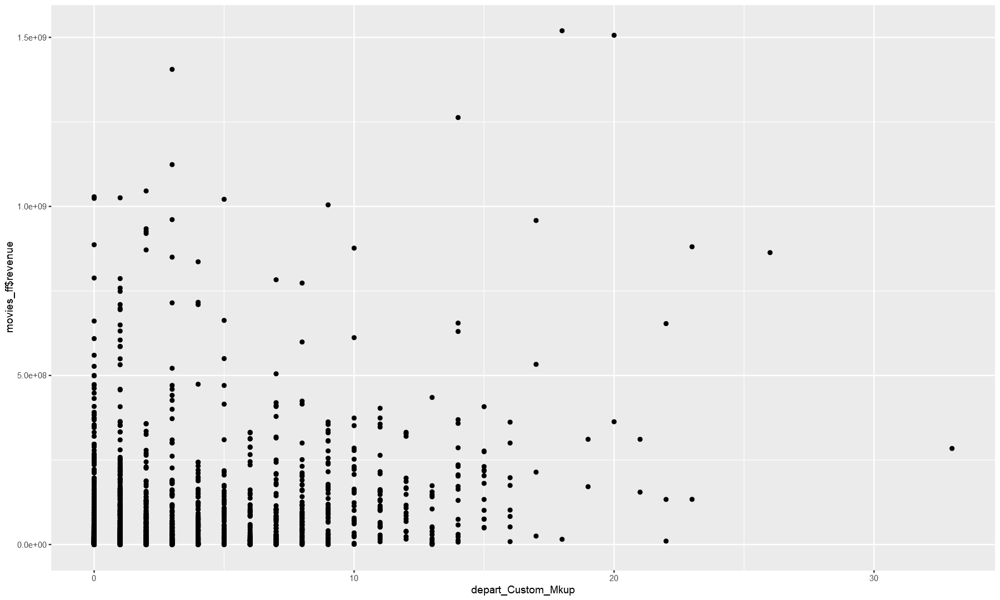

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


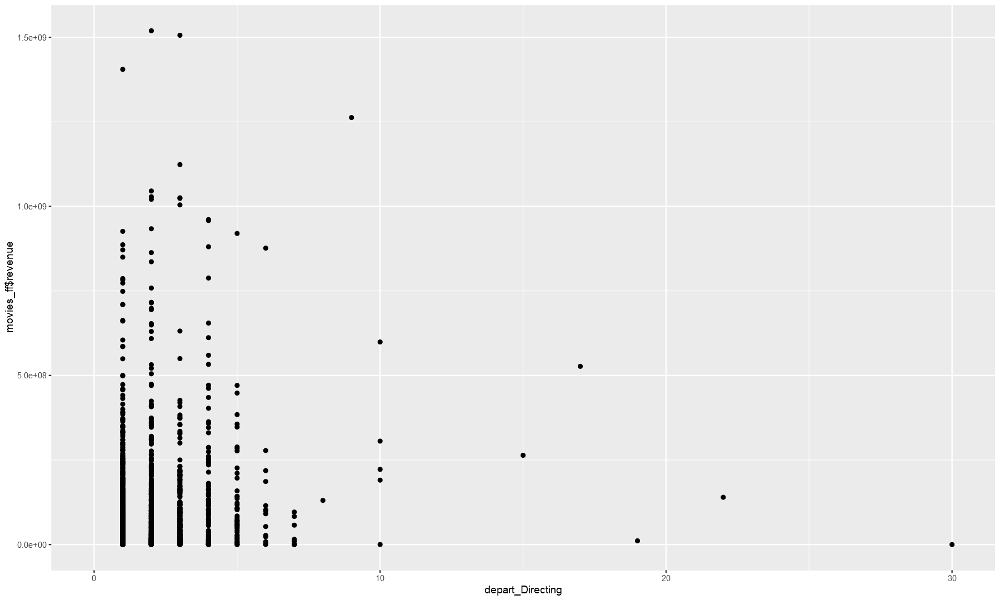

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


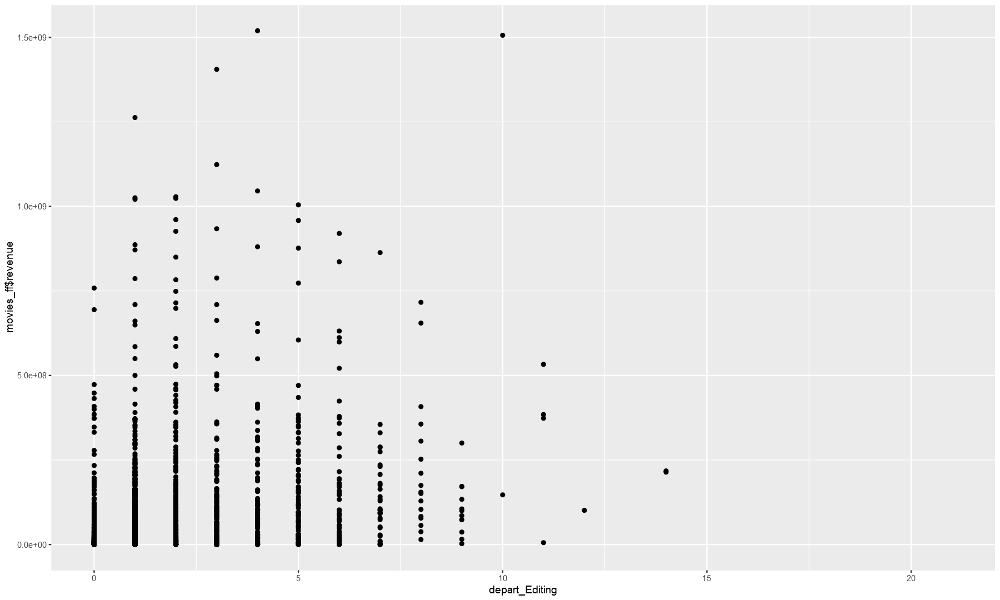

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


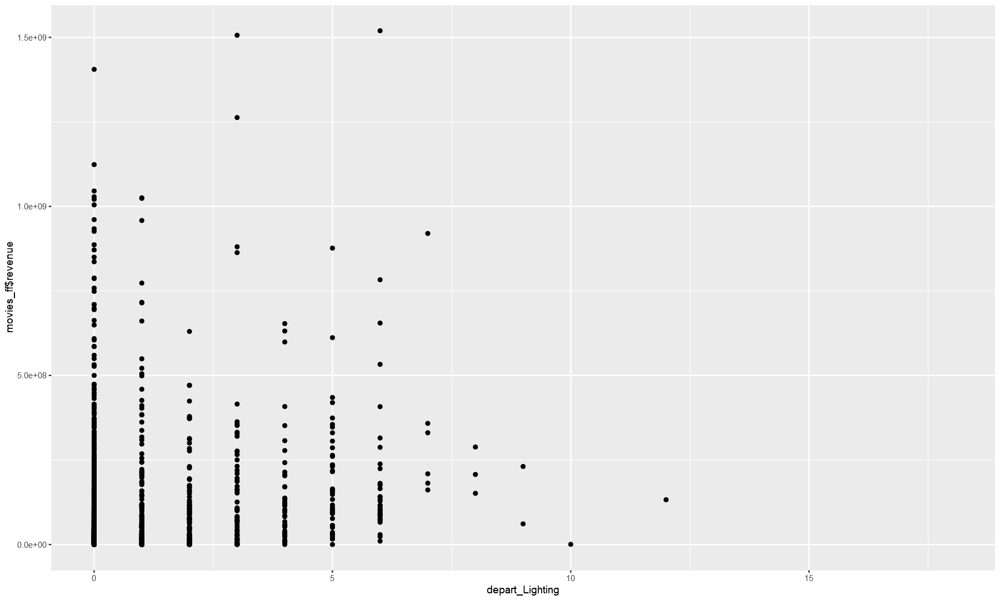

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


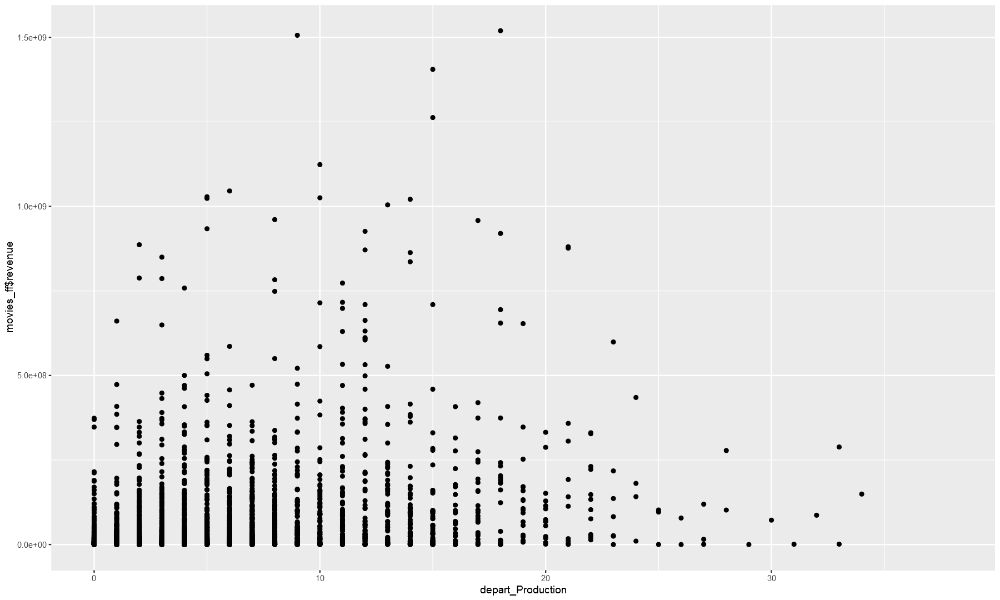

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


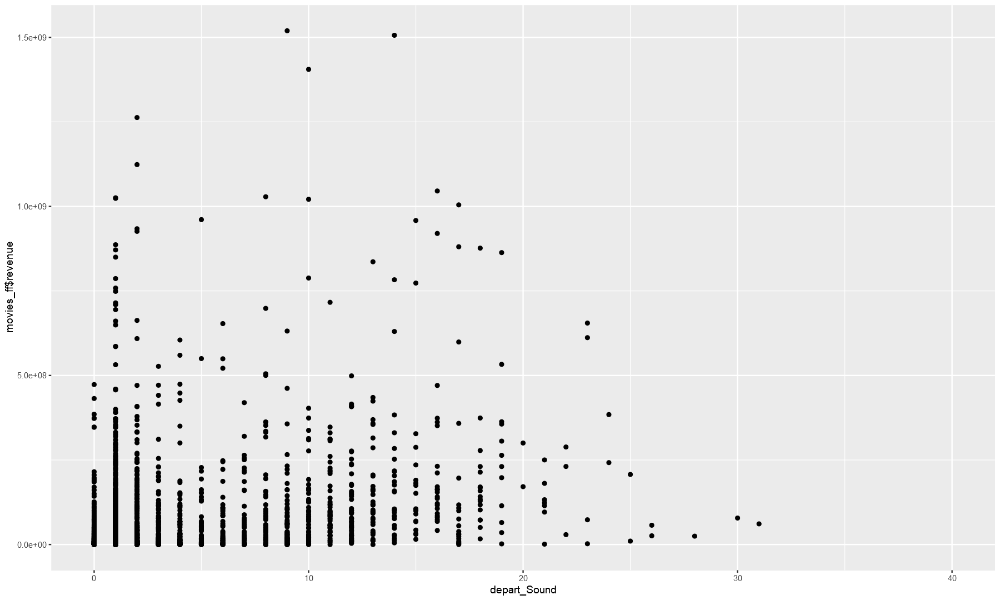

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


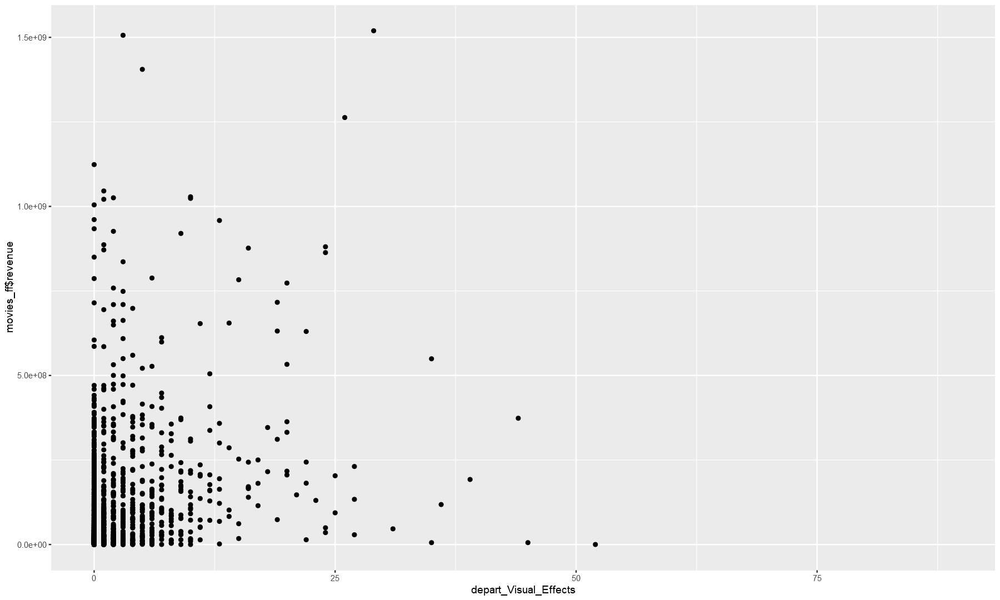

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


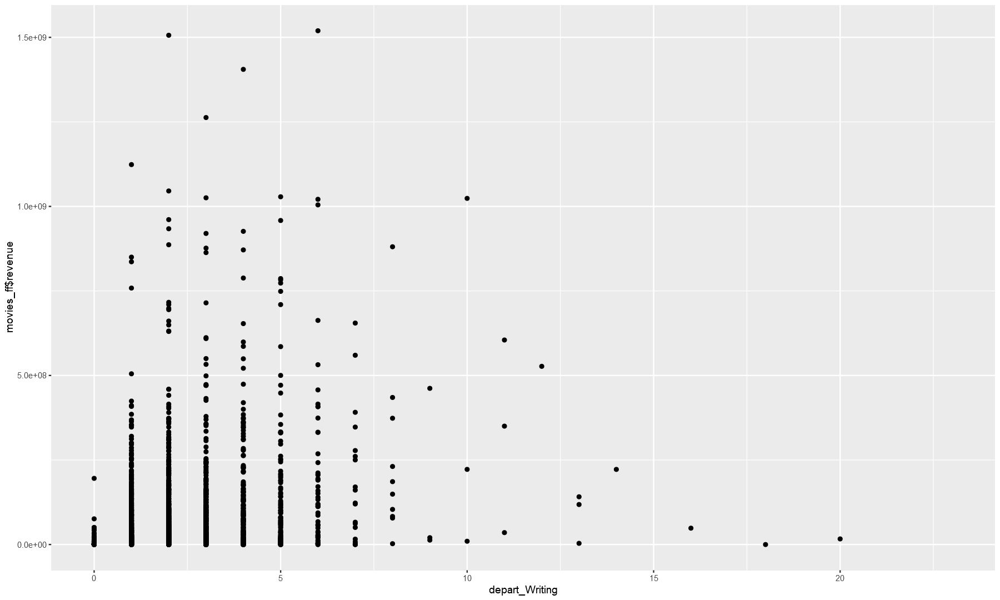

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


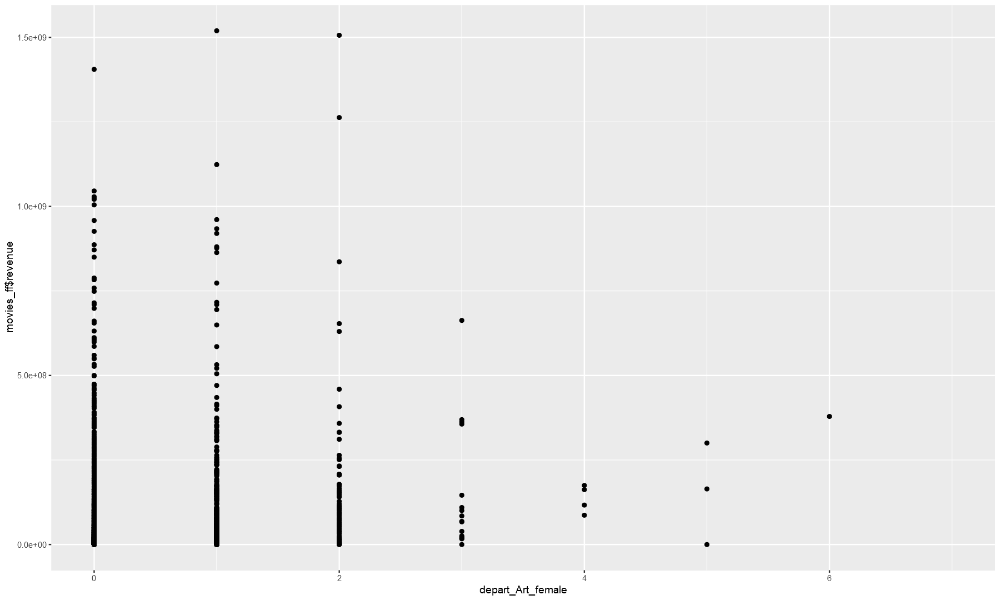

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


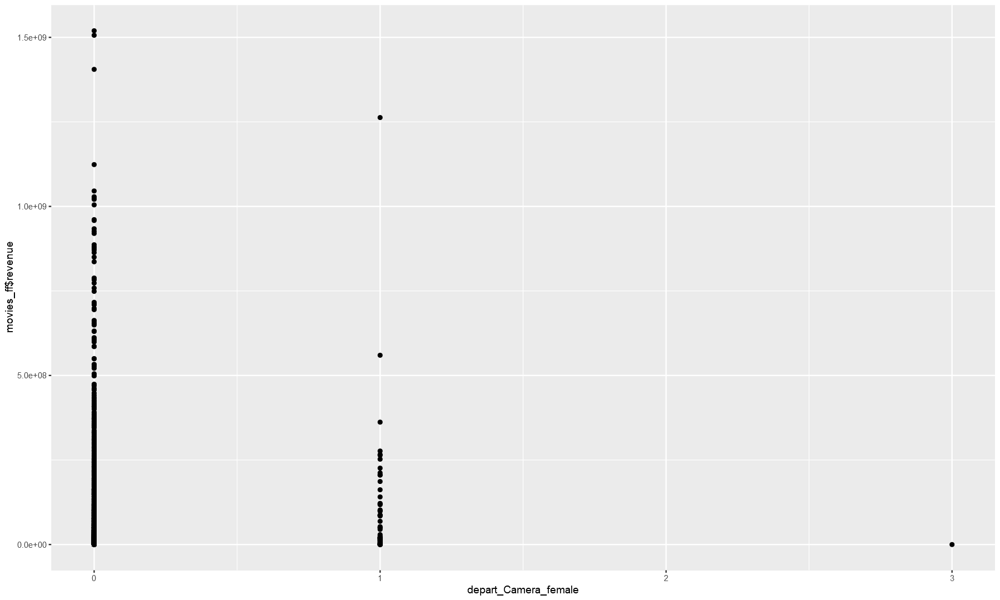

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


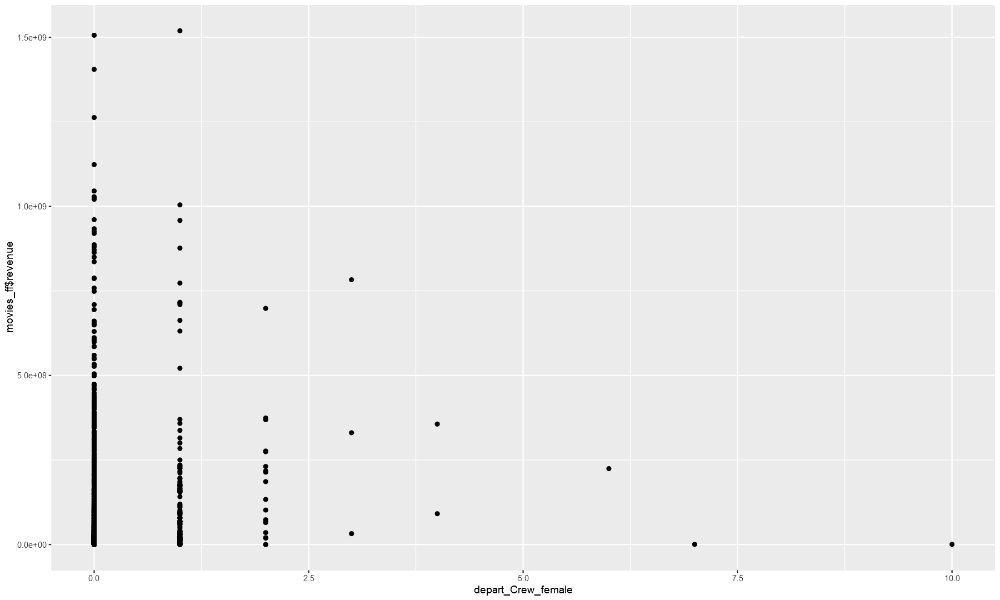

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


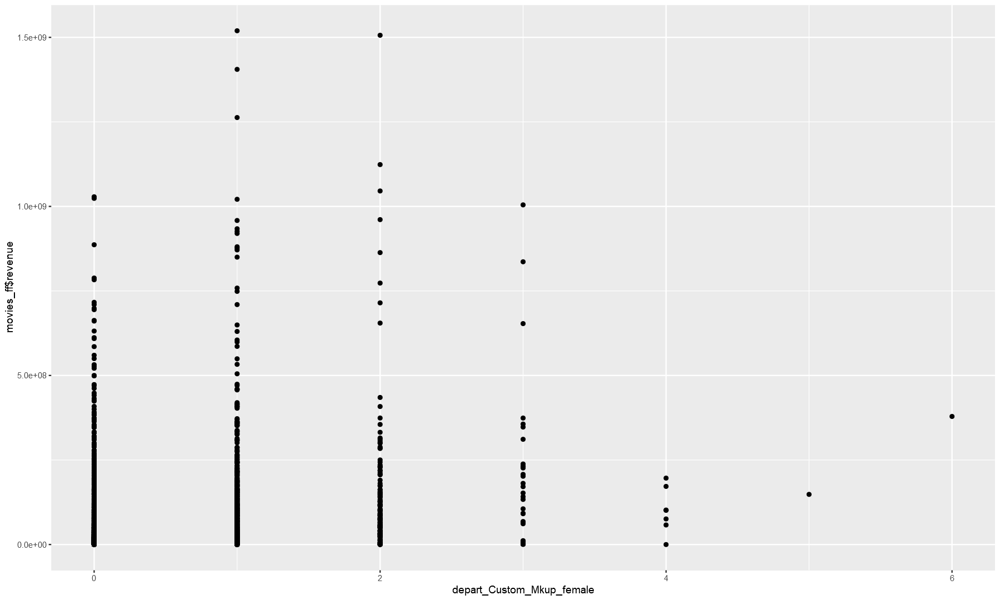

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


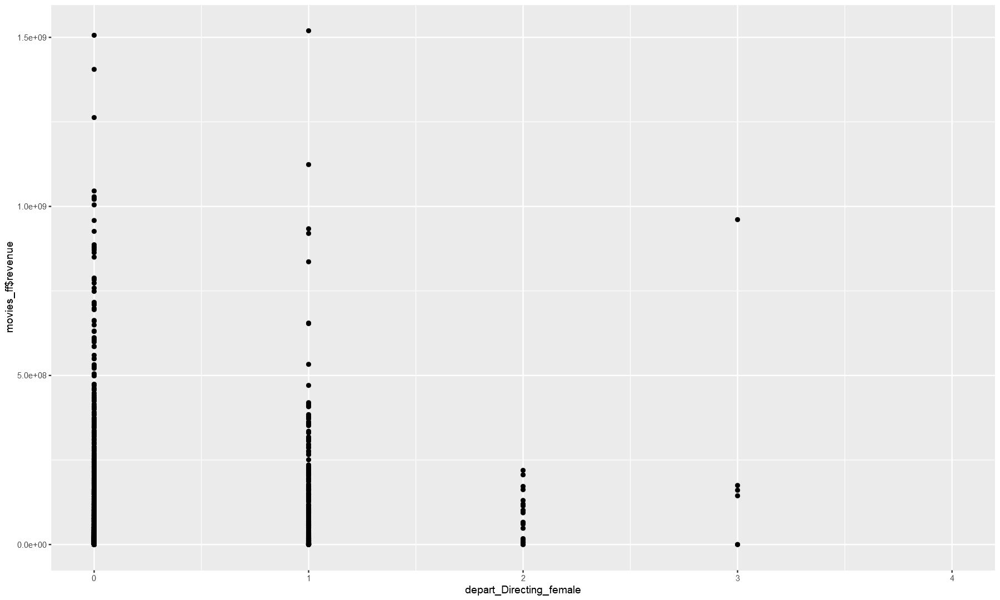

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


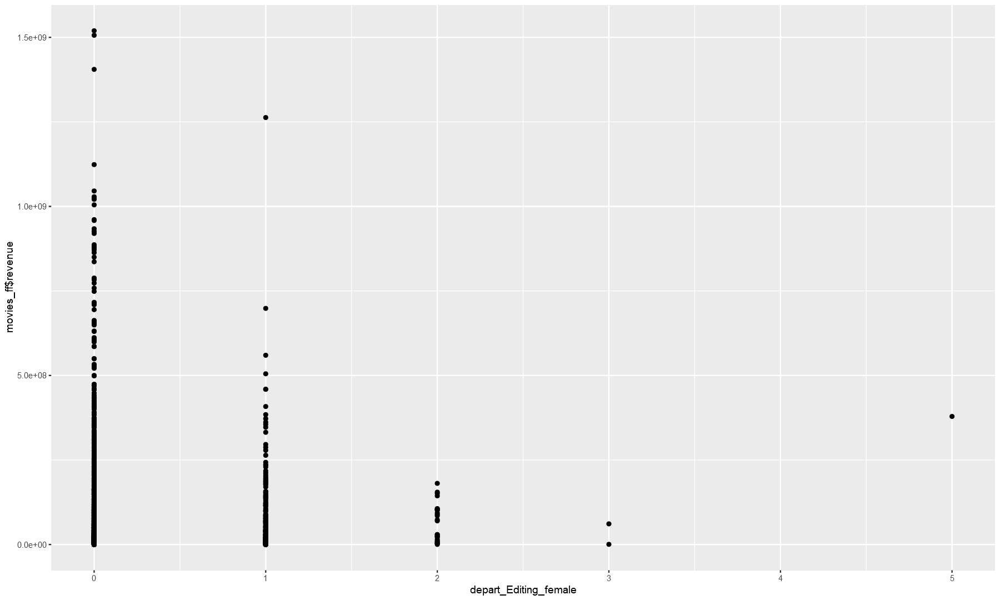

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


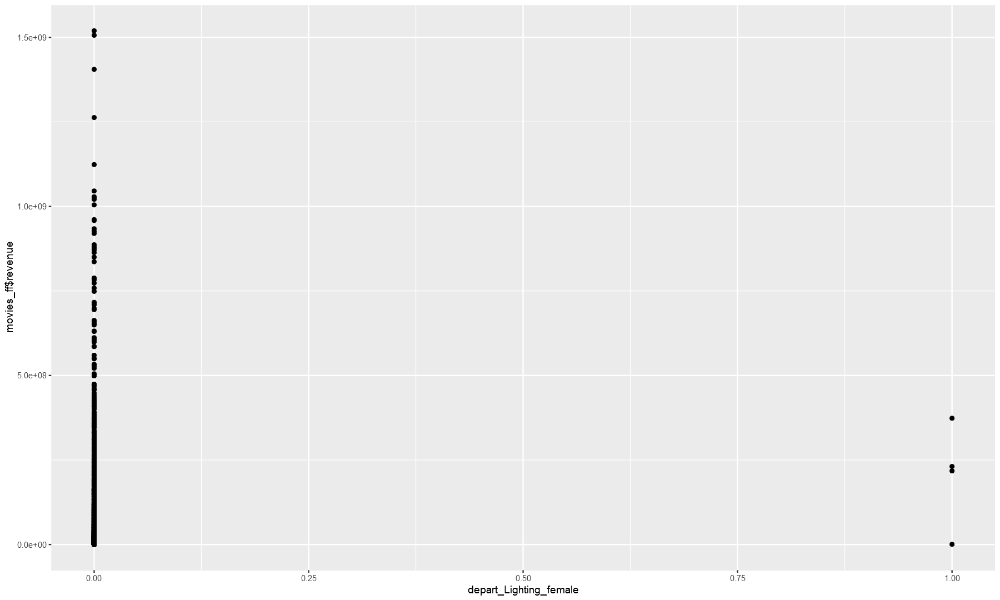

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


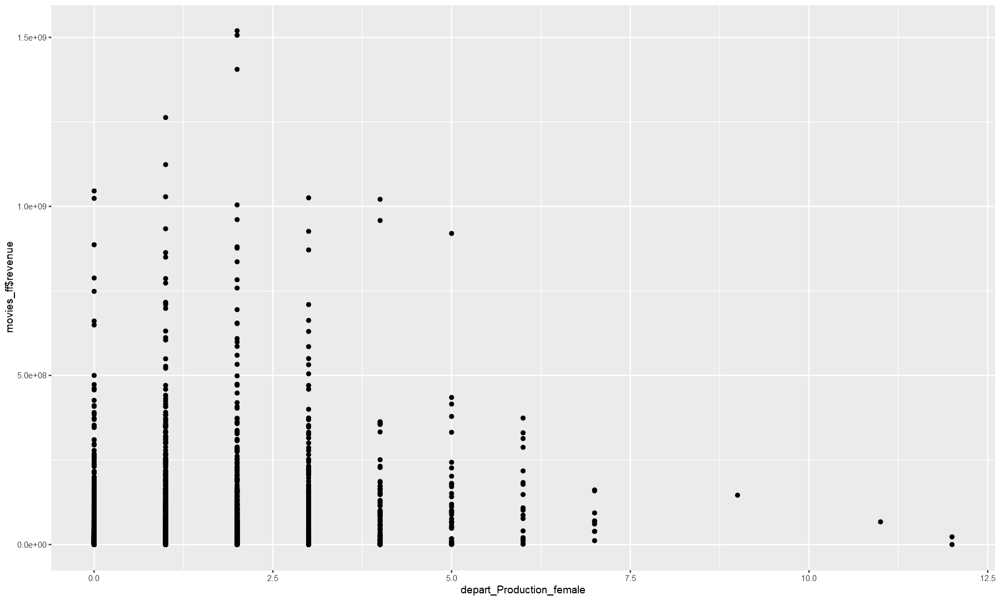

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


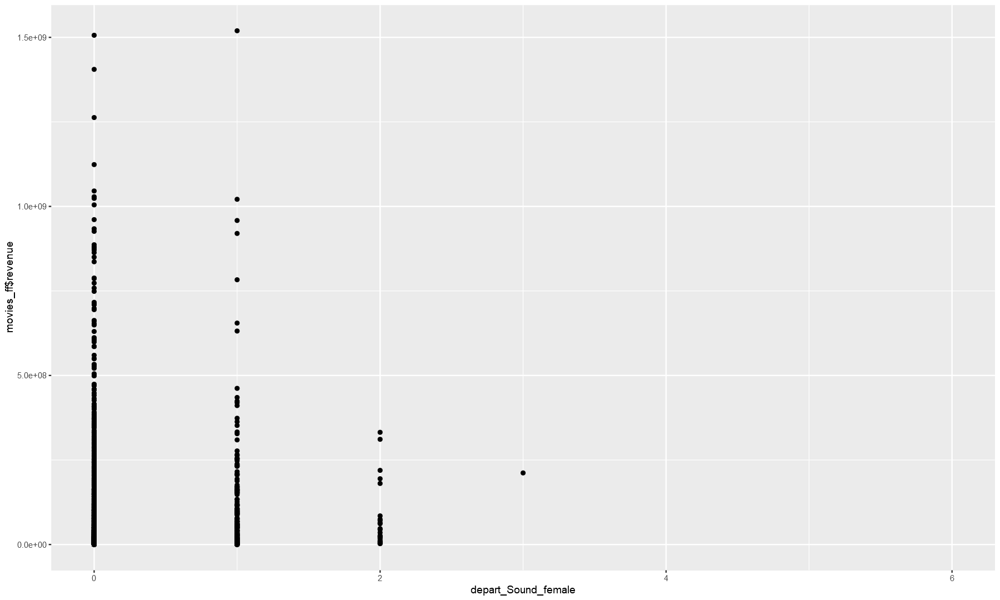

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


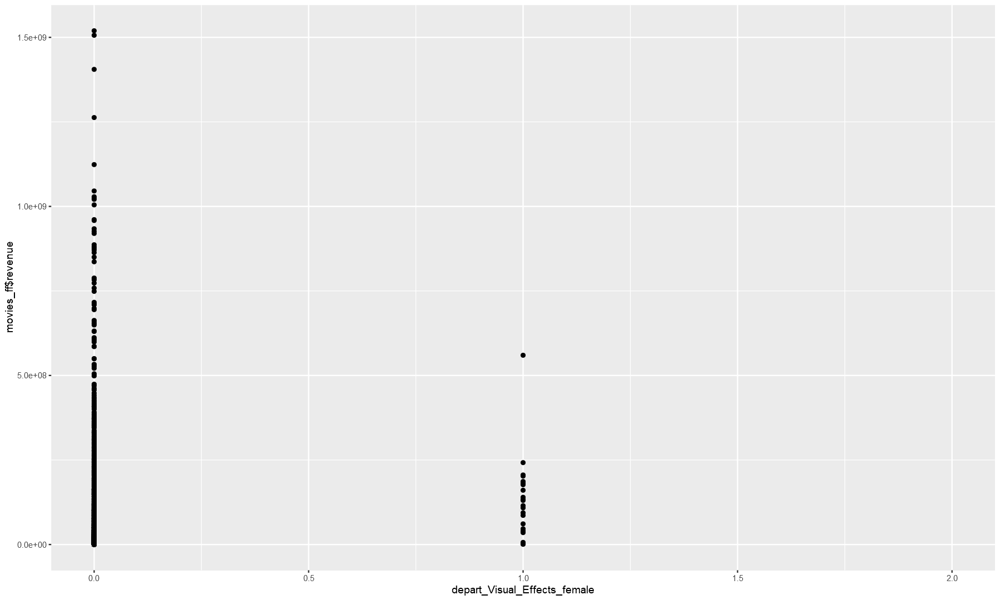

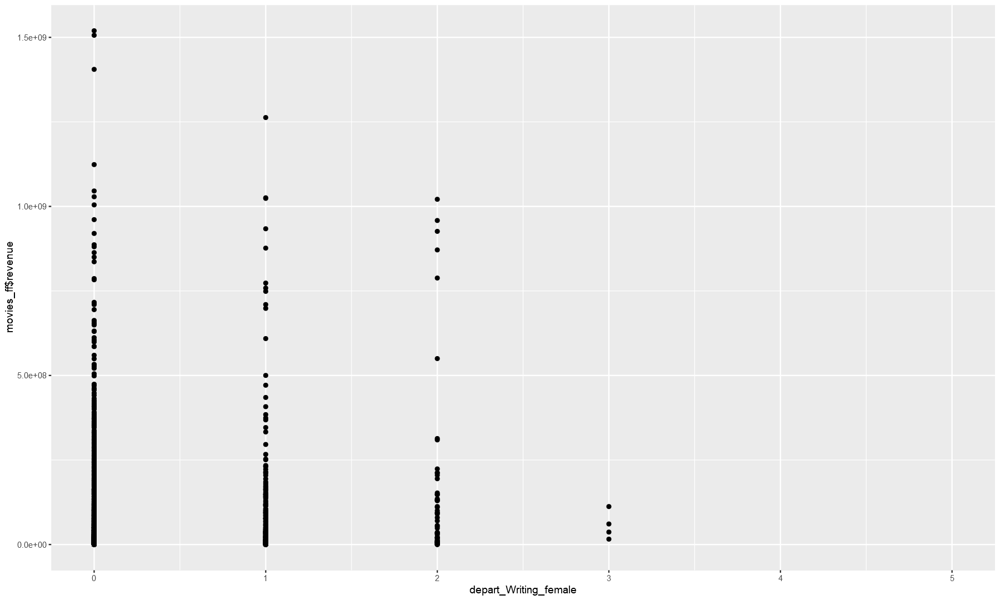

In [39]:

par(mfrow=c(2,5))

nm_cont <- names(movies_continuous[,1:44])

for (i in 1:44) {
    print(ggplot(data=movies_ff) +
          geom_point(aes(x=movies_continuous[,i], y=movies_ff$revenue)) +
          xlab(nm_cont[i]))
} 


## Outliers

In [26]:
outlierMatrix <- function(data,threshold=1.5) {
    vn <- names(data)
    outdata <- data.frame(row1=1:nrow(data))
    for(v in vn) {
        if(is.numeric(data[[v]])) {
            med <- median (data[[v]],na.rm=TRUE)
            outlow <- quantile(data[[v]],probs = 0.25,na.rm = T) 
            outhigh <- quantile(data[[v]],probs = 0.75, na.rm = T)
            irq_level <- (outhigh - outlow) * threshold
            outlow <- outlow - irq_level
            outhigh <- outhigh +  irq_level
            mv <- ifelse(data[[v]] < outlow | data[[v]] > outhigh, 1, 0)
            outdata[v] <- mv
        } else {
            mv <- rep(0,nrow(data))
        }
    }
    outdata$row1 <- NULL
    return(outdata)
}

movies_outliers <- outlierMatrix(movies_ff)

ERROR: Error in vn[2, length(vn)]: incorrect number of dimensions


In [31]:
outlierMatrix <- function(data,threshold=1.5) {
    vn <- setdiff(names(data),"movie_id")
    outdata <- data.frame(movie_id=data$movie_id)
    for(v in vn) {
        if(is.numeric(data[[v]])) {
            med <- median (data[[v]],na.rm=TRUE)
            outlow <- quantile(data[[v]],probs = 0.25,na.rm = T) 
            outhigh <- quantile(data[[v]],probs = 0.75, na.rm = T)
            irq_level <- (outhigh - outlow) * threshold
            outlow <- outlow - irq_level
            outhigh <- outhigh +  irq_level
            mv <- ifelse(data[[v]] < outlow | data[[v]] > outhigh, 1, 0)
            outdata[paste0(v,"_out")] <- mv
        } else {
            mv <- rep(0,nrow(data))
        }
    }
    outdata$row1 <- NULL
    return(outdata)
}

movies_outliers <- outlierMatrix(movies_ff)

In [32]:
## Using IRQ for catching univariate outliers (1.5 x IRQ) 1==Outliers
head(outlierMatrix(movies_ff,threshold=1.5))

,movie_id,runtime_out,budget_out,popularity_out,revenue_out,sw_lang_en_out,sw_web_presence_out,sw_has_poster_out,sw_tagline_out,release_year_out,...,depart_Camera_female_out,depart_Crew_female_out,depart_Custom_Mkup_female_out,depart_Directing_female_out,depart_Editing_female_out,depart_Lighting_female_out,depart_Production_female_out,depart_Sound_female_out,depart_Visual_Effects_female_out,depart_Writing_female_out
,<int>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,2,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,3,0,0,1,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
4,4,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
5,5,0,0,0,0,1,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
6,6,0,0,0,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0


Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


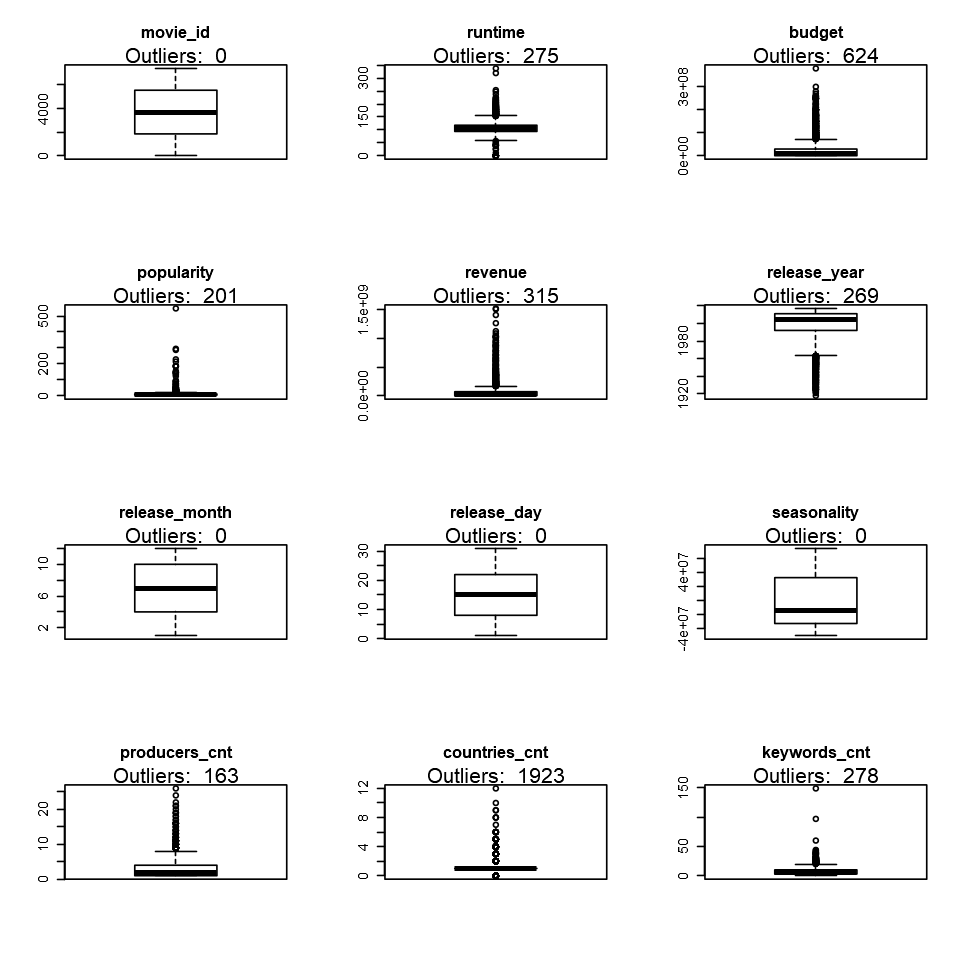

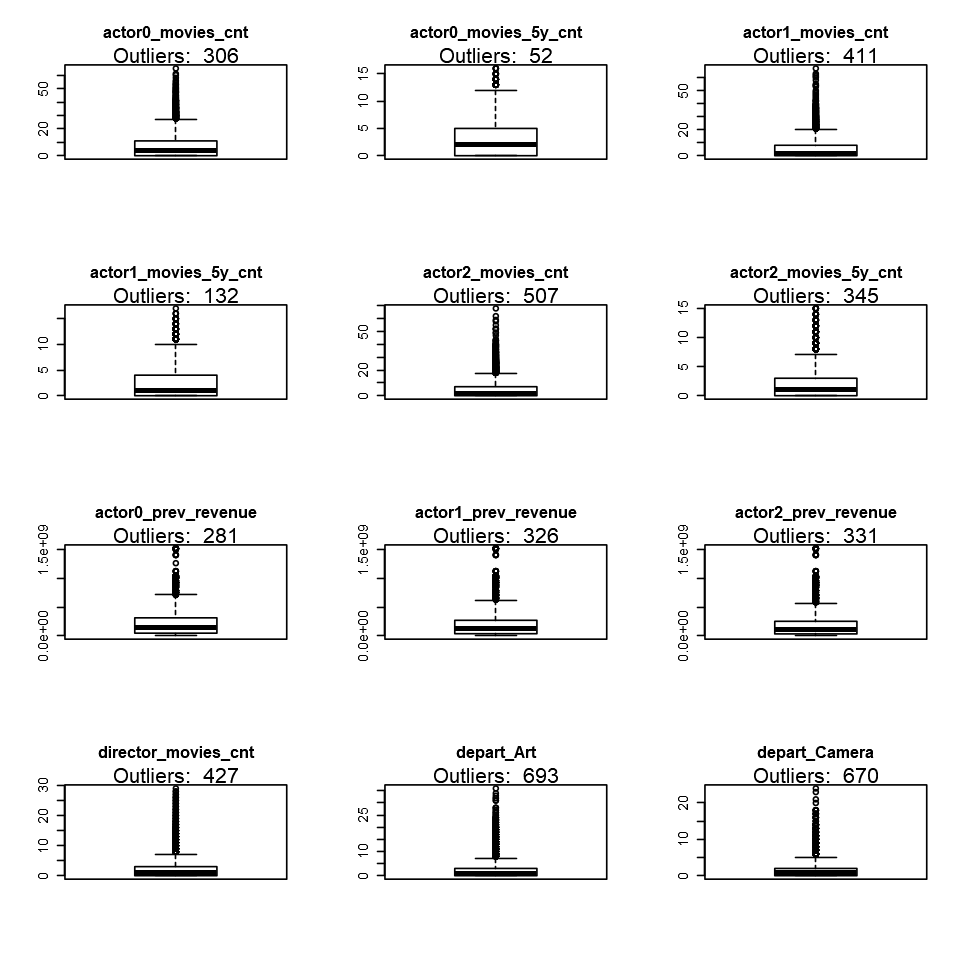

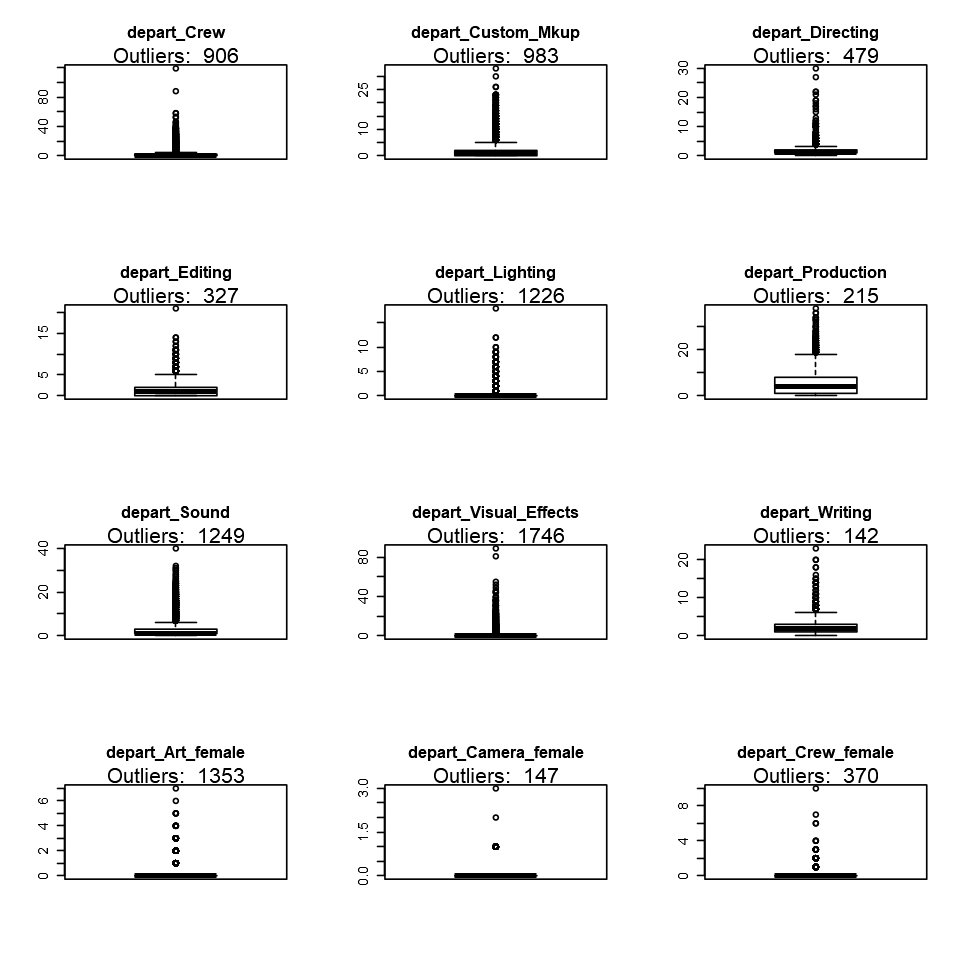

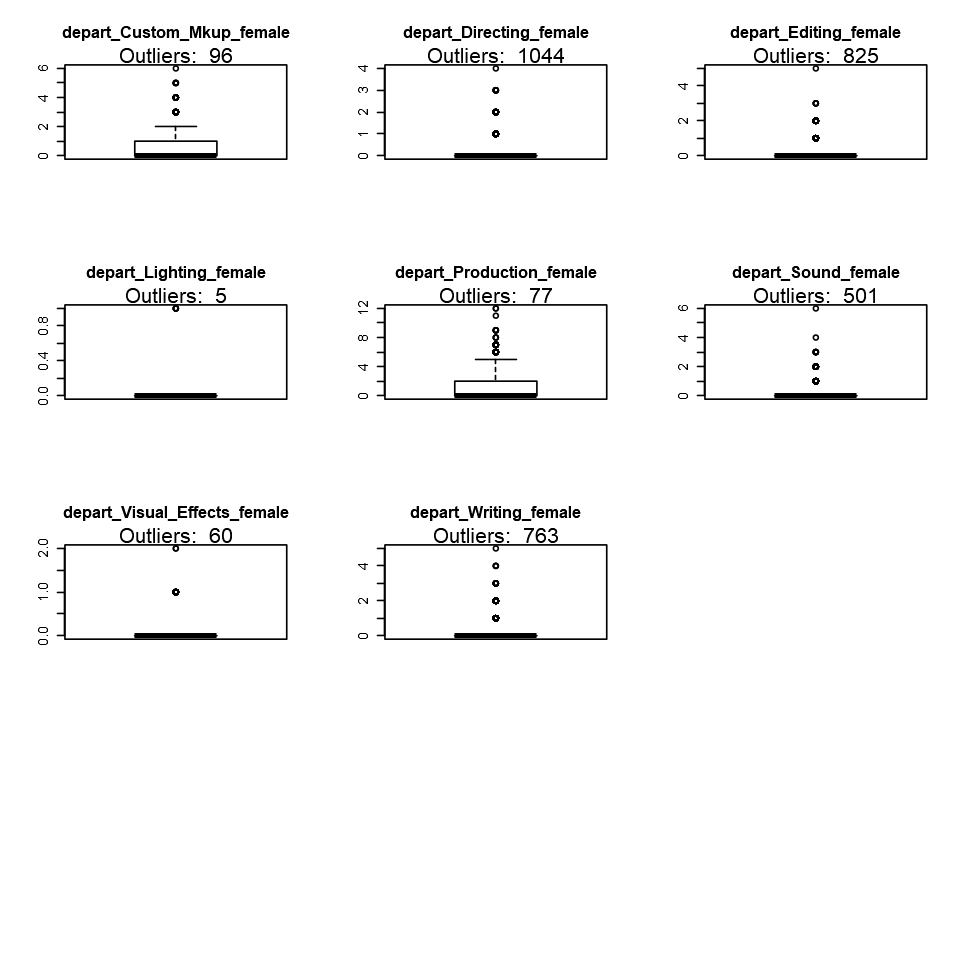

In [100]:
## Visual determination of univariate outliers using boxplots + outliers count
options(repr.plot.width = 8, repr.plot.height = 8)
par(mfrow=c(4,3))
for(v in names(movies_continuous[,1:44])) {
    outlier_values <- boxplot.stats(movies_continuous[,v])$out
    boxplot(movies_ff[[v]],main=v)
    mtext(paste("Outliers: ", paste(length(outlier_values), collapse=", ")), cex=1)
}
par(mfrow=c(1,1))

## Missingness

In [102]:
getMissingness <- function (data, getRows = FALSE) {
    require(dplyr)
    l <- nrow(data)
    vn <- names(data)
    nadf <- data
    cnt <- NULL
    miss <- function(x) return(sum(is.na(x)))
    for (n in vn) {
        nadf[[n]] <- ifelse(is.na(nadf[[n]]) == T, 1, 0)
        cnt <- rbind(cnt, data.frame(n, sum(nadf[[n]])))
    }
    names(cnt) <- c("var", "na.count")
    cnt$rate <- round((cnt$na.count/nrow(nadf)) * 100, 1)
    nadf$na.cnt <- 0
    nadf$na.cnt <- rowSums(nadf)
    cnt <- cnt %>% dplyr::arrange(desc(na.count)) %>% dplyr::filter(na.count > 
        0)
    totmiss <- nadf %>% dplyr::filter(na.cnt == 0) %>% dplyr::tally()
    idx <- NULL
    msg <- (paste("This dataset has ", as.character(totmiss), 
        " (", as.character(round(totmiss/nrow(data) * 100, 1)), 
        "%)", " complete rows. Original data has ", nrow(data), 
        " rows.", sep = ""))
    if (getRows == TRUE & totmiss != 0) {
        nadf$rn <- seq_len(nrow(data))
        idx <- nadf %>% dplyr::filter(na.cnt == 0) %>% dplyr::select(rn)
    }
    print(list(head(cnt, n = 10), msg))
    return(list(missingness = cnt, message = msg, rows = idx$rn))
}

In [103]:
getMissingness(movies_ff)

[[1]]
                   var na.count rate
1              revenue     4382 59.4
2  actor2_prev_revenue     3423 46.4
3  actor1_prev_revenue     3201 43.4
4  actor0_prev_revenue     2752 37.3
5     sw_female_actor0      934 12.7
6       sw_male_actor0      934 12.7
7     sw_female_actor2      788 10.7
8       sw_male_actor2      788 10.7
9     sw_female_actor1      782 10.6
10      sw_male_actor1      782 10.6

[[2]]
[1] "This dataset has 1154 (15.6%) complete rows. Original data has 7375 rows."



var,na.count,rate
<fct>,<dbl>,<dbl>
revenue,4382,59.4
actor2_prev_revenue,3423,46.4
actor1_prev_revenue,3201,43.4
actor0_prev_revenue,2752,37.3
sw_female_actor0,934,12.7
sw_male_actor0,934,12.7
sw_female_actor2,788,10.7
sw_male_actor2,788,10.7
sw_female_actor1,782,10.6


In [114]:
missingMatrix <- function(data) {
    vn <- names(data)
    missdata <- data.frame(row1=1:nrow(data))
    for(v in vn) {
        mv <- ifelse(is.na(data[[v]]),1,0)
        missdata[v] <- mv
    }
    missdata$row1 <- NULL
    return(missdata)
}
movies_missing <- missingMatrix(data=movies_ff)
head(movies_missing)

,movie_id,original_language,release_date,runtime_cat,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,...,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Warning message:
"`cols` is now required.
Please use `cols = c(data)`"


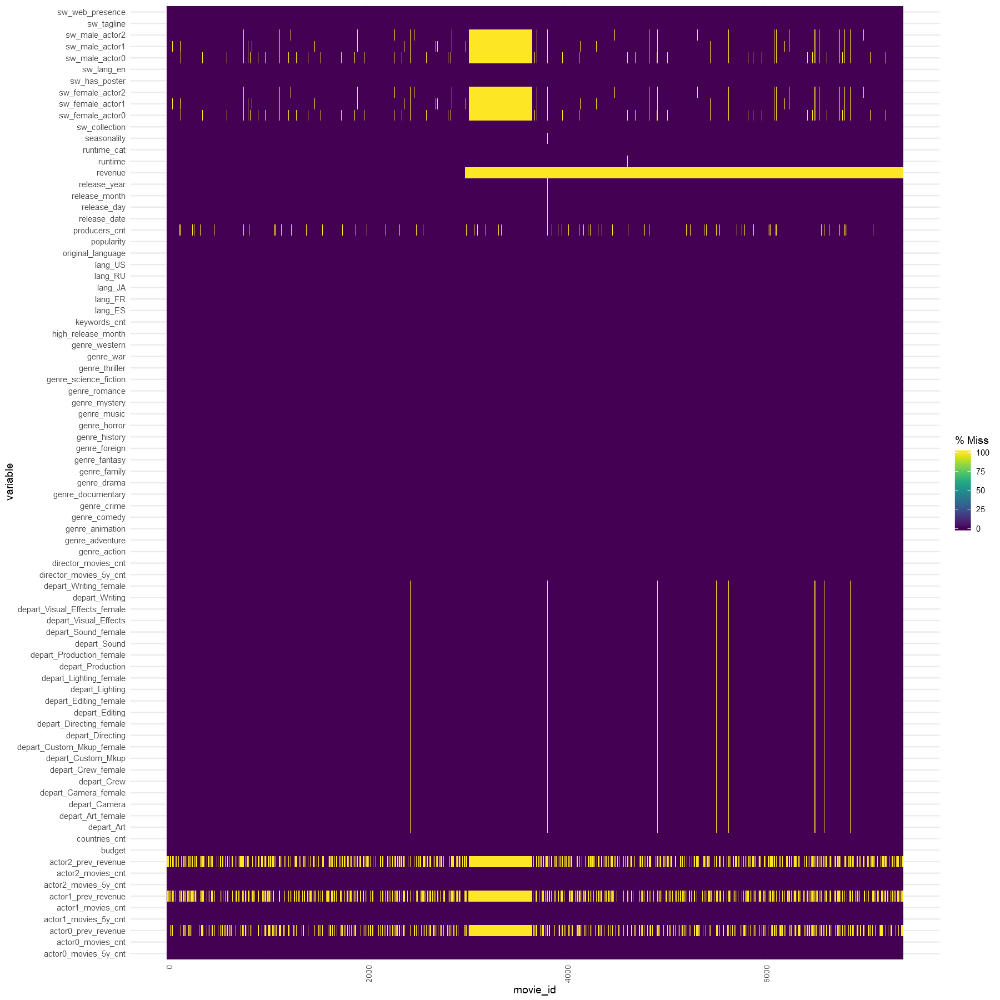

In [5]:
if(!require(naniar)) {install.packages("naniar");require(naniar)}
library(naniar)
options(repr.plot.width = 15, repr.plot.height = 15)

gg_miss_fct(x=movies_ff, fct=movie_id) + 
theme(axis.text.x = element_text(angle=90, size=8))

# חלק 3 - ניקוי הנתונים

## 3.1 נתוני קיצון

### 3.1.1 במשתנים שבהם מוצאים ערכי קיצון תבדקו את ההתפלגות של המשתנה עם ובלי ערכי הקיצון.  האם ההתפלגות משתנה?


Warning message:
"Removed 5 rows containing non-finite values (stat_density)."


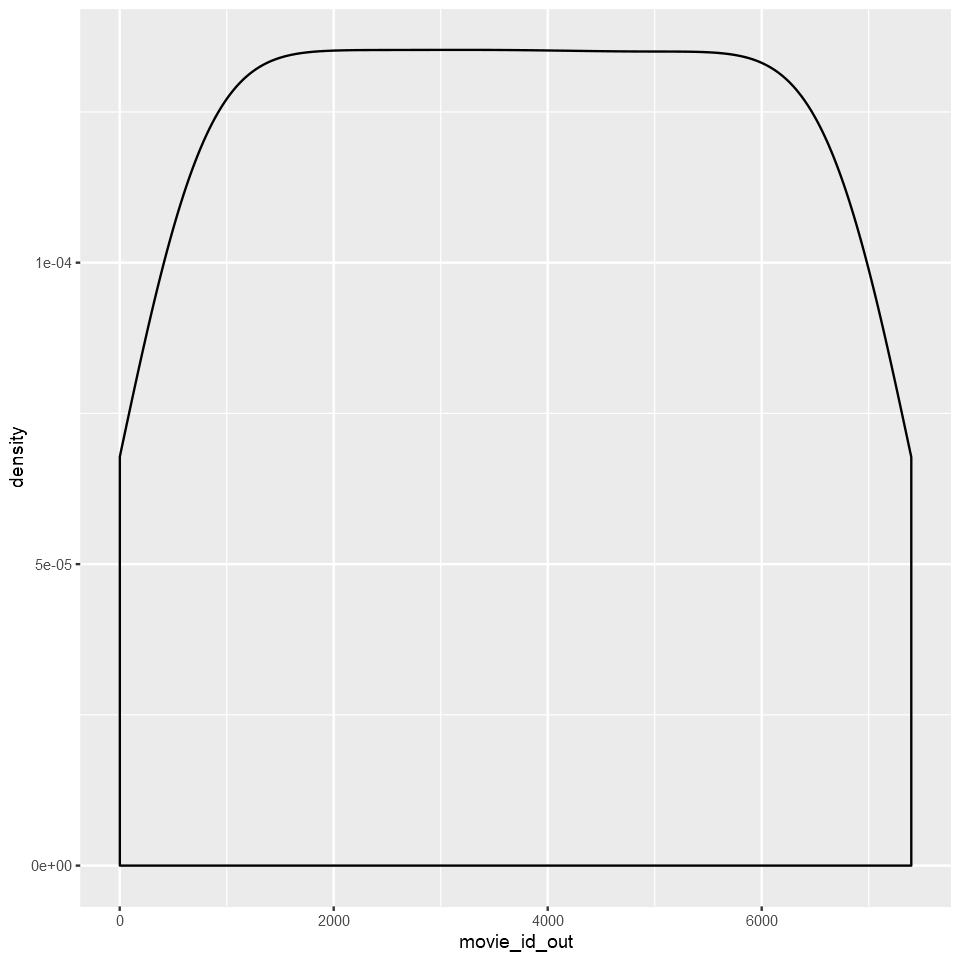

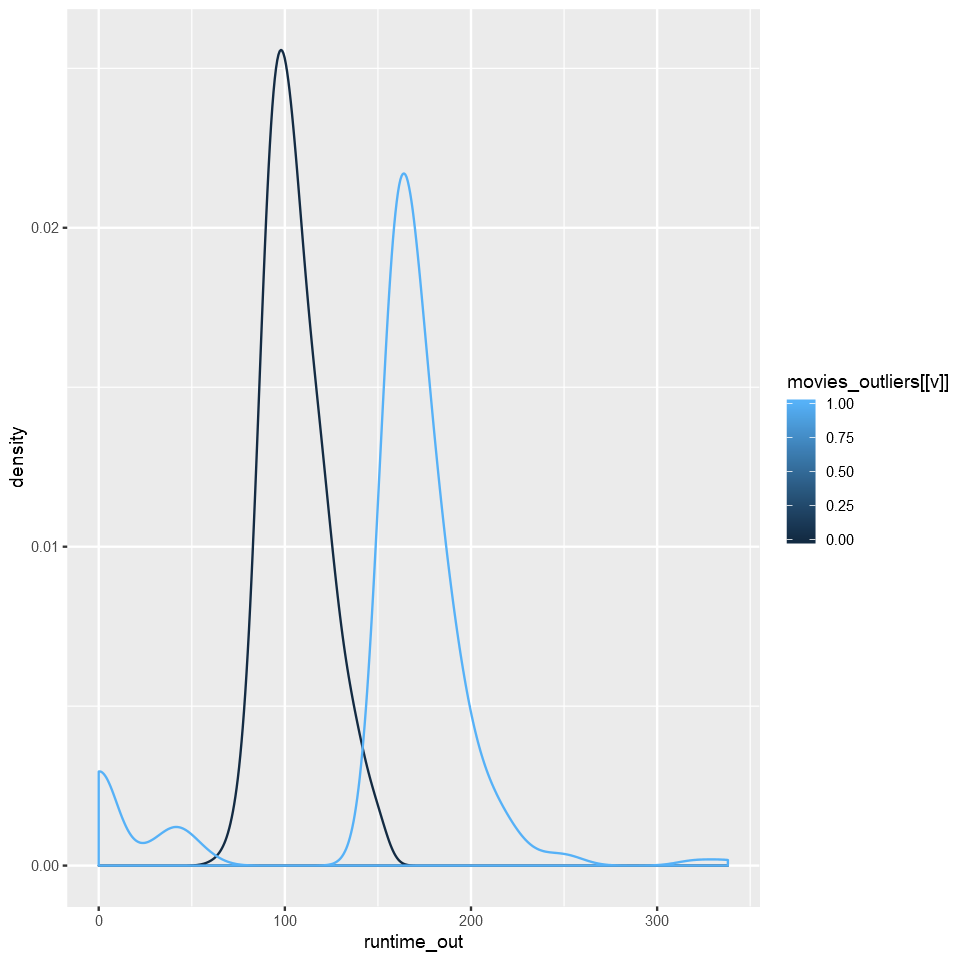

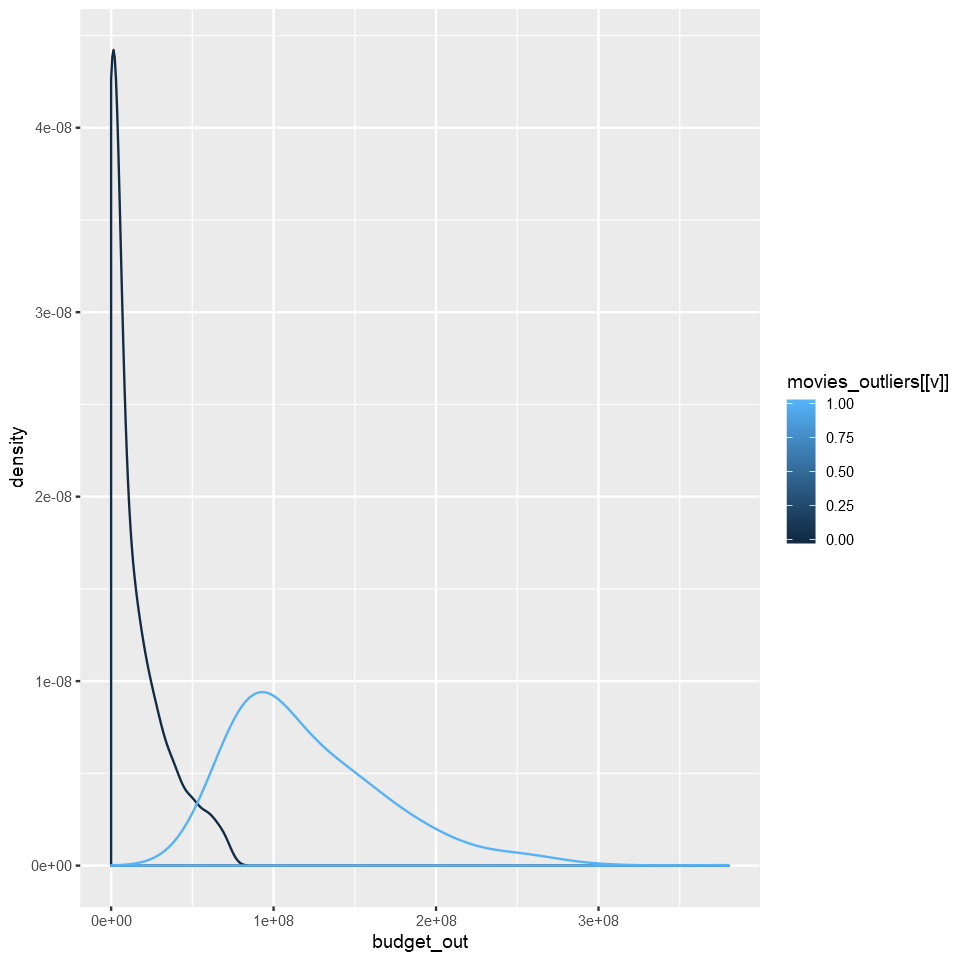

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."


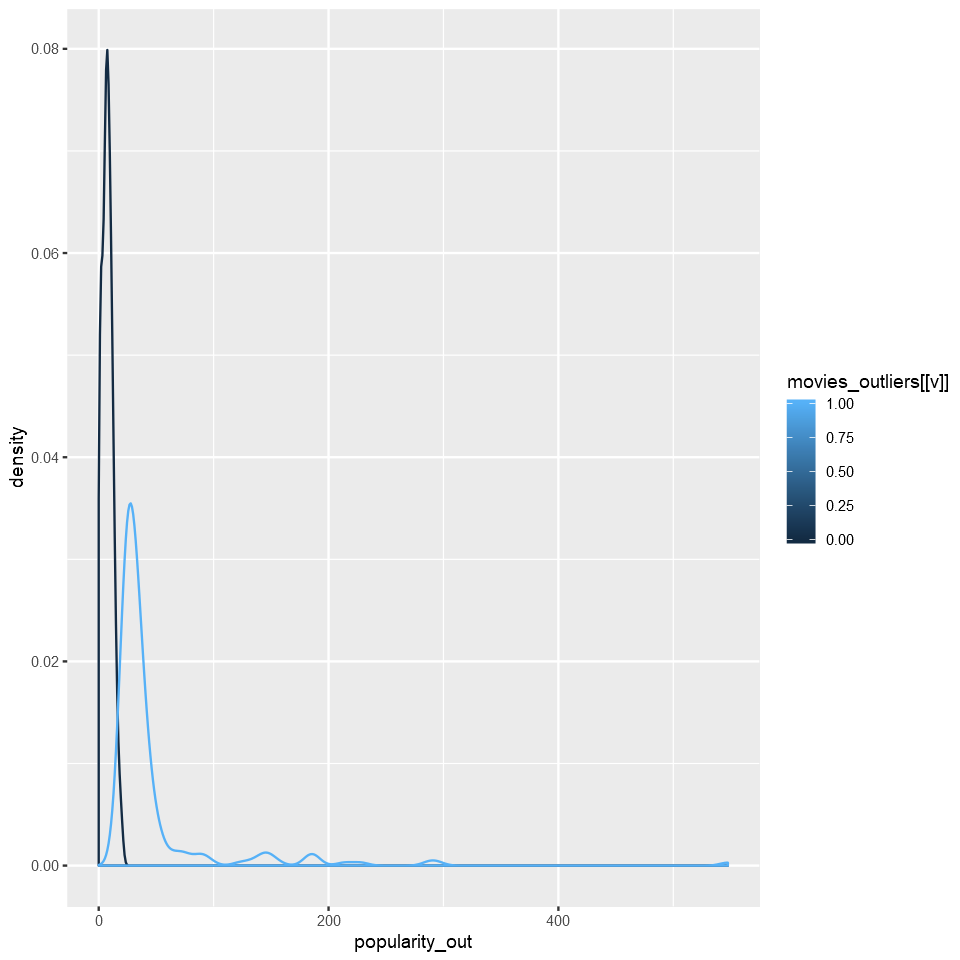

Warning message:
"Removed 1 rows containing non-finite values (stat_density)."


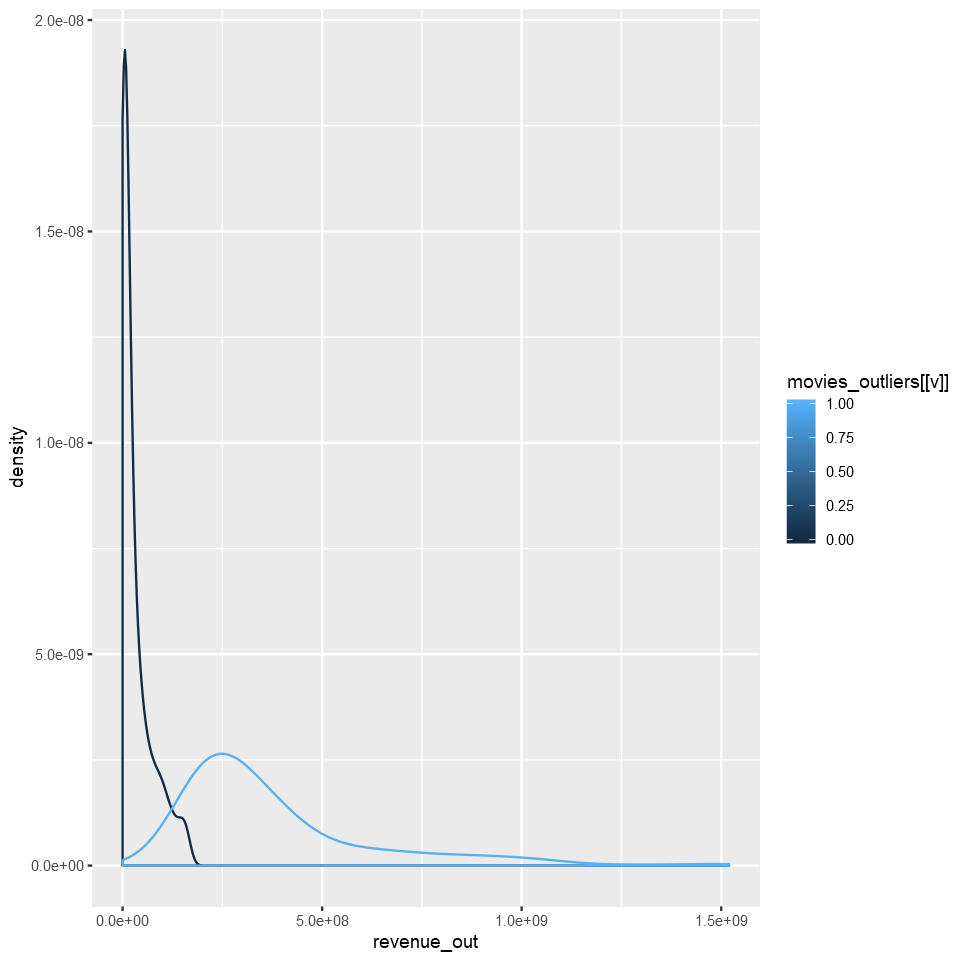

Warning message:
"Removed 1 rows containing non-finite values (stat_density)."


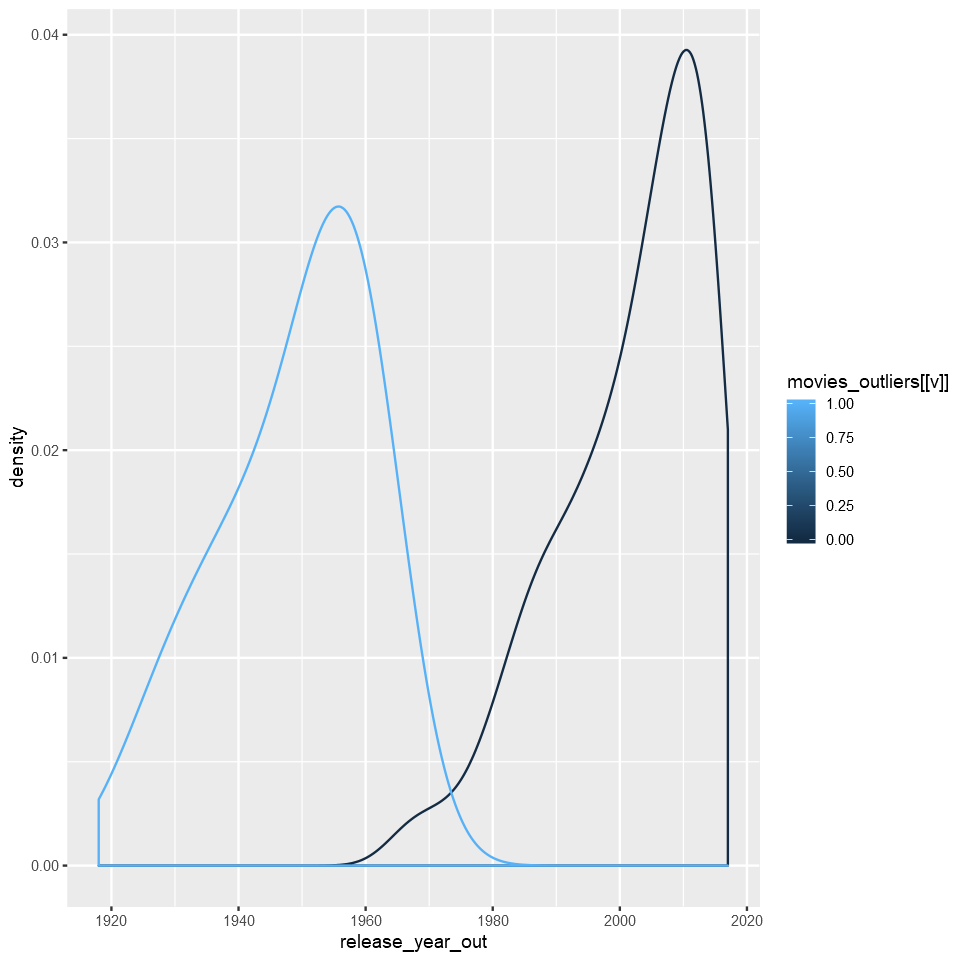

Warning message:
"Removed 1 rows containing non-finite values (stat_density)."


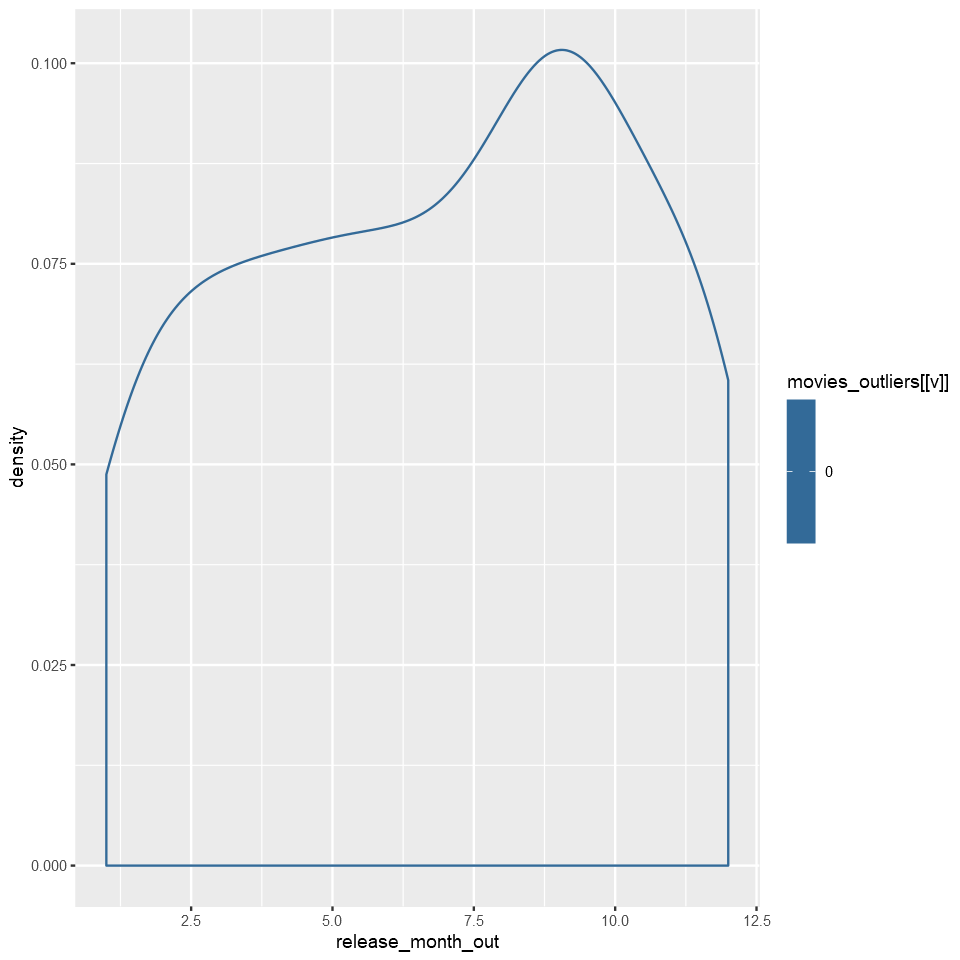

Warning message:
"Removed 1 rows containing non-finite values (stat_density)."


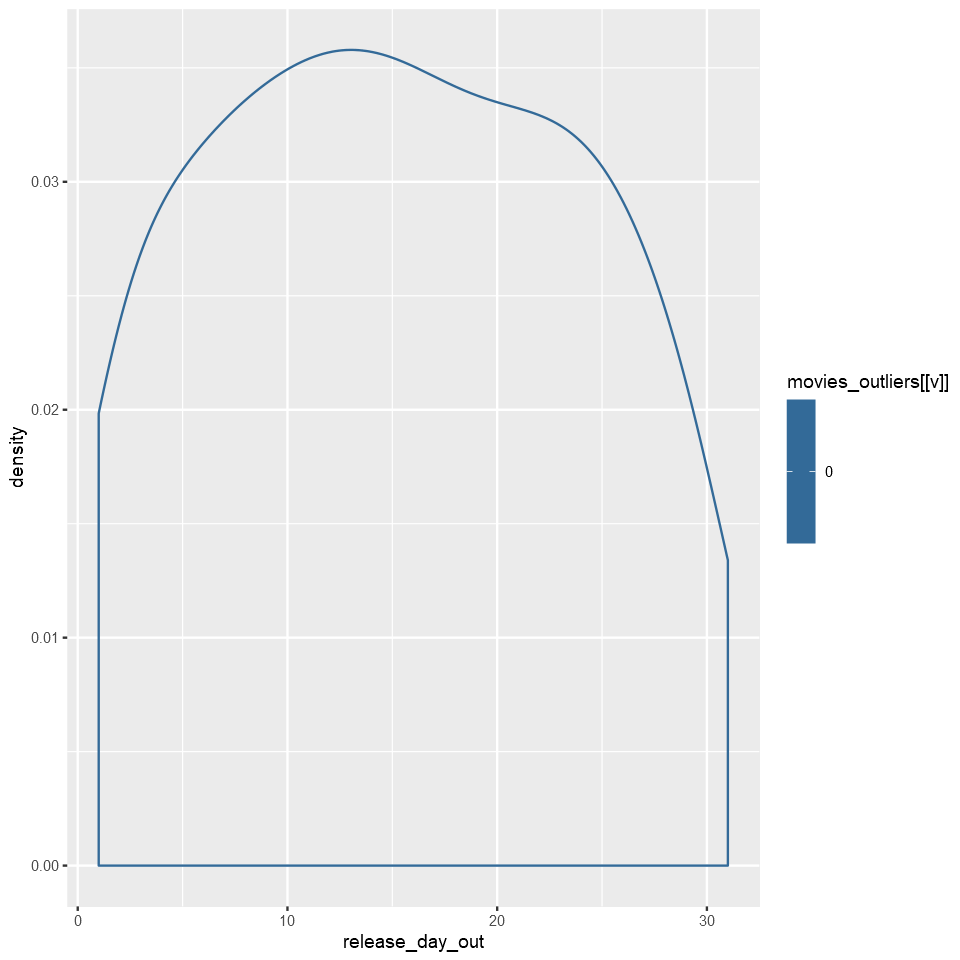

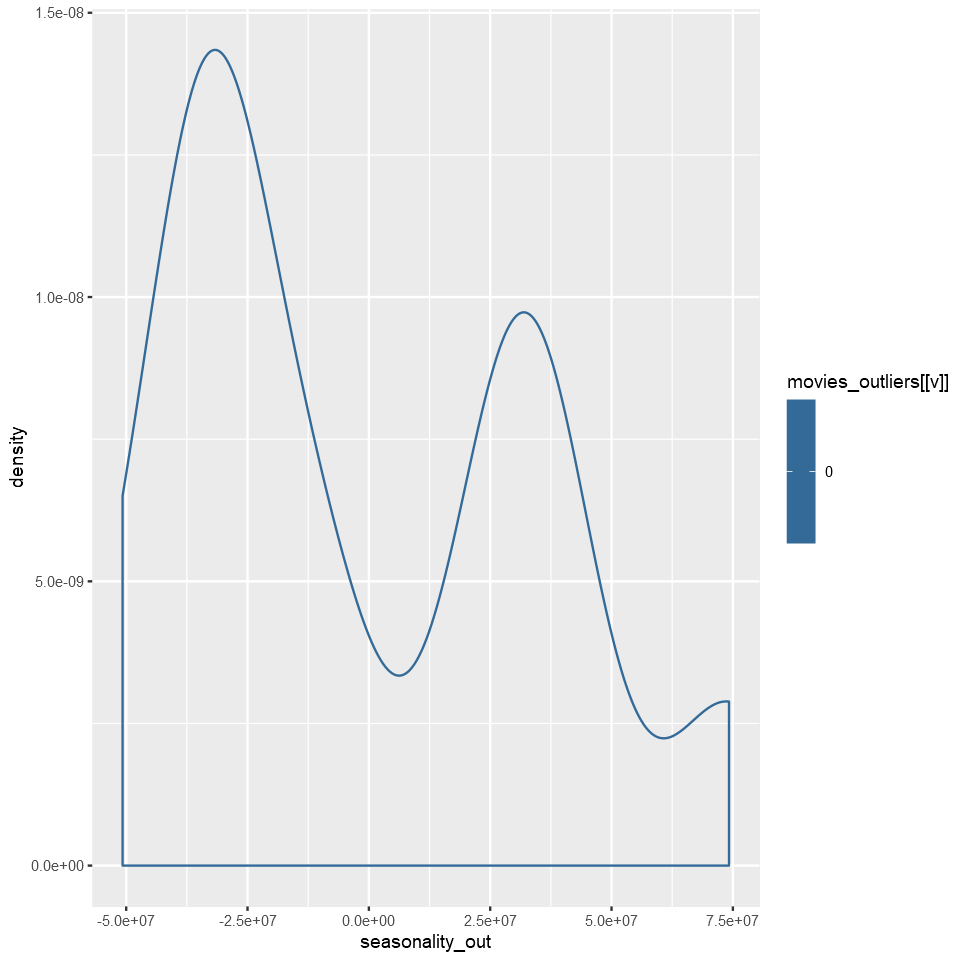

Warning message:
"Removed 395 rows containing non-finite values (stat_density)."


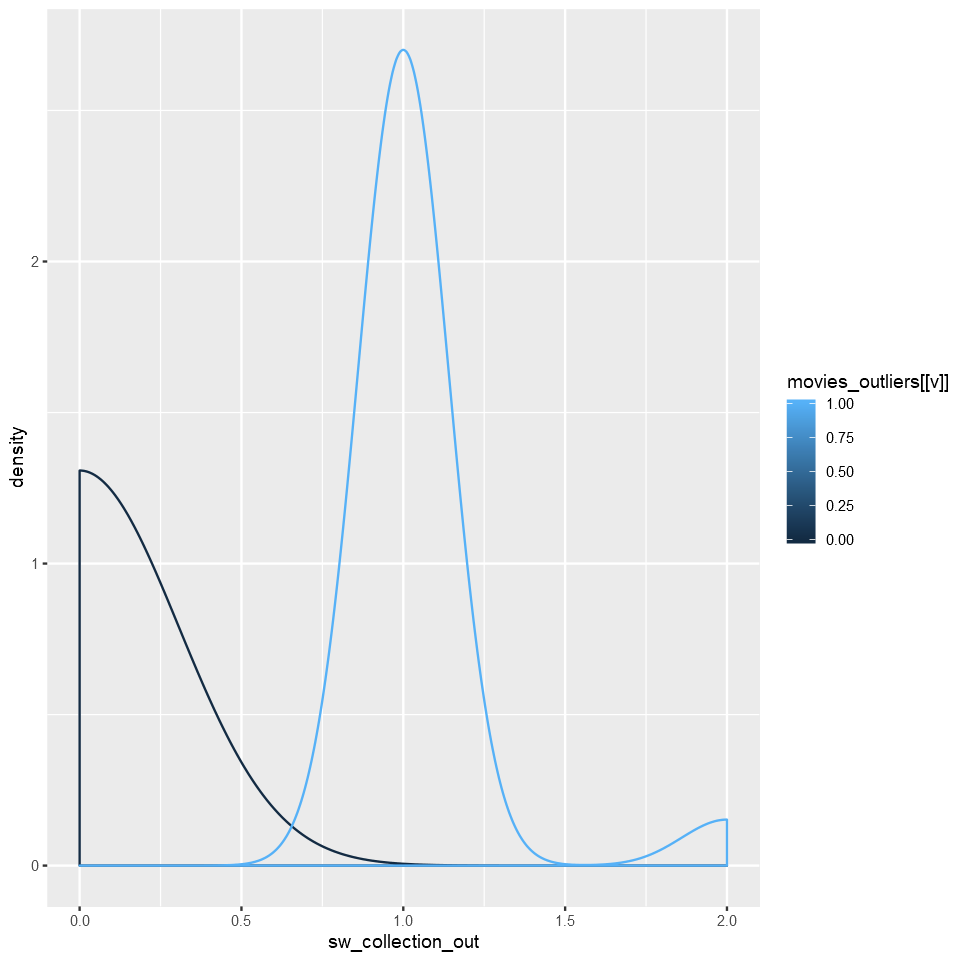

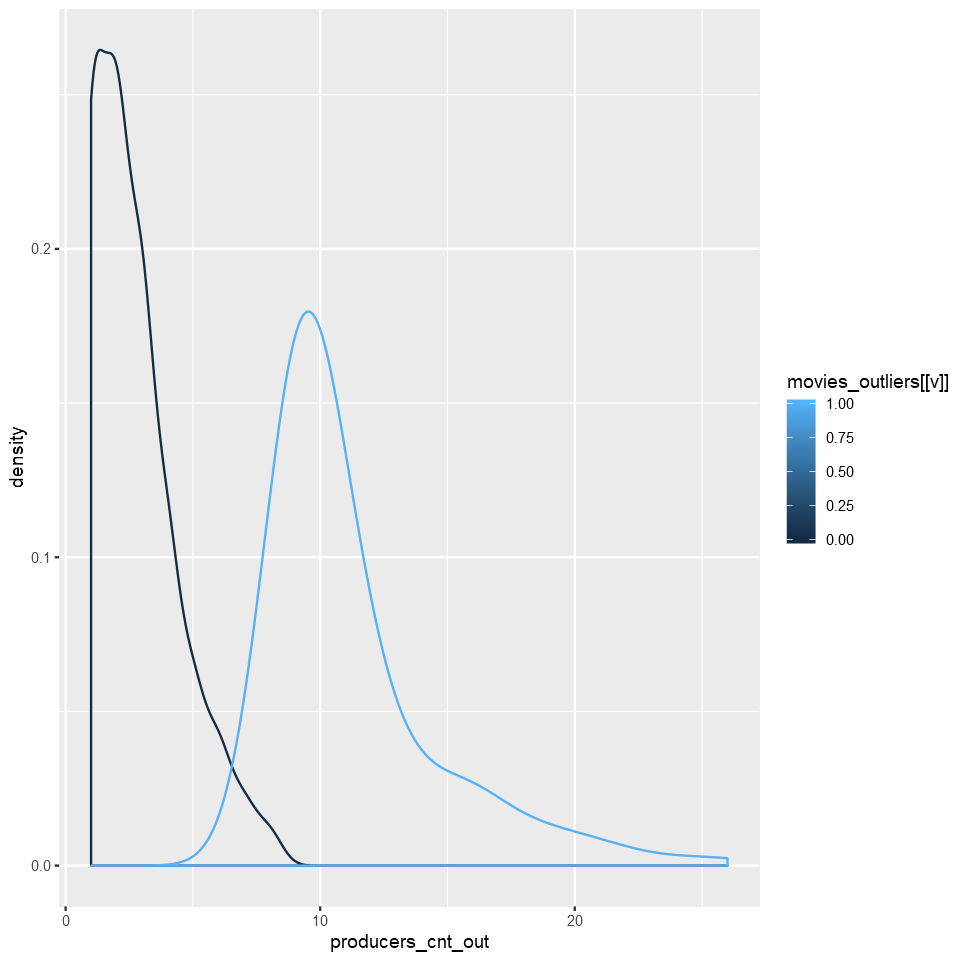

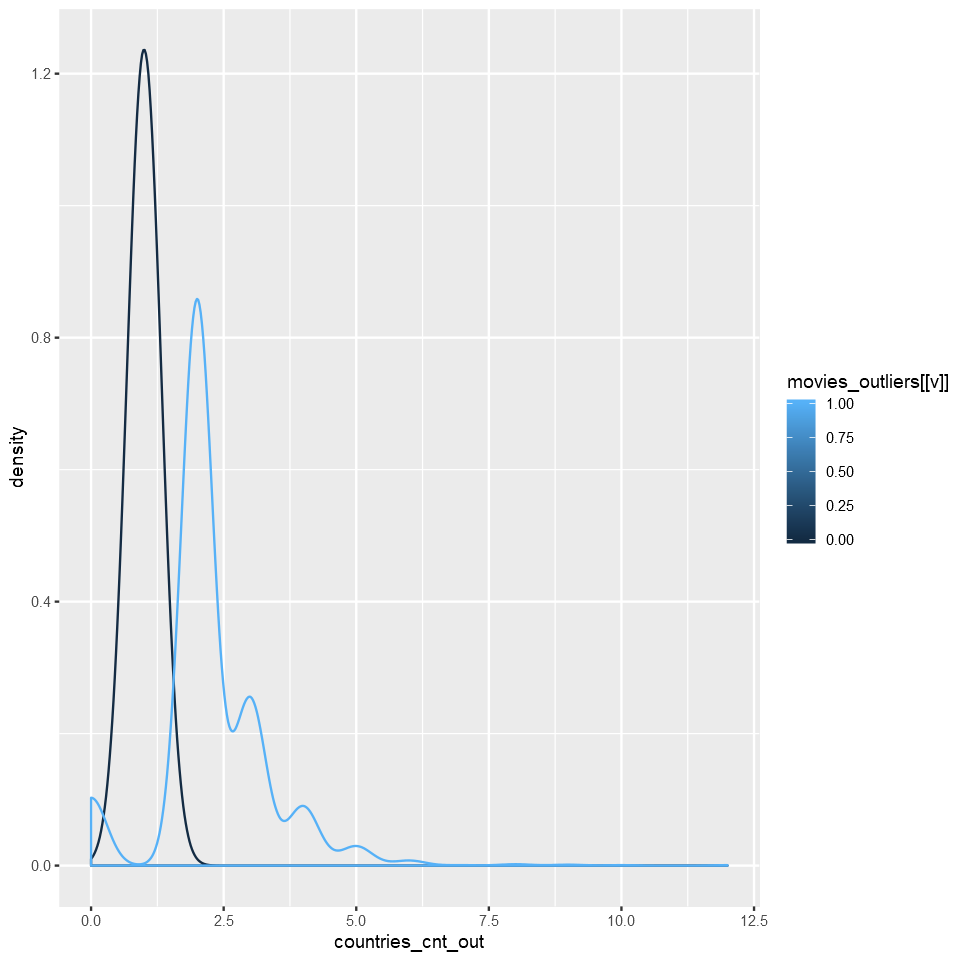

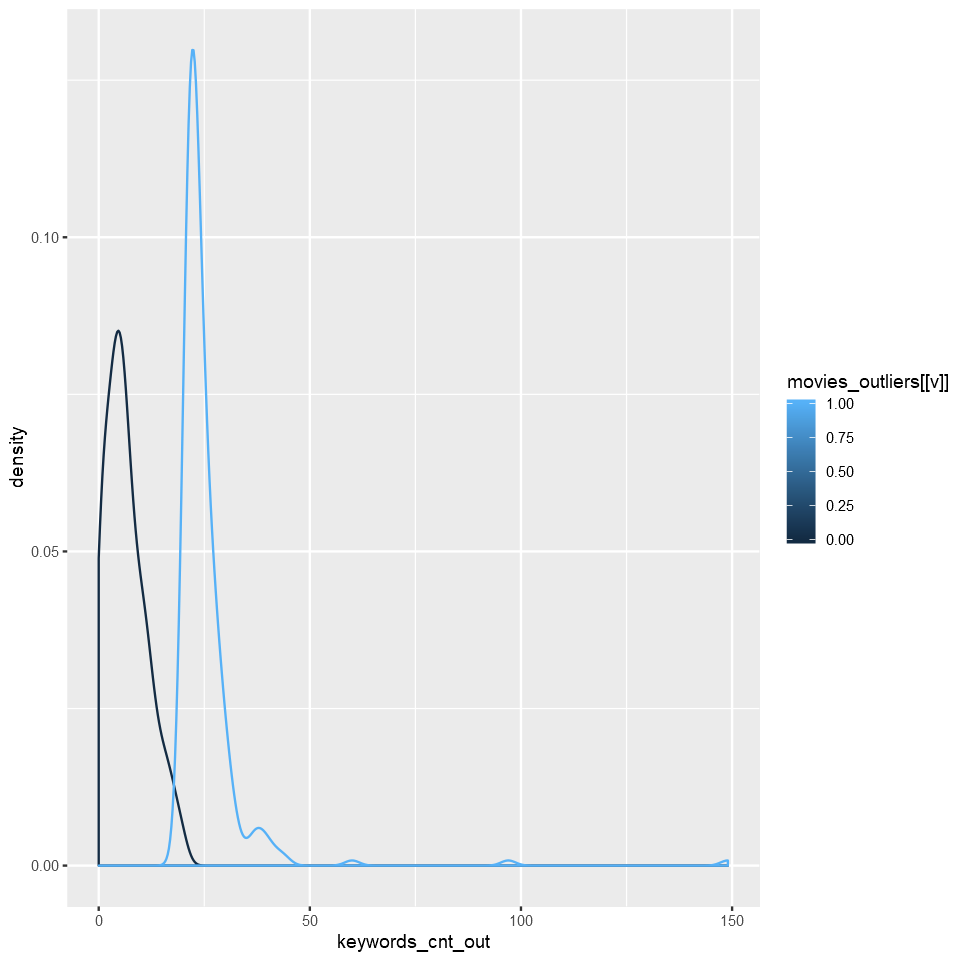

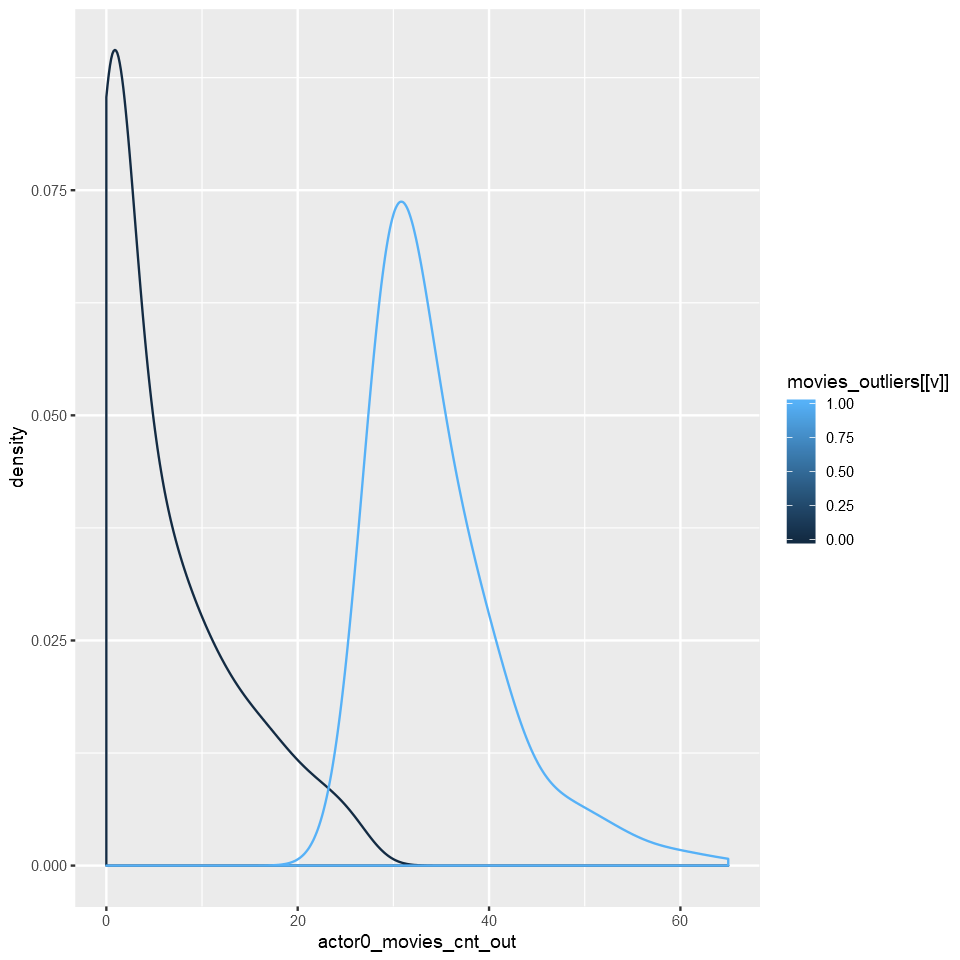

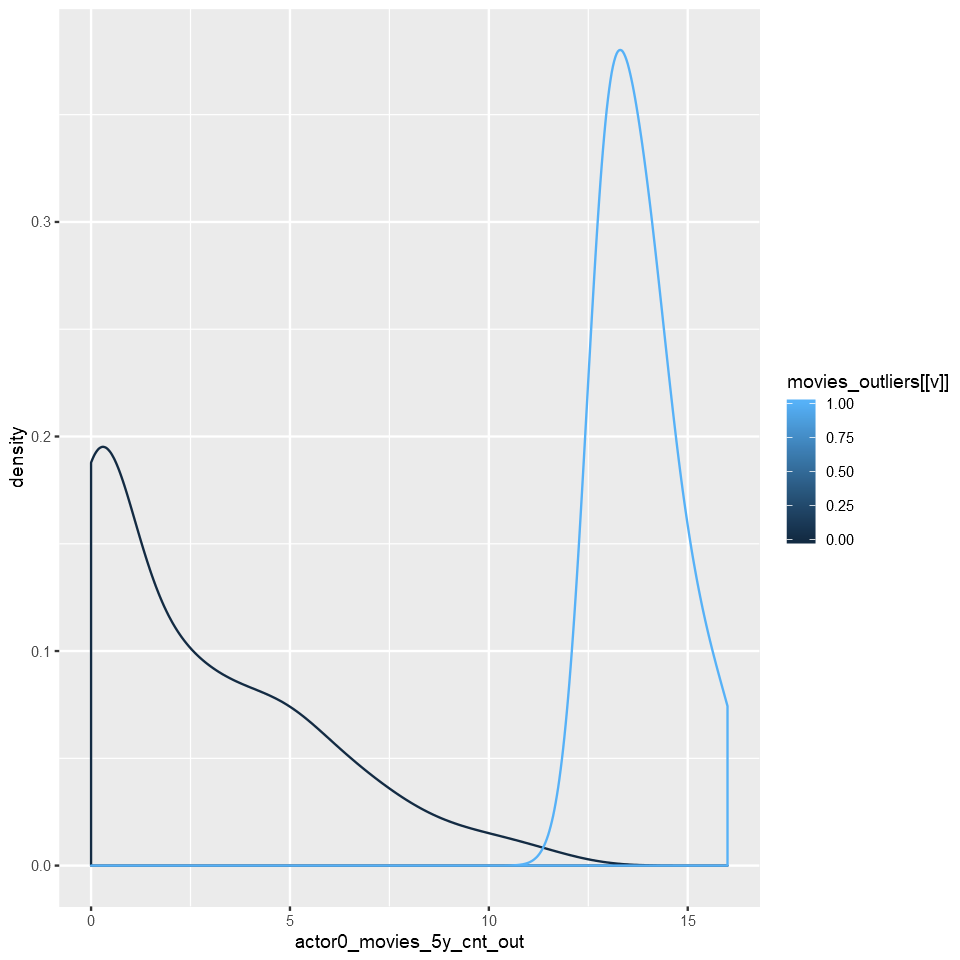

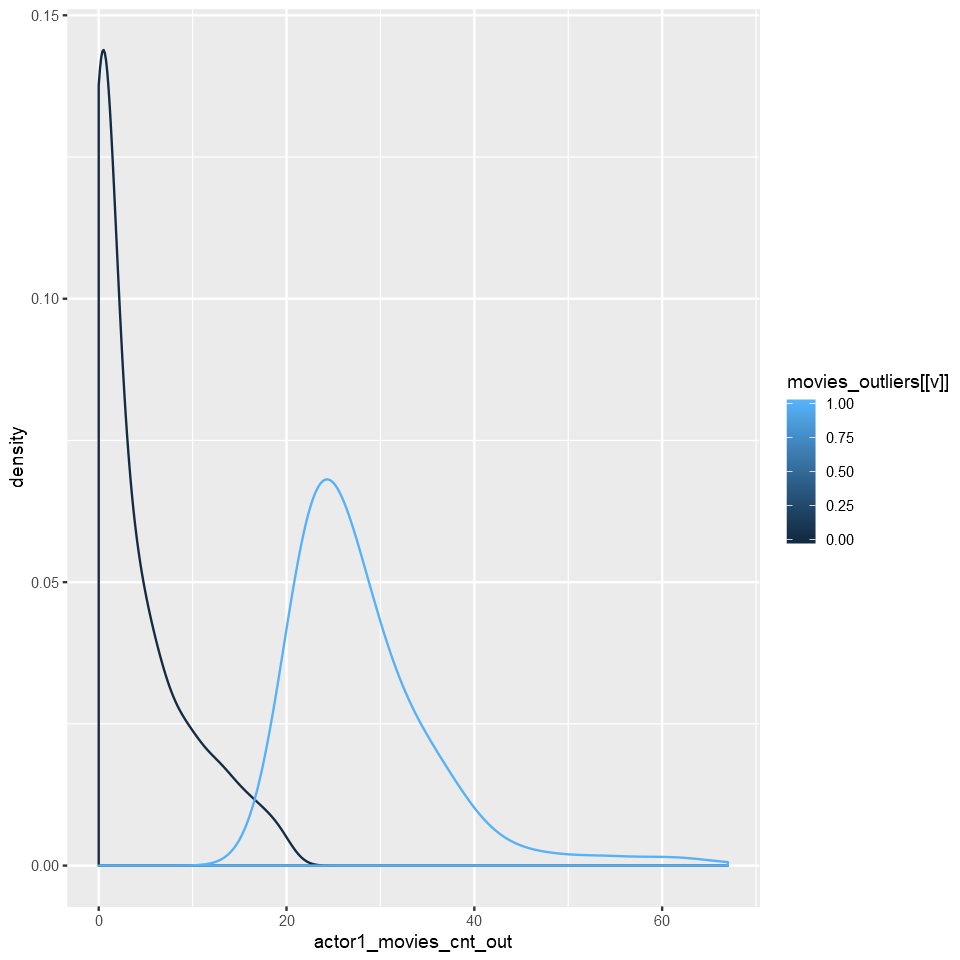

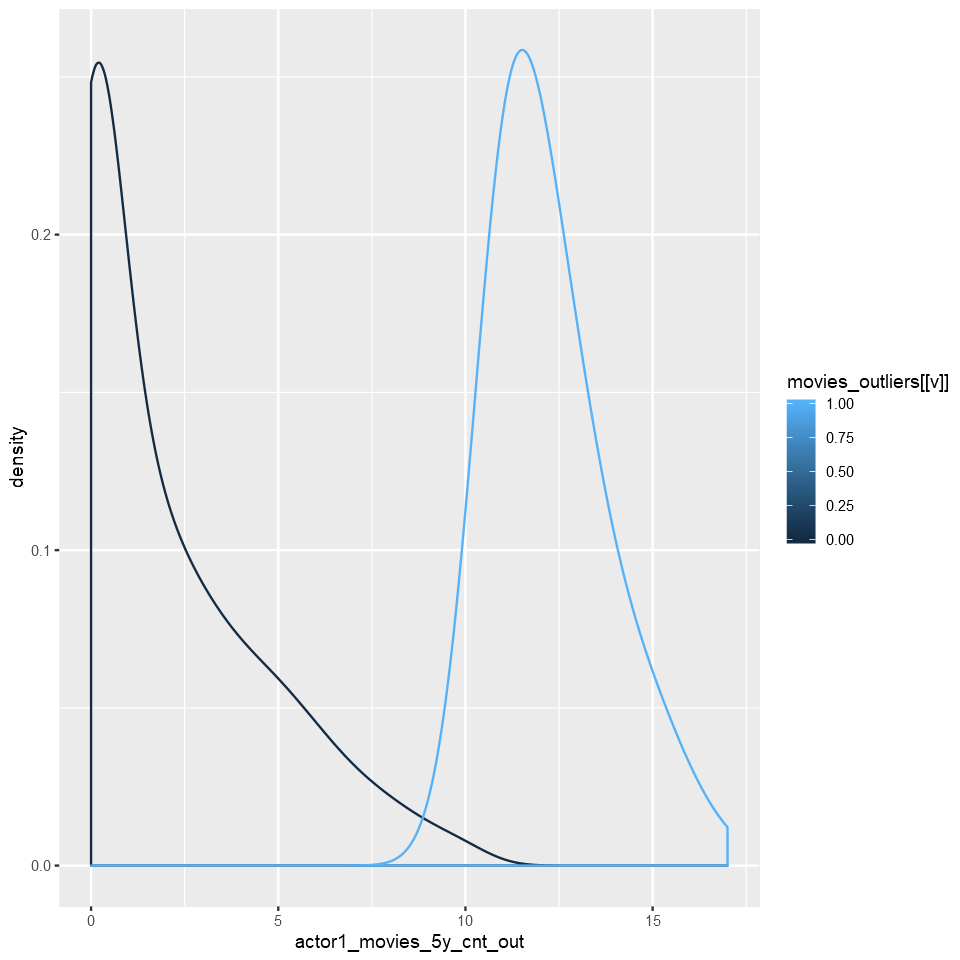

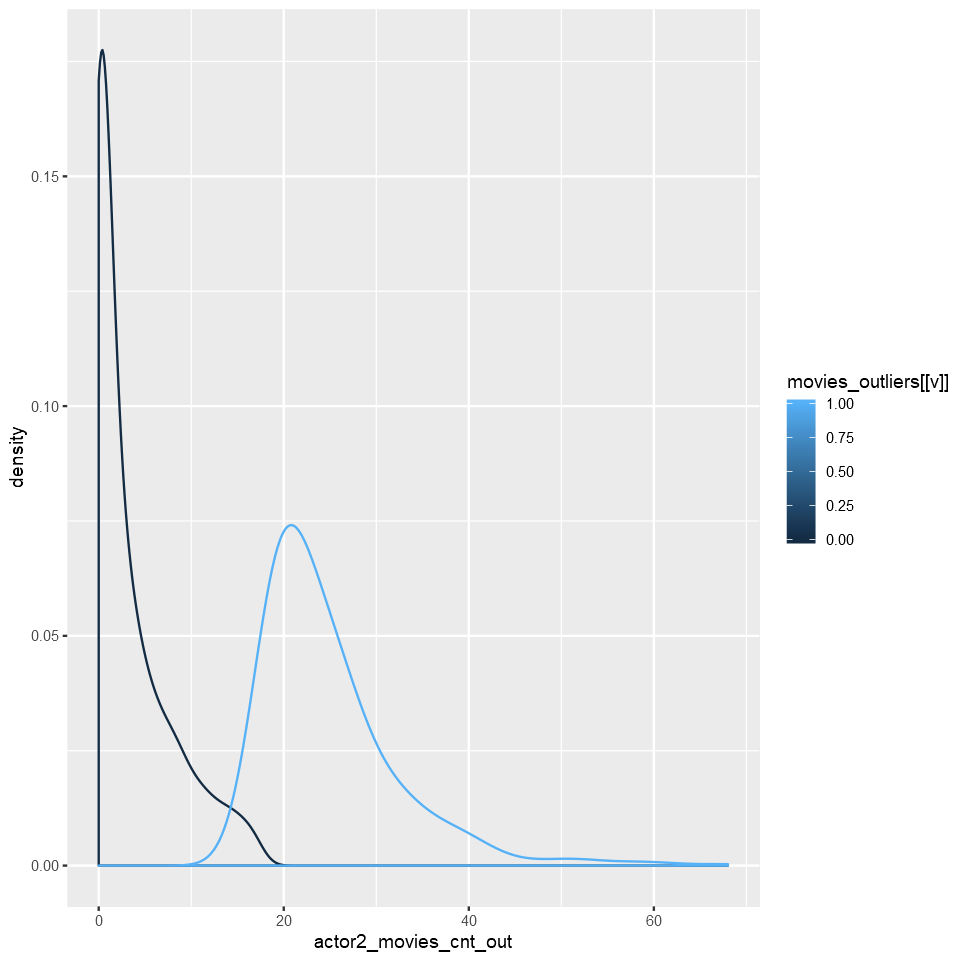

Warning message:
"Removed 2752 rows containing non-finite values (stat_density)."


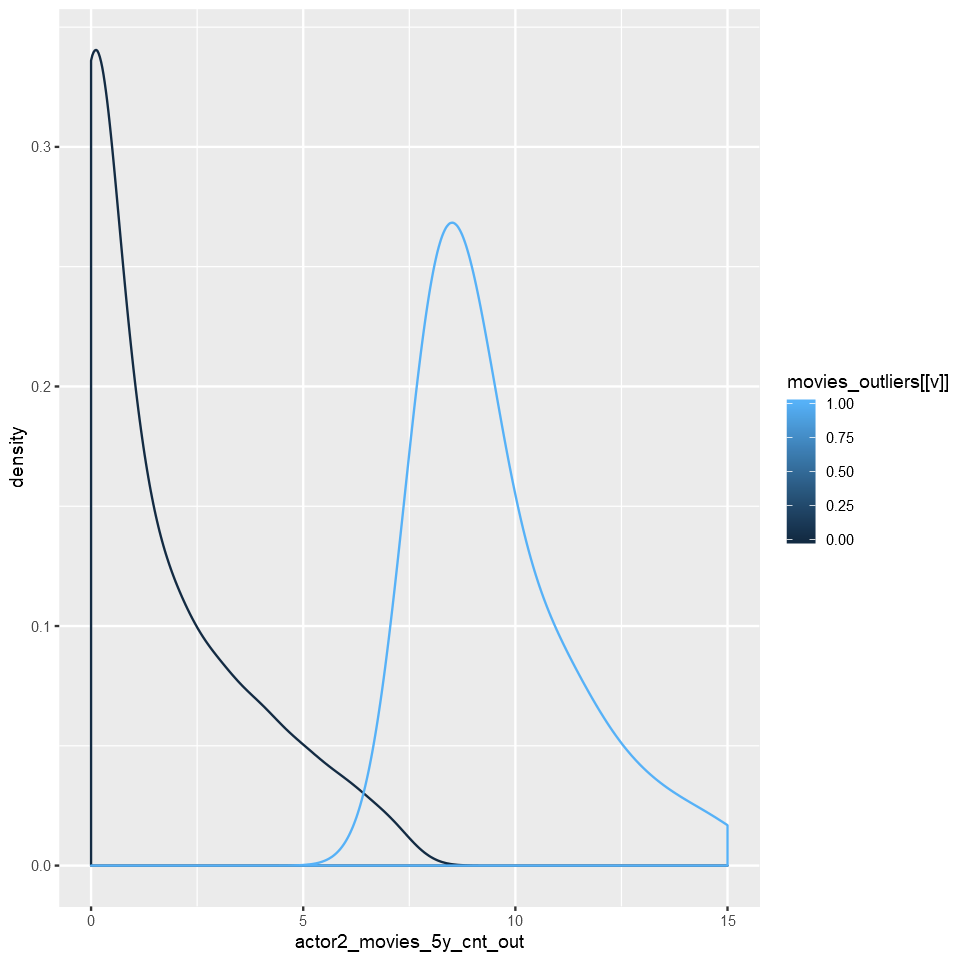

Warning message:
"Removed 3201 rows containing non-finite values (stat_density)."


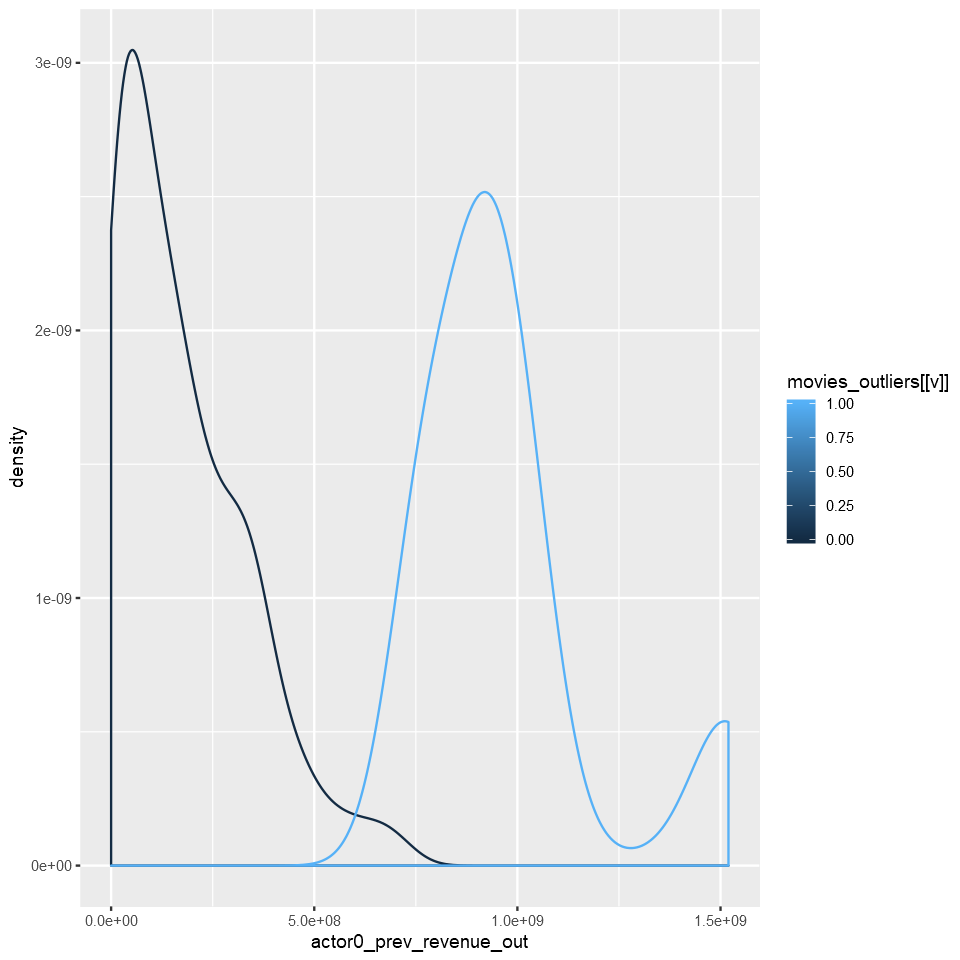

Warning message:
"Removed 3423 rows containing non-finite values (stat_density)."


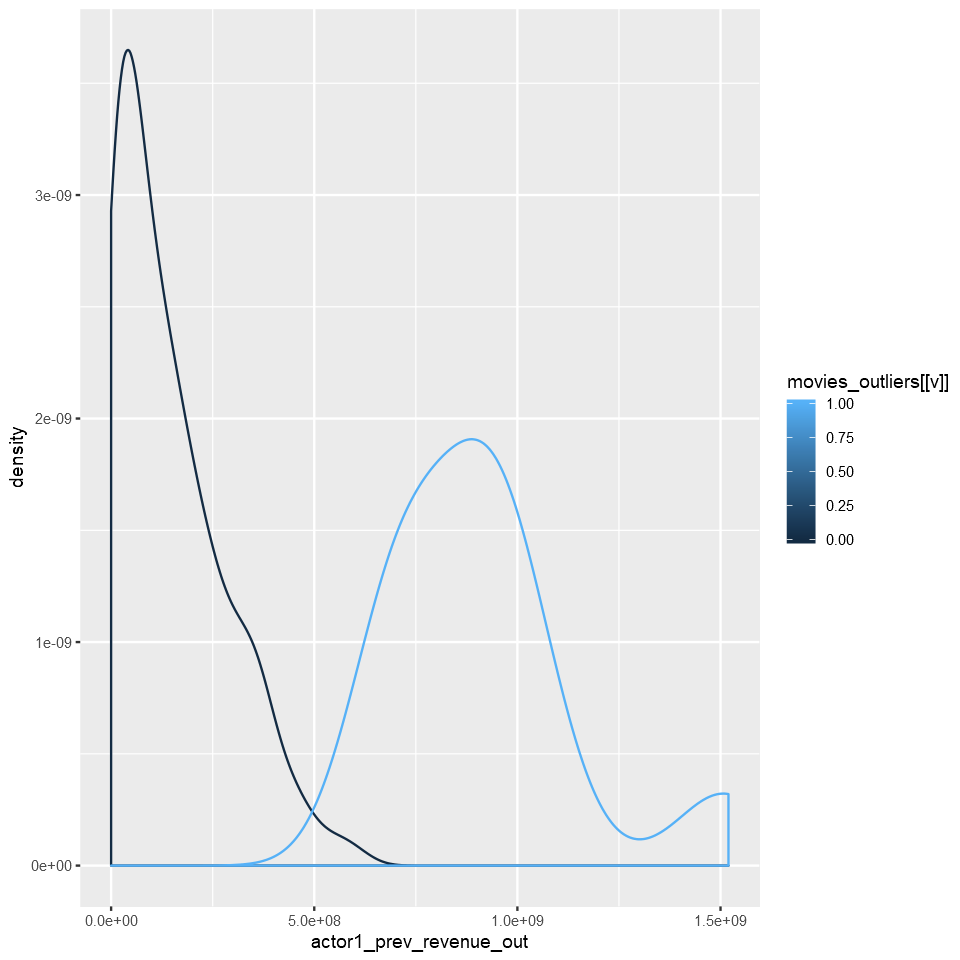

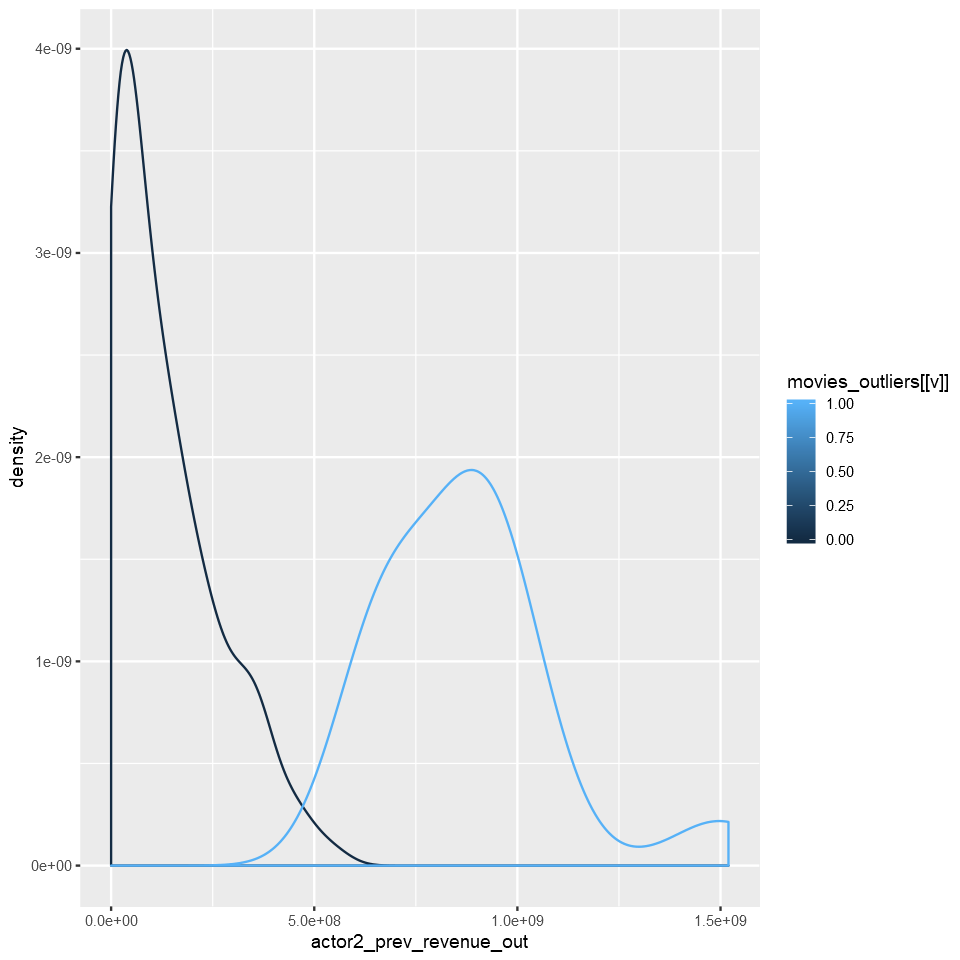

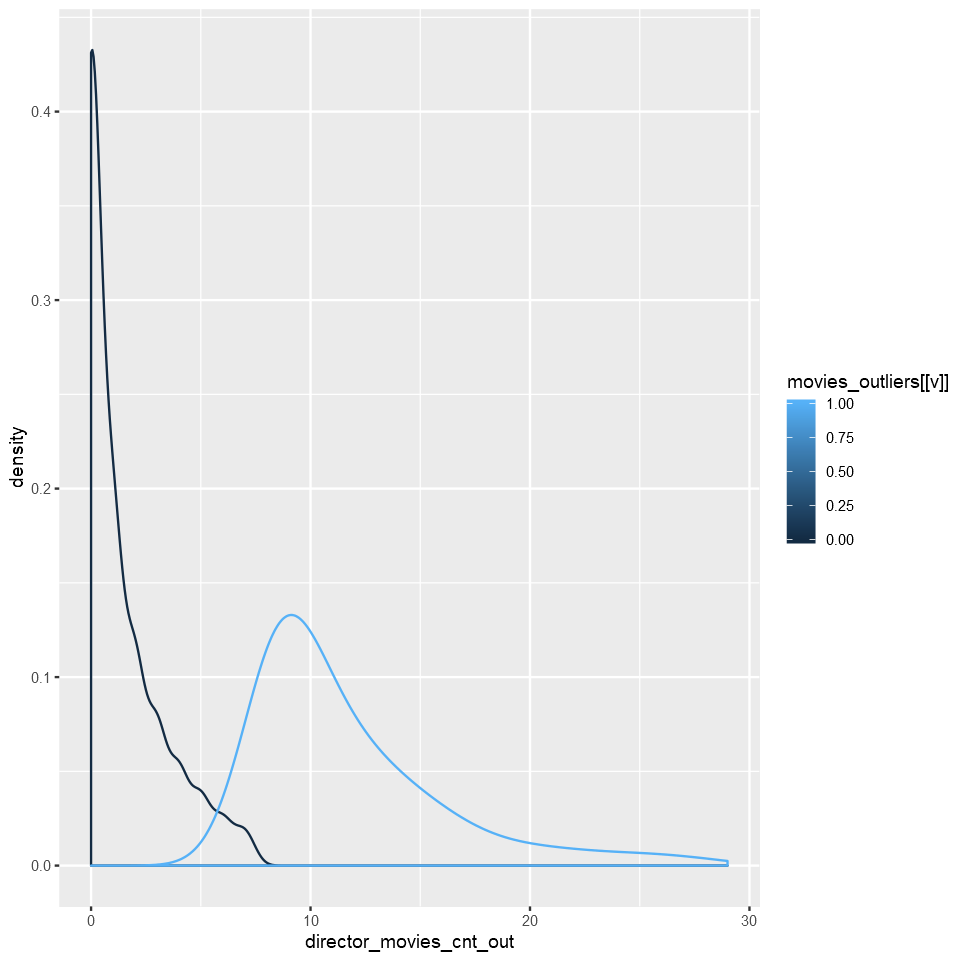

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


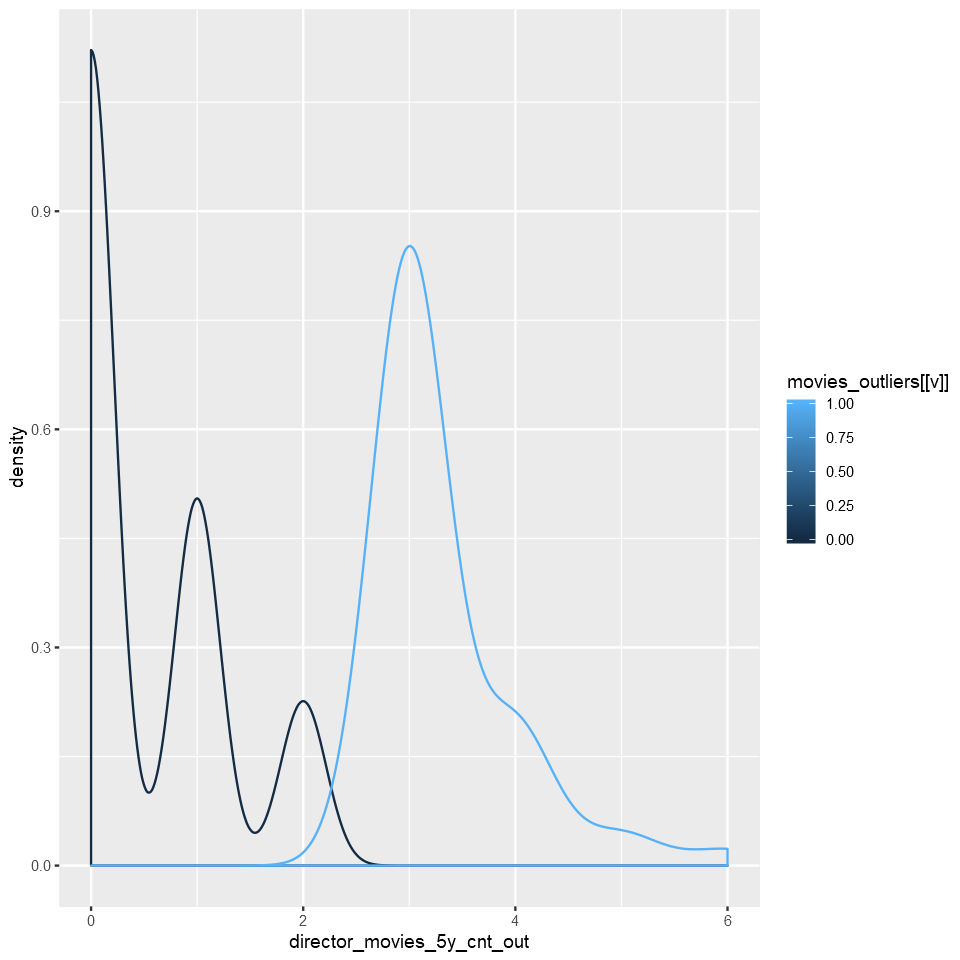

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


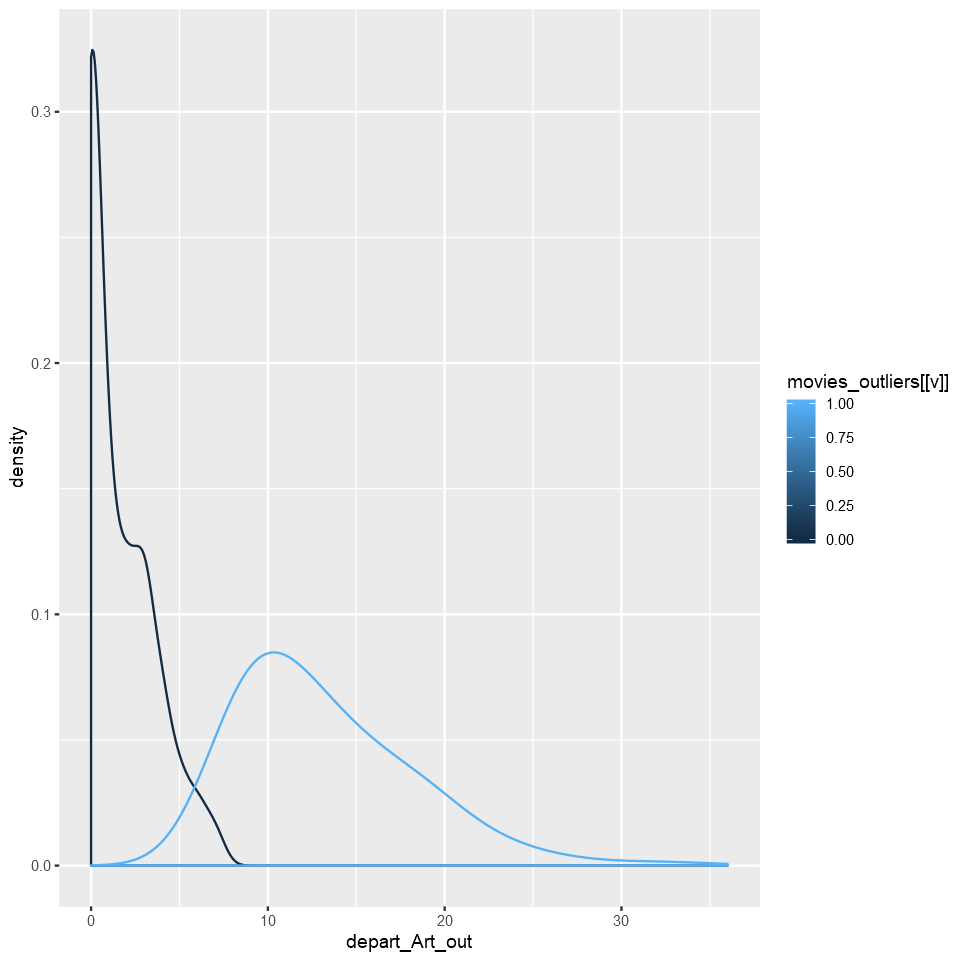

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


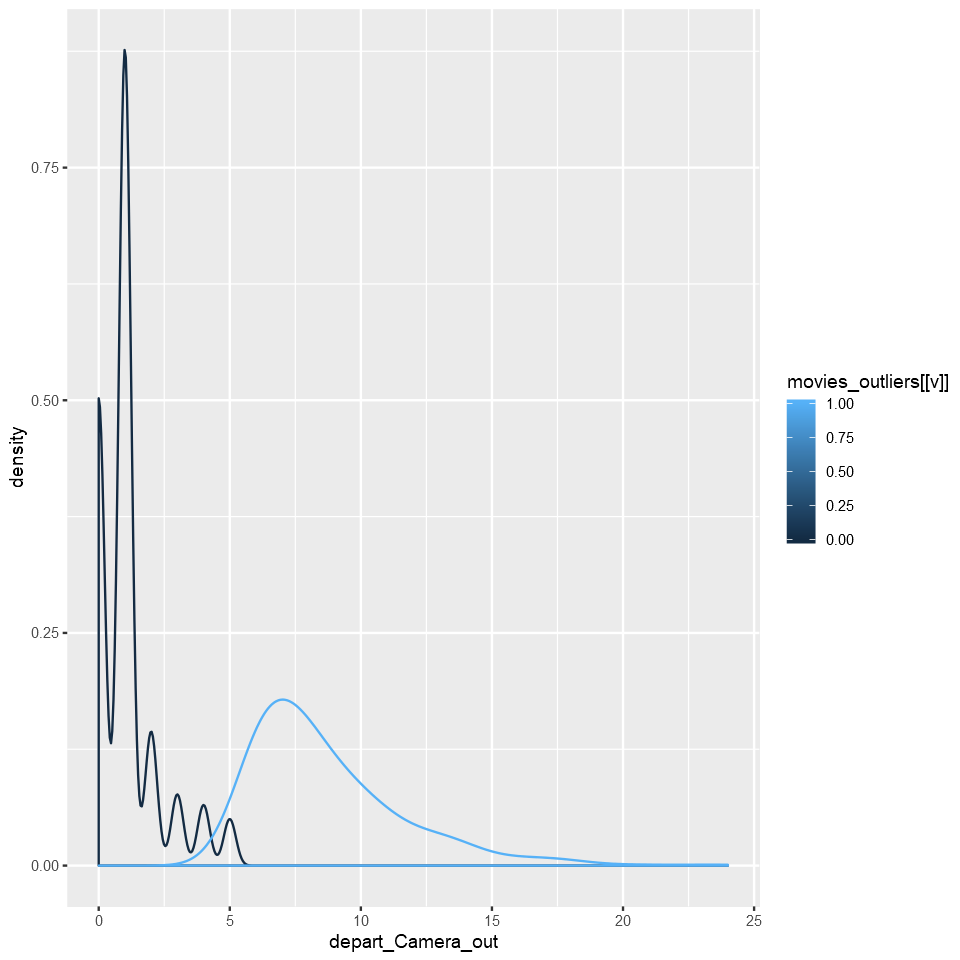

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


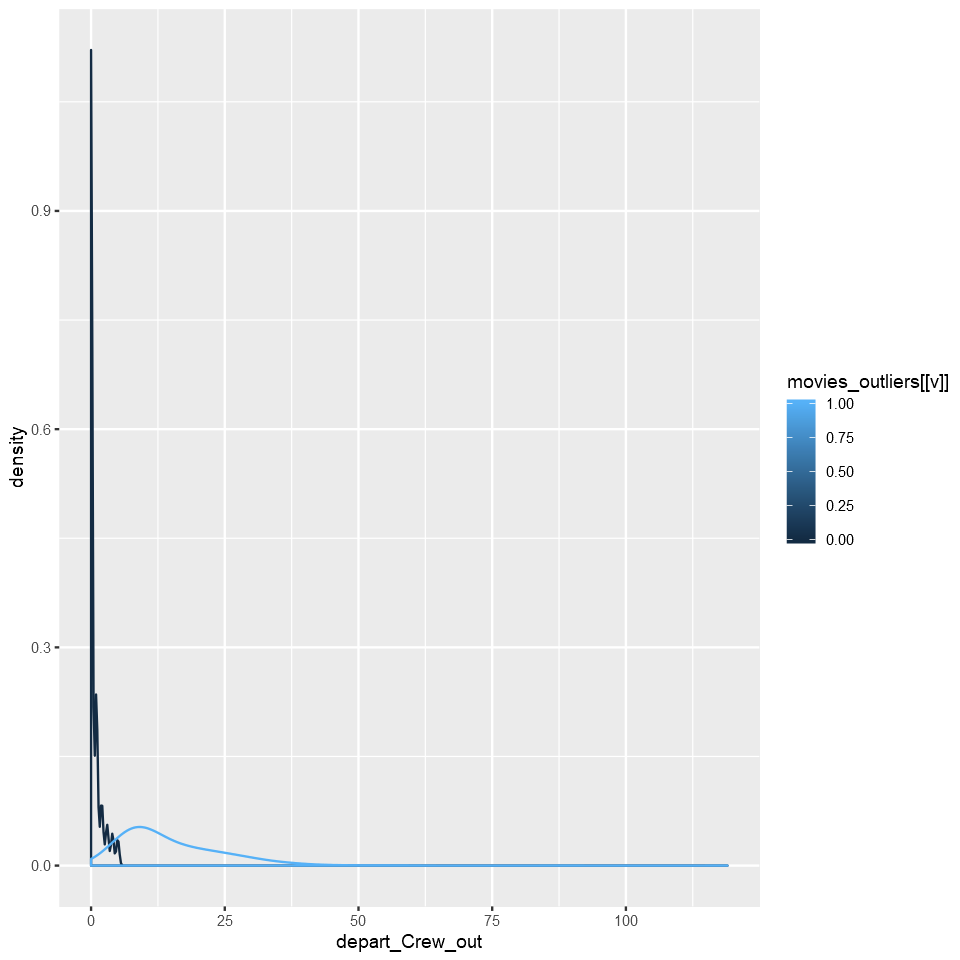

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


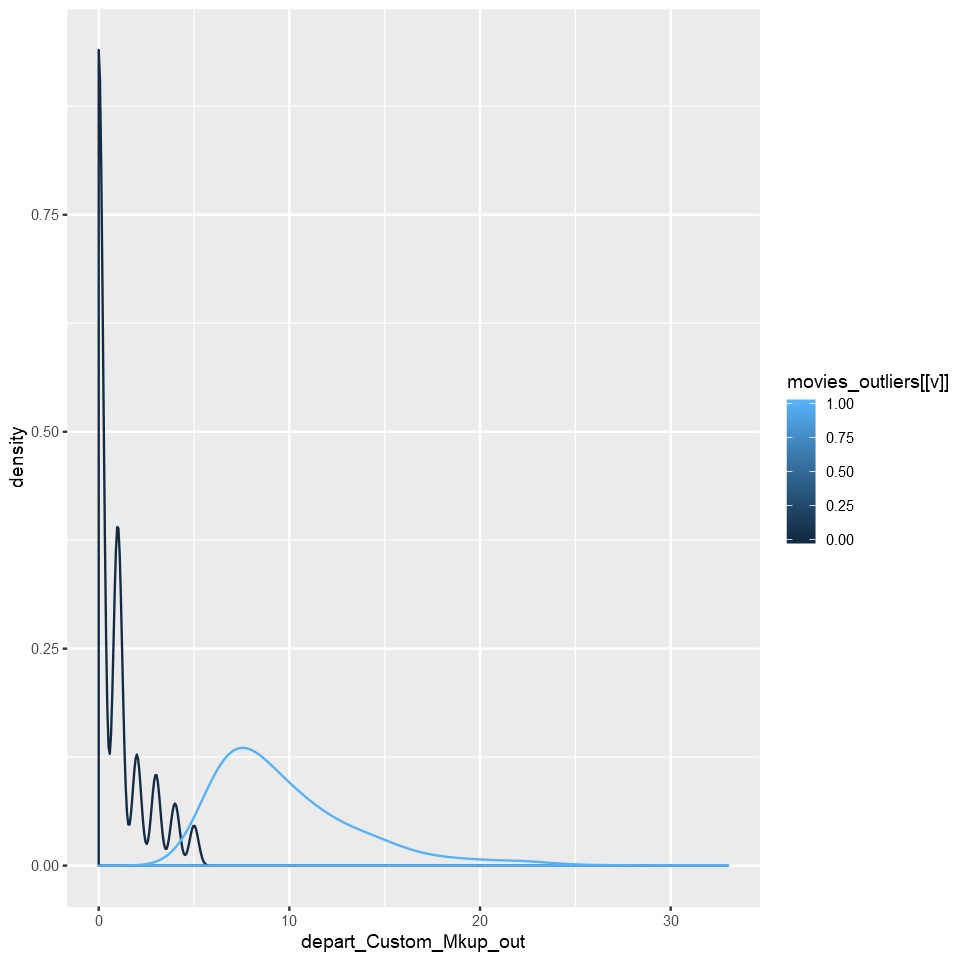

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


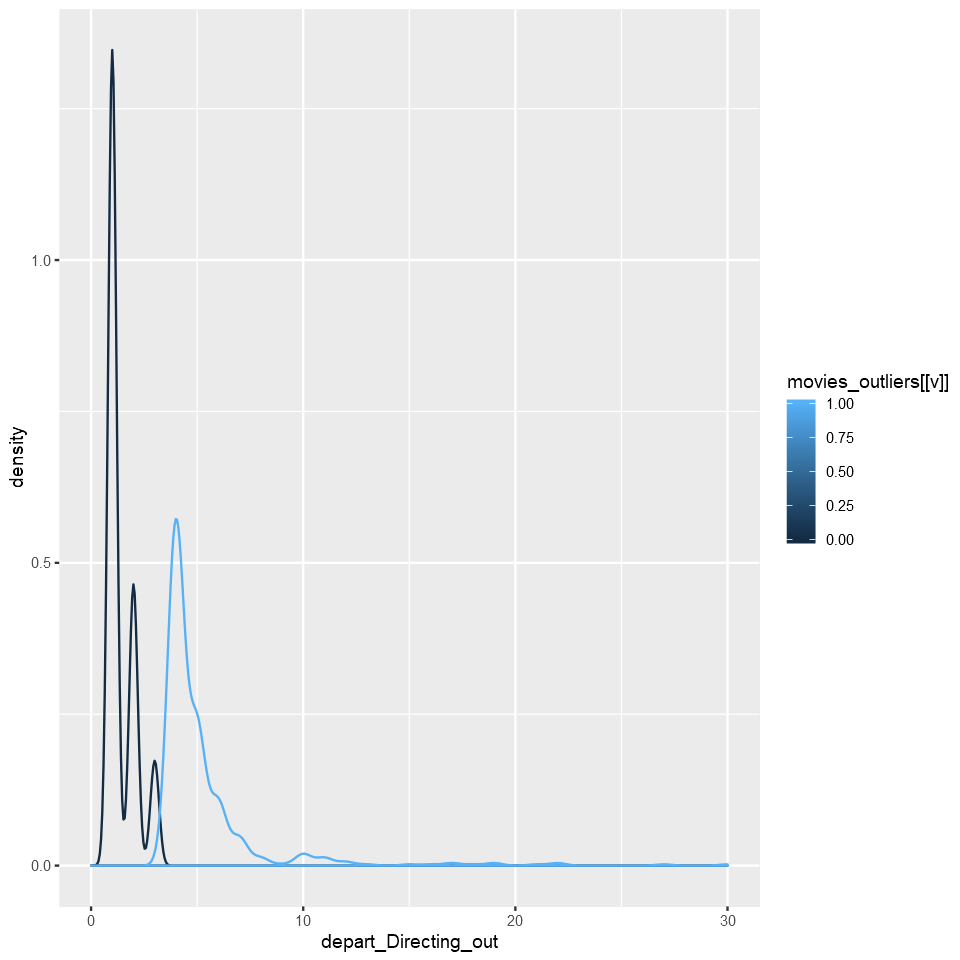

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


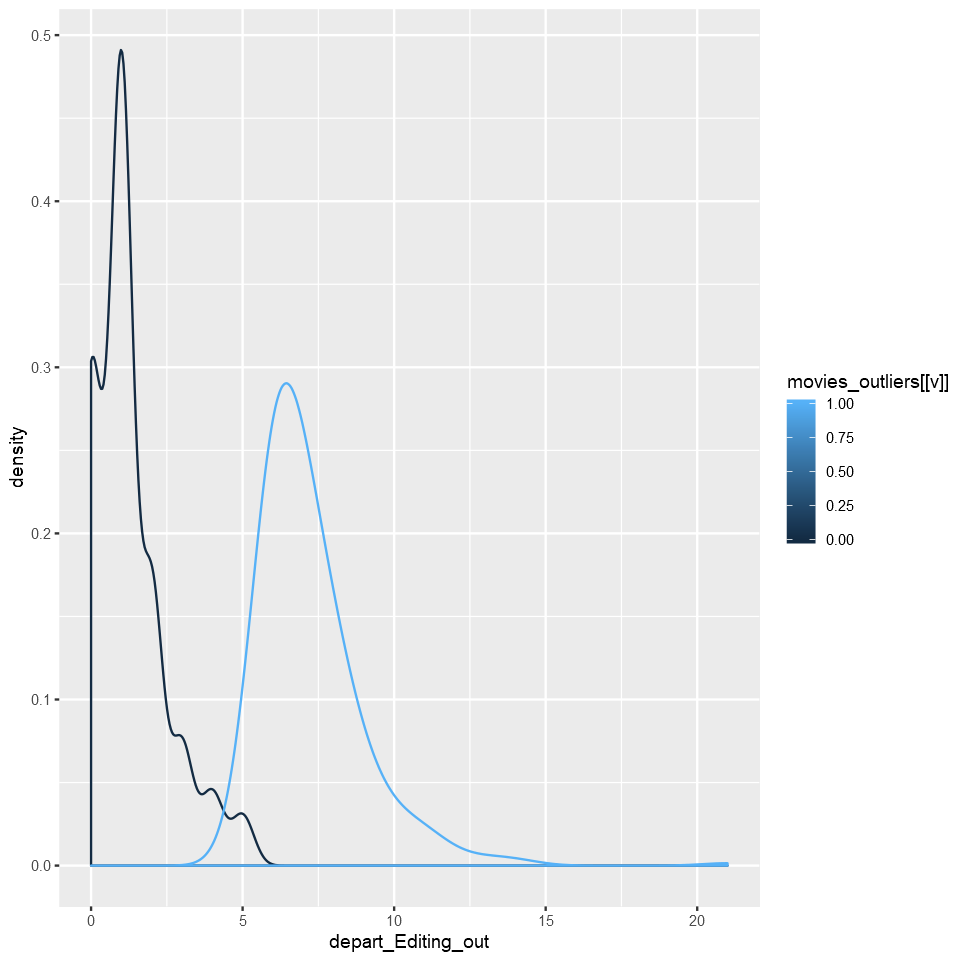

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


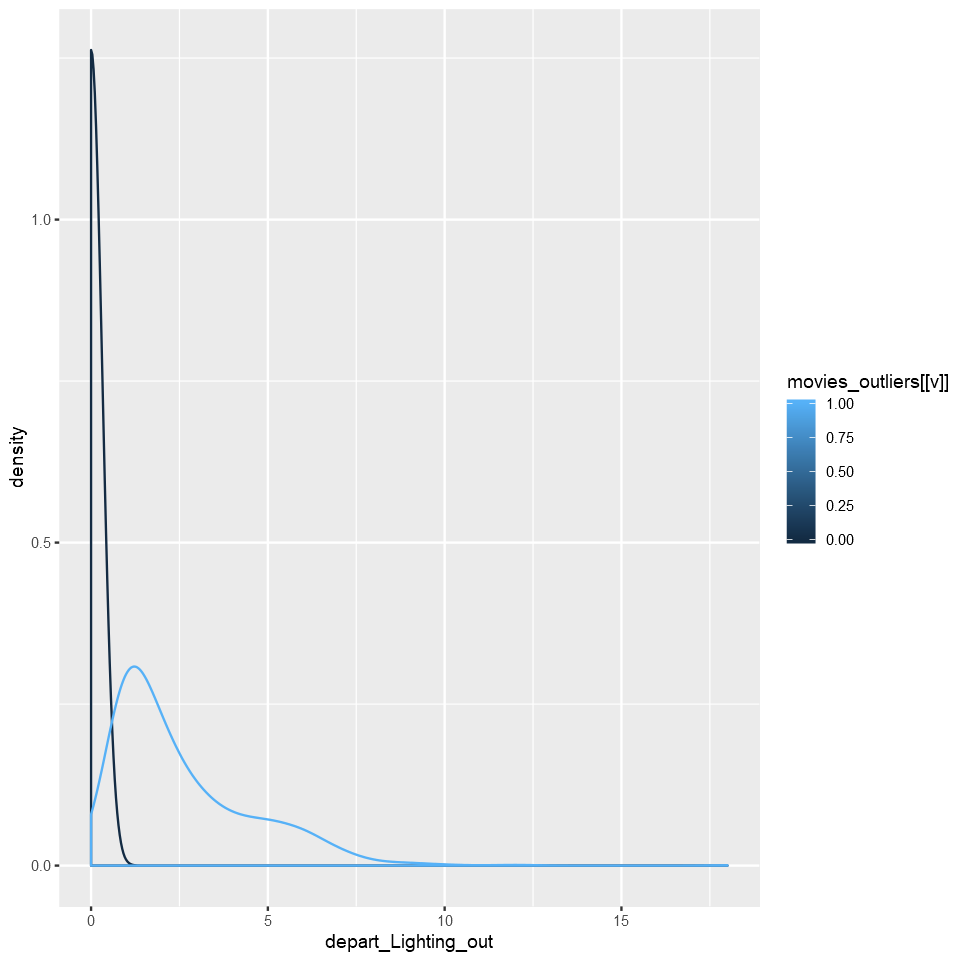

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


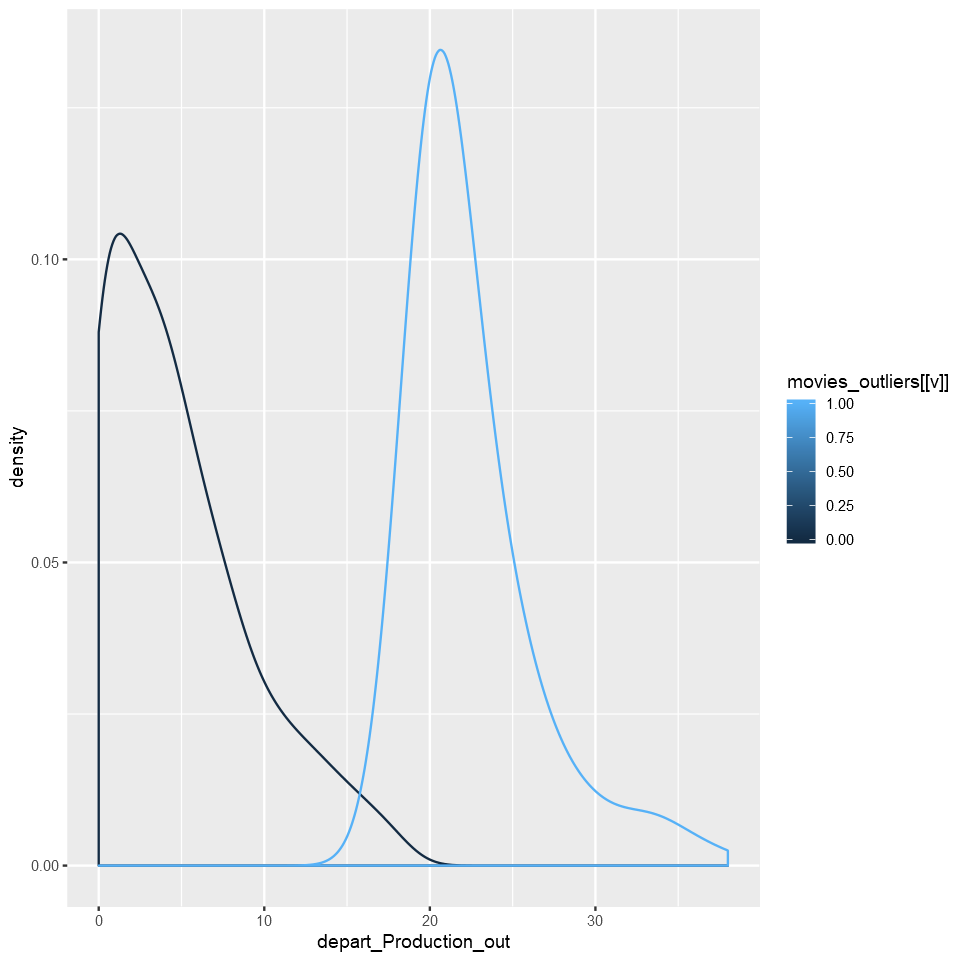

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


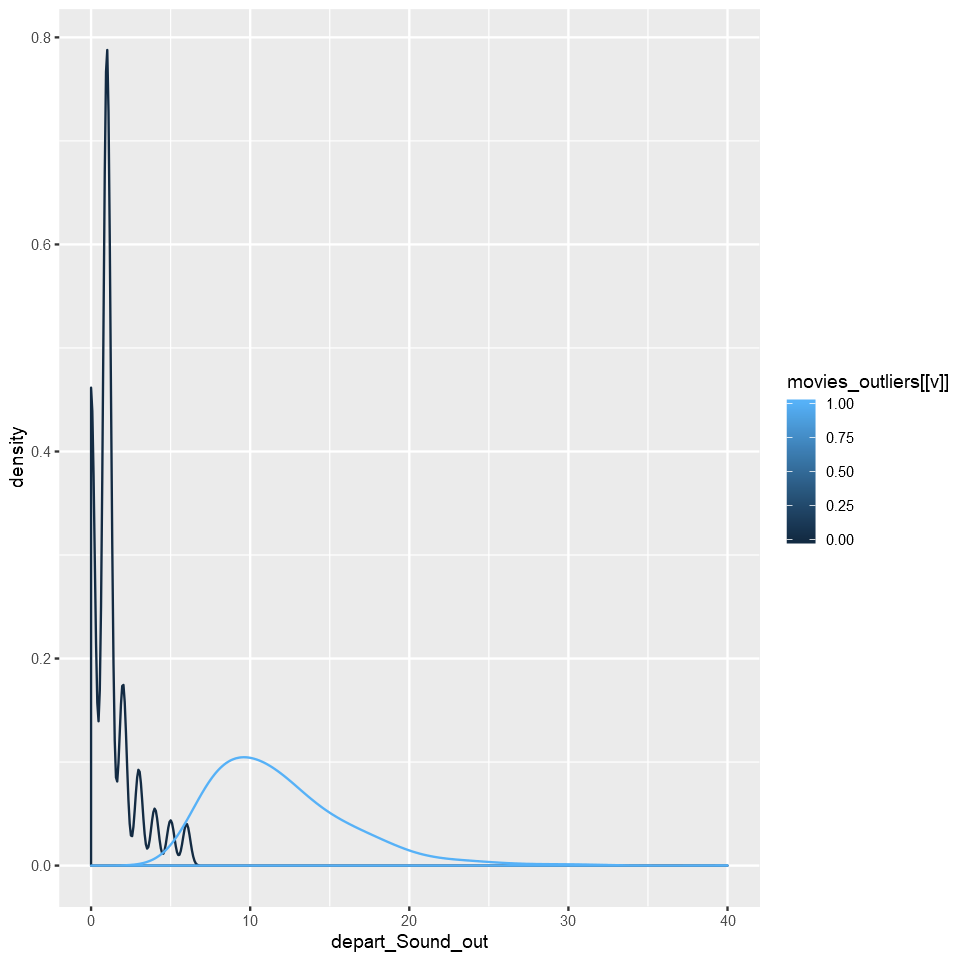

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


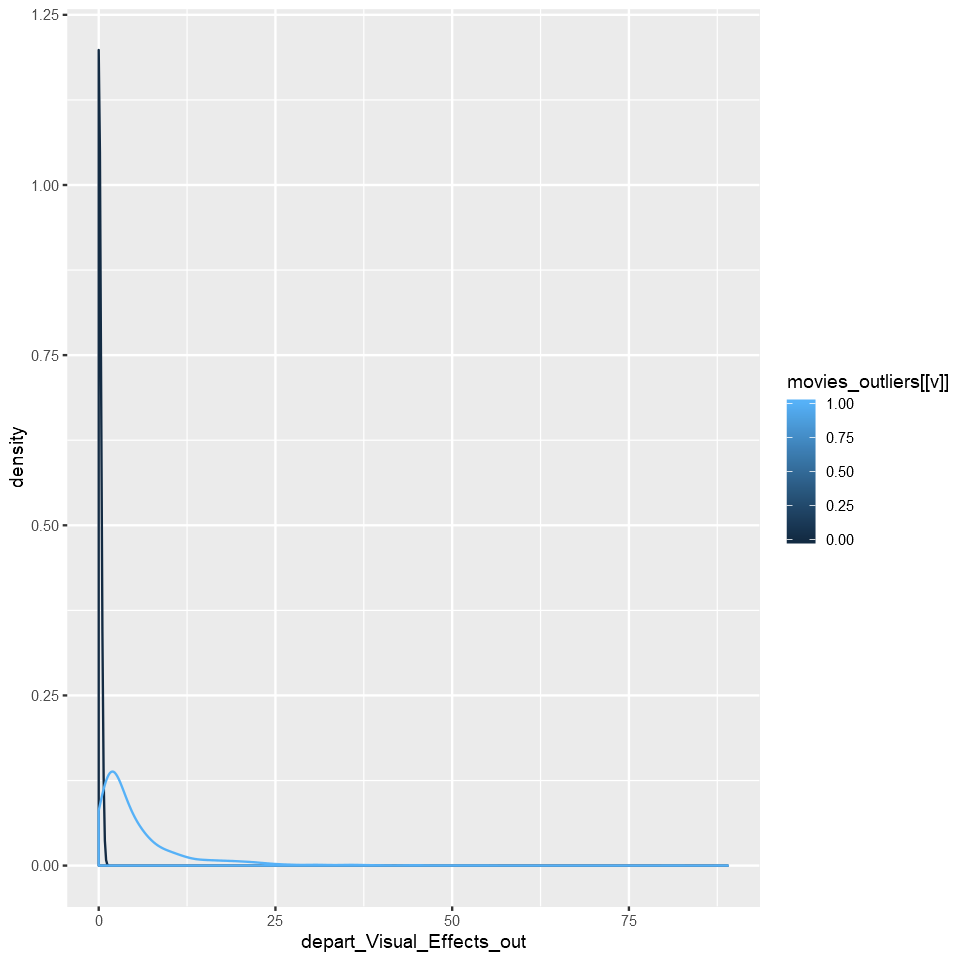

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


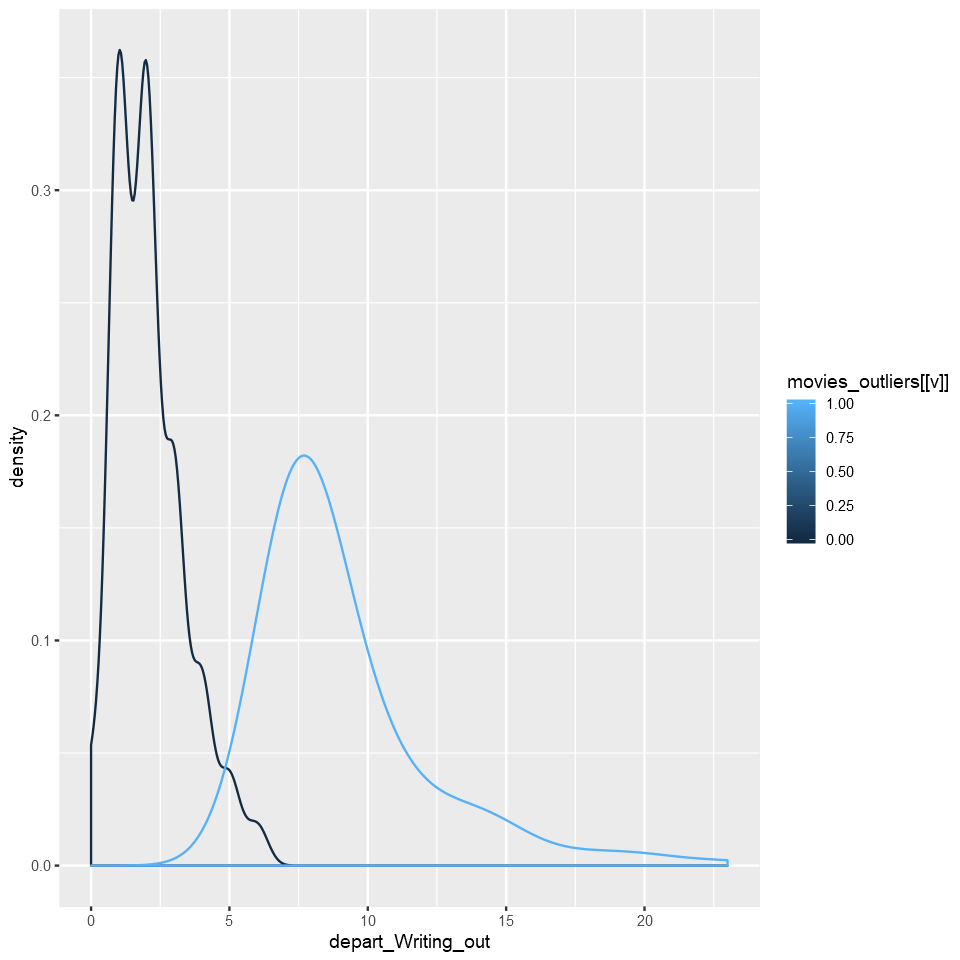

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


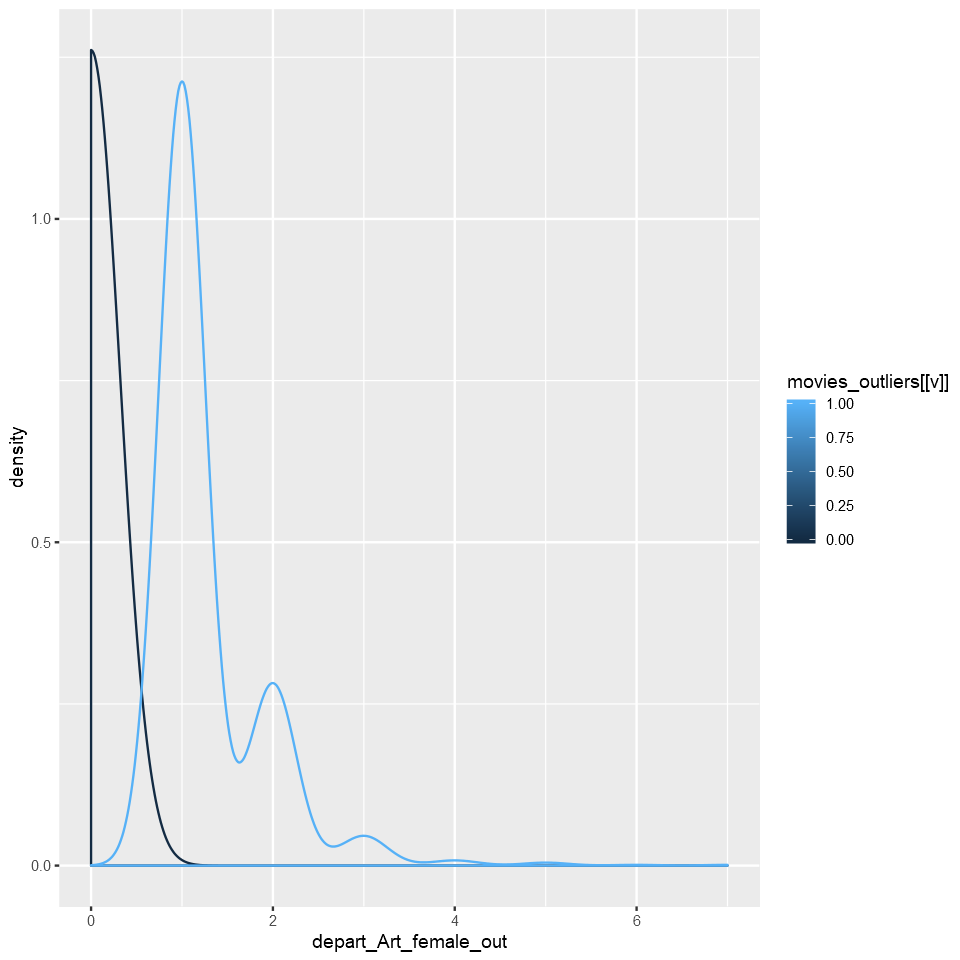

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


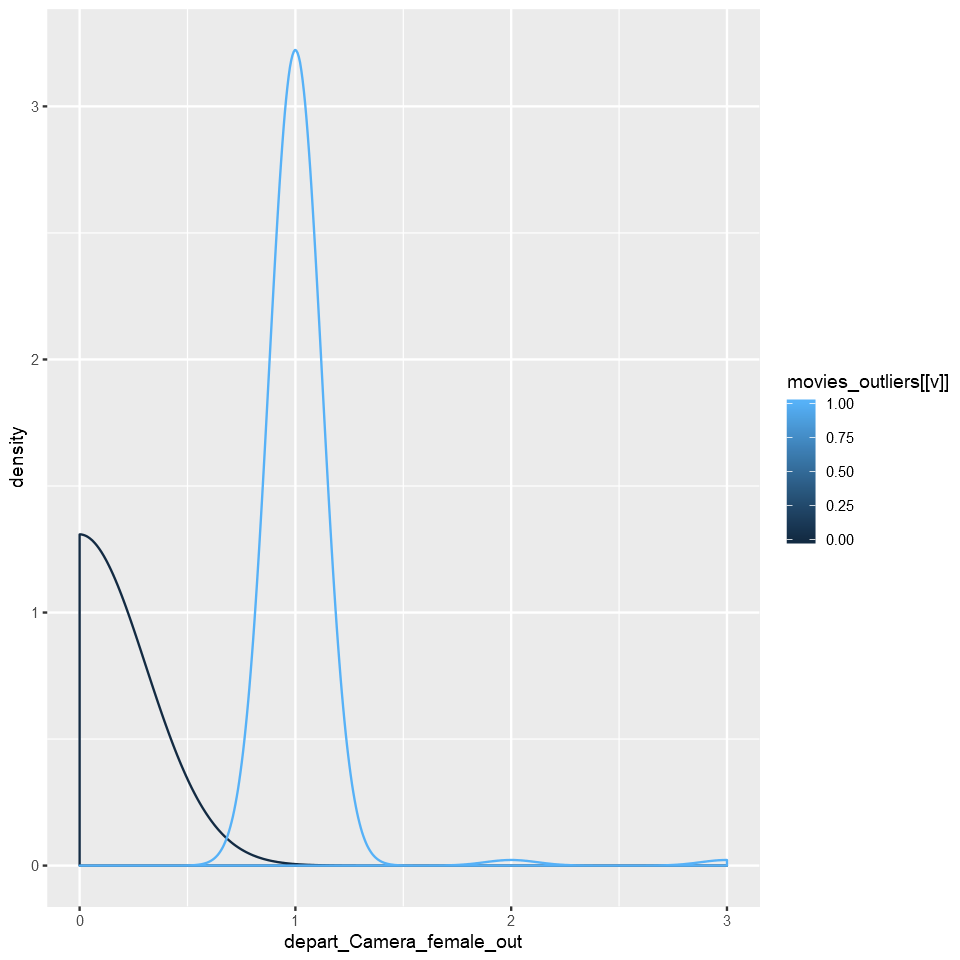

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


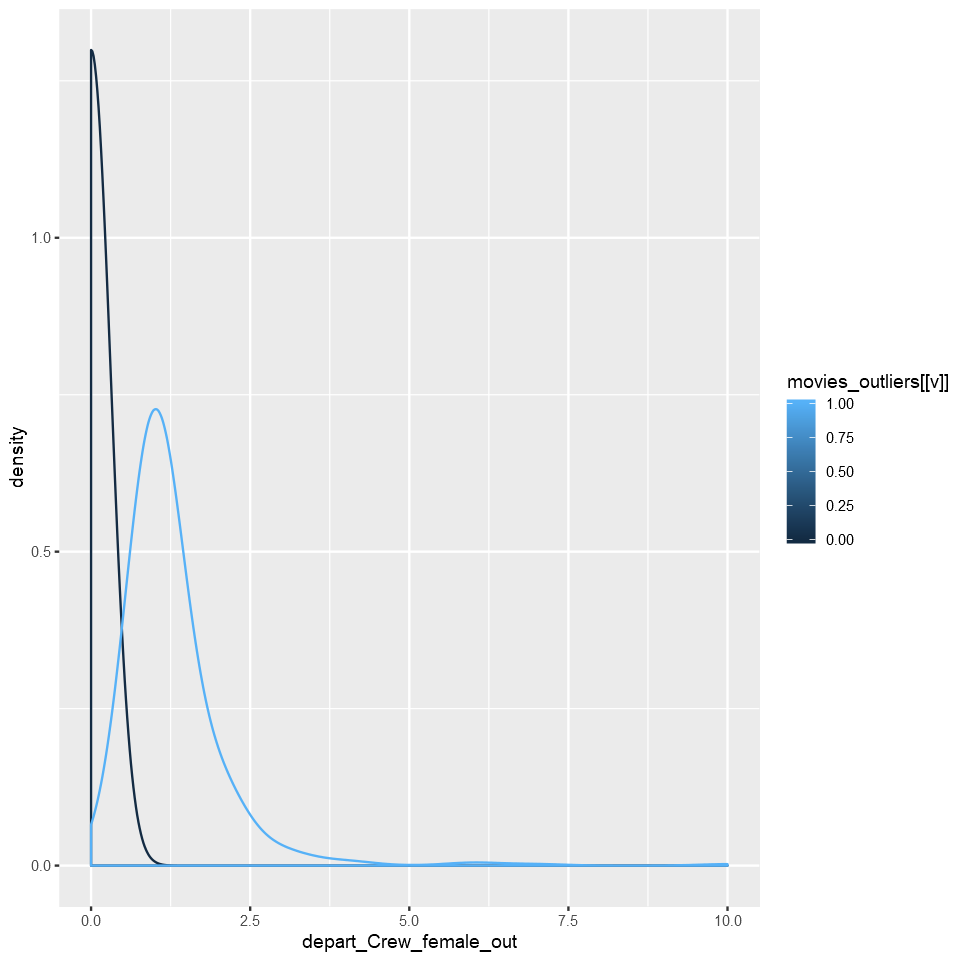

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


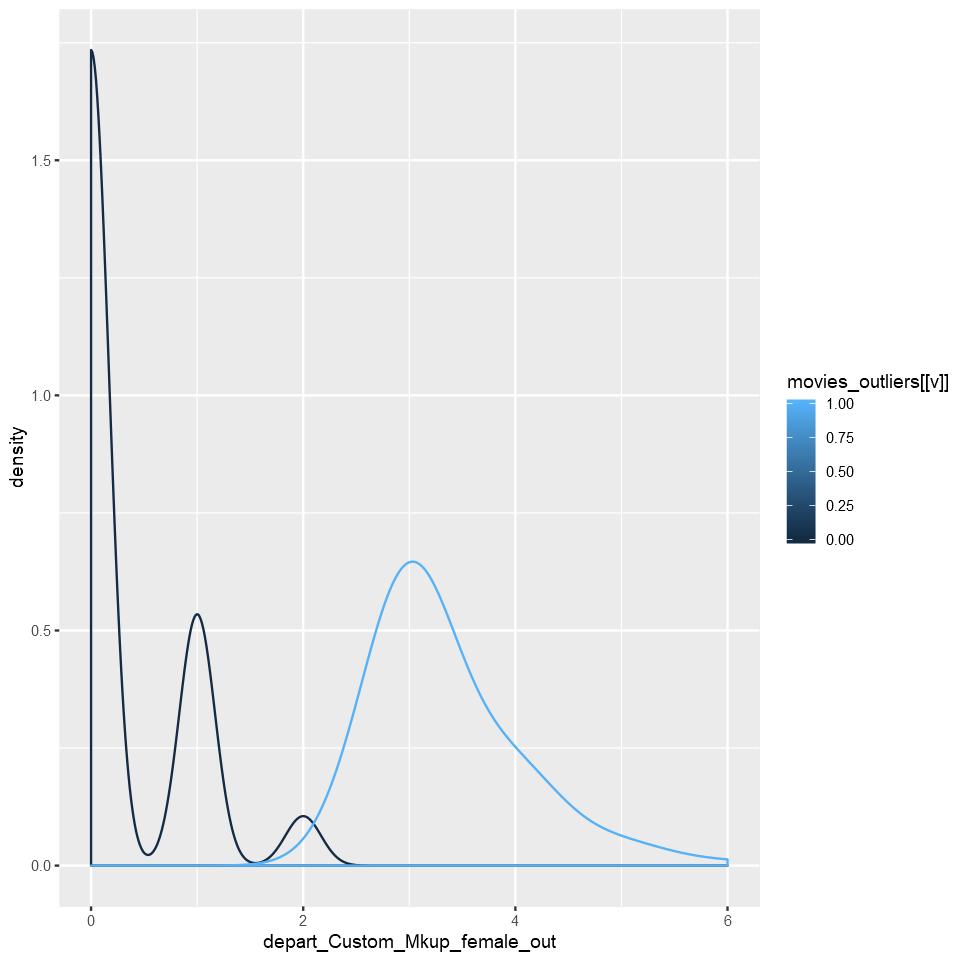

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


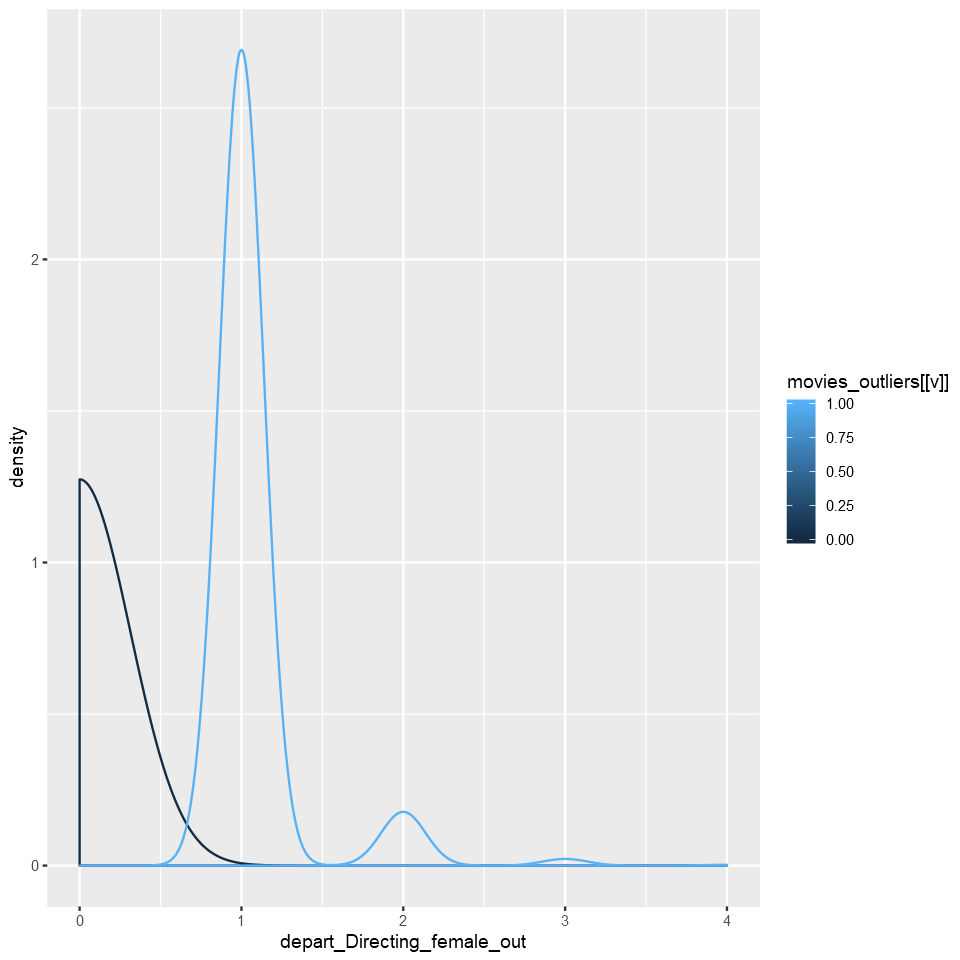

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


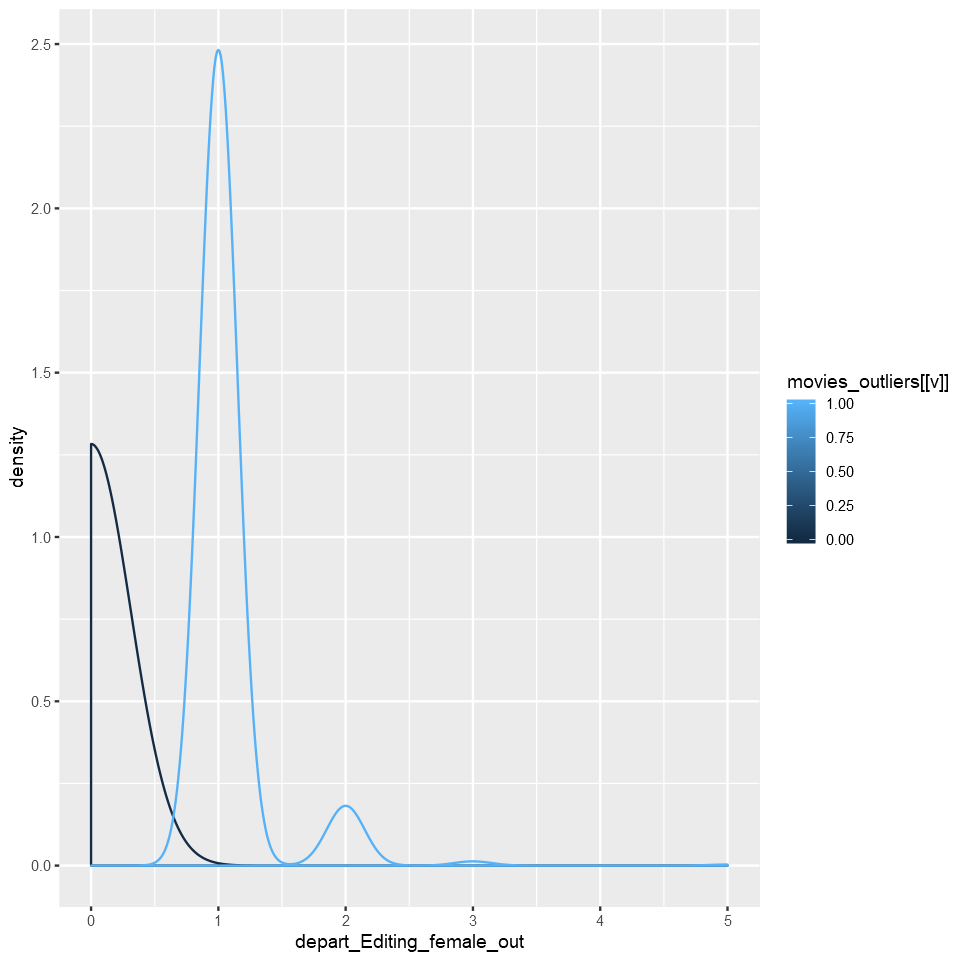

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


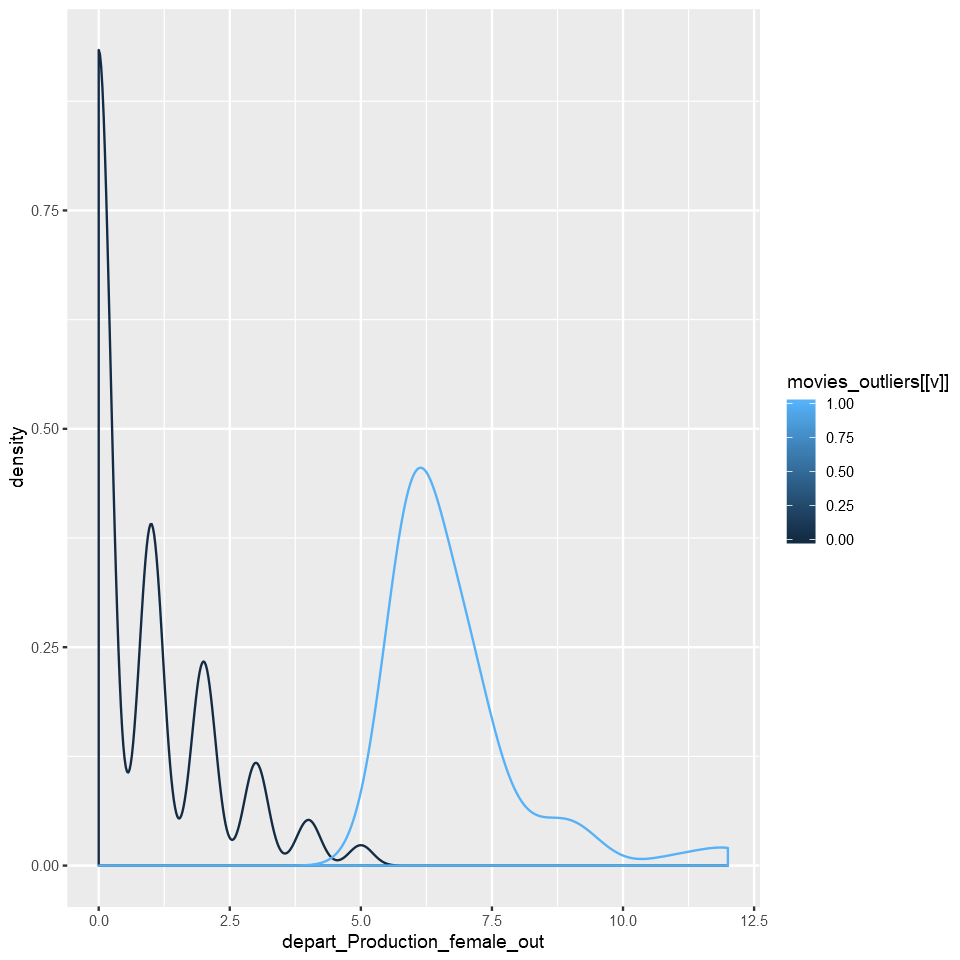

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


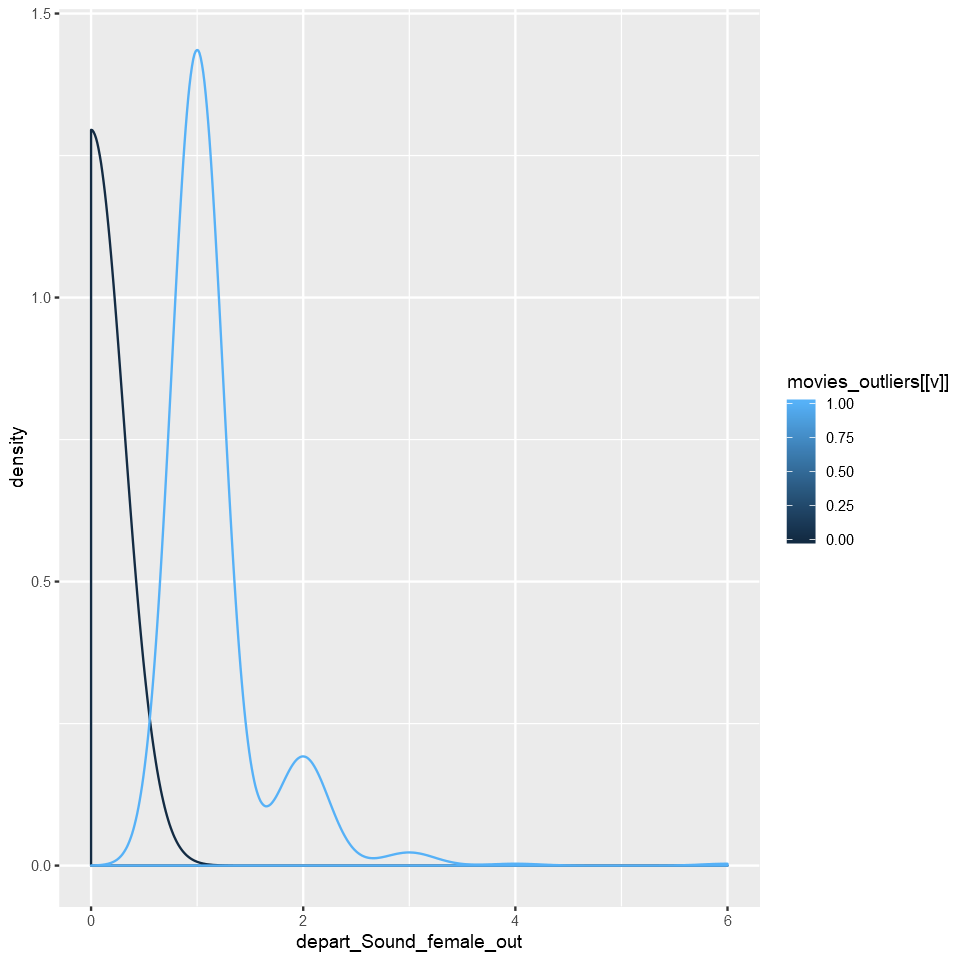

Warning message:
"Removed 34 rows containing non-finite values (stat_density)."


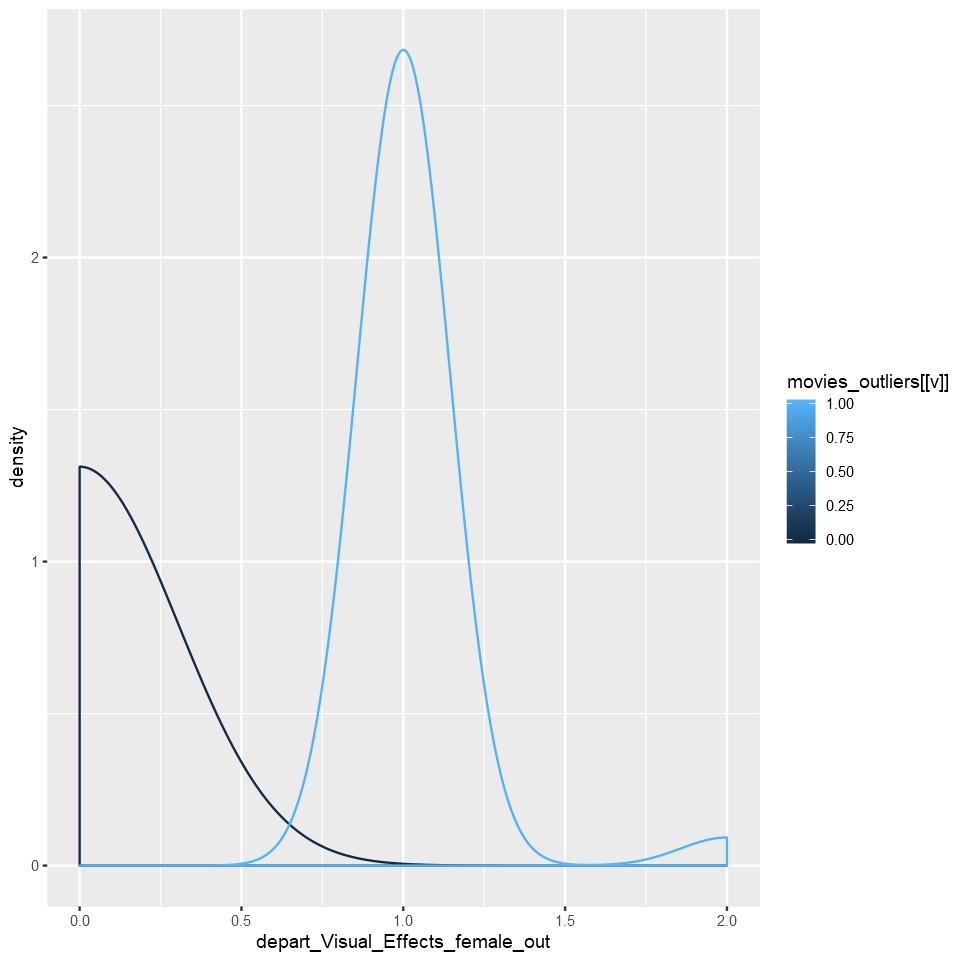

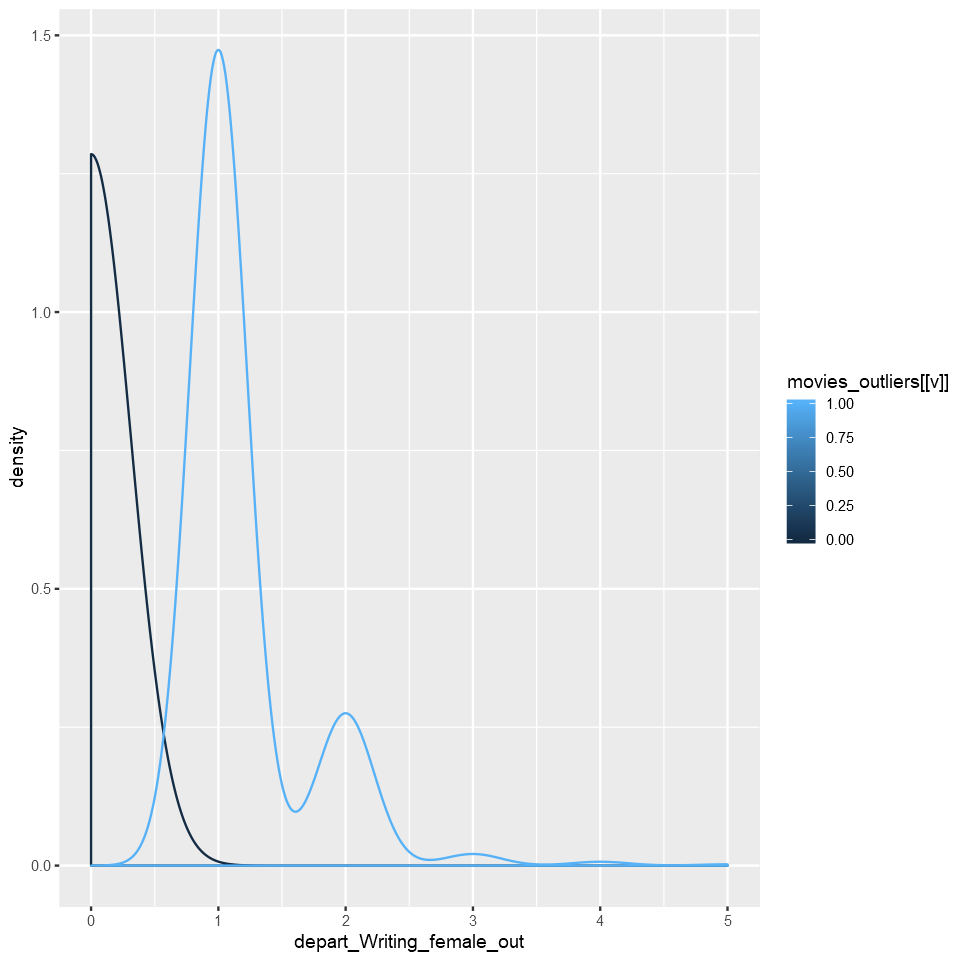

In [17]:

for (v in movies_continuous){
    print(ggplot (movies_ff,aes(x=movies_ff[[v]], group = movies_outliers[[v]],
                                color = movies_outliers[[v]])) + 
          geom_density(adjust=2) +
          xlab(paste(v,'out',sep='_')))
    options(repr.plot.width = 8, repr.plot.height = 8)
}

In [55]:
movies_continuous <- setdiff(movies_continuous,"movie_id")

In [37]:

for (v in movies_continuous){
    newdf <- left_join(movies_ff[,c("movie_id",v)], movies_outliers[,c("movie_id",paste0(v,"_out"))])
    print(ggplot (newdf,aes(x=v, group = newdf[[paste0(v,"_out")]],
                                color = newdf[[paste0(v,"_out")]])) + 
          geom_density(adjust=2) +
          xlab(paste(v,'out',sep='_')))
    options(repr.plot.width = 8, repr.plot.height = 8)

}

ERROR: Error in `[.data.frame`(movies_outliers, , c("movie_id", paste0(v, "_out"))): undefined columns selected


In [41]:
v = "budget" 
newdf <- left_join(movies_ff[,c("movie_id",v)], movies_outliers[,c("movie_id",paste0(v,"_out"))])
head(newdf)

Joining, by = "movie_id"


,movie_id,budget,budget_out
,<int>,<int>,<dbl>
1,1,14000000,0
2,2,40000000,0
3,3,3300000,0
4,4,1200000,0
5,5,0,0
6,6,8000000,0


[1] "movie_id"                     "runtime"                     
 [3] "budget"                       "popularity"                  
 [5] "revenue"                      "release_year"                
 [7] "release_month"                "release_day"                 
 [9] "seasonality"                  "sw_collection"               
[11] "producers_cnt"                "countries_cnt"               
[13] "keywords_cnt"                 "actor0_movies_cnt"           
[15] "actor0_movies_5y_cnt"         "actor1_movies_cnt"           
[17] "actor1_movies_5y_cnt"         "actor2_movies_cnt"           
[19] "actor2_movies_5y_cnt"         "actor0_prev_revenue"         
[21] "actor1_prev_revenue"          "actor2_prev_revenue"         
[23] "director_movies_cnt"          "director_movies_5y_cnt"      
[25] "depart_Art"                   "depart_Camera"               
[27] "depart_Crew"                  "depart_Custom_Mkup"          
[29] "depart_Directing"             "depart_Editing"              
[31] "depart_Lighting"              "depart_Production"           
[33] "depart_Sound"                 "depart_Visual_Effects"       
[35] "depart_Writing"               "depart_Art_female"           
[37] "depart_Camera_female"         "depart_Crew_female"          
[39] "depart_Custom_Mkup_female"    "depart_Directing_female"     
[41] "depart_Editing_female"        "depart_Production_female"    
[43] "depart_Sound_female"          "depart_Visual_Effects_female"
[45] "depart_Writing_female"

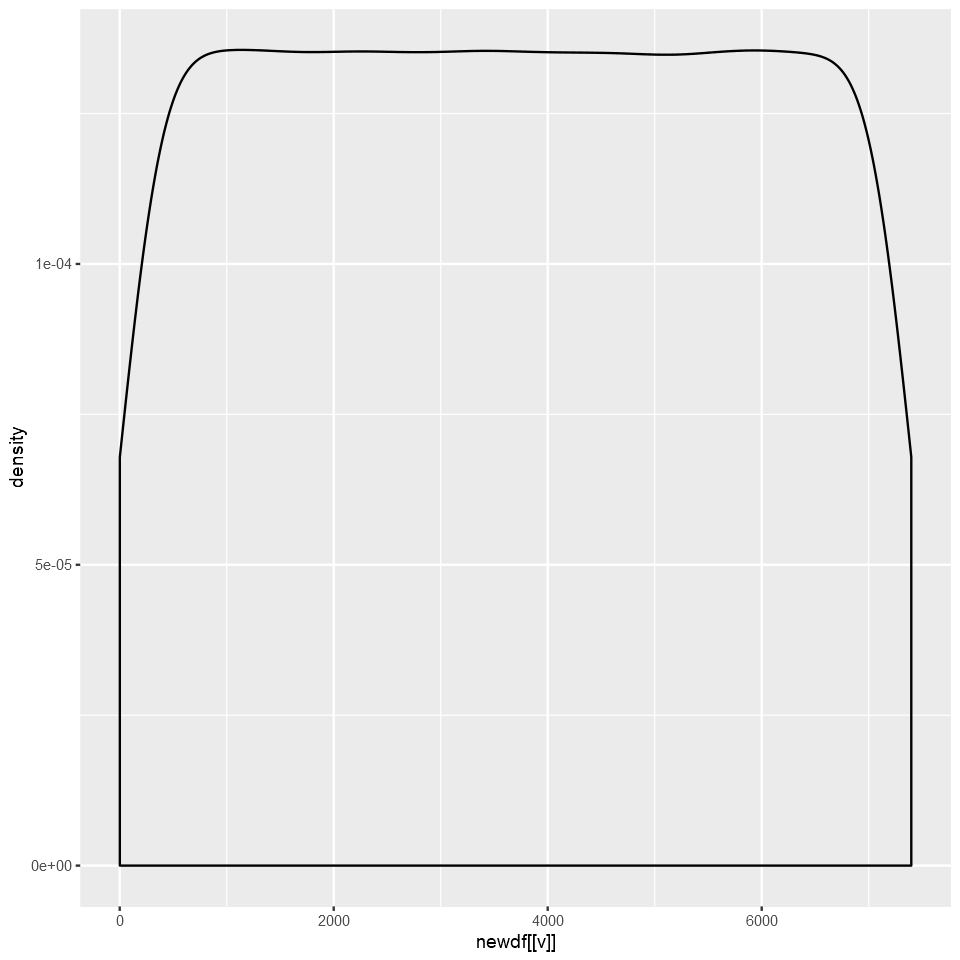

In [54]:
    ggplot (newdf,aes(x=newdf[[v]], group = newdf[[paste0(v,"_out")]],
                                color = newdf[[paste0(v,"_out")]])) + 
          geom_density() 
         # xlab(paste(v,'out',sep='_'))

  #  options(repr.plot.width = 8, repr.plot.height = 8)
movies_continuous

Joining, by = "movie_id"
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"
Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


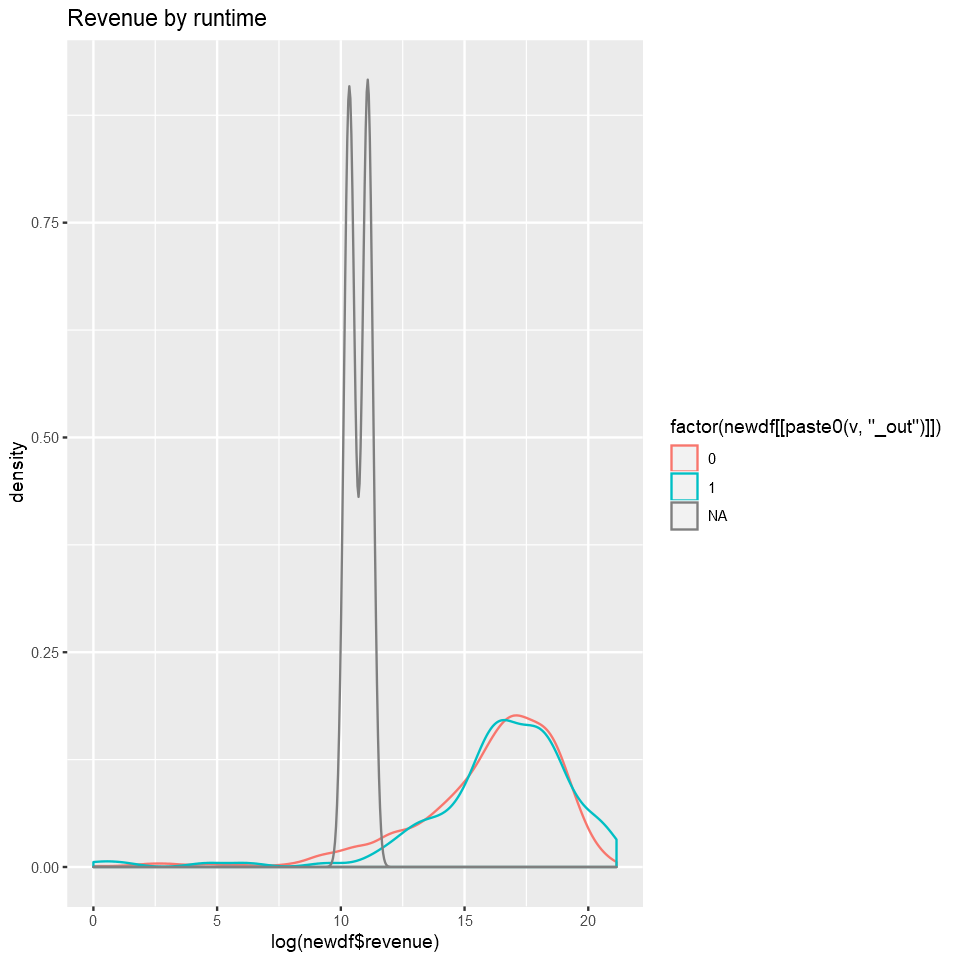

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


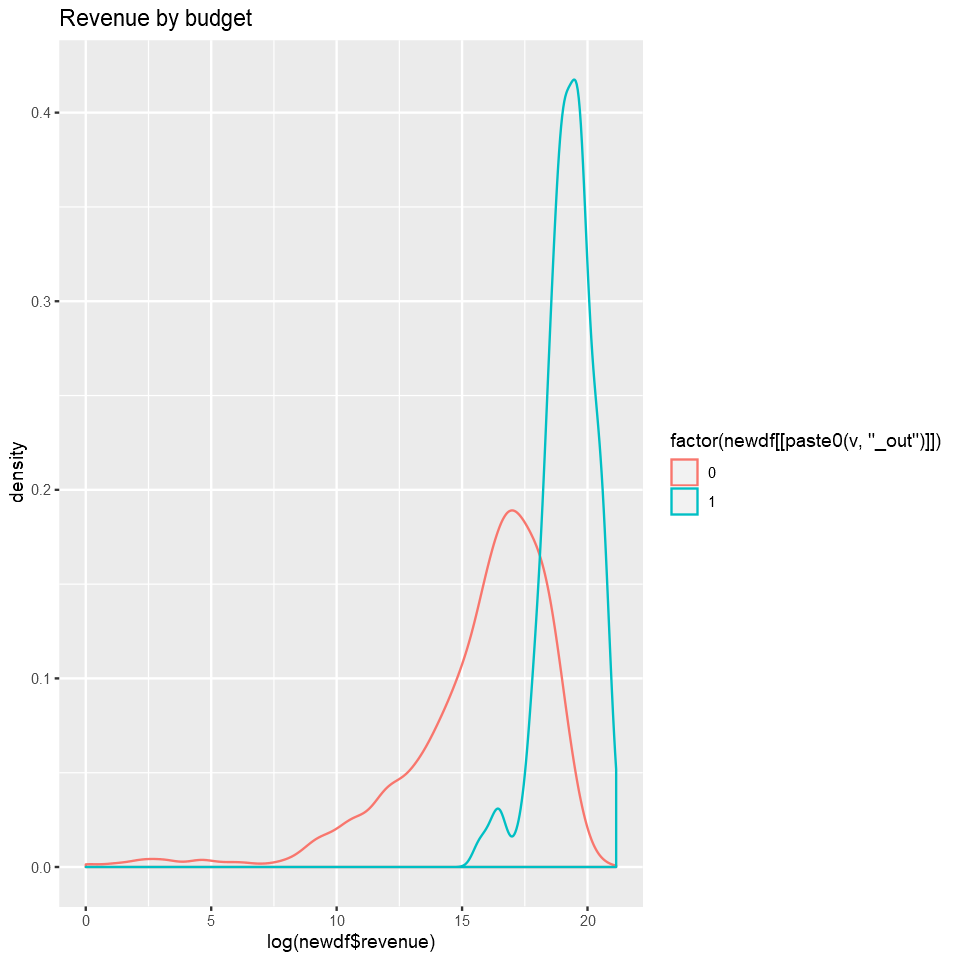

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


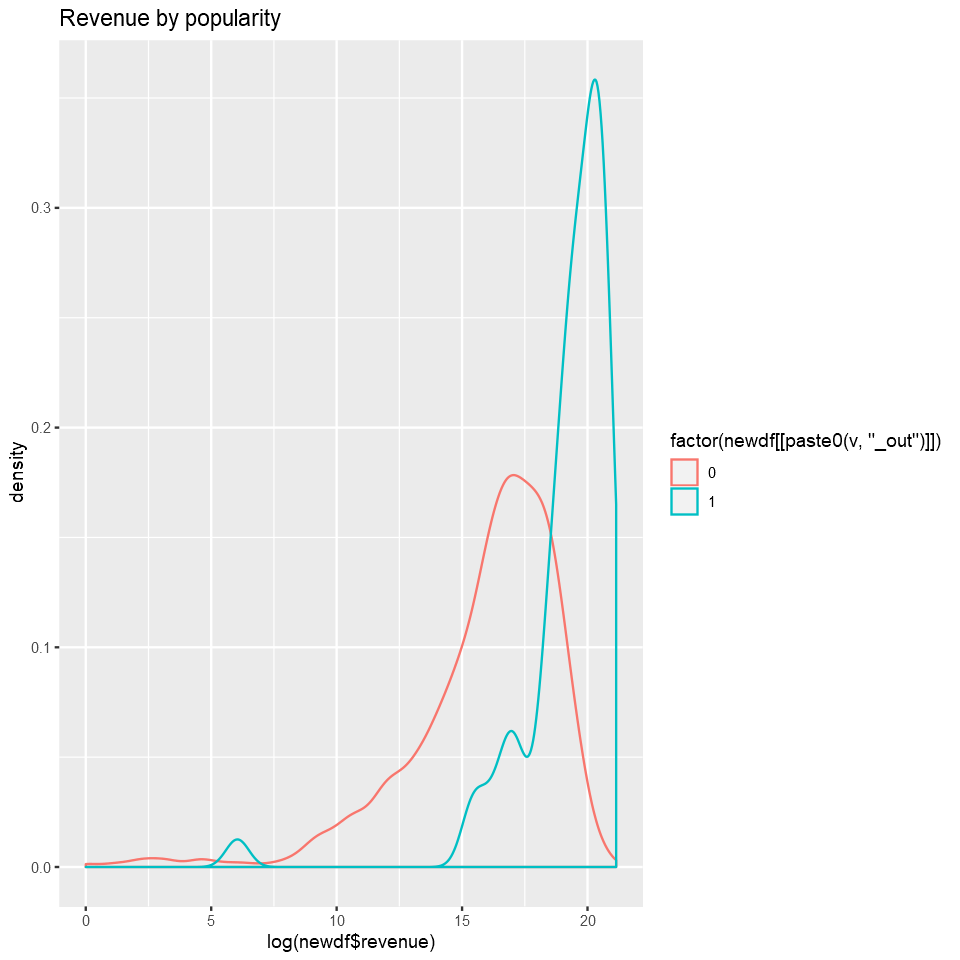

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


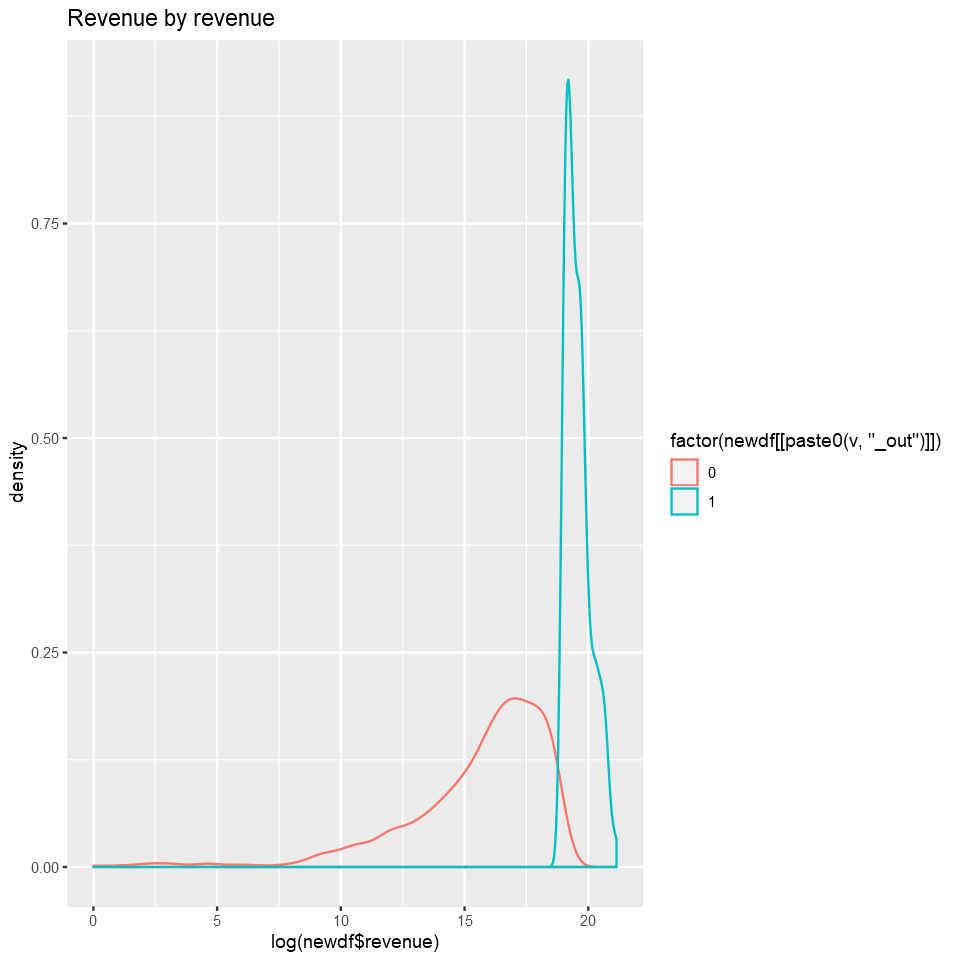

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


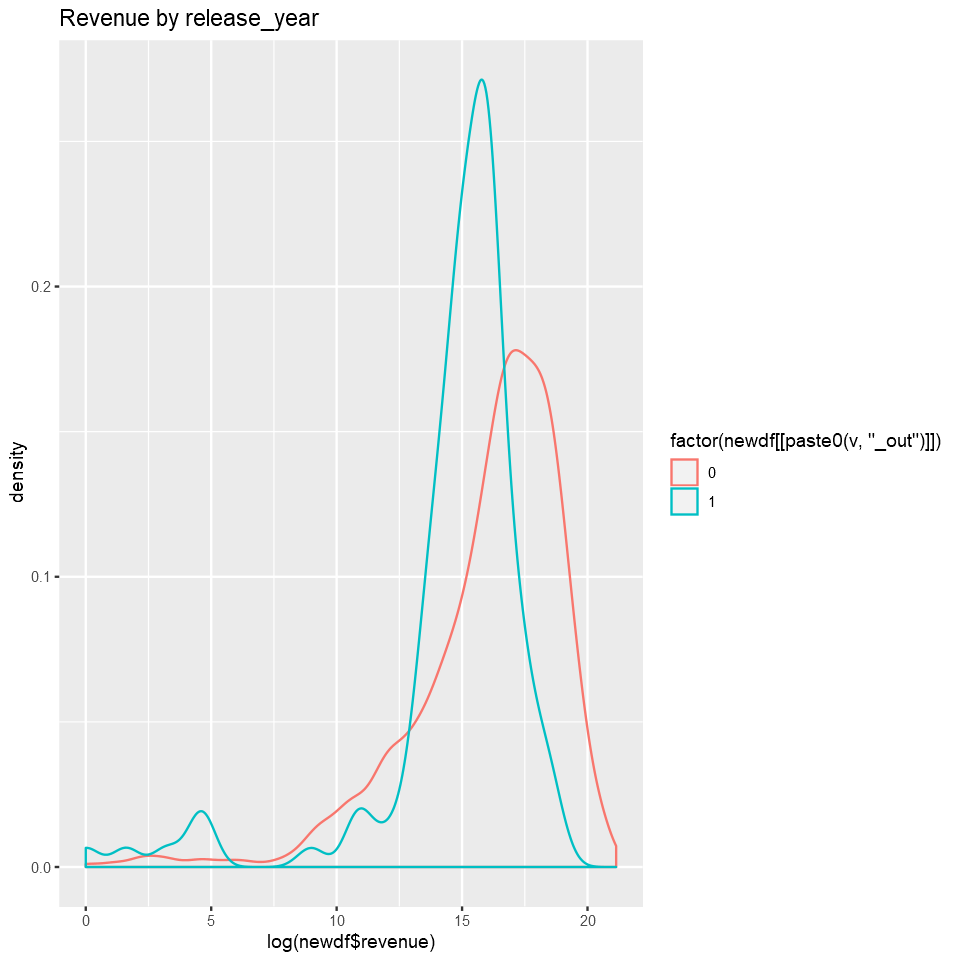

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


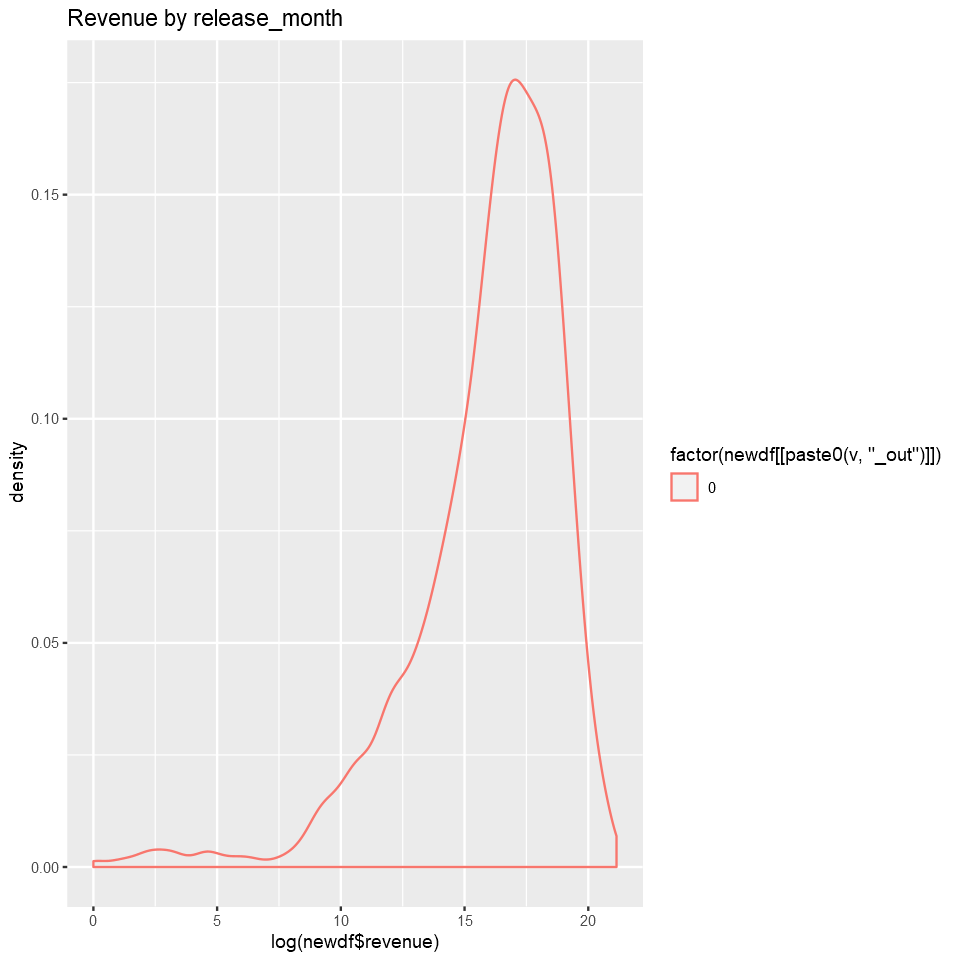

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


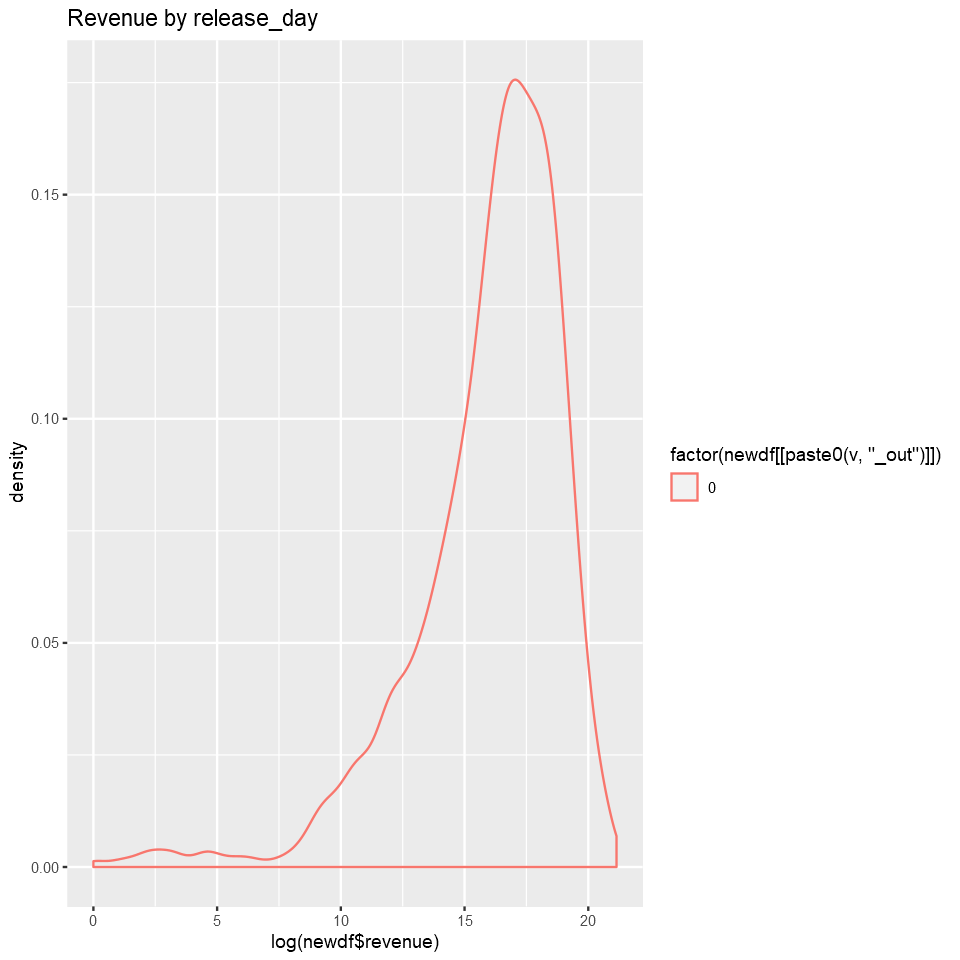

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


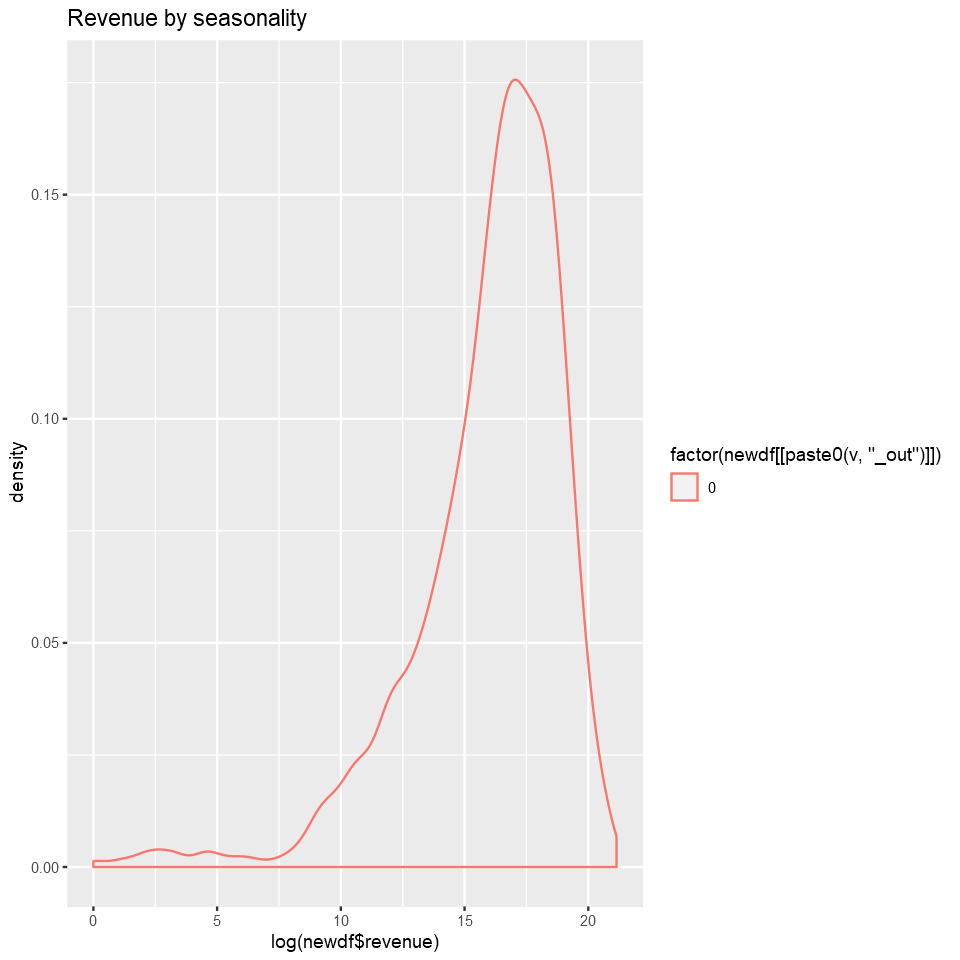

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


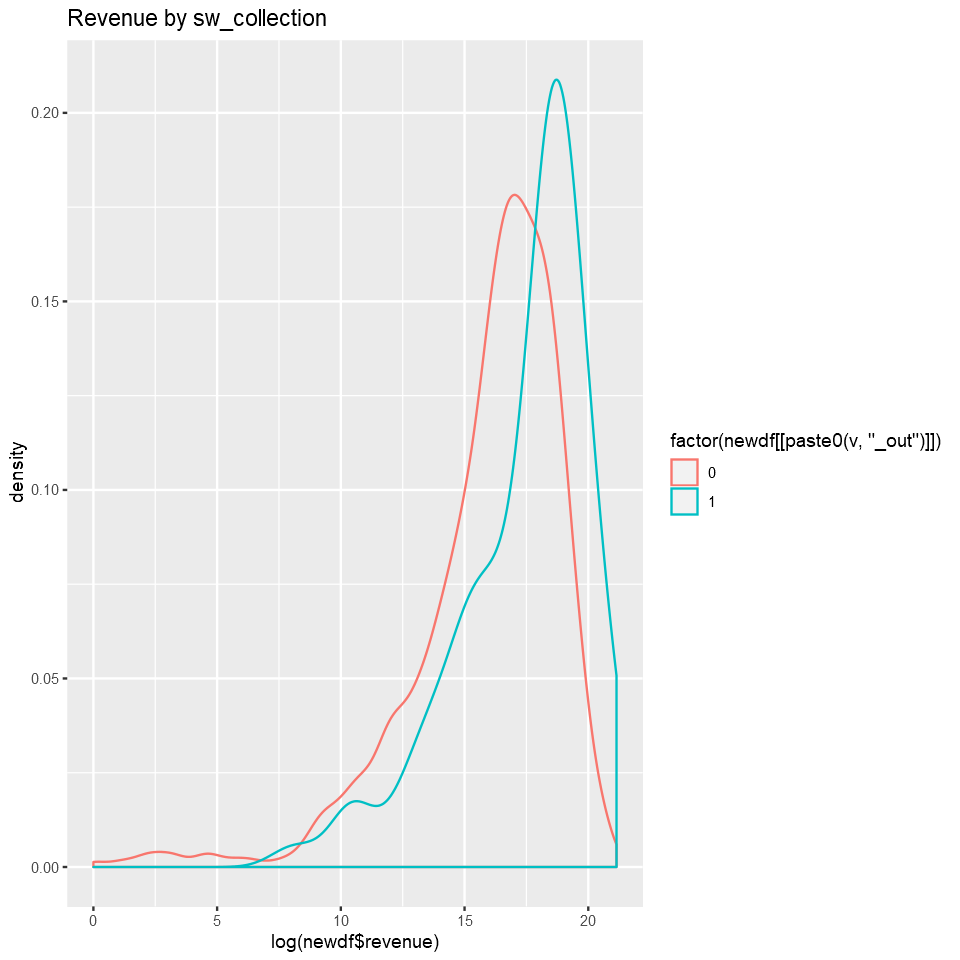

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


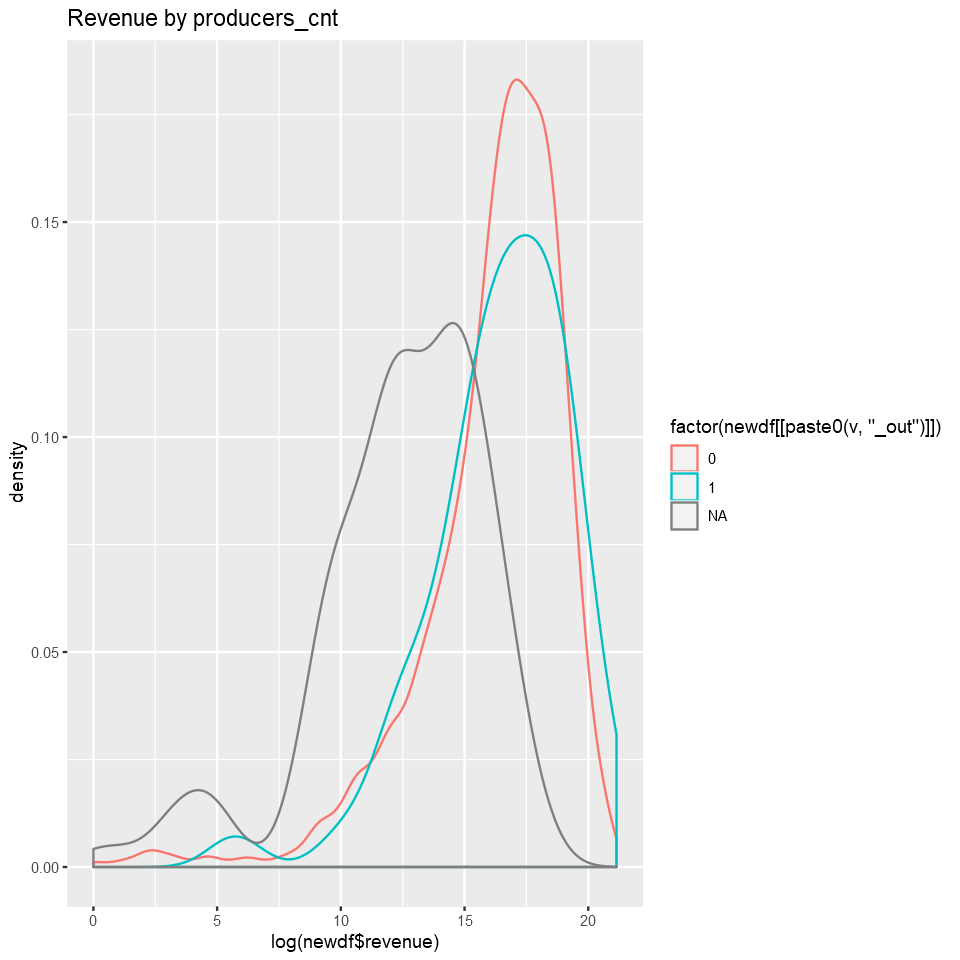

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


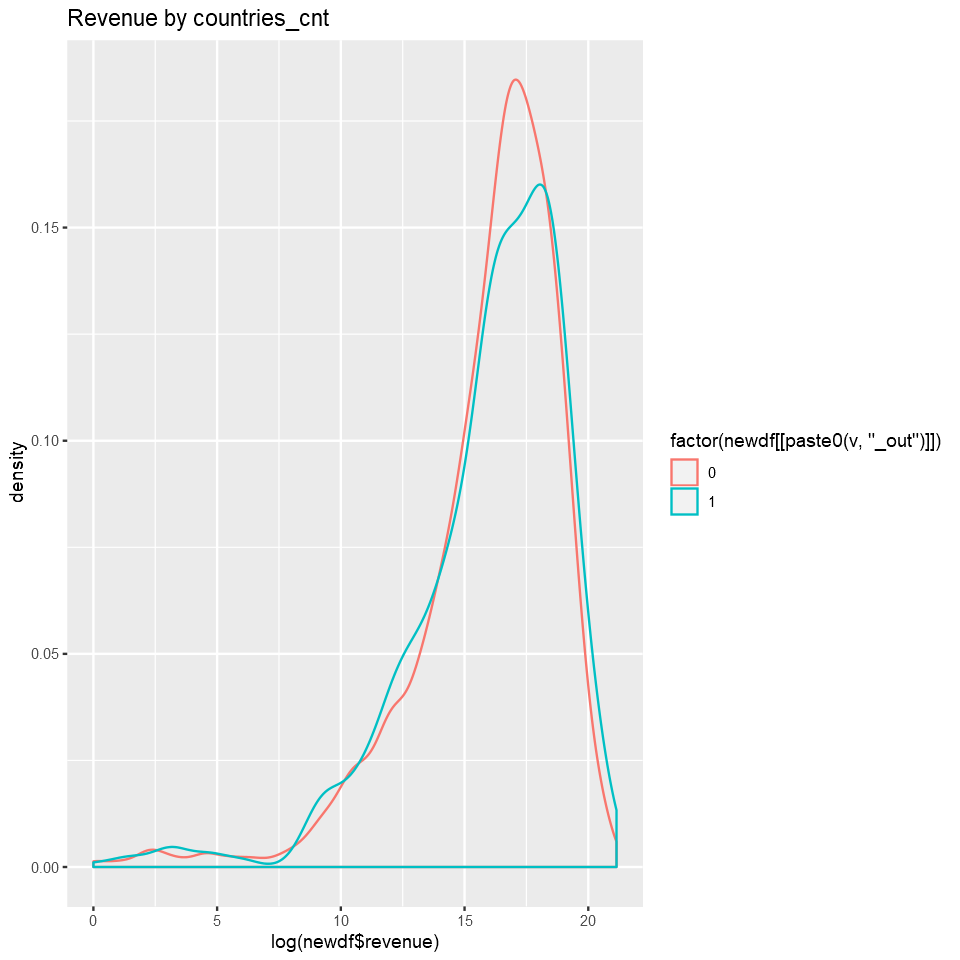

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


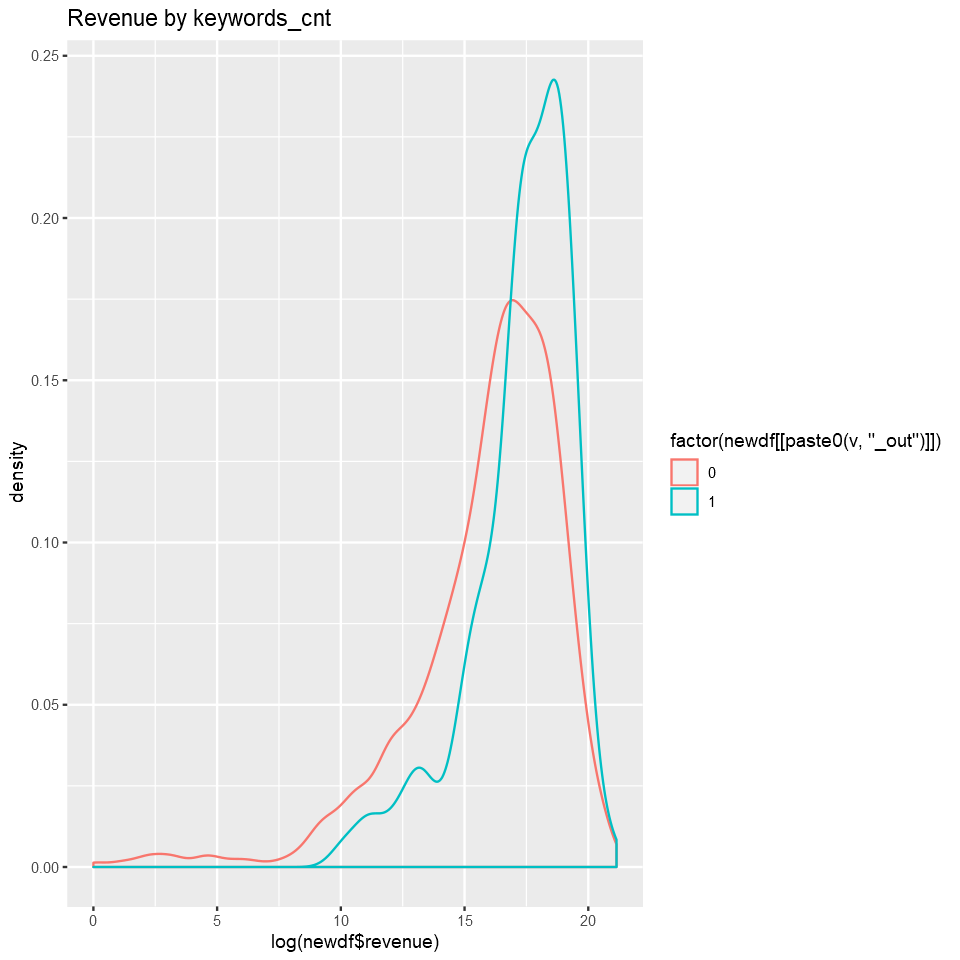

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


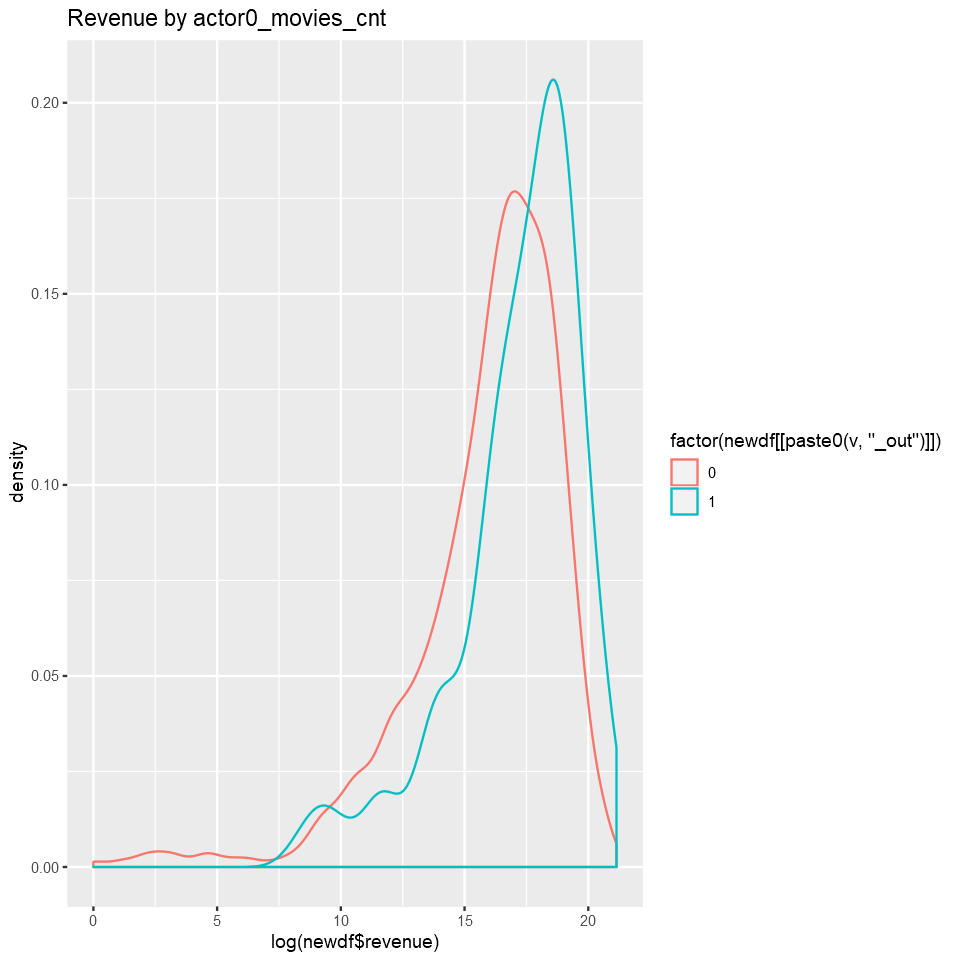

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


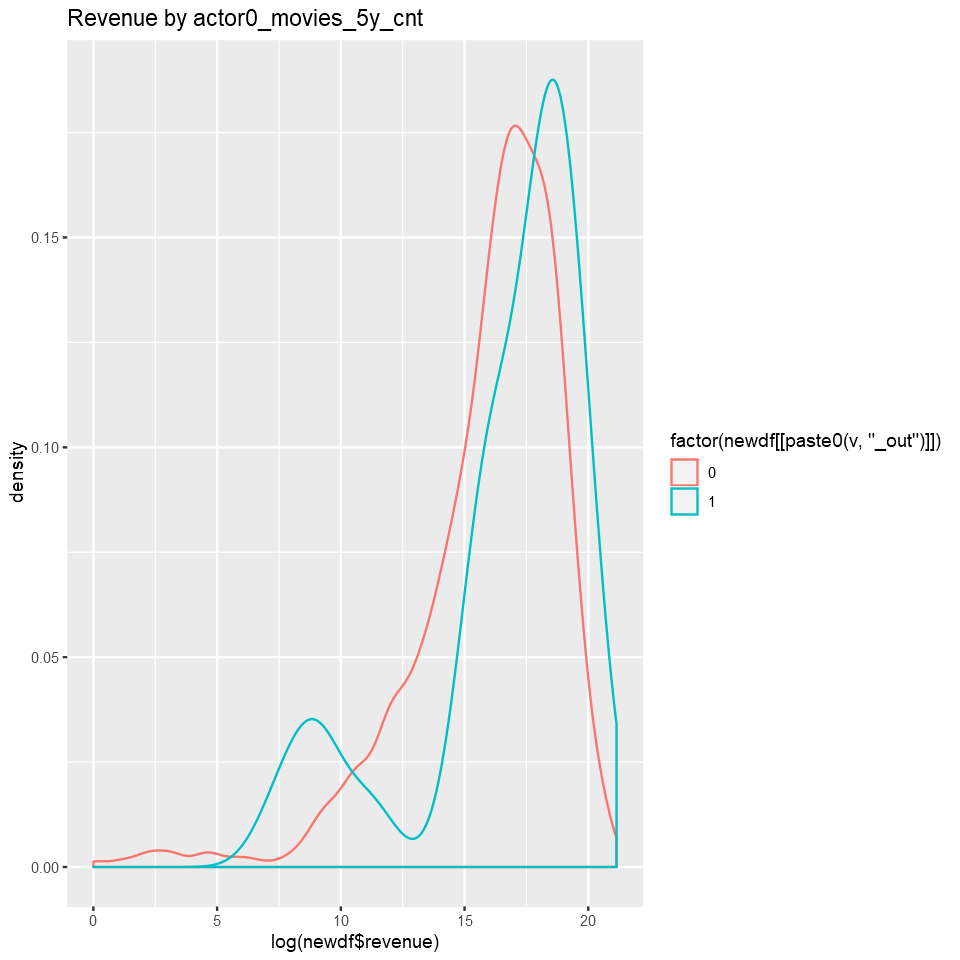

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


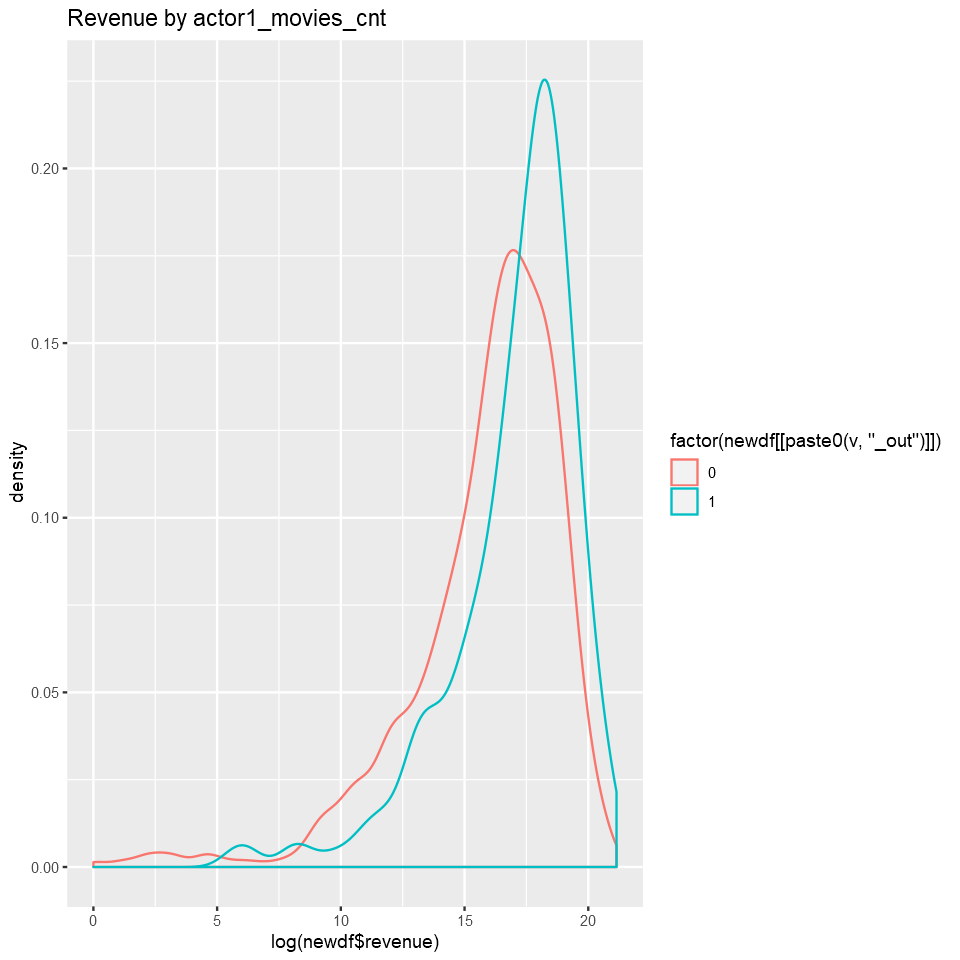

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


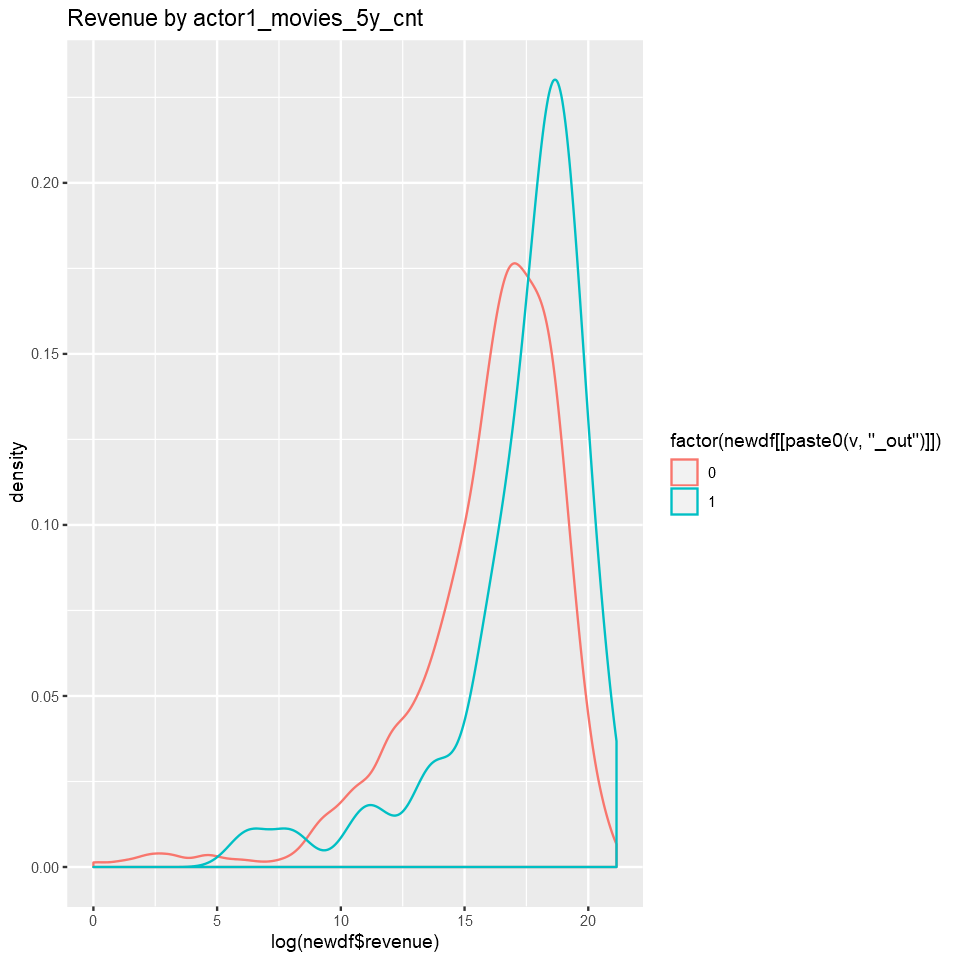

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


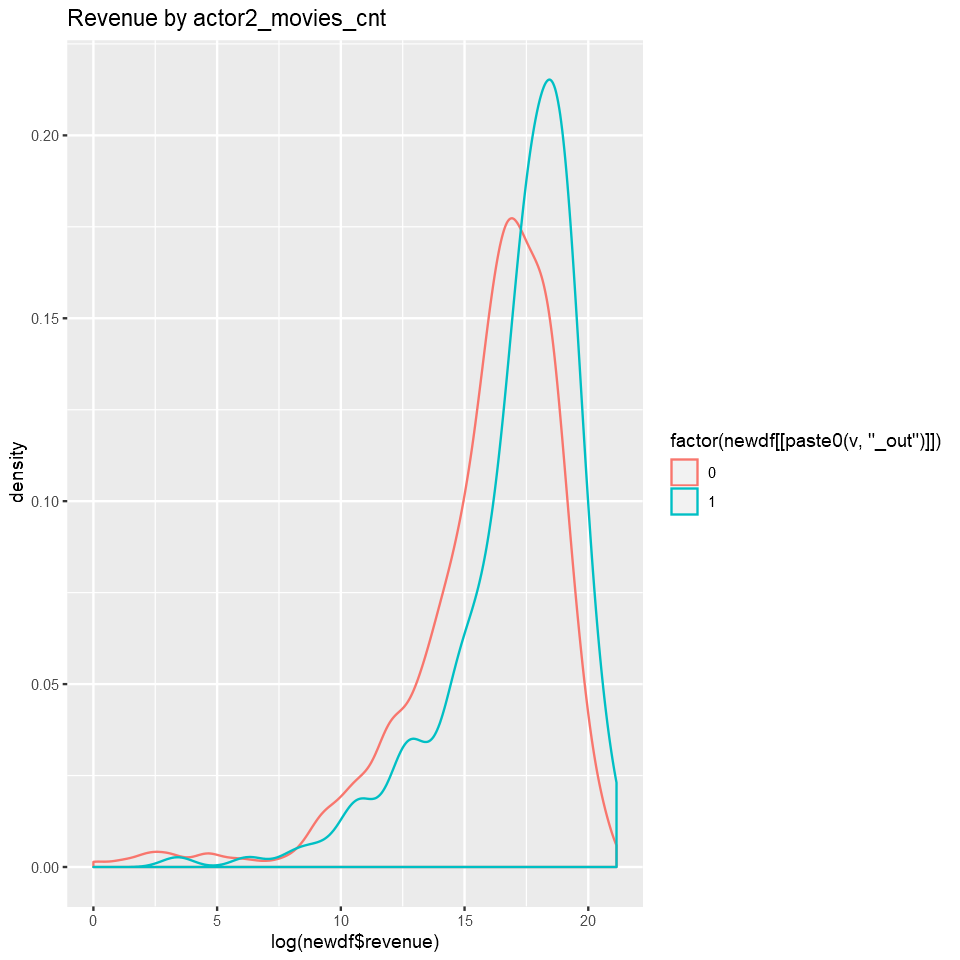

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


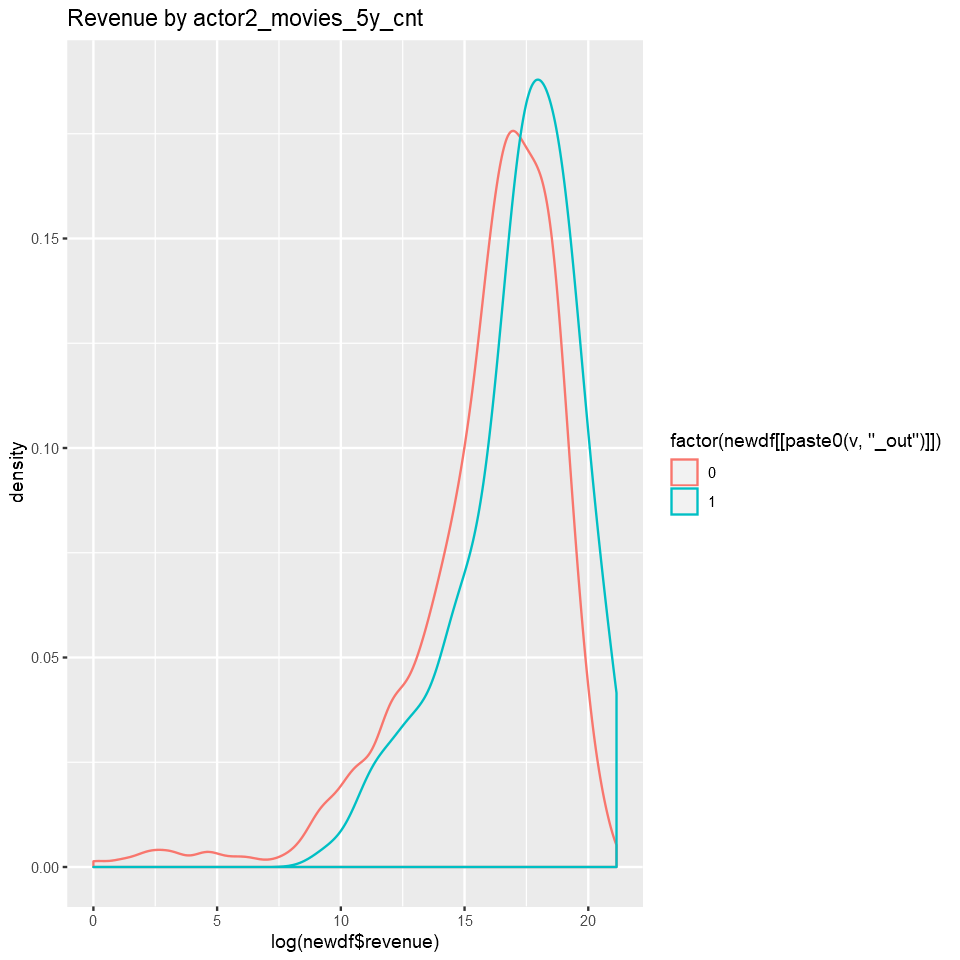

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


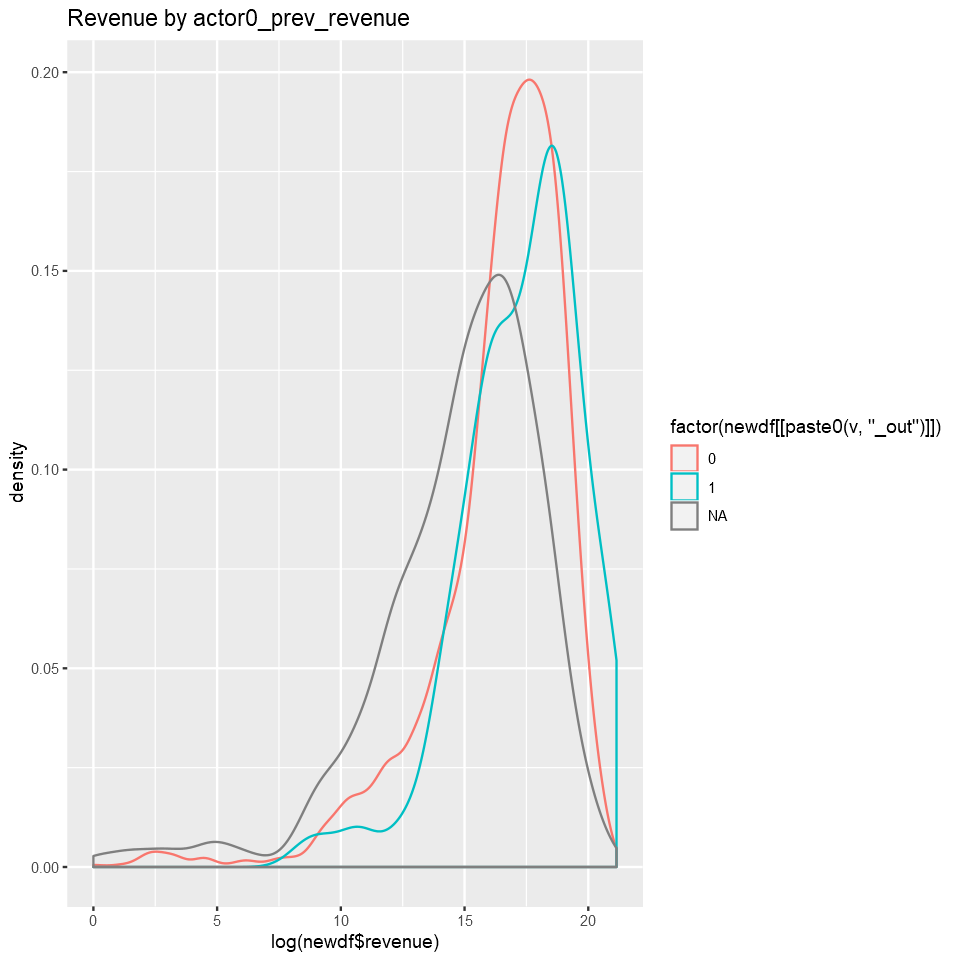

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


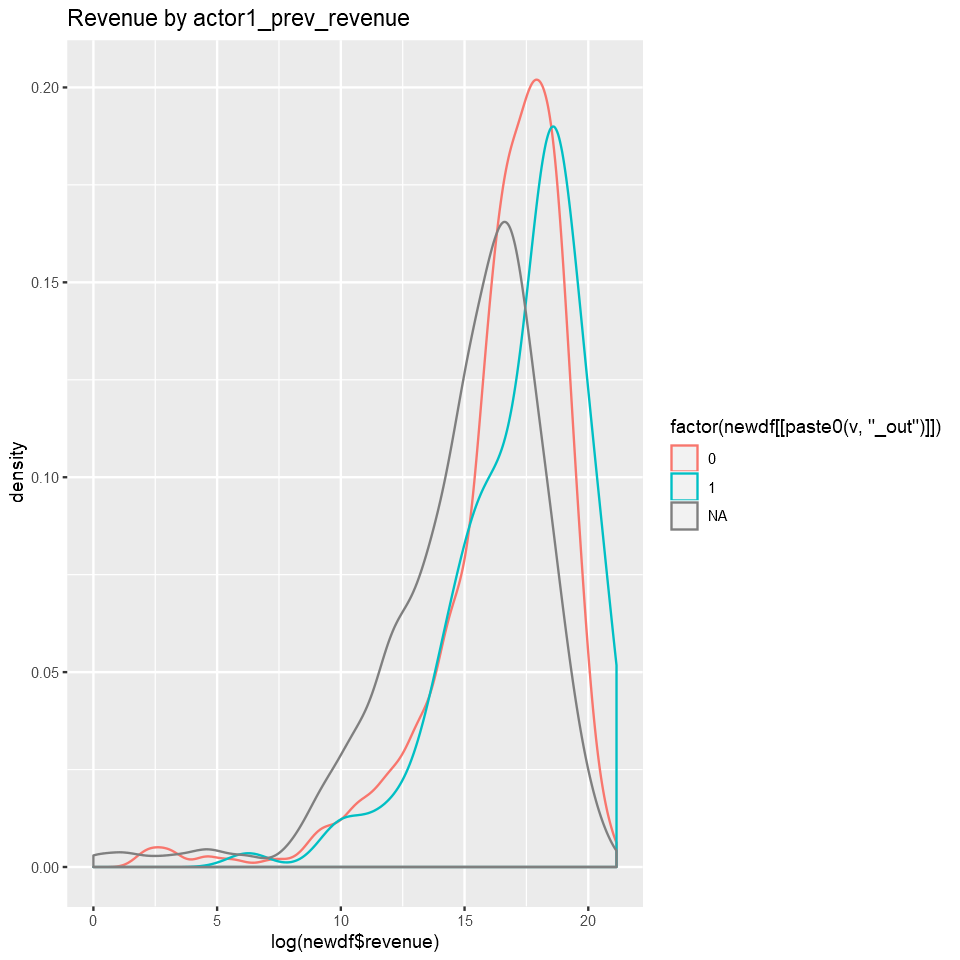

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


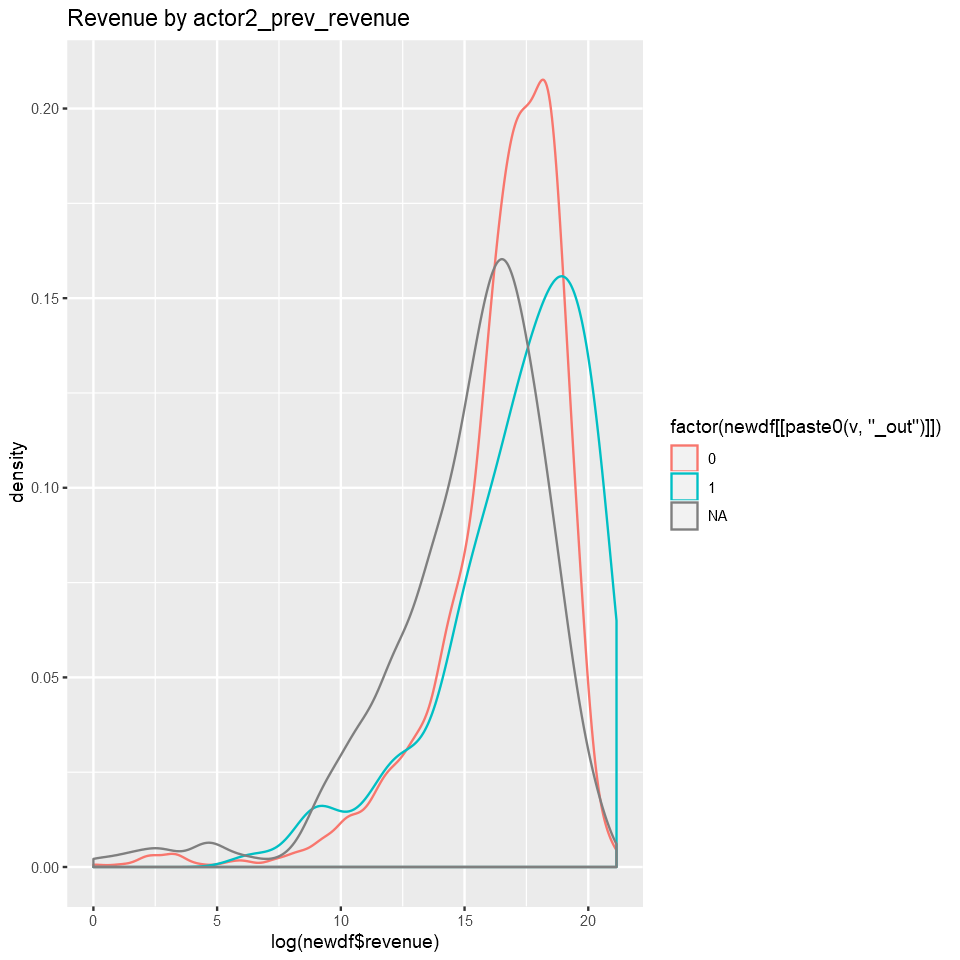

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


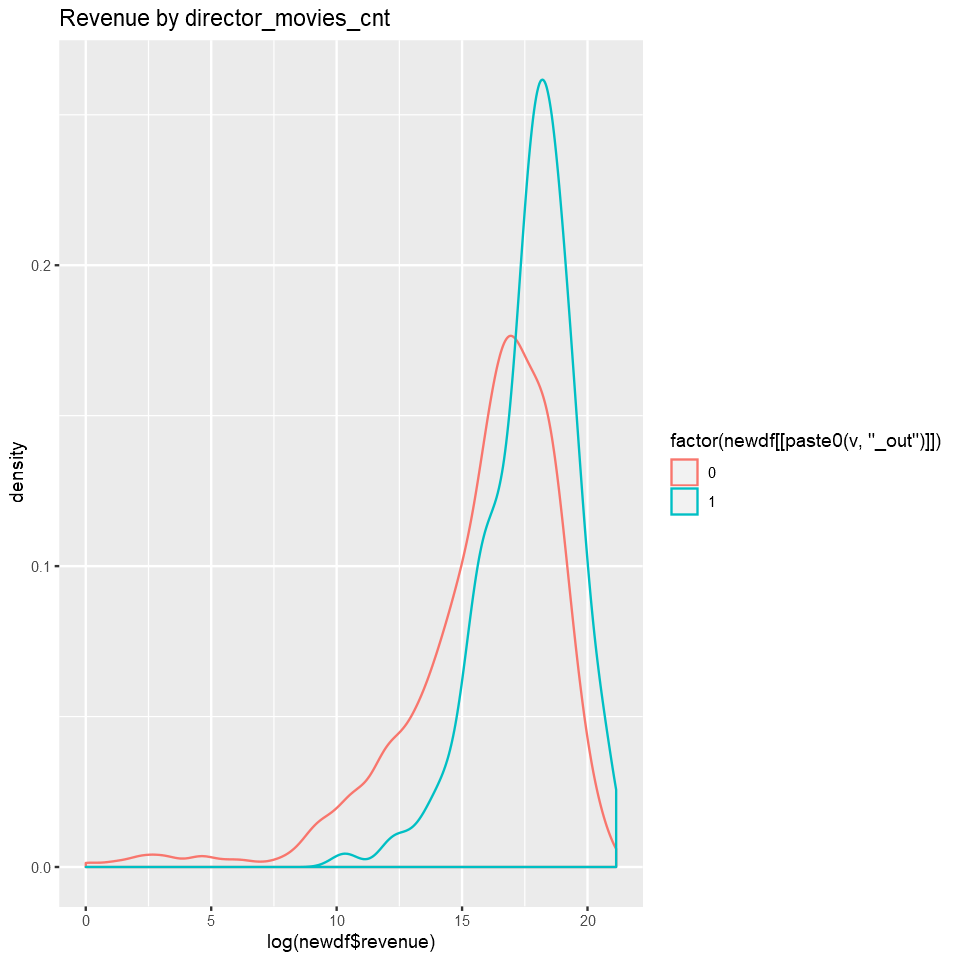

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


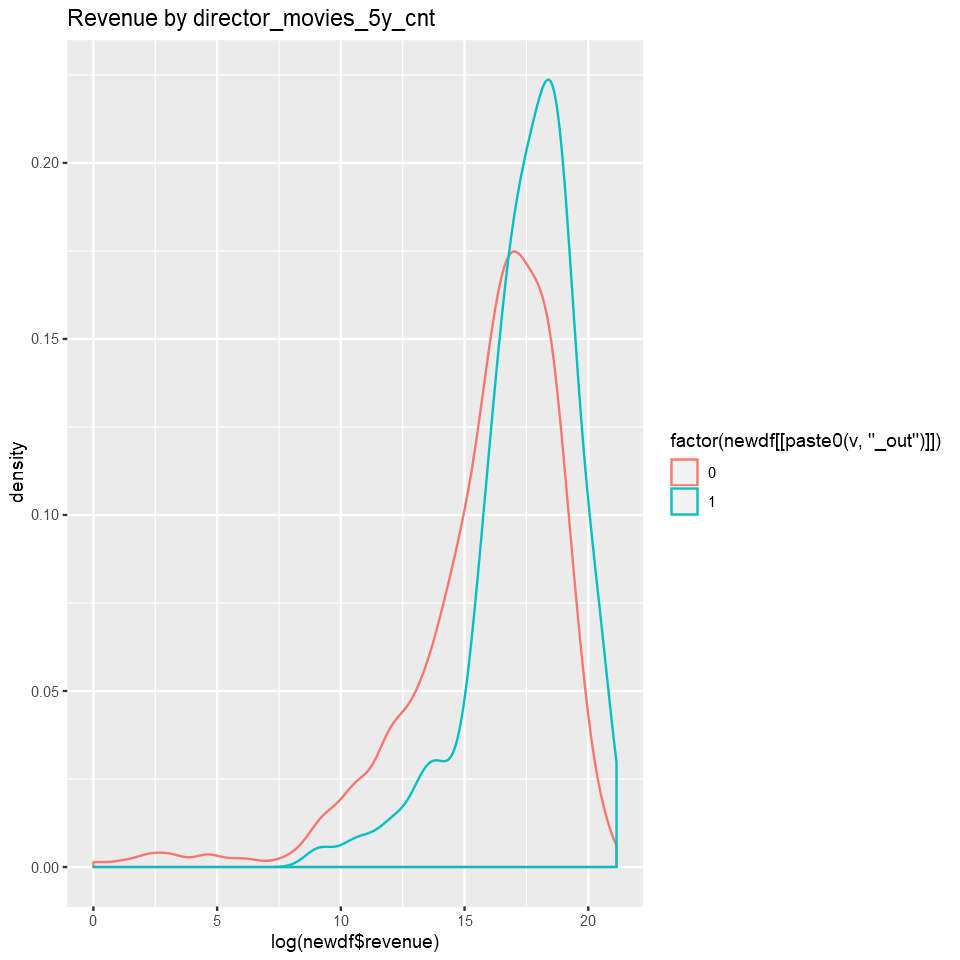

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


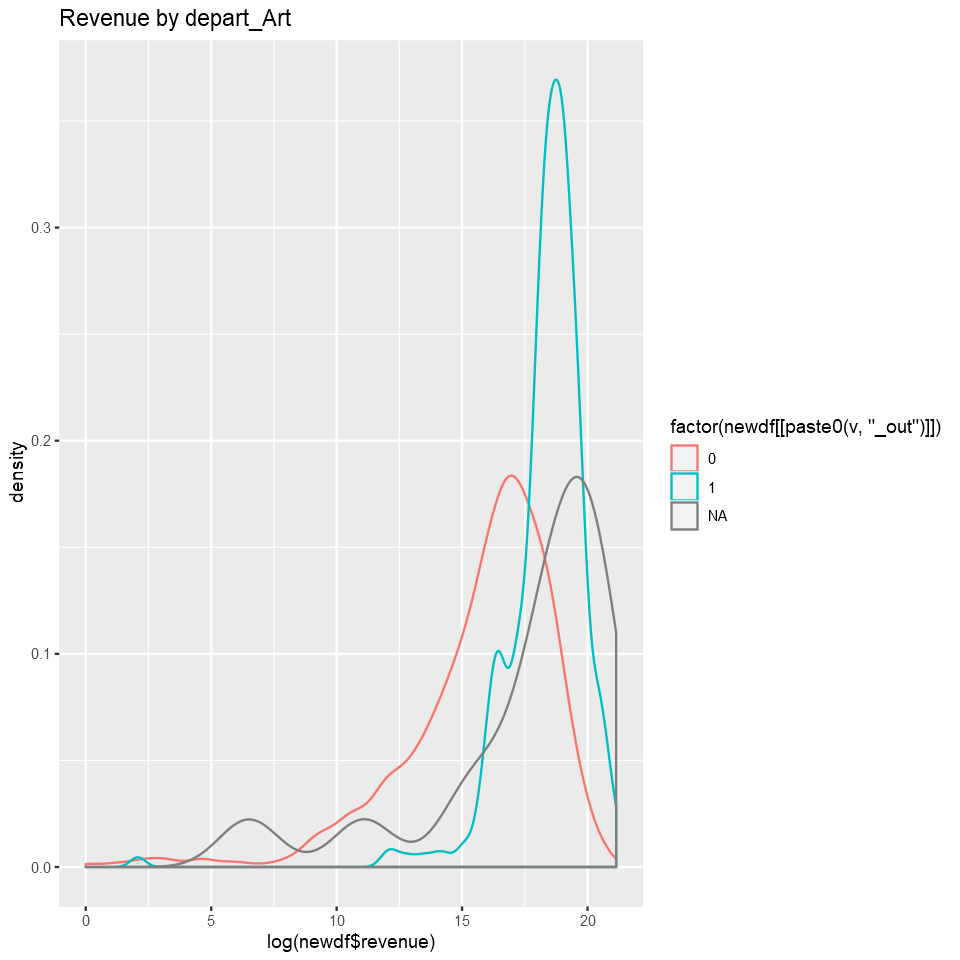

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


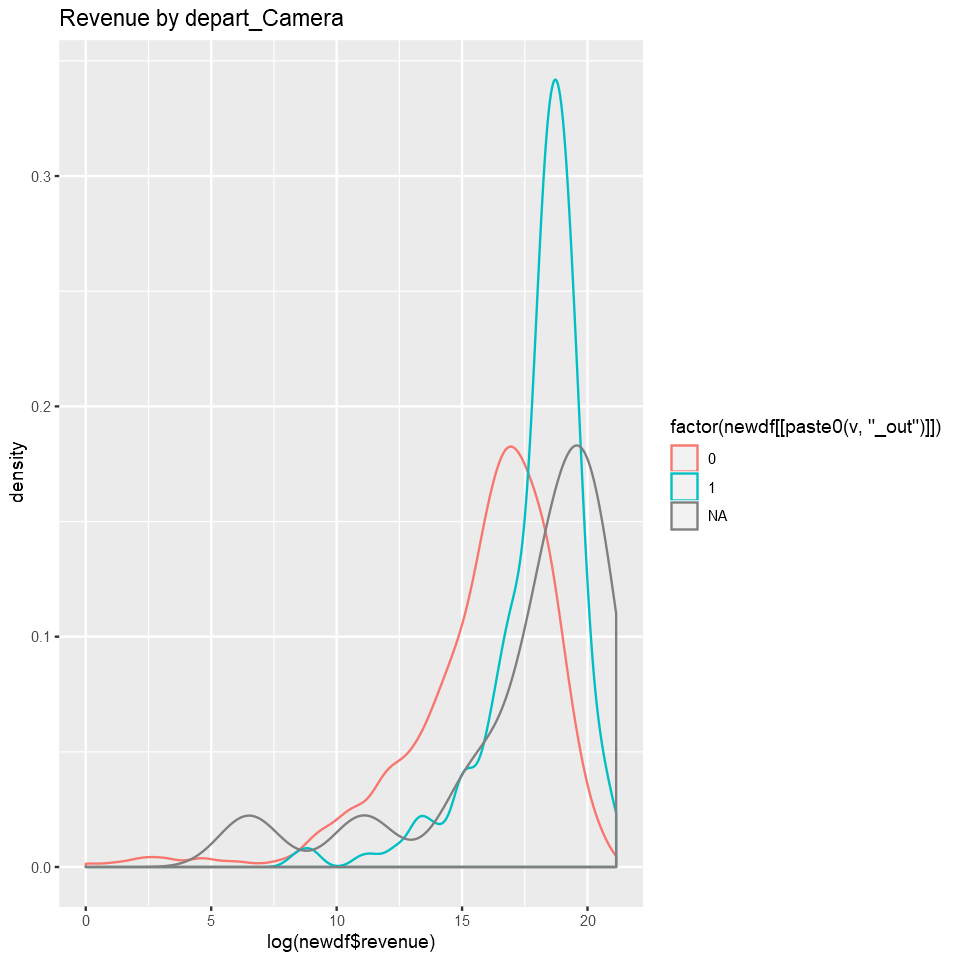

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


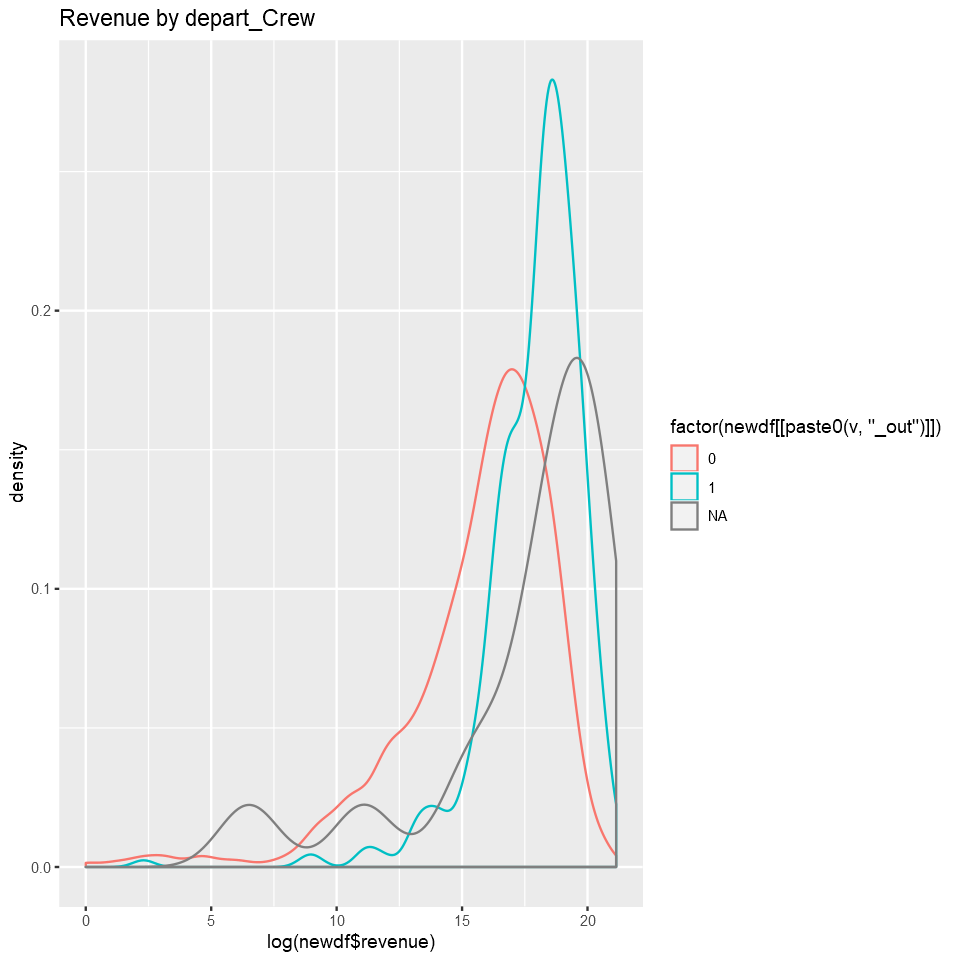

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


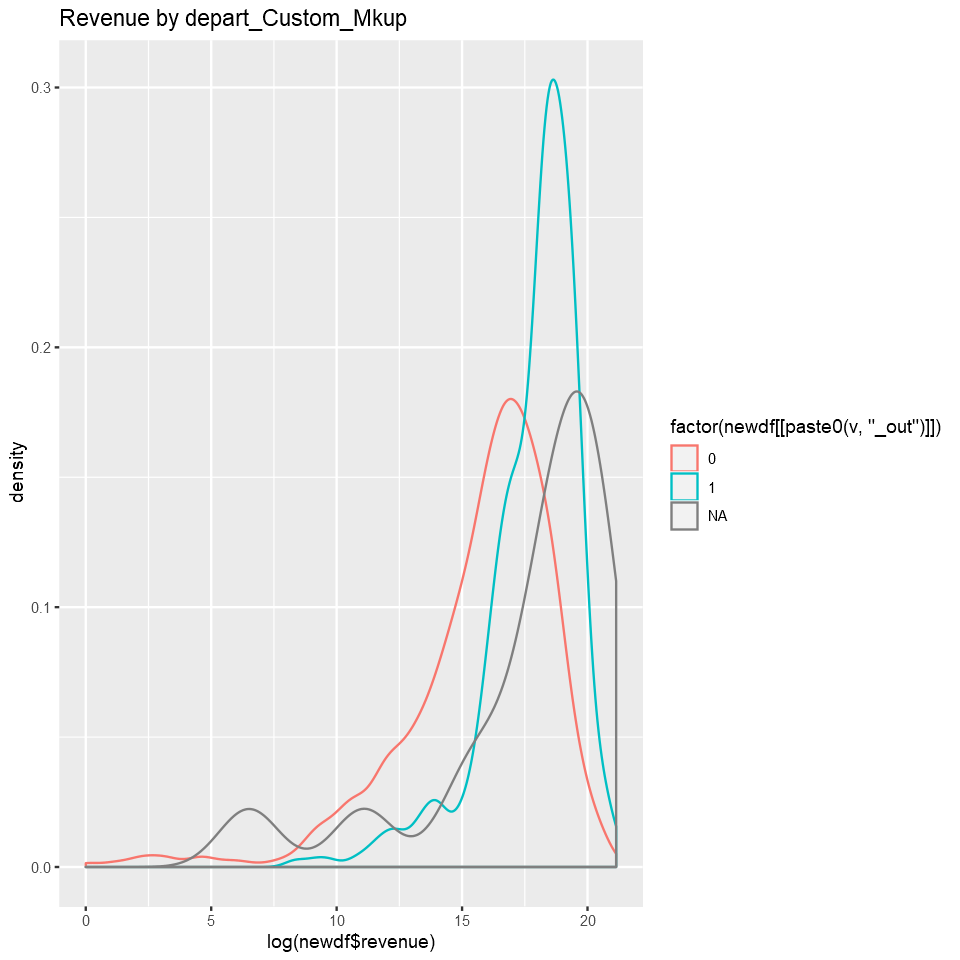

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


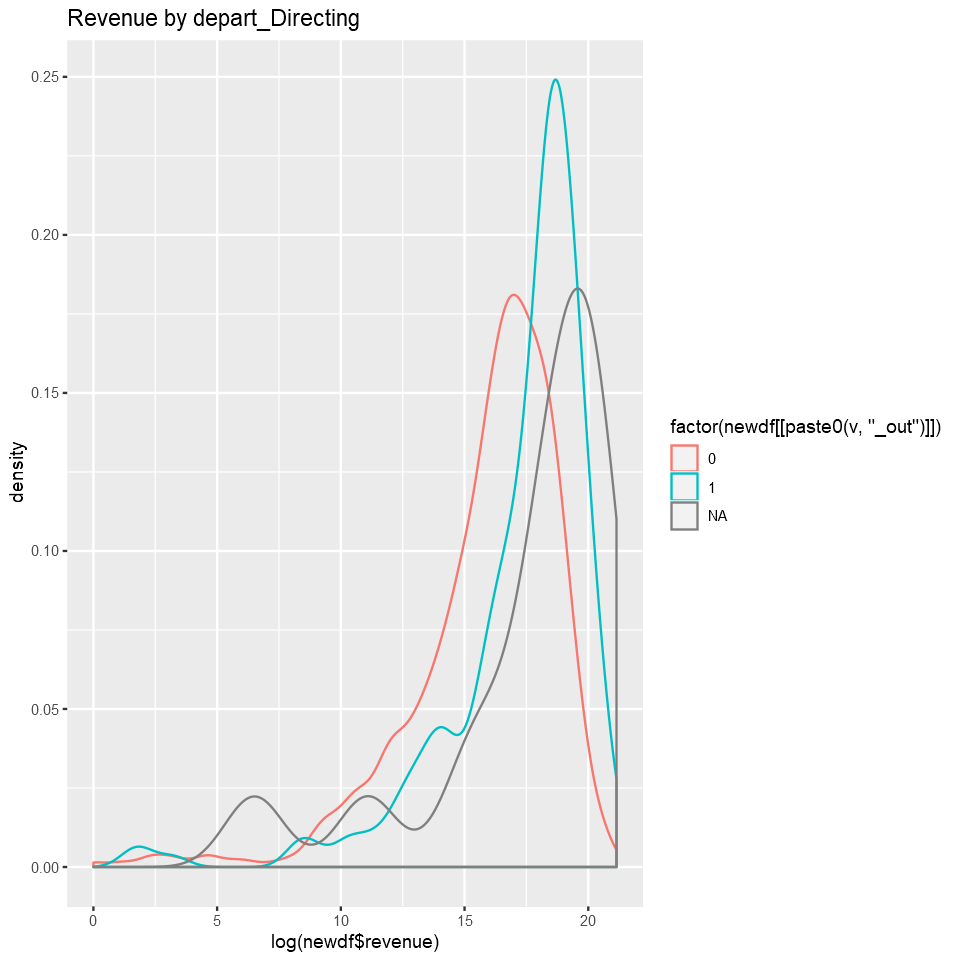

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


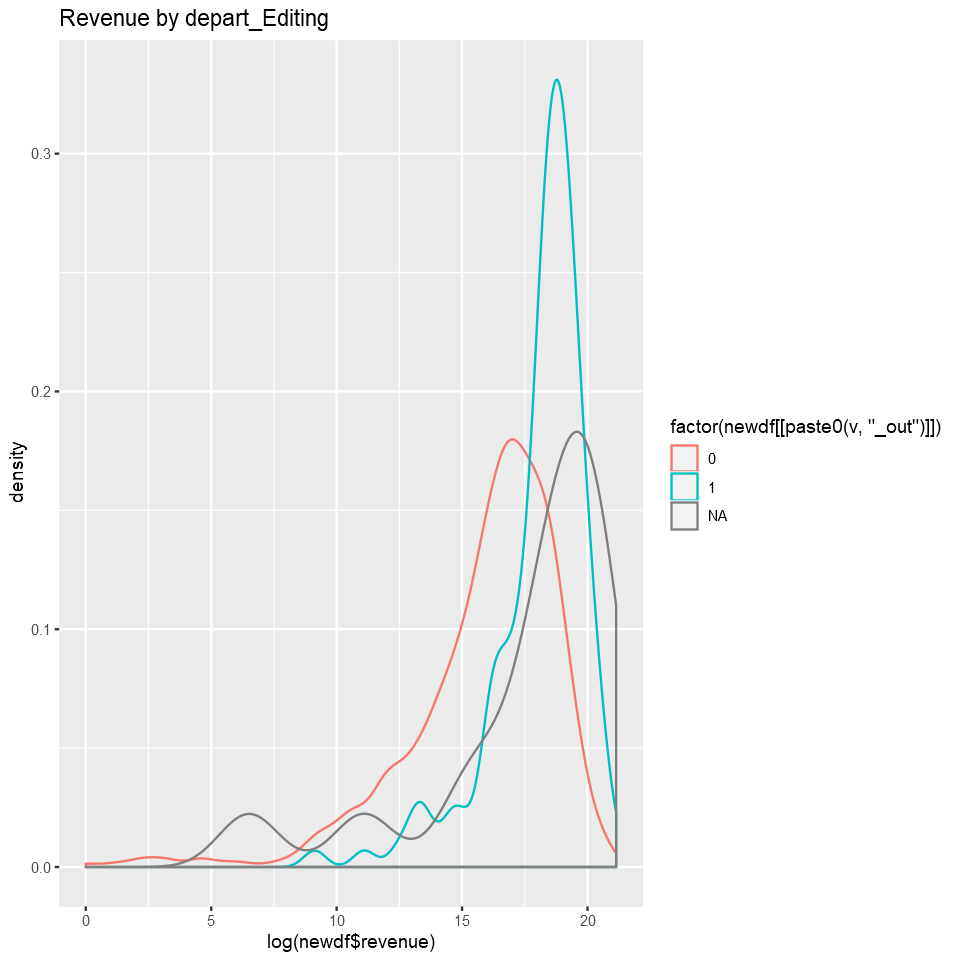

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


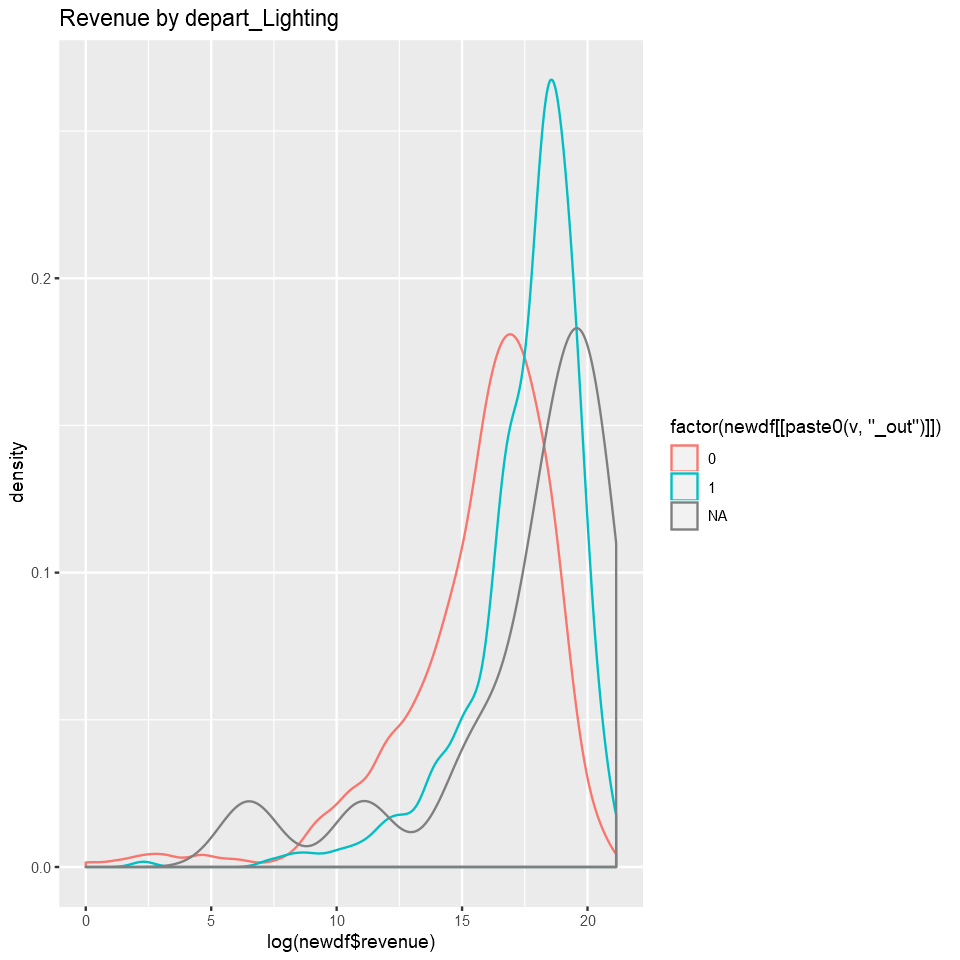

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


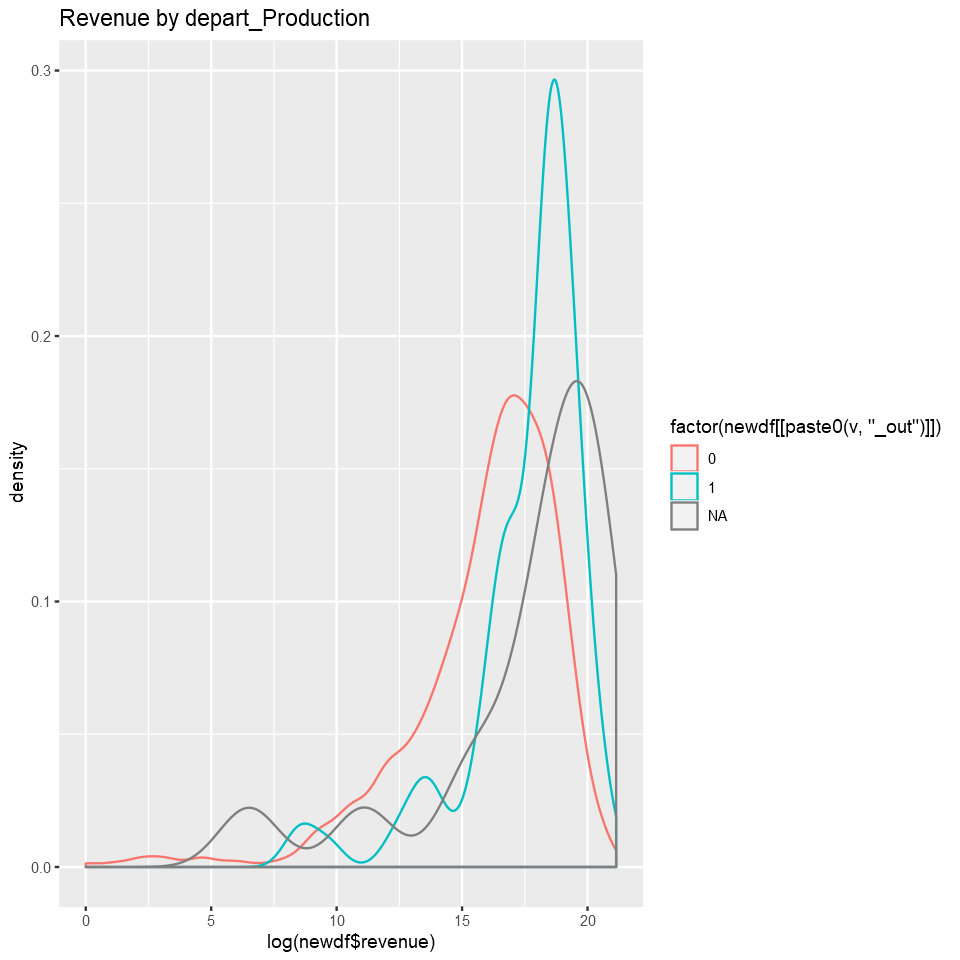

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


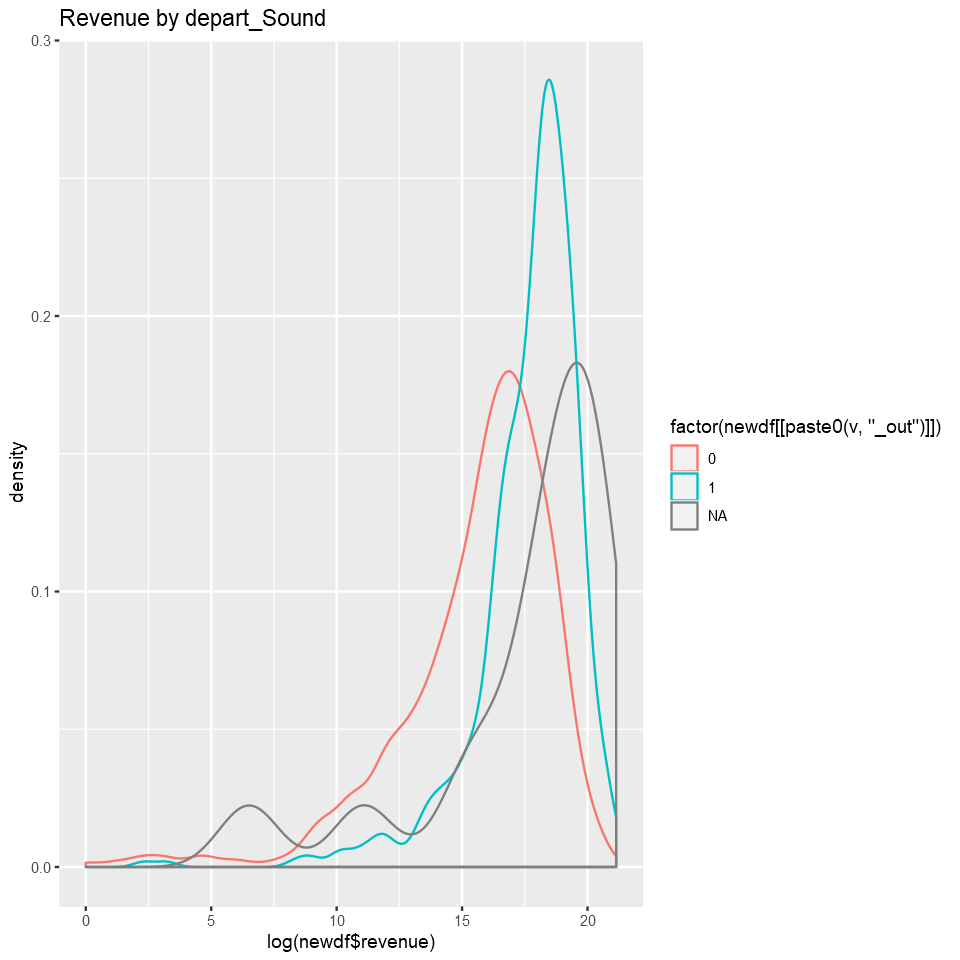

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


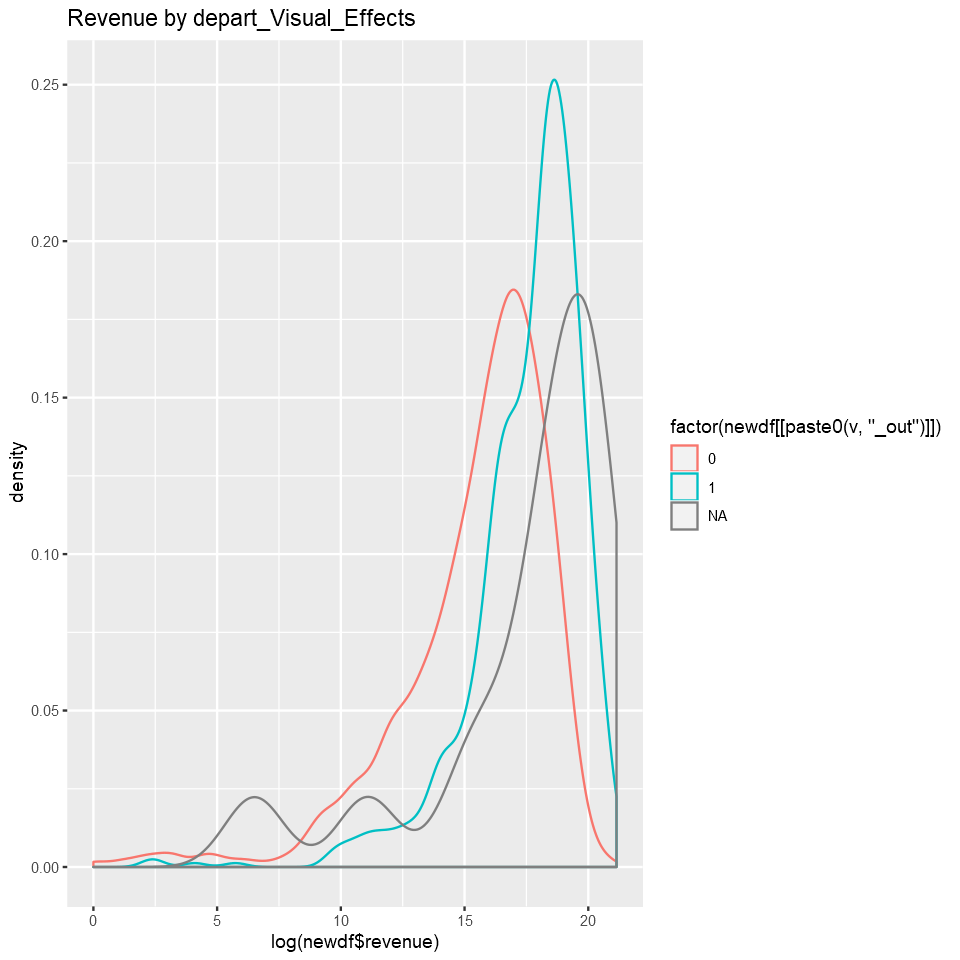

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


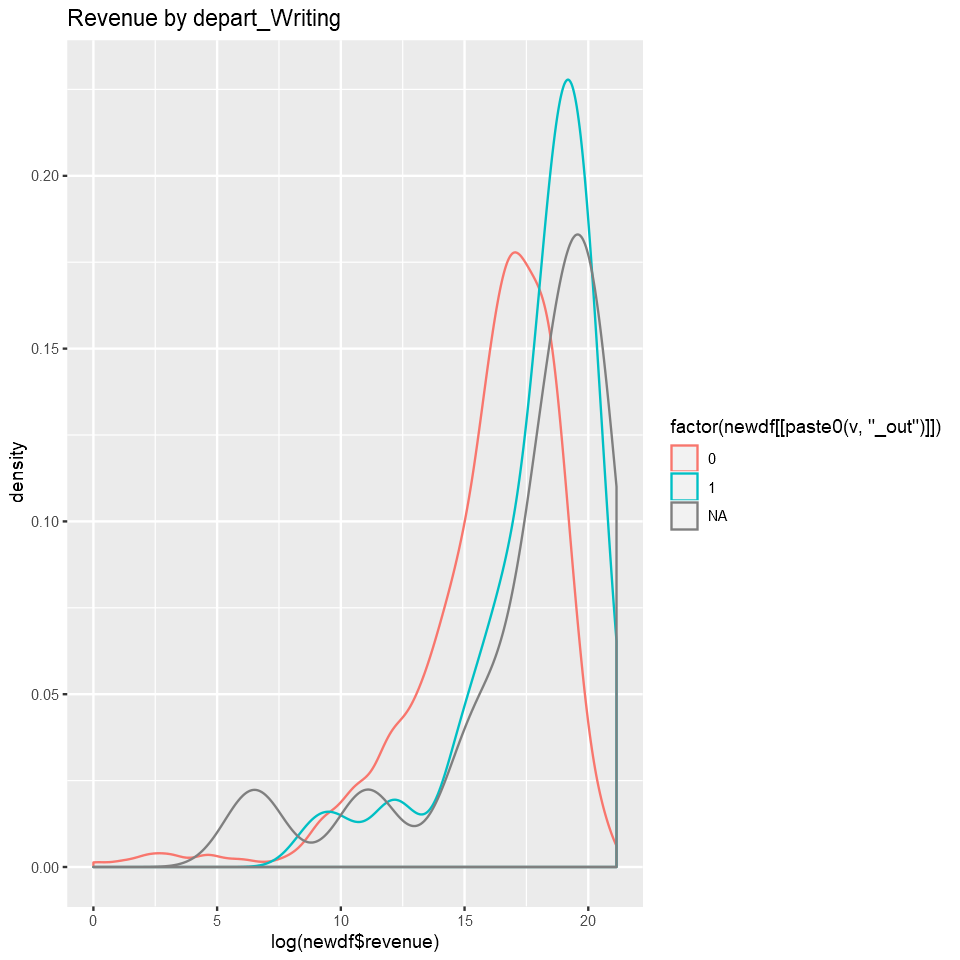

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


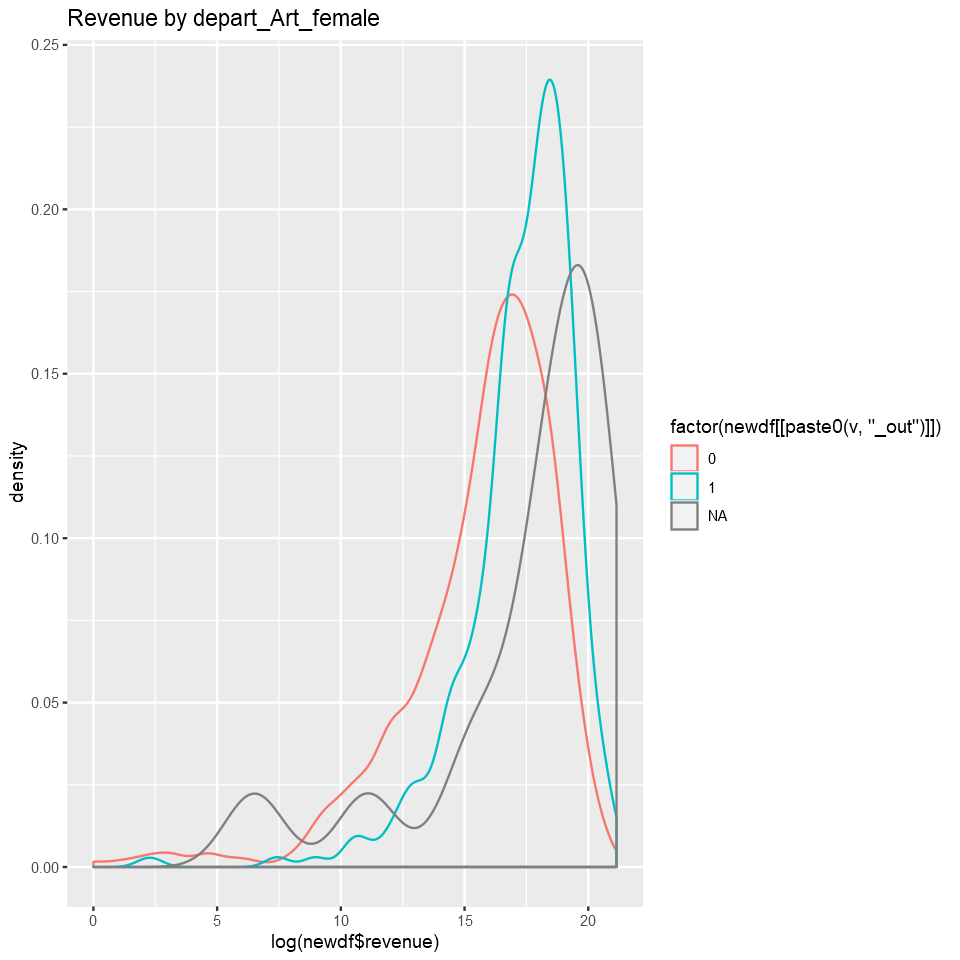

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


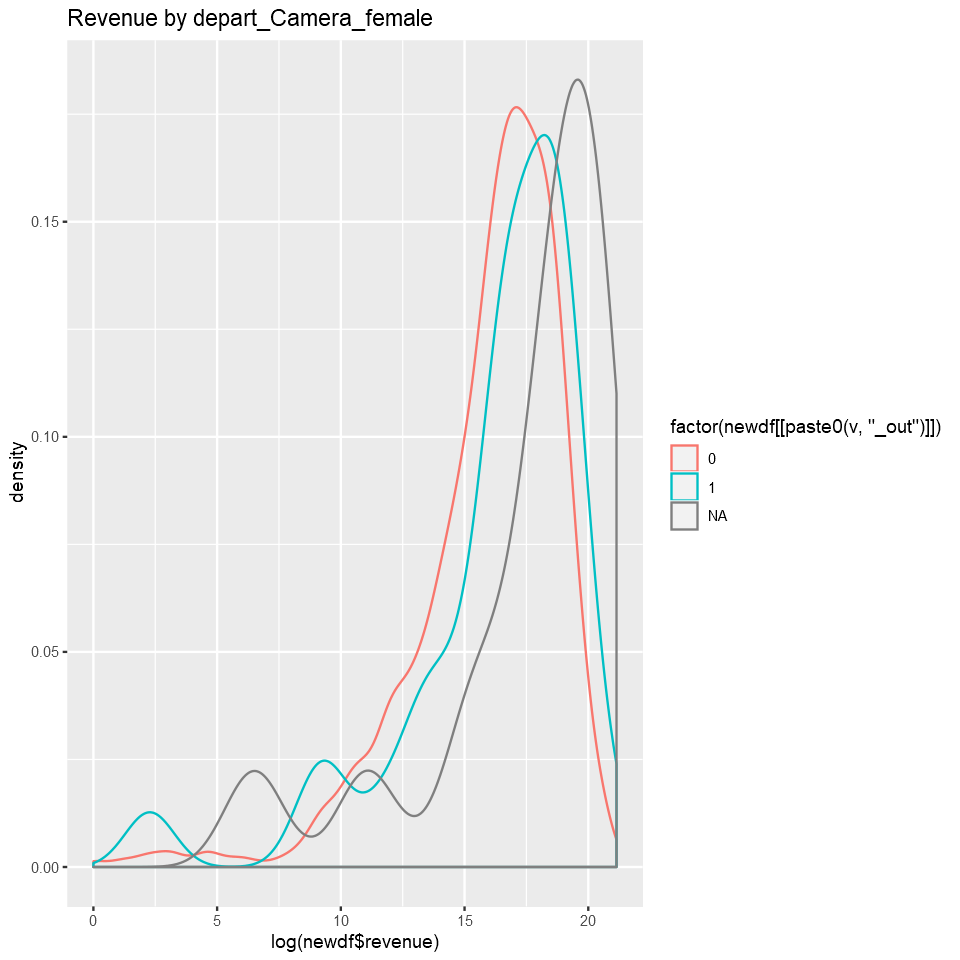

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


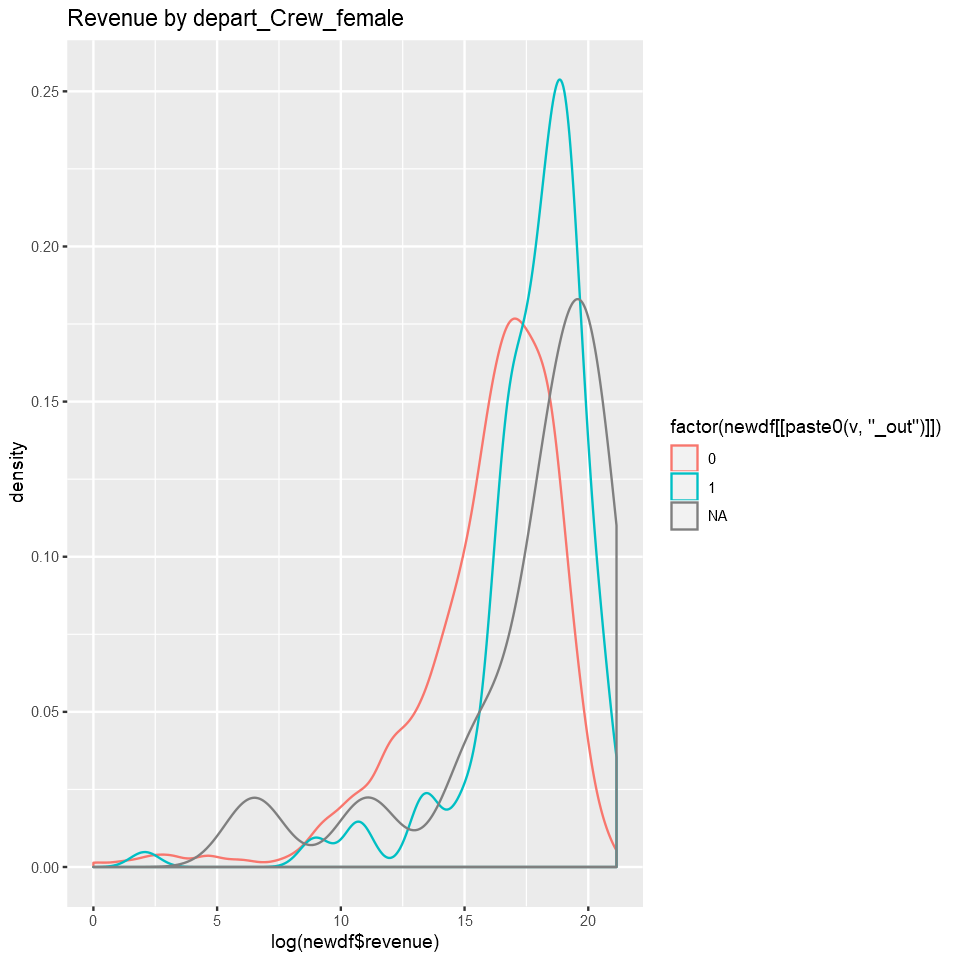

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


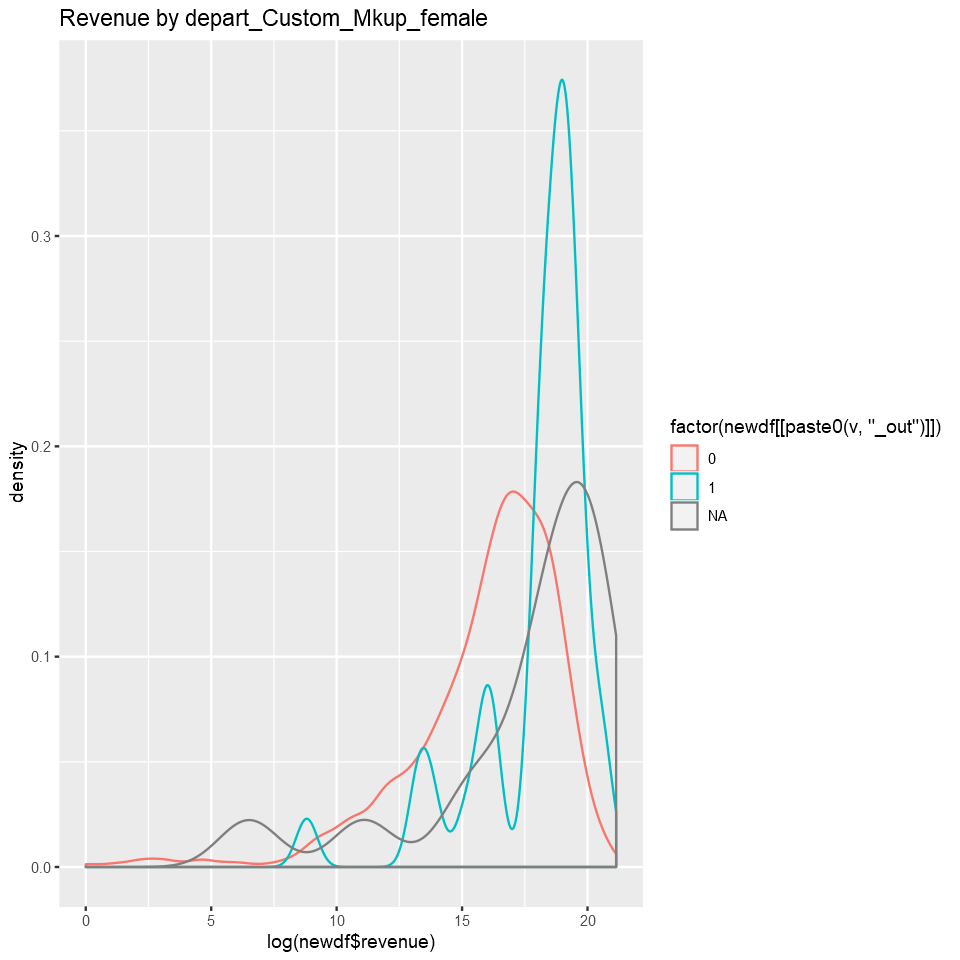

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


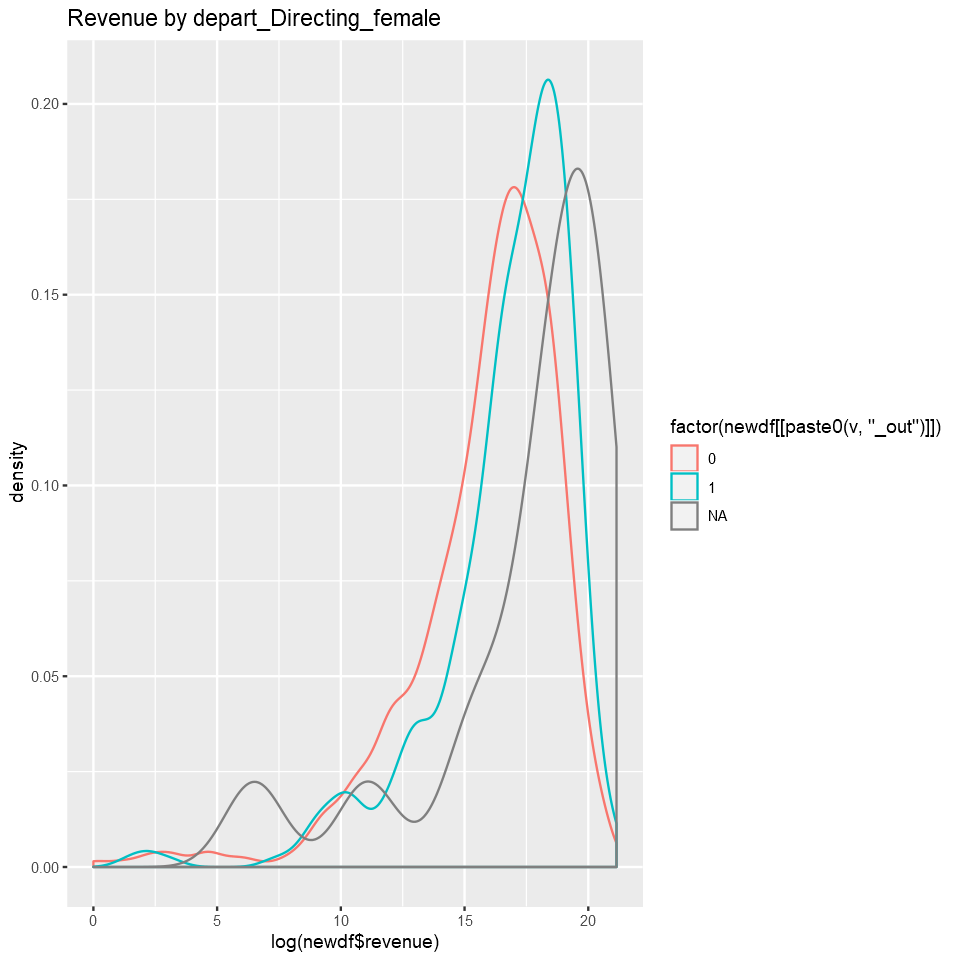

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


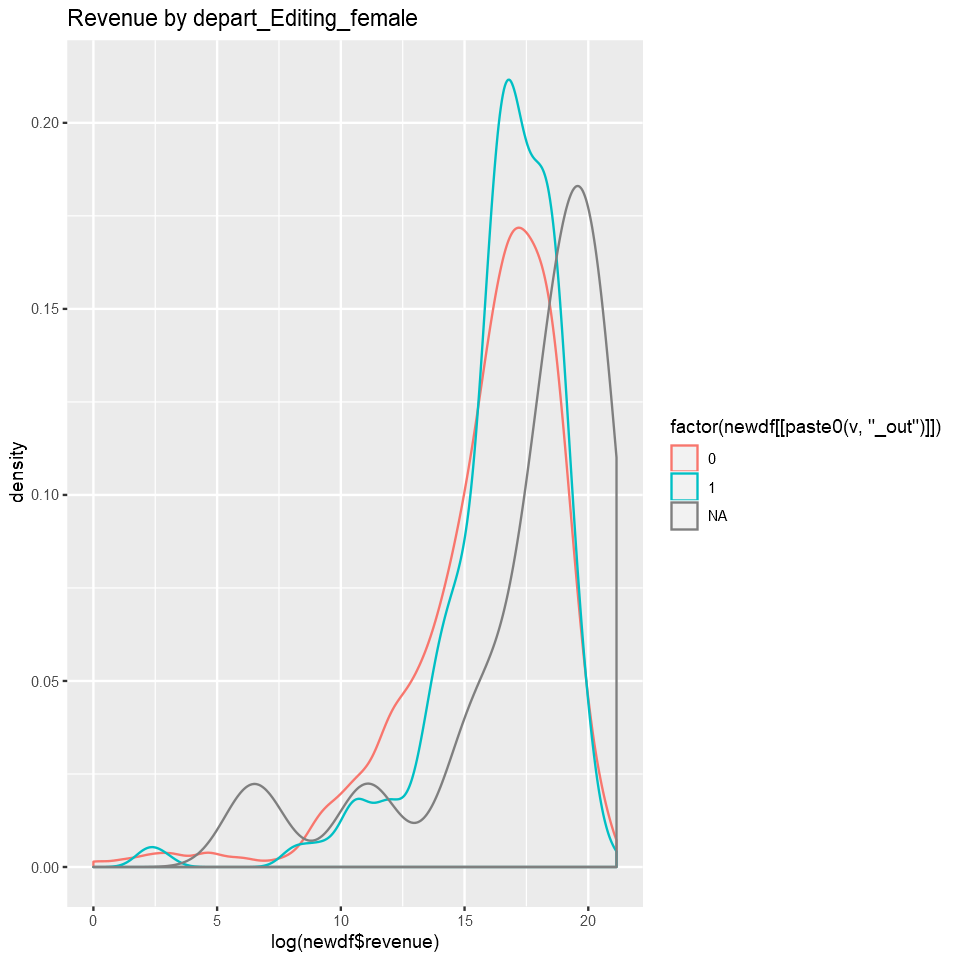

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


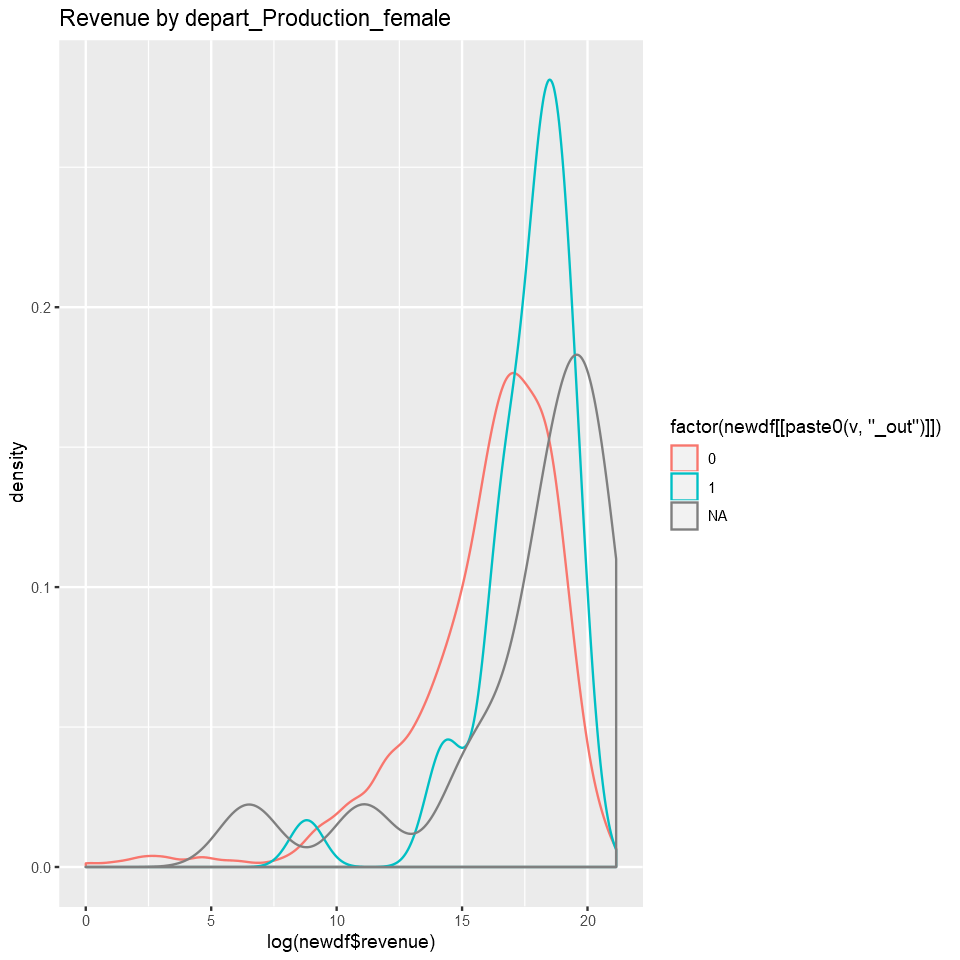

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."
Joining, by = "movie_id"


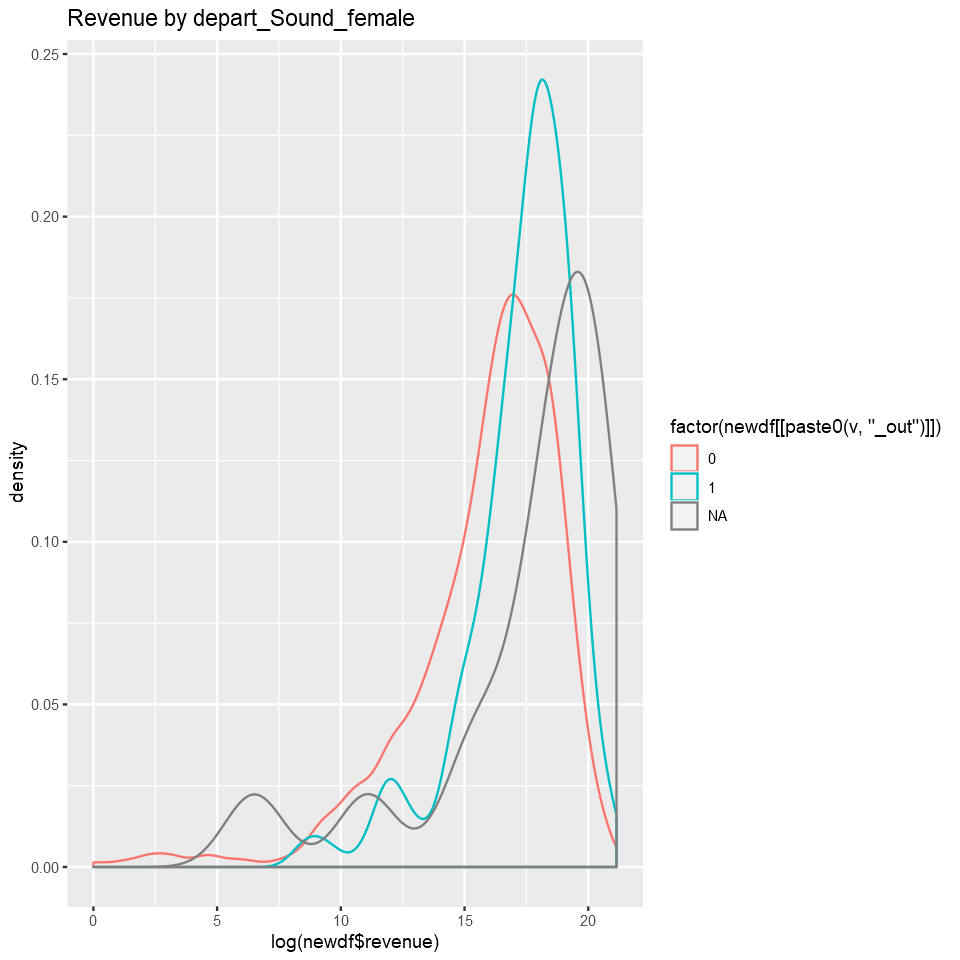

Warning message:
"Removed 4382 rows containing non-finite values (stat_density)."


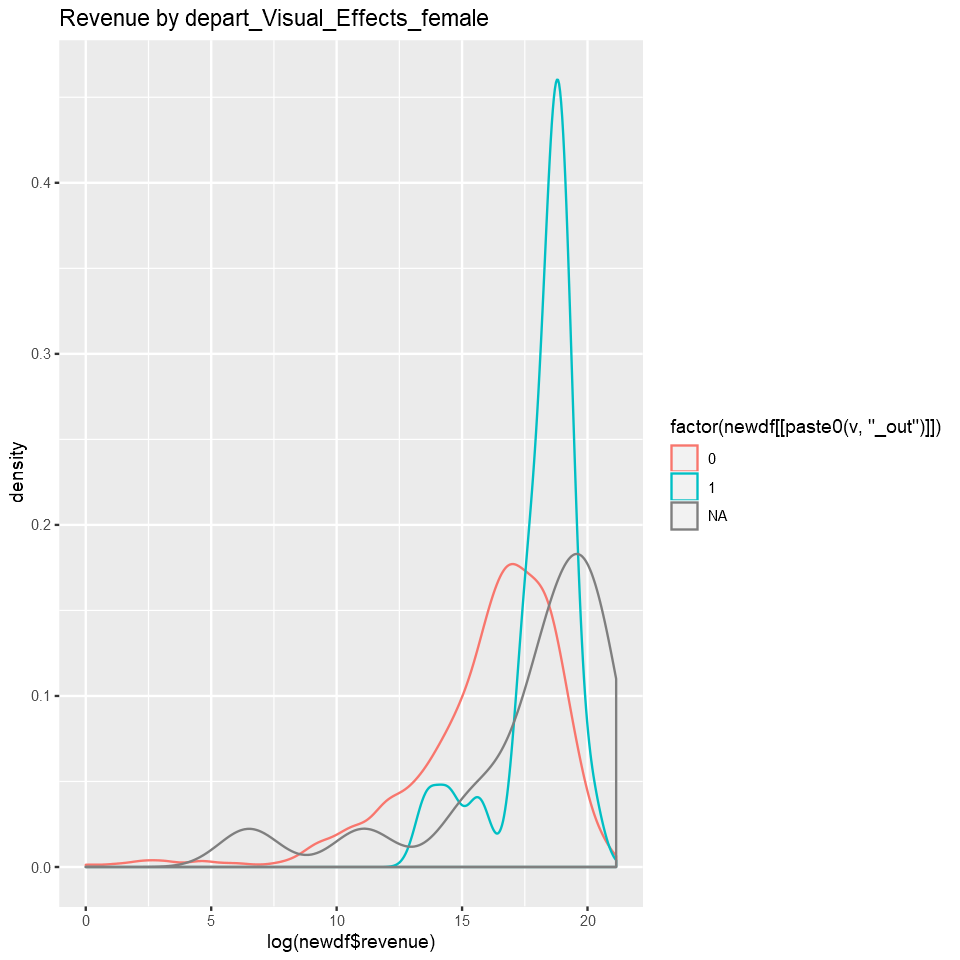

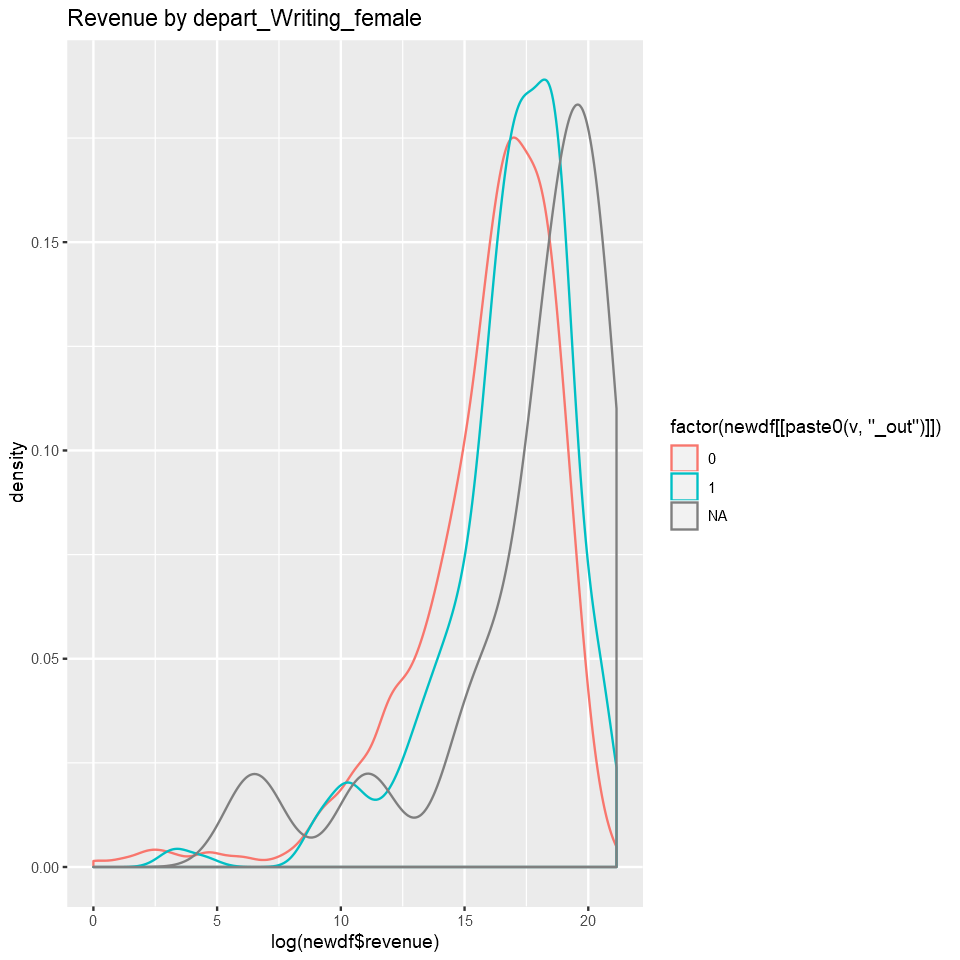

In [62]:
 for (v in movies_continuous){
    newdf <- left_join(movies_ff[,c("movie_id","revenue")], movies_outliers[,c("movie_id",paste0(v,"_out"))])
    print(    ggplot (newdf,aes(x=log(newdf$revenue), group = factor(newdf[[paste0(v,"_out")]]),
                                color = factor(newdf[[paste0(v,"_out")]]))) + 
          geom_density() + ggtitle(paste("Revenue by",v)) )
 
    options(repr.plot.width = 8, repr.plot.height = 8)
}

### 3.1.2 האם רואים שוני עם או בלי ערכי קיצון ?Y- משפיעה על ההתנהגות של משתנה ה X- האם ערכי קיצון במשתנה ה

Warning message:
"Removed 4382 rows containing missing values (geom_point)."
Warning message:
"Removed 4384 rows containing missing values (geom_point)."


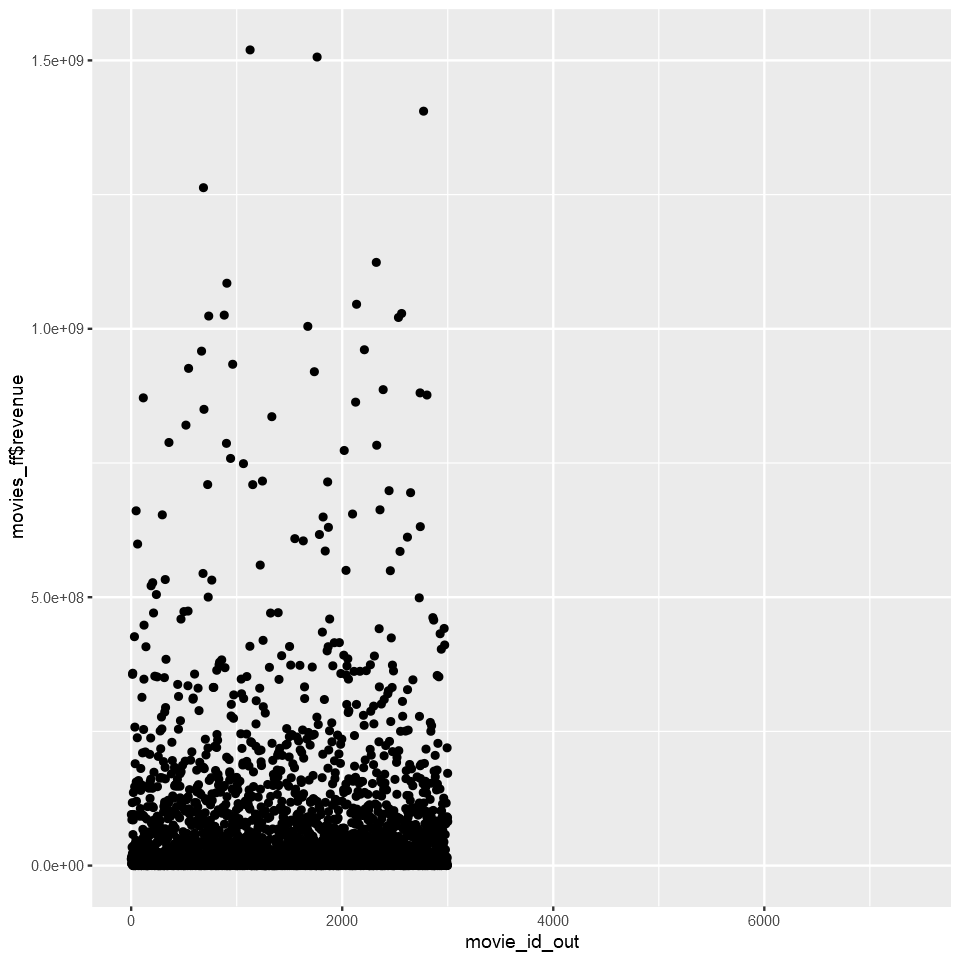

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


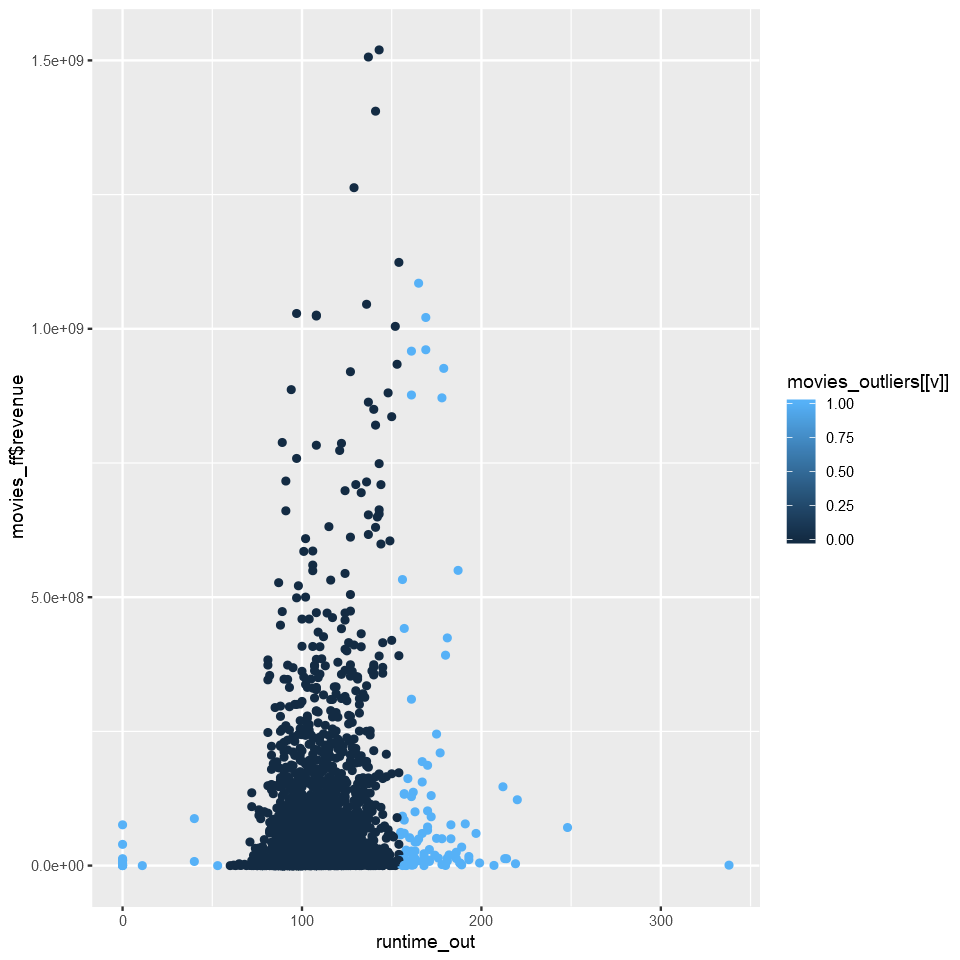

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


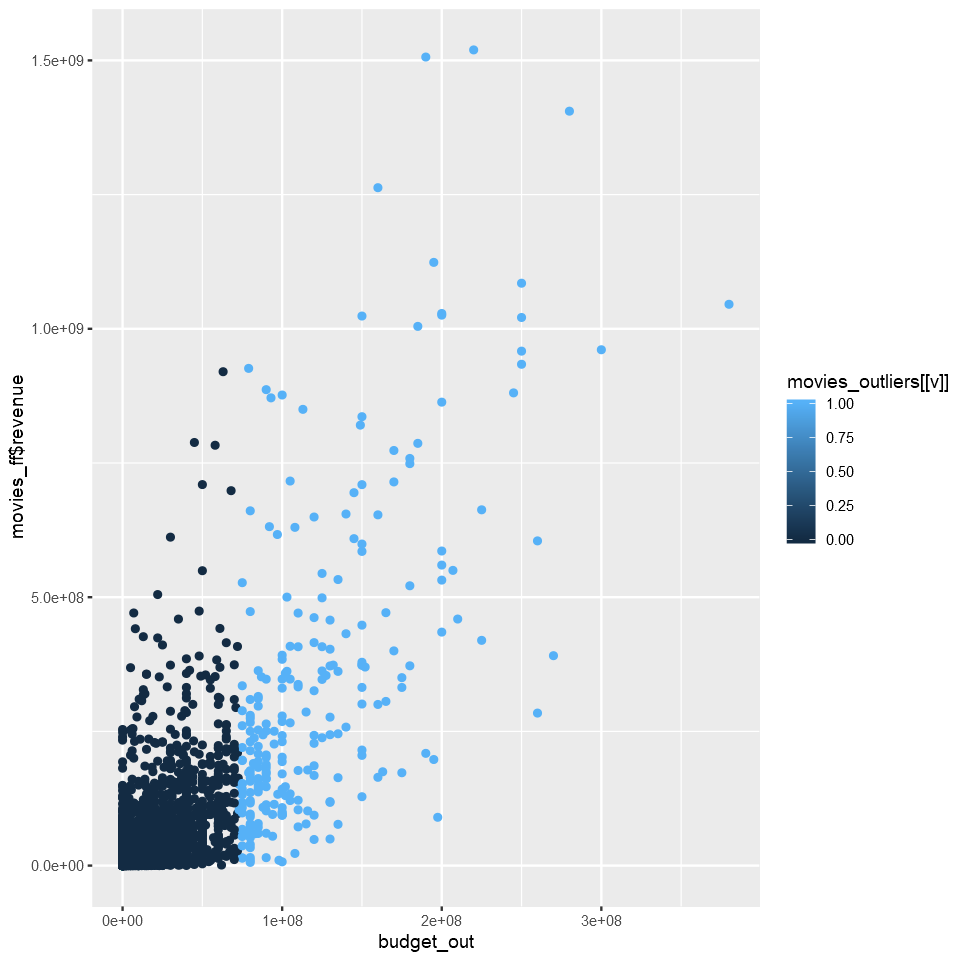

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


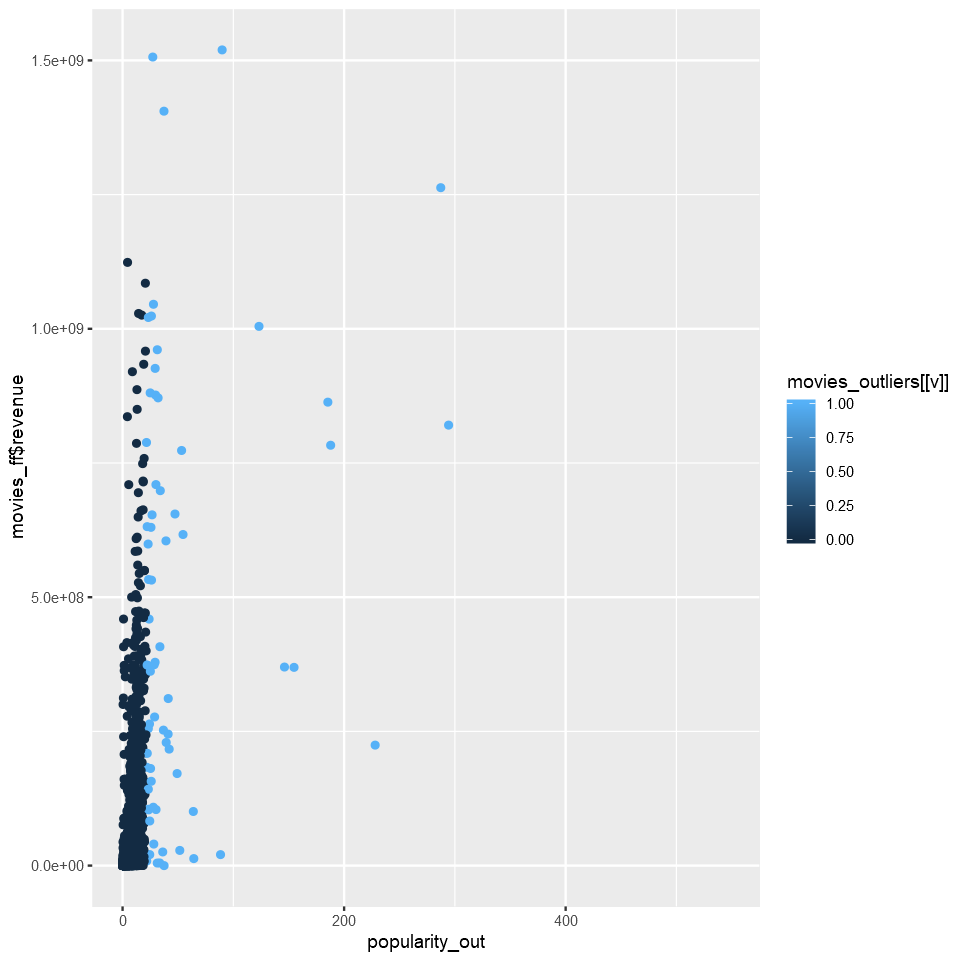

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


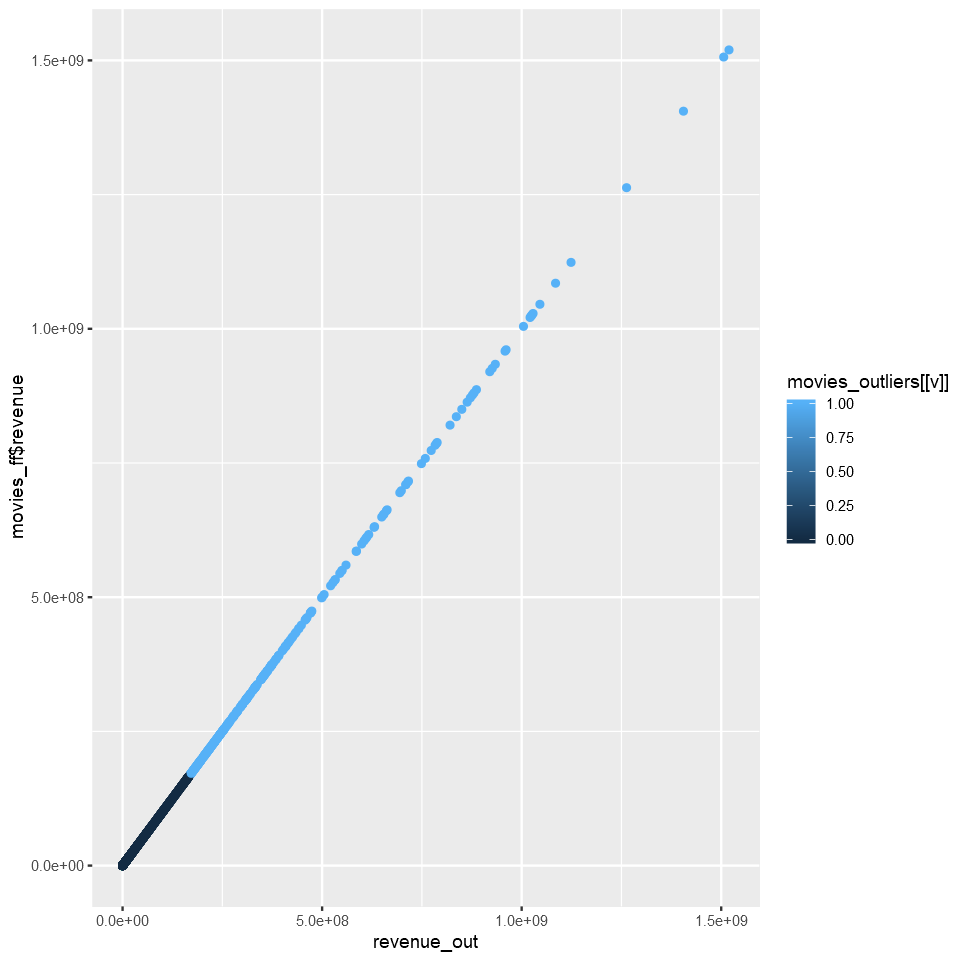

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


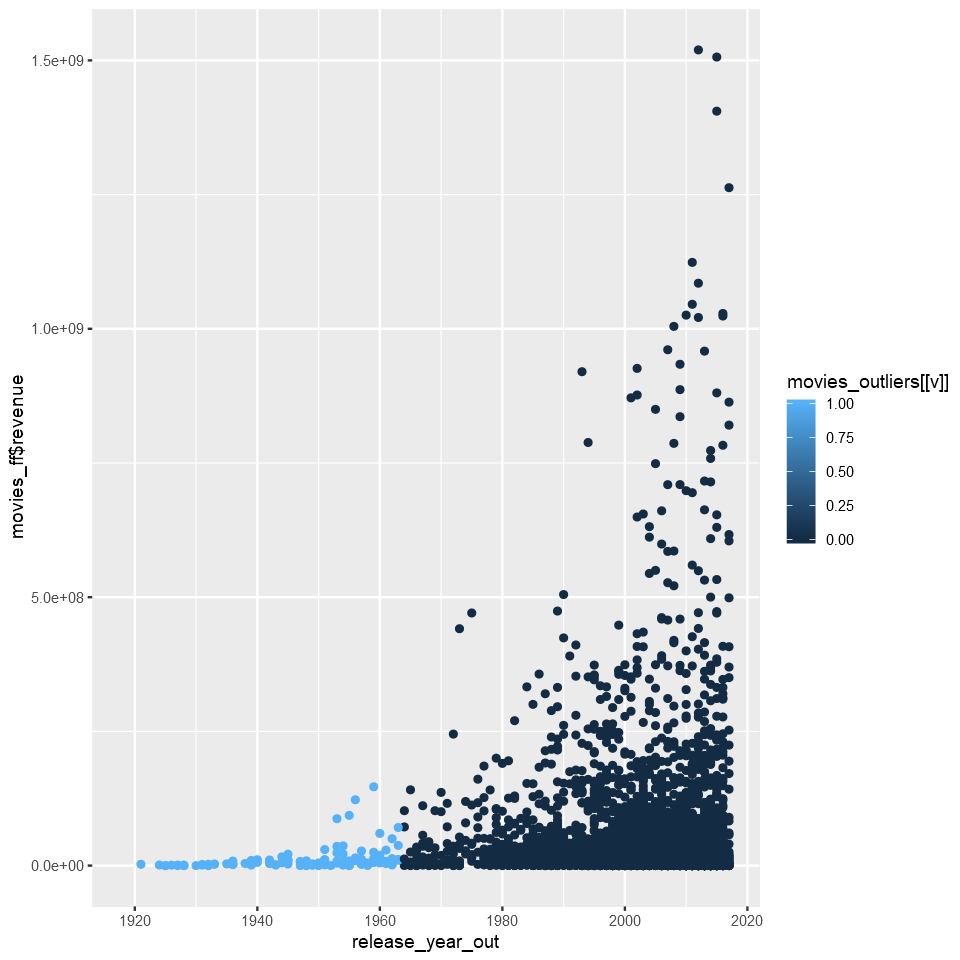

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


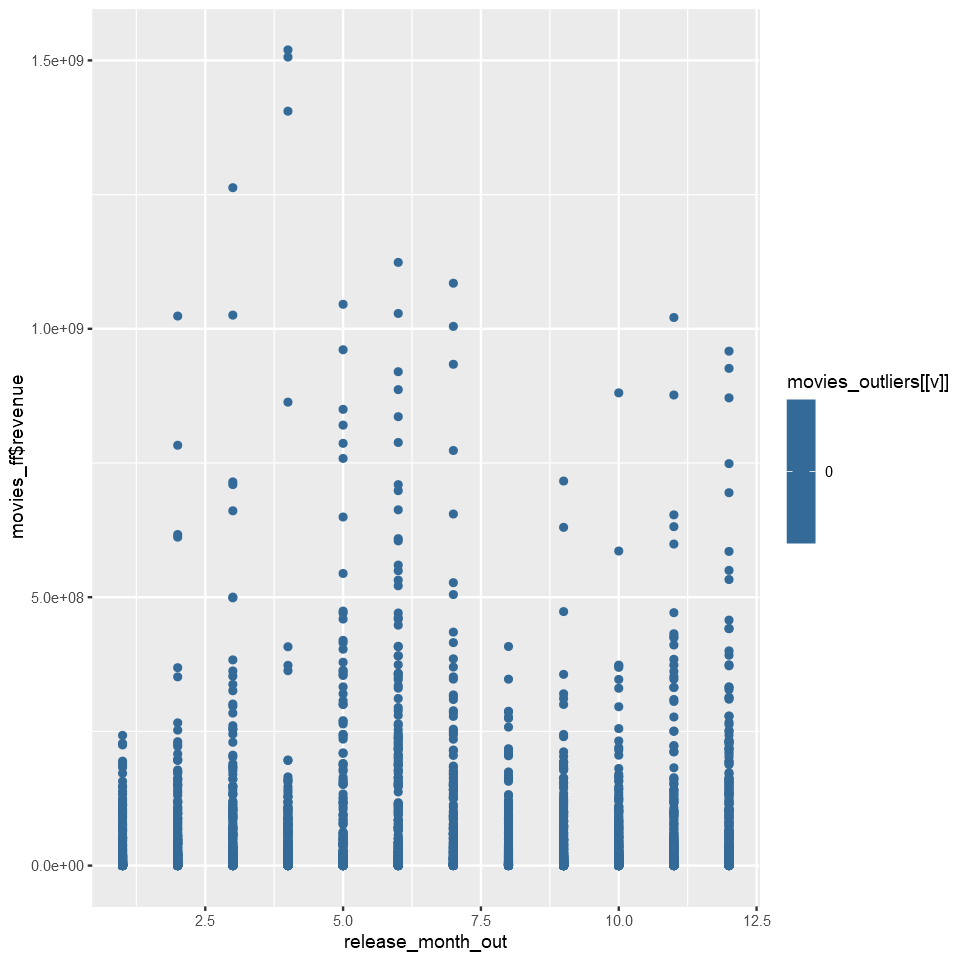

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


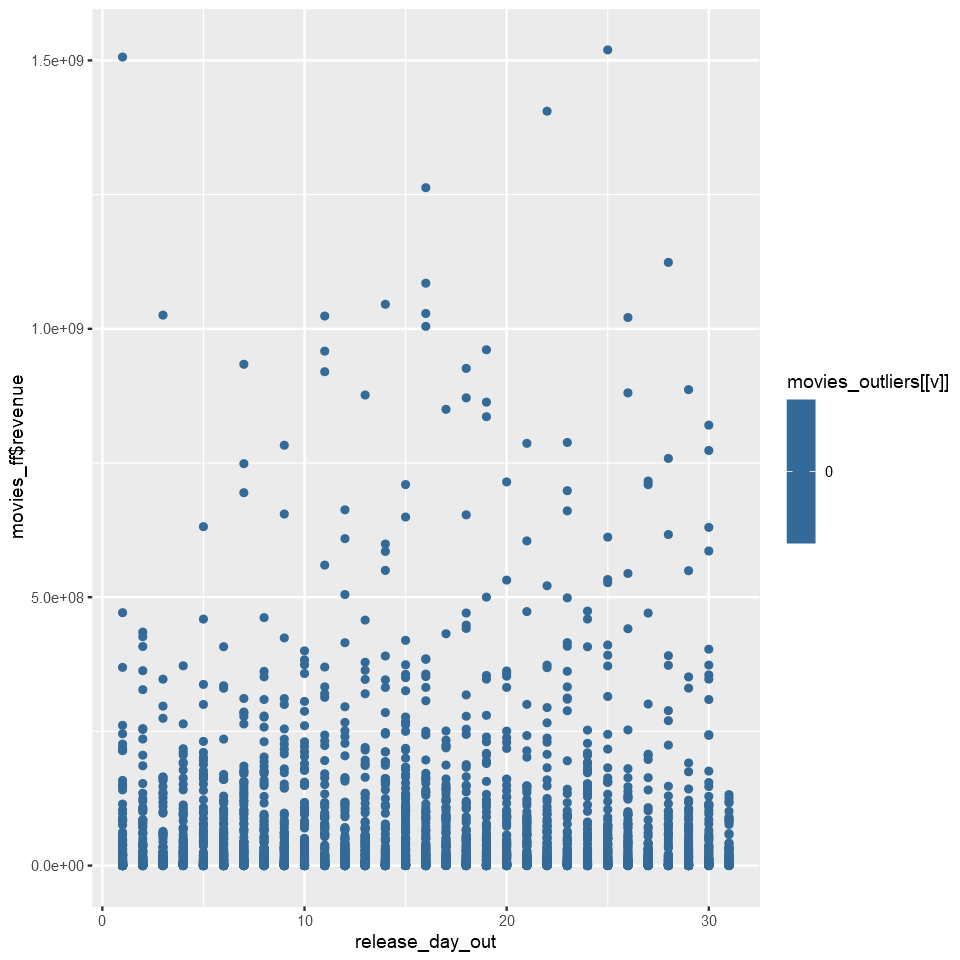

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


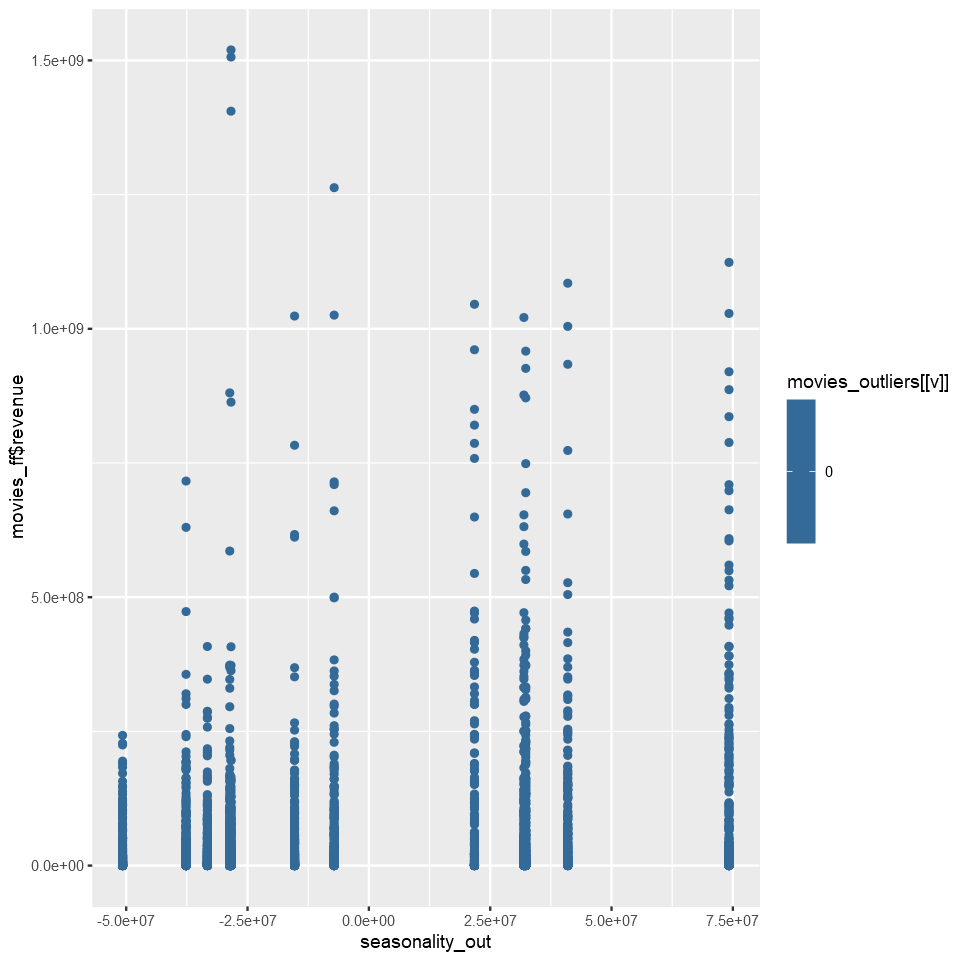

Warning message:
"Removed 4531 rows containing missing values (geom_point)."


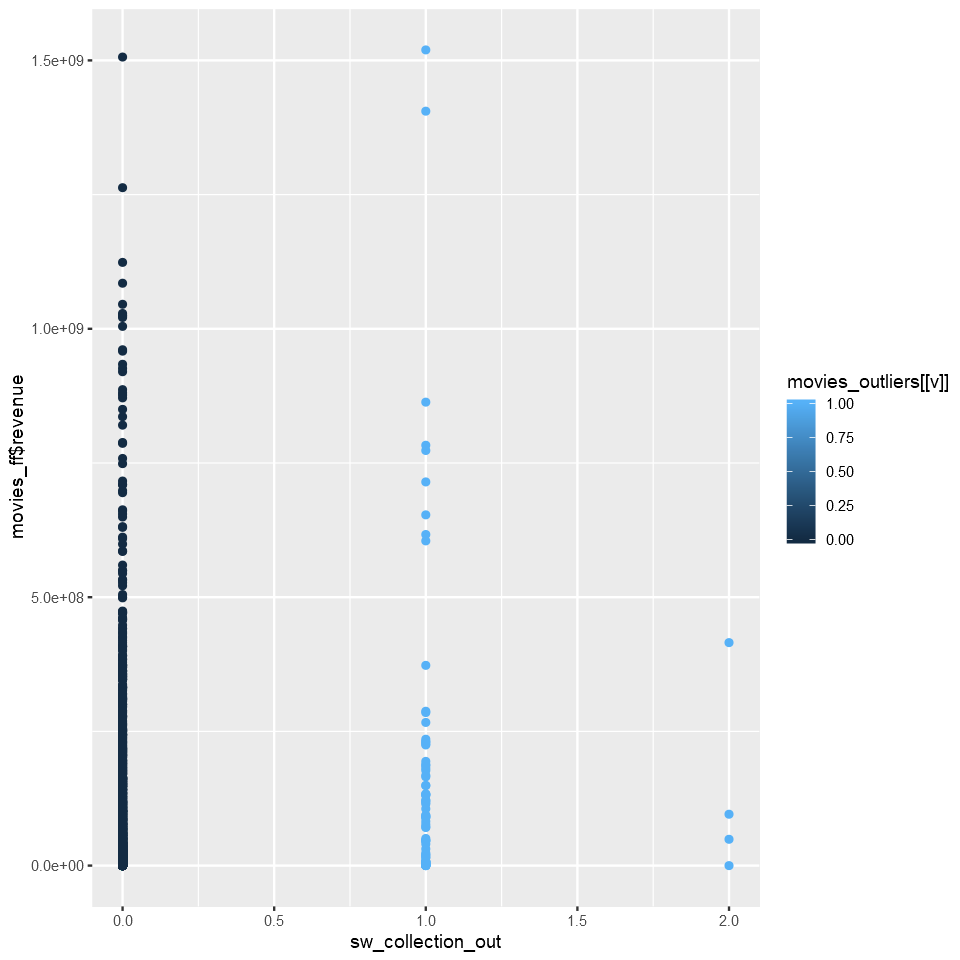

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


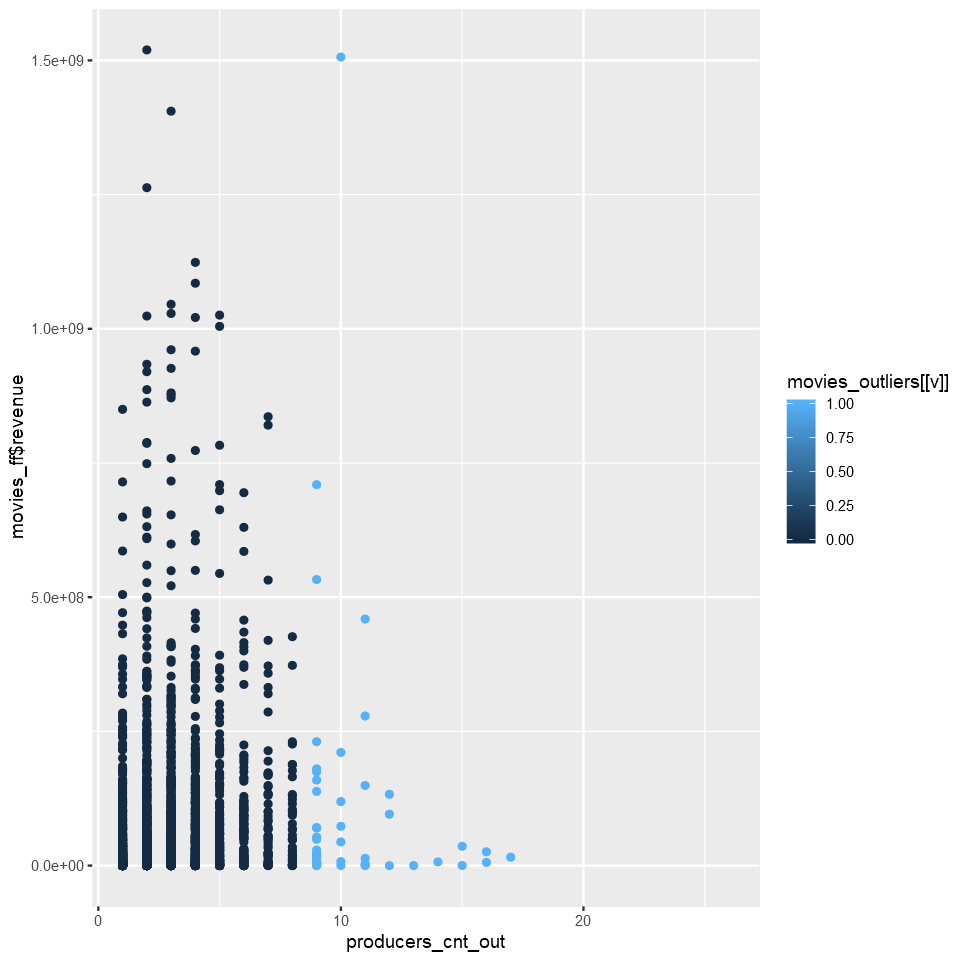

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


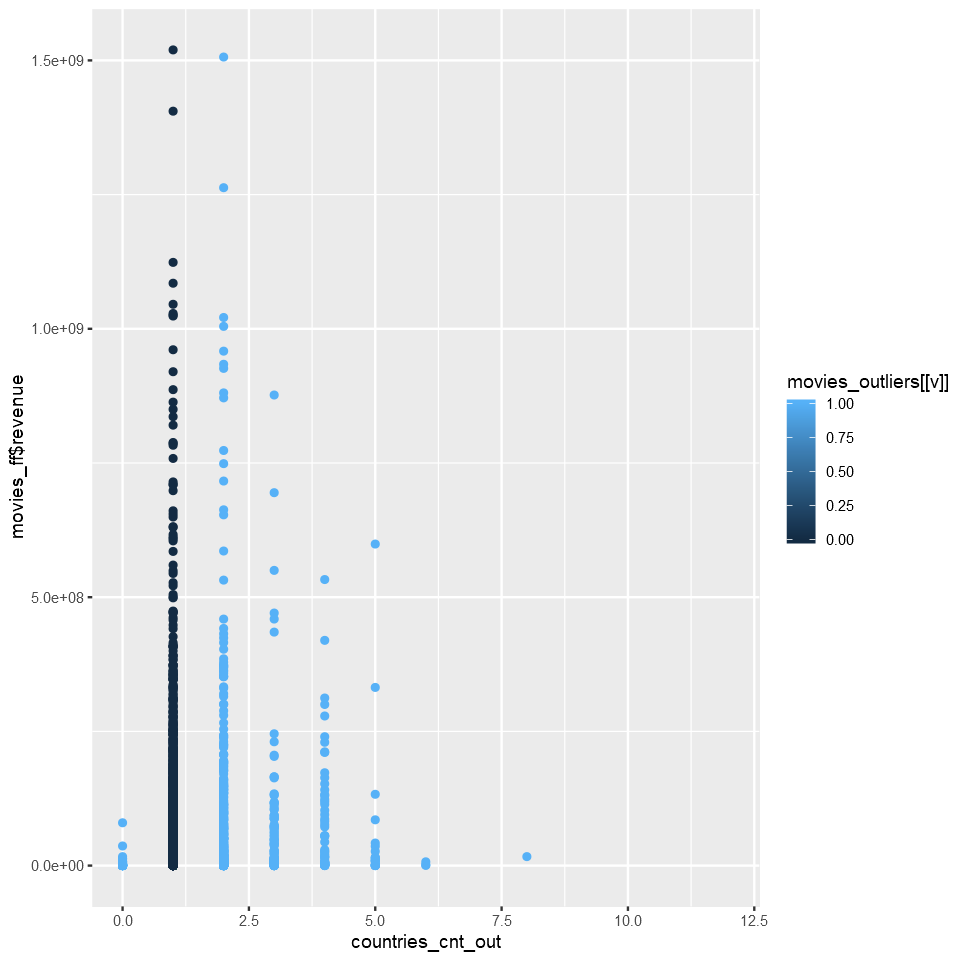

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


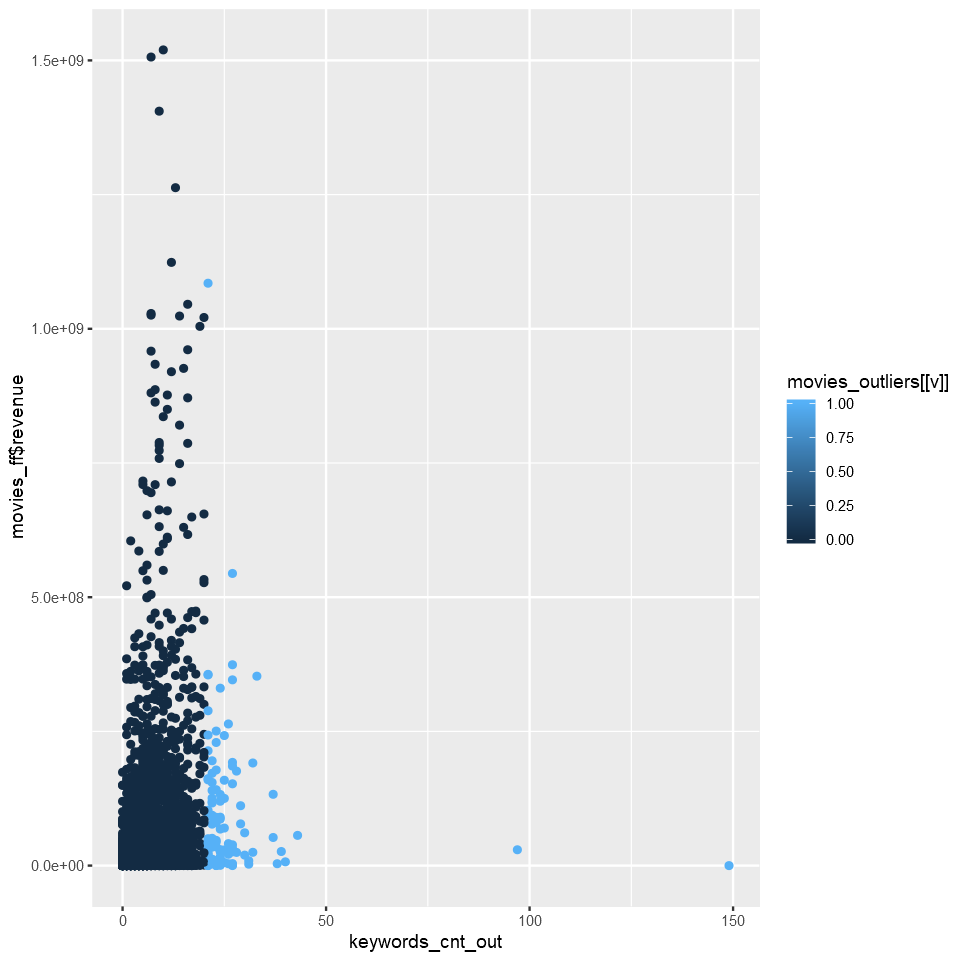

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


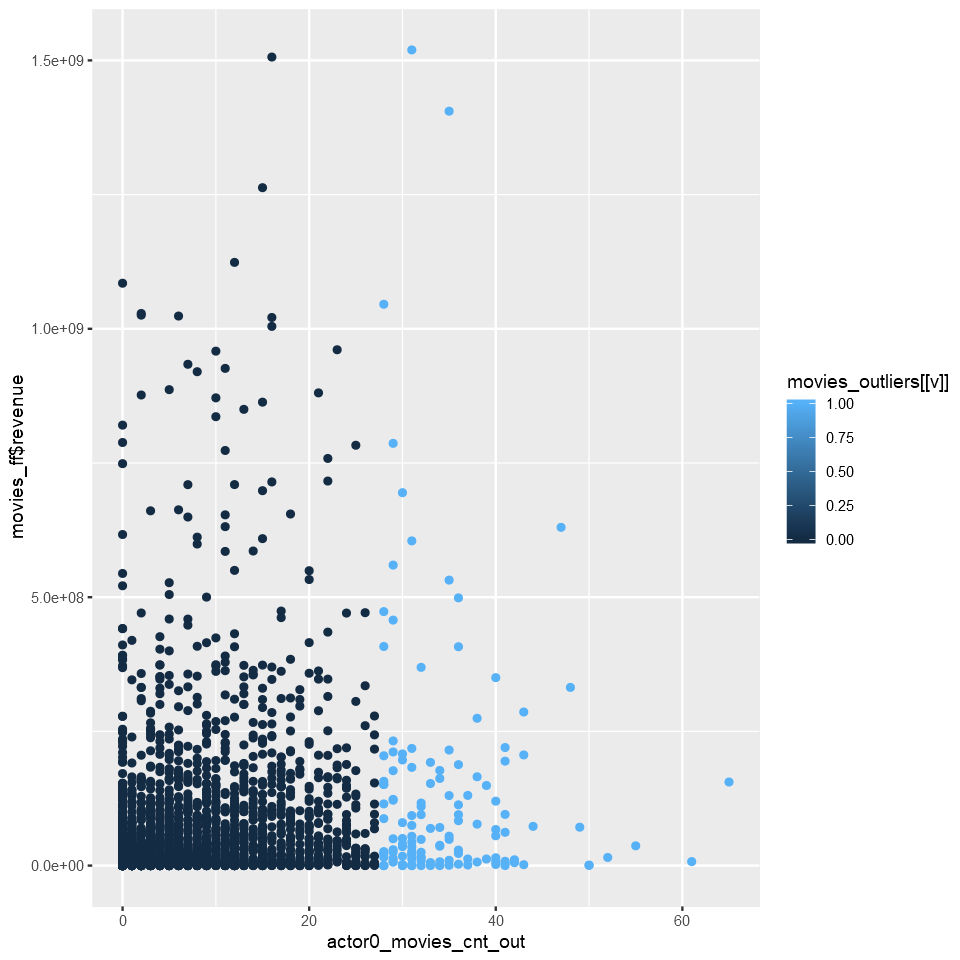

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


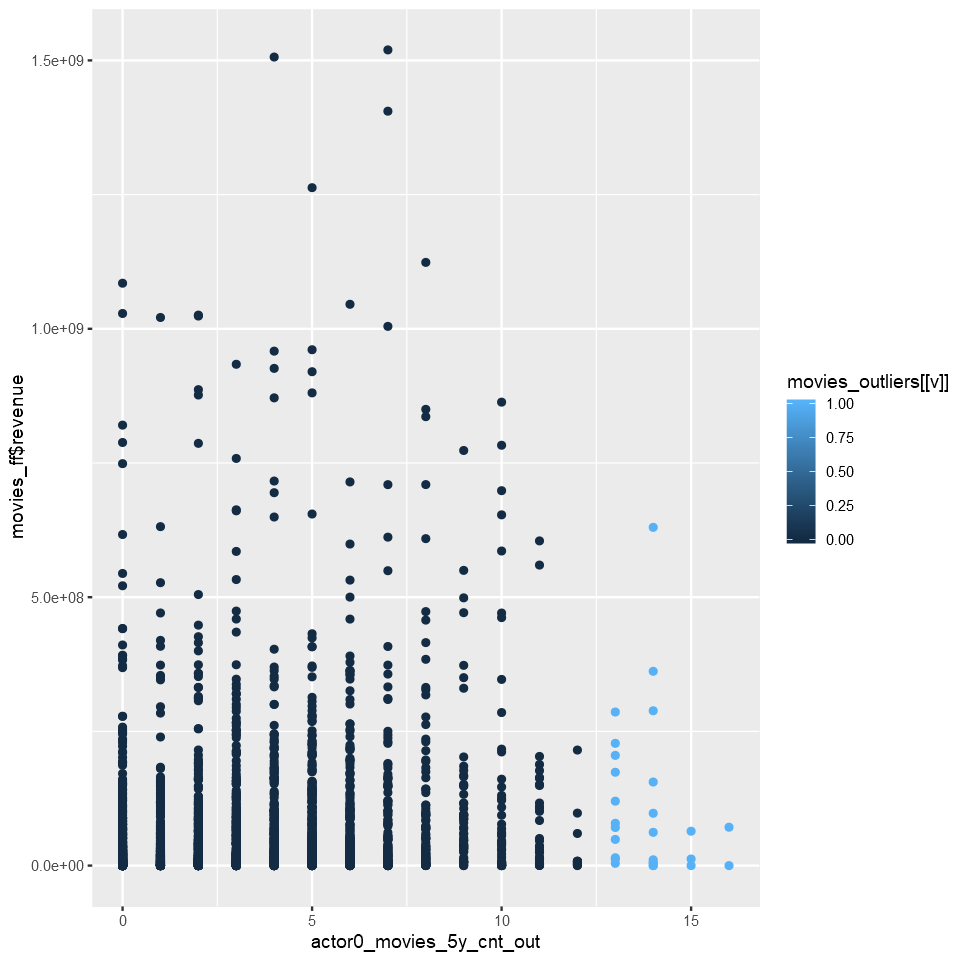

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


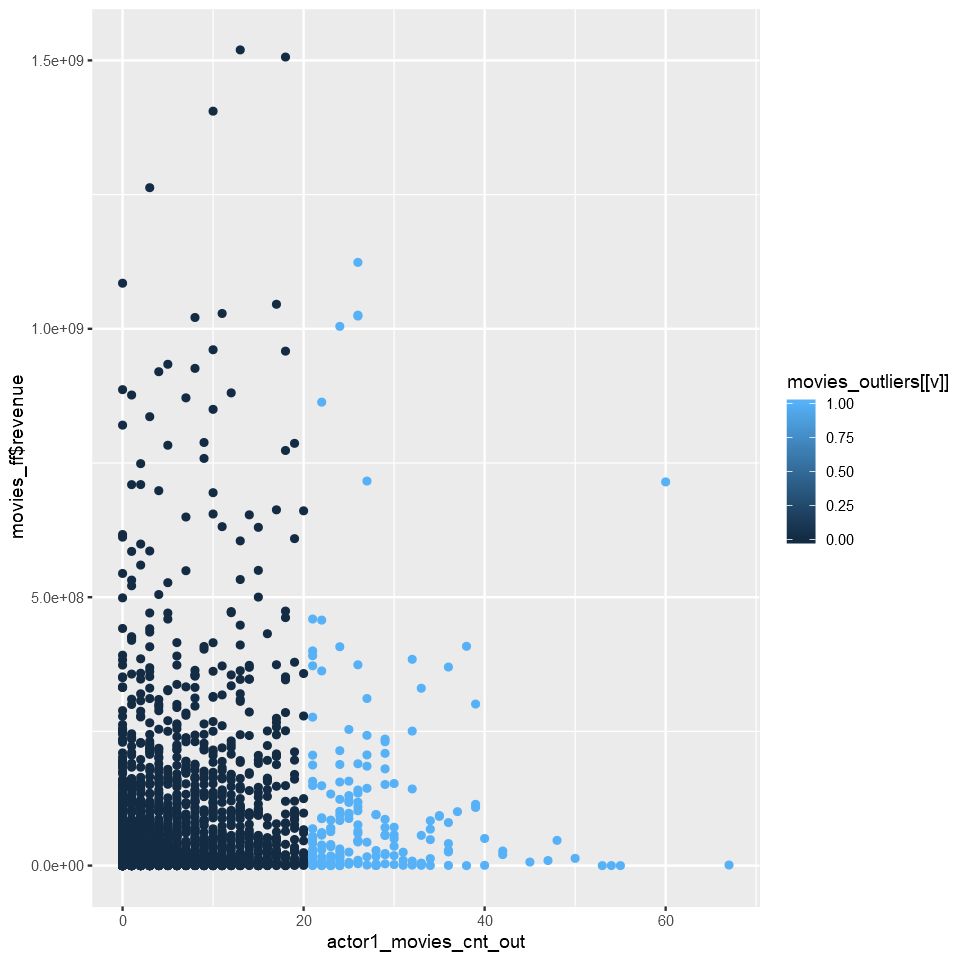

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


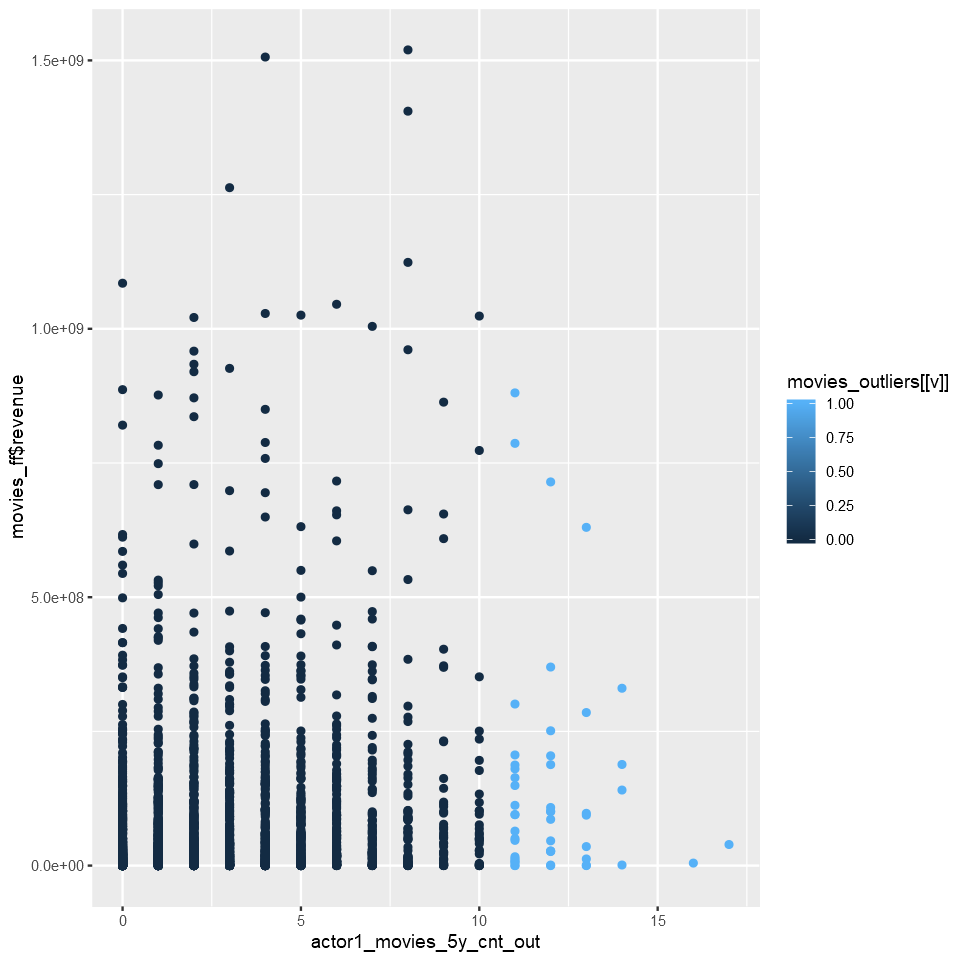

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


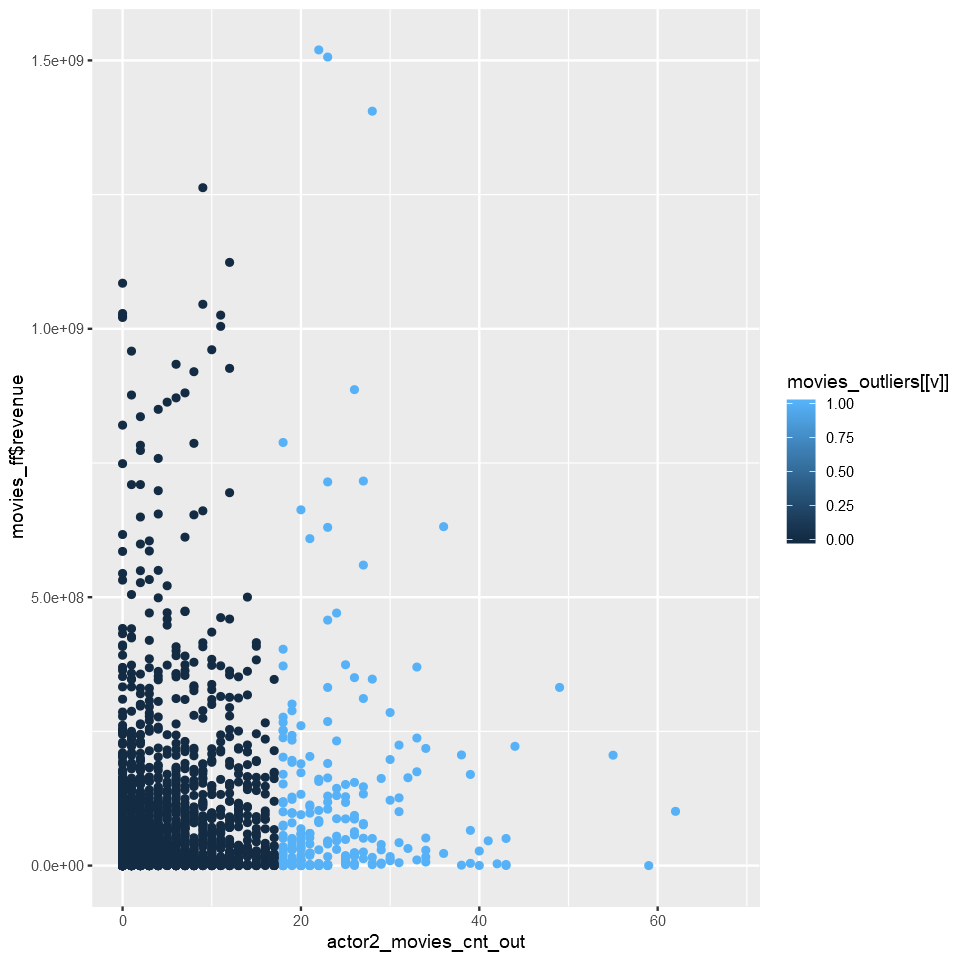

Warning message:
"Removed 5310 rows containing missing values (geom_point)."


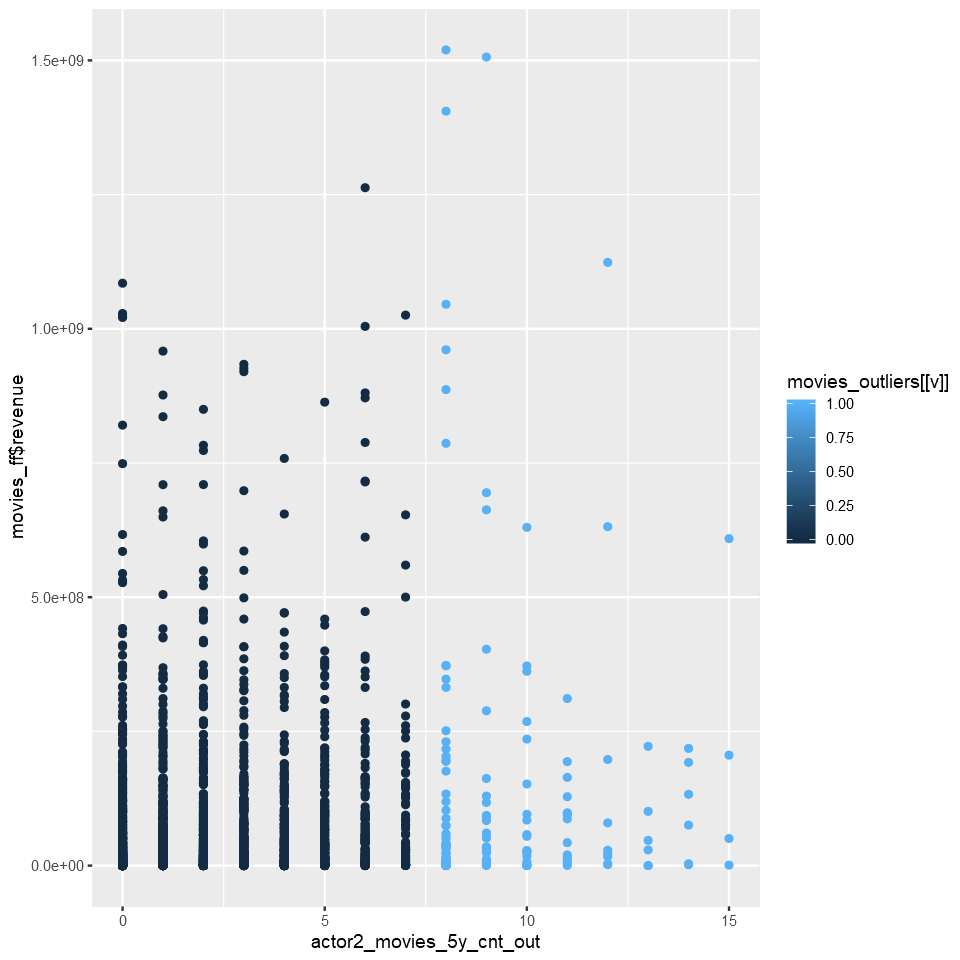

Warning message:
"Removed 5534 rows containing missing values (geom_point)."


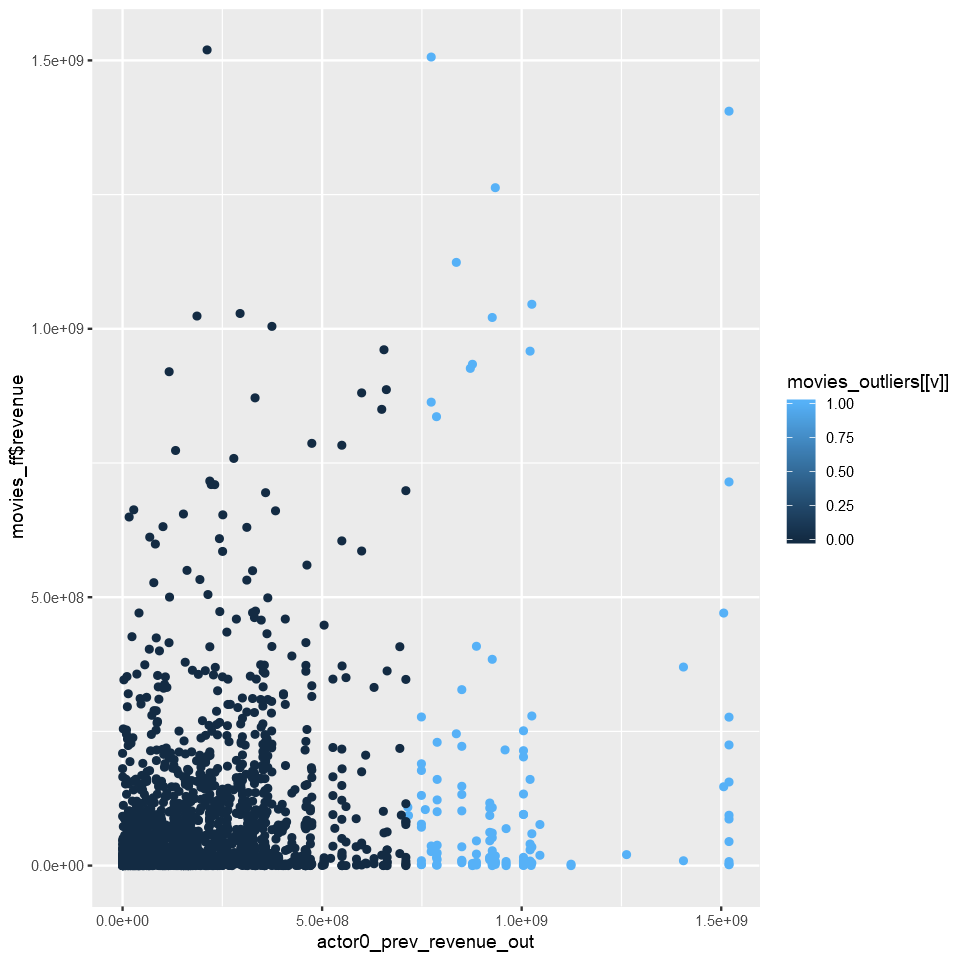

Warning message:
"Removed 5621 rows containing missing values (geom_point)."


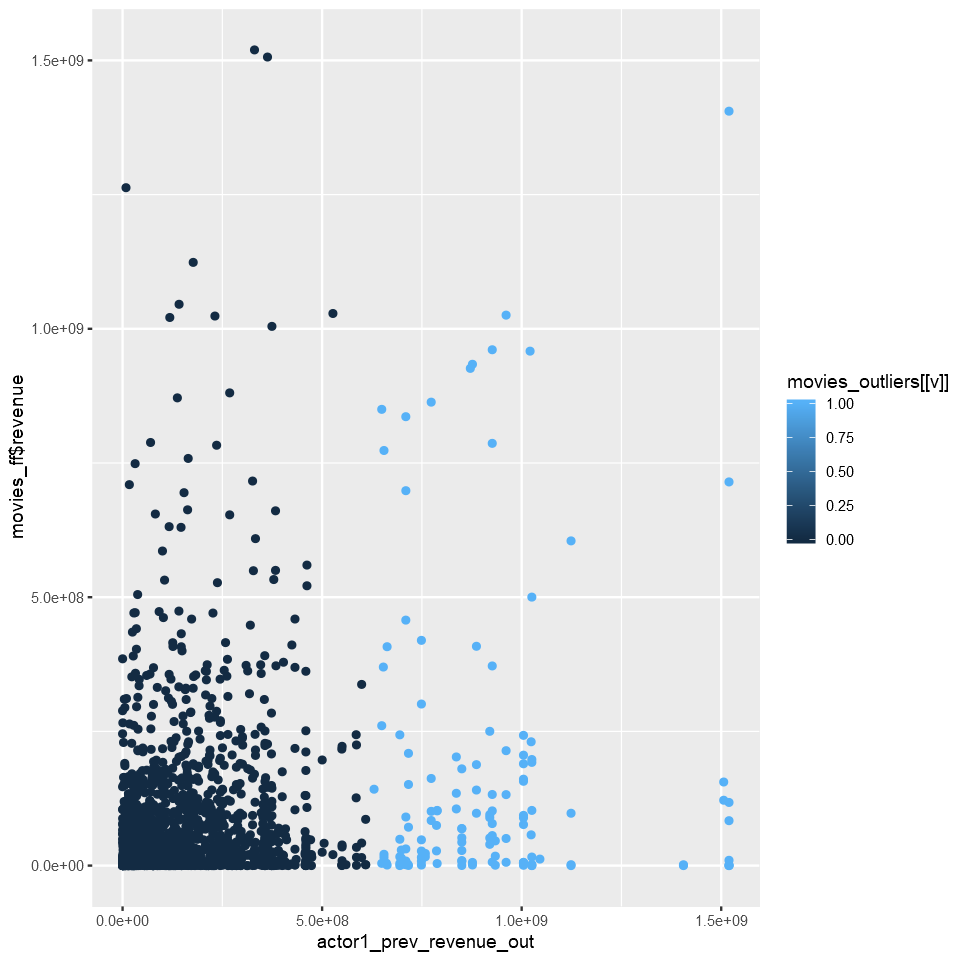

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


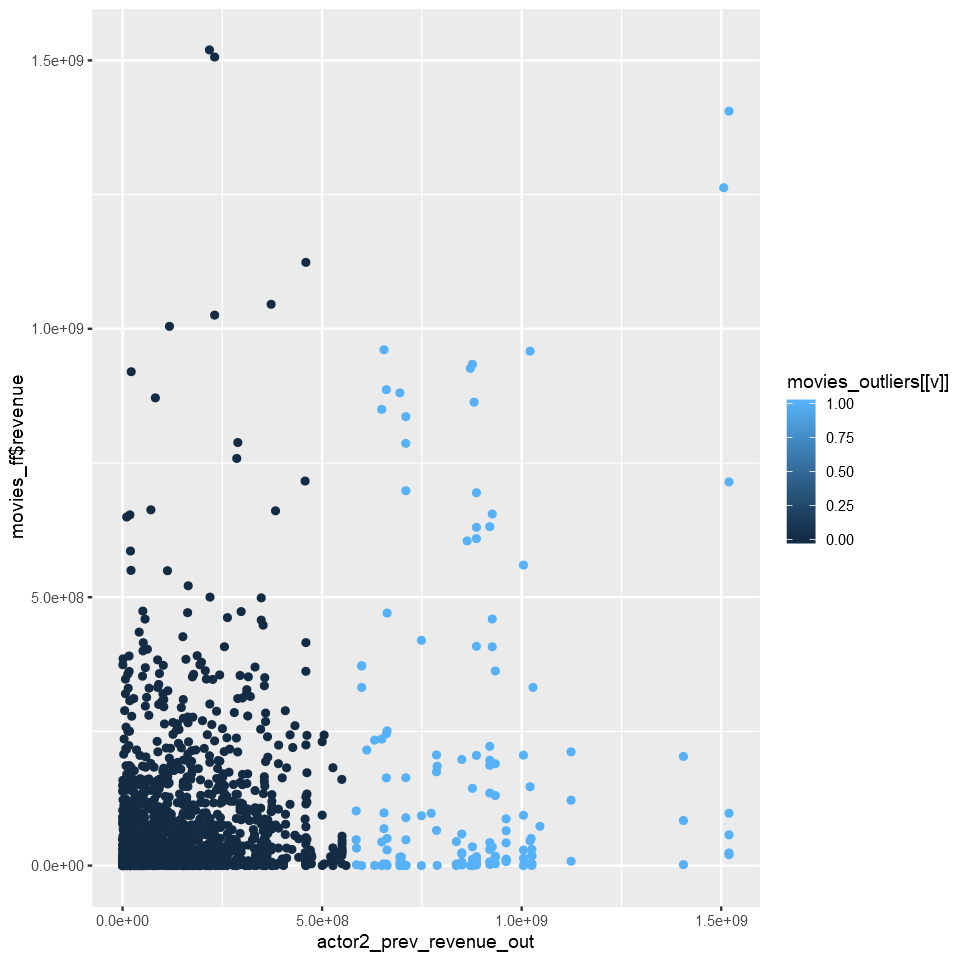

Warning message:
"Removed 4382 rows containing missing values (geom_point)."


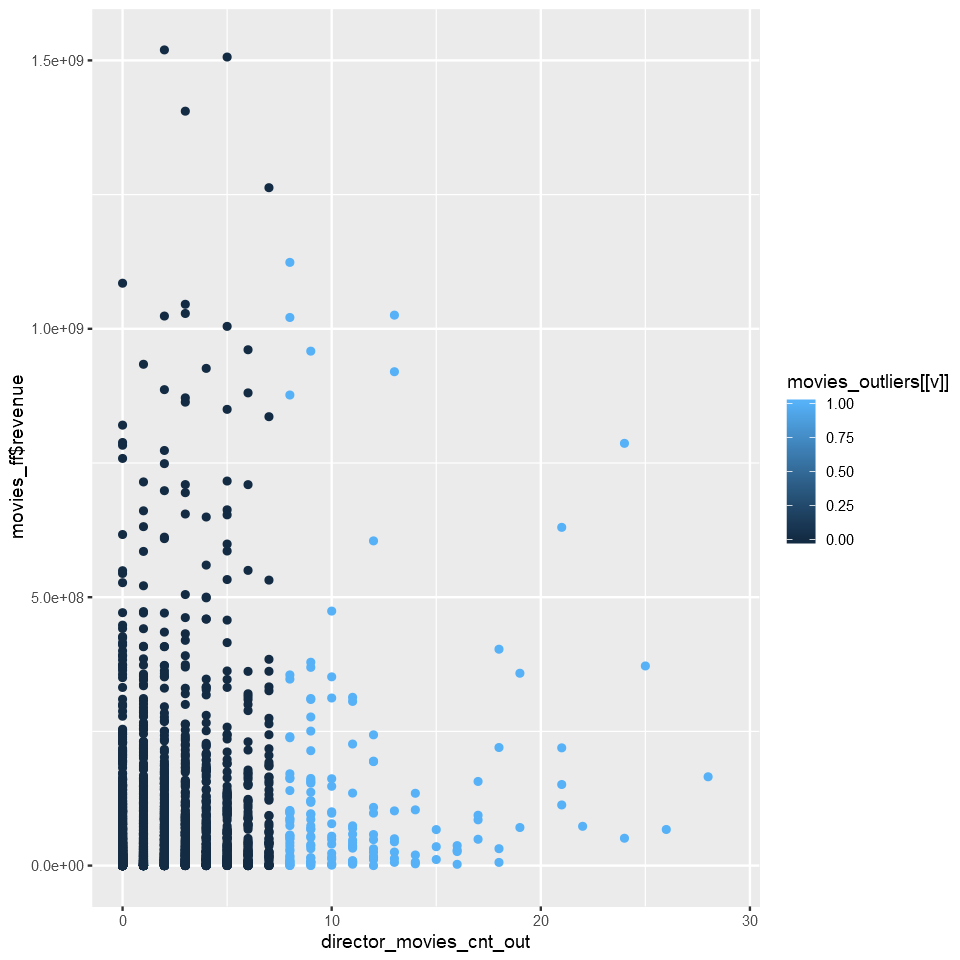

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


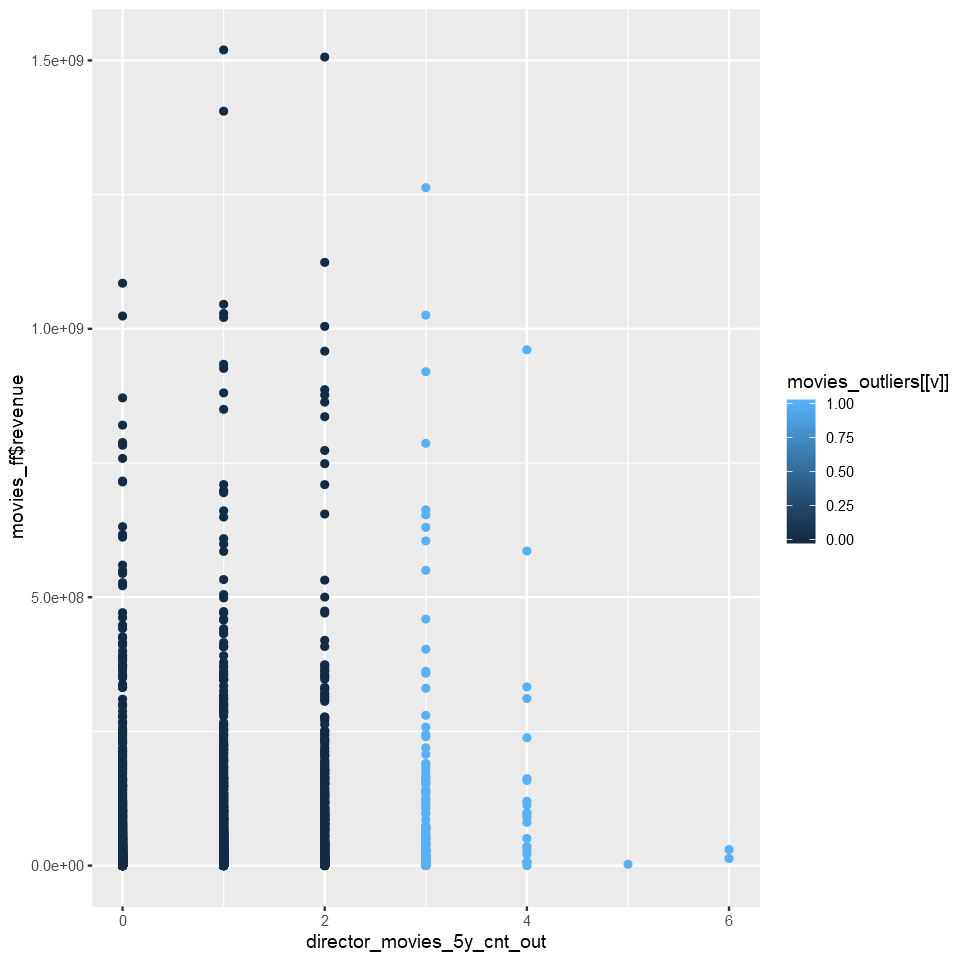

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


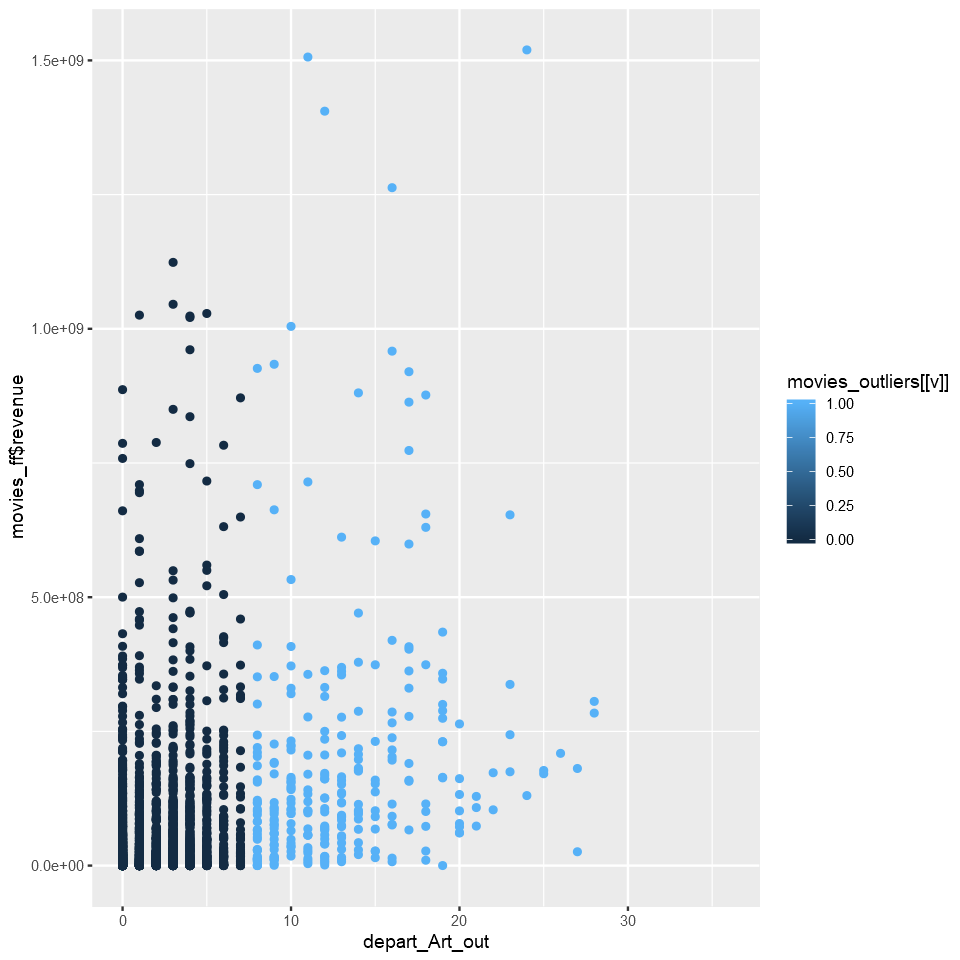

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


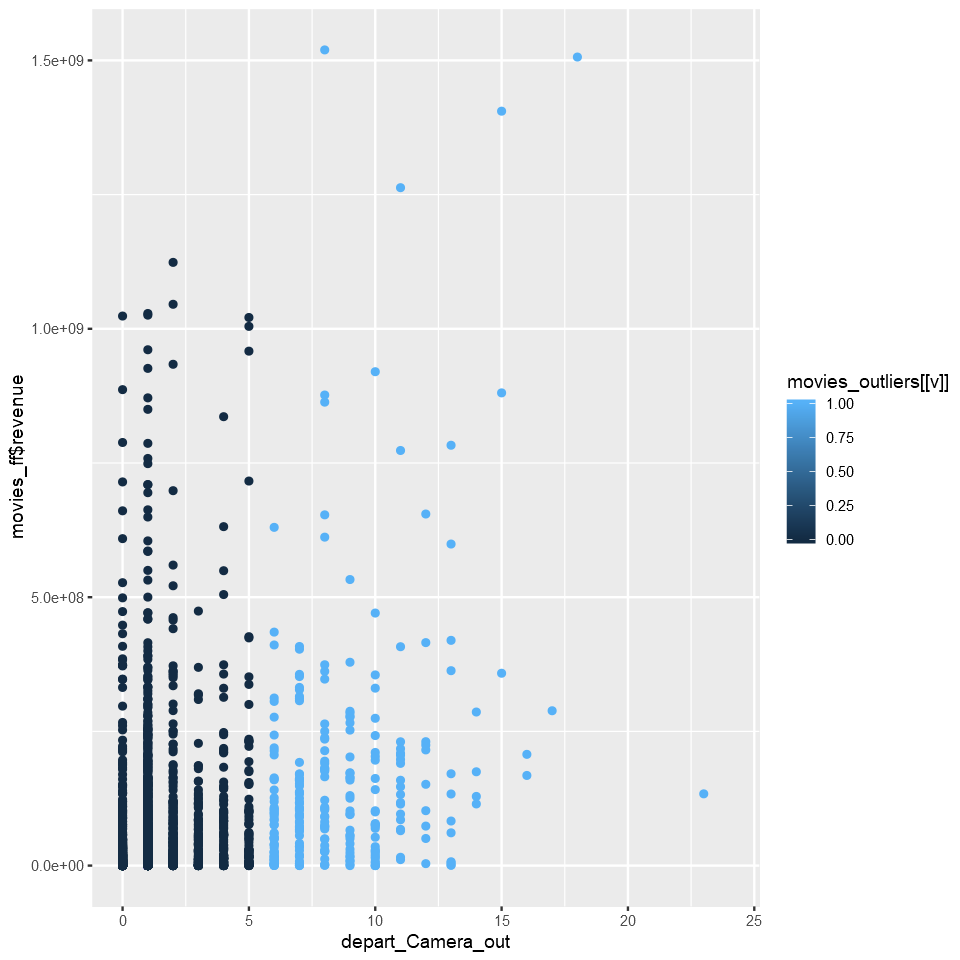

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


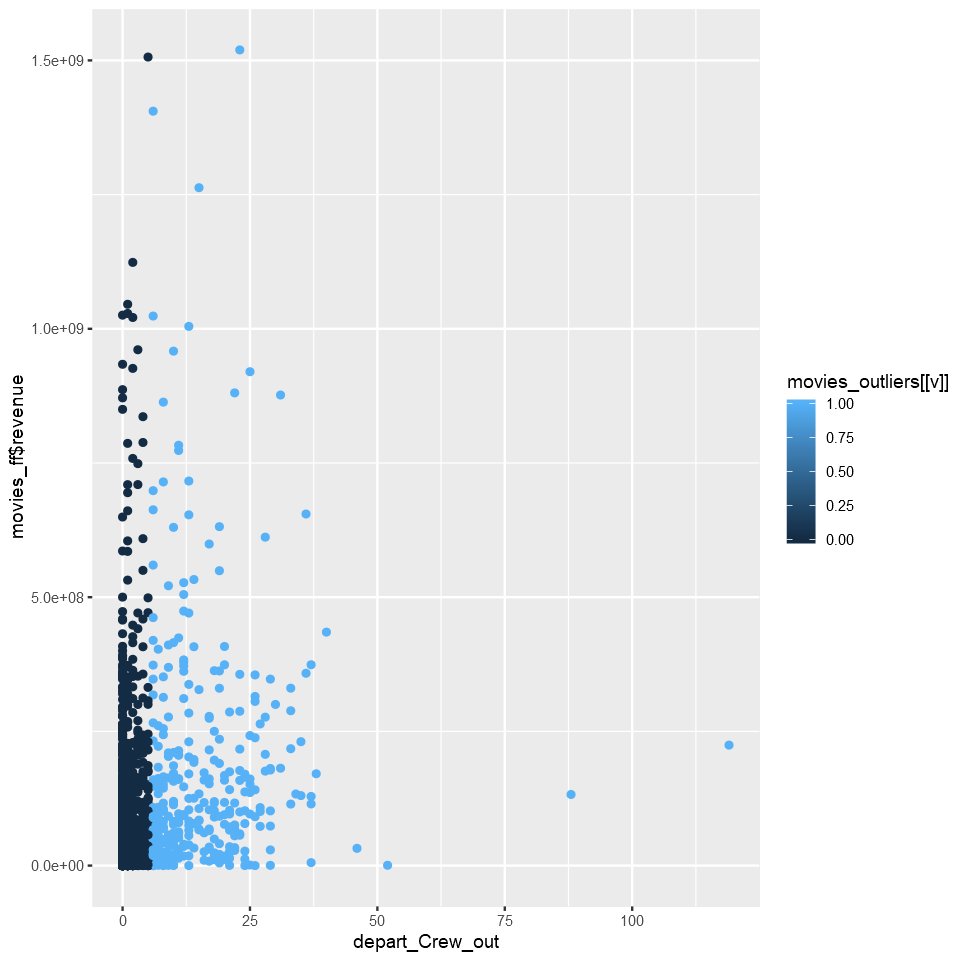

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


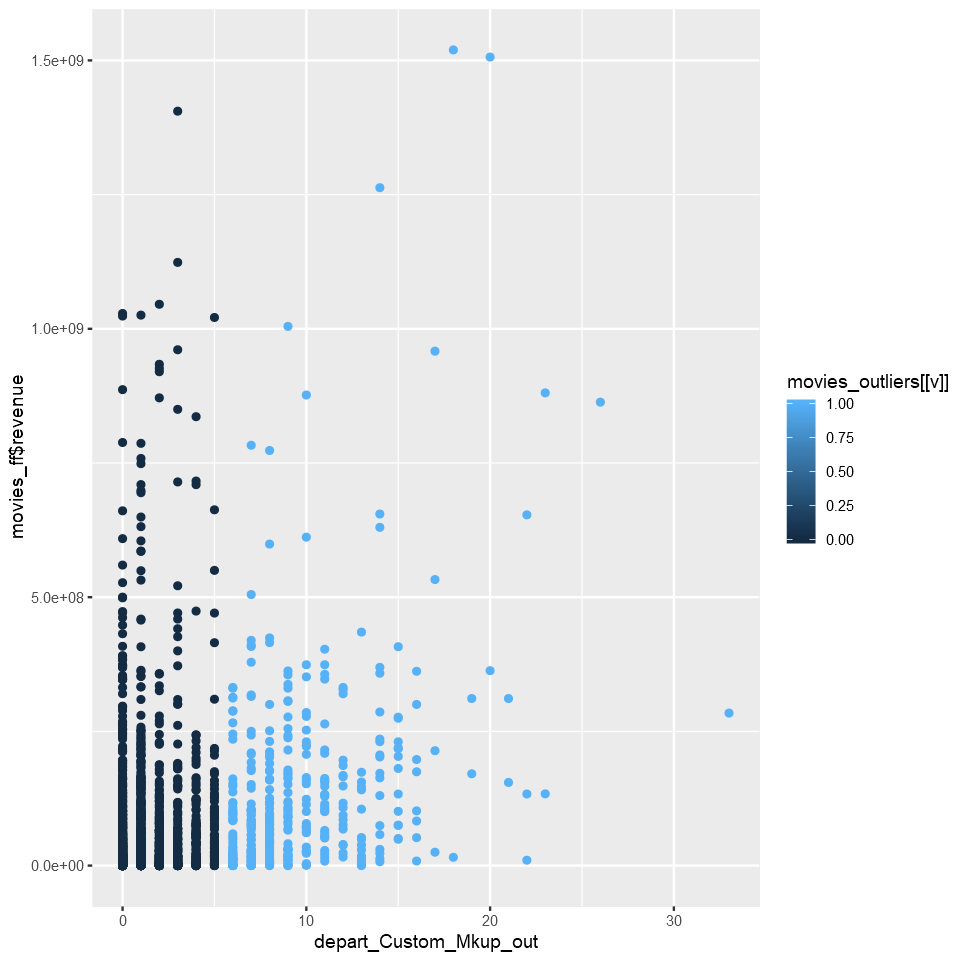

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


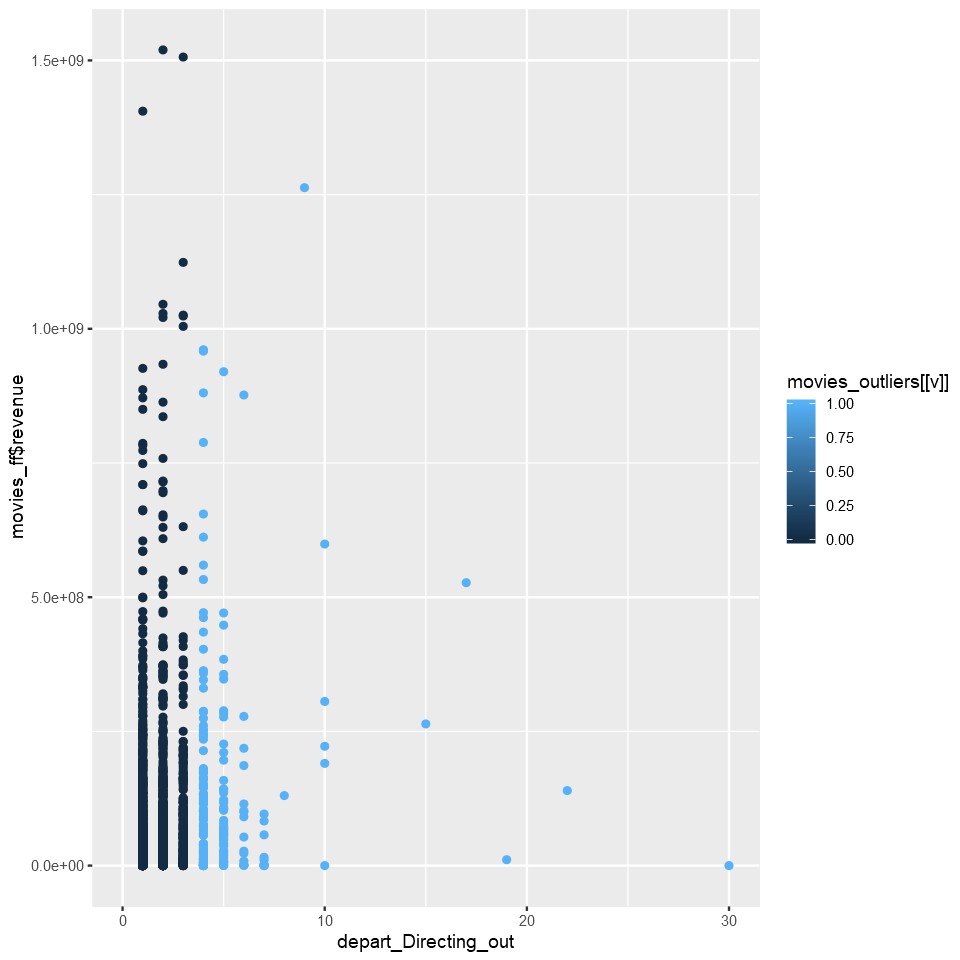

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


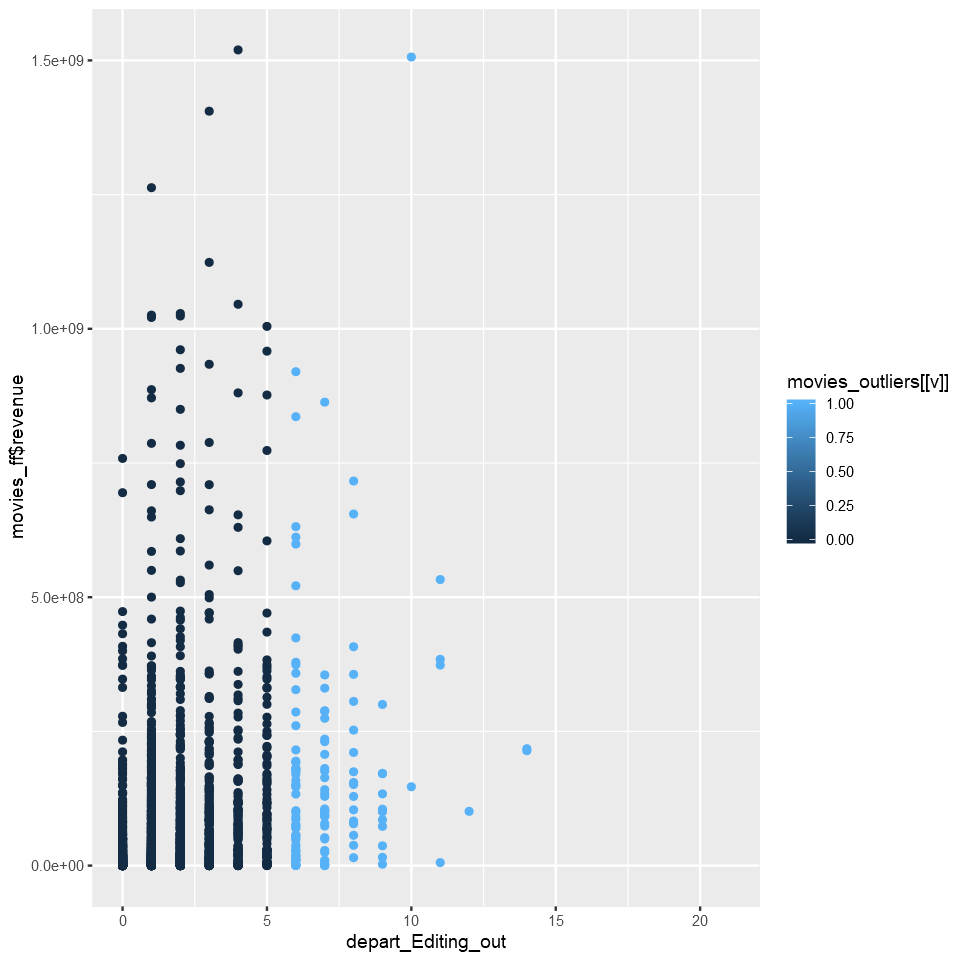

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


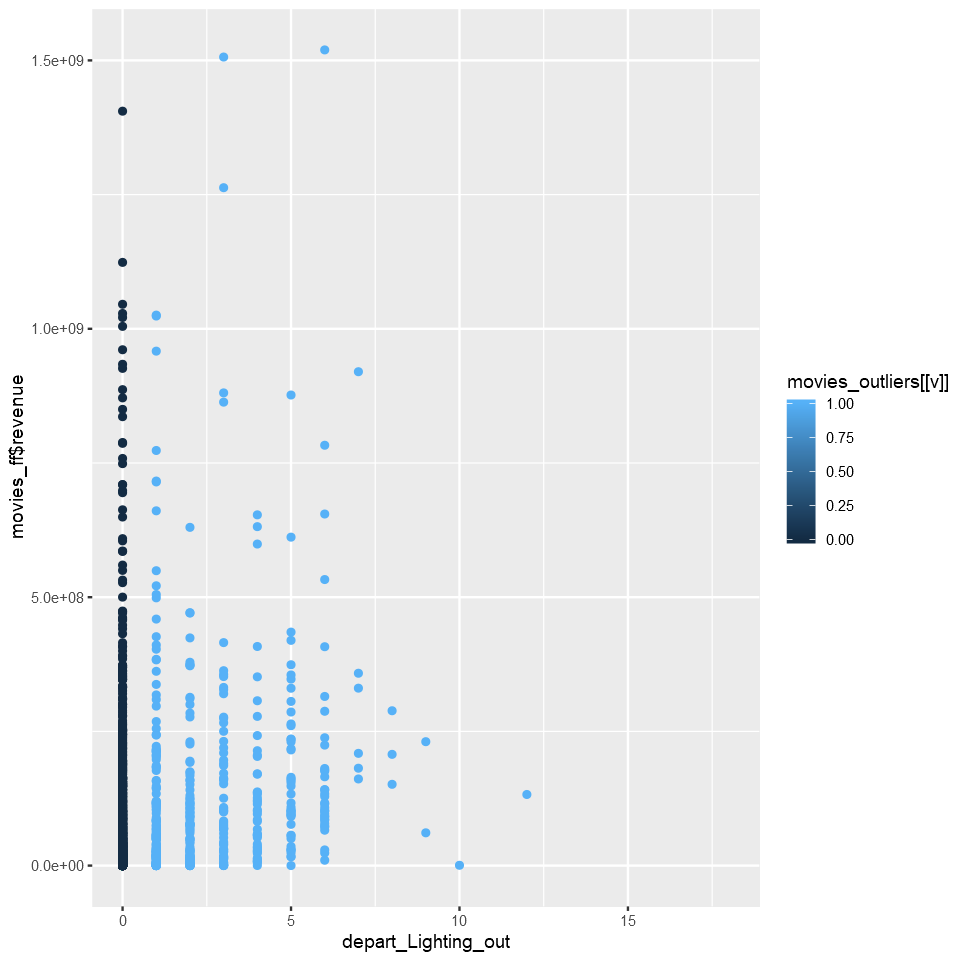

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


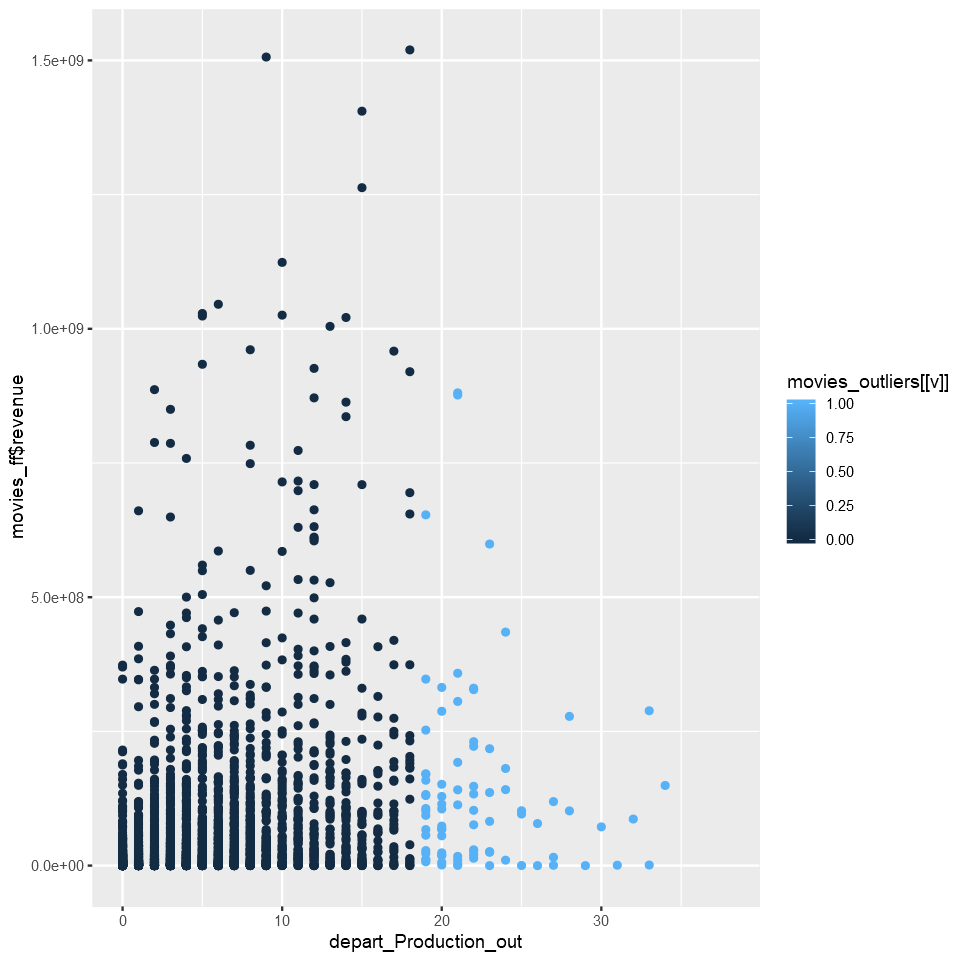

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


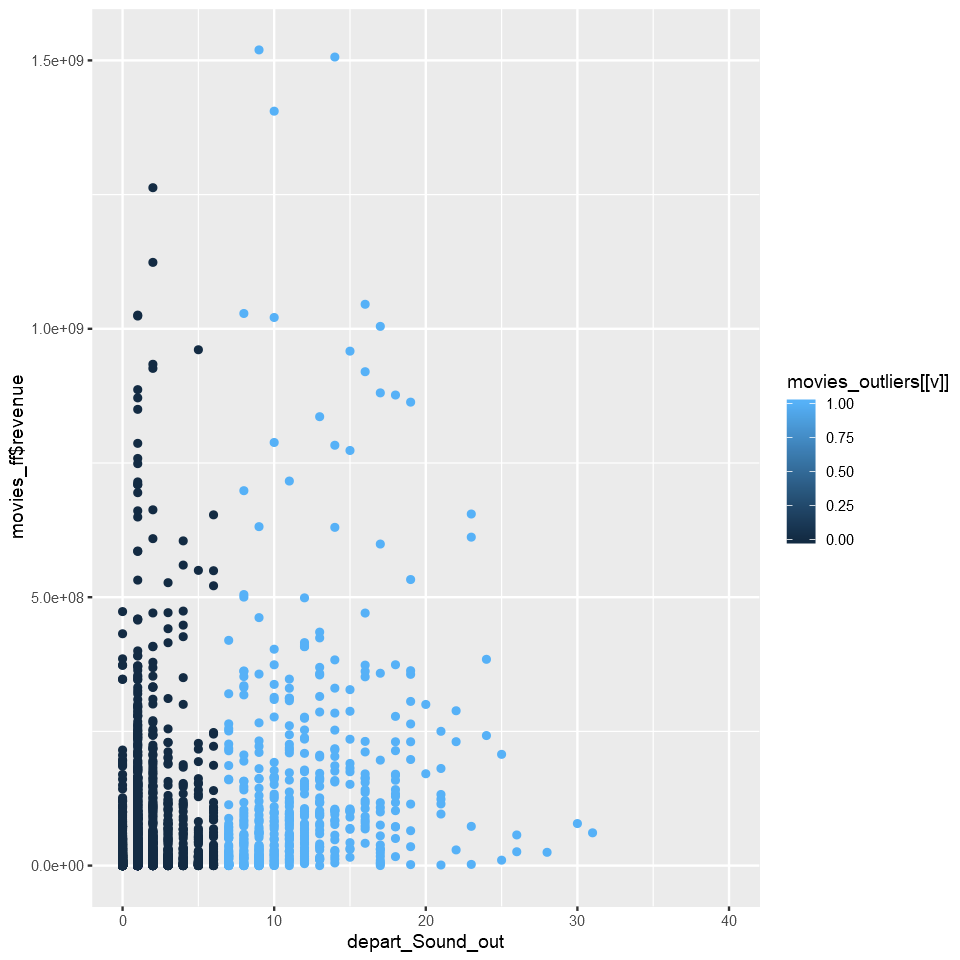

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


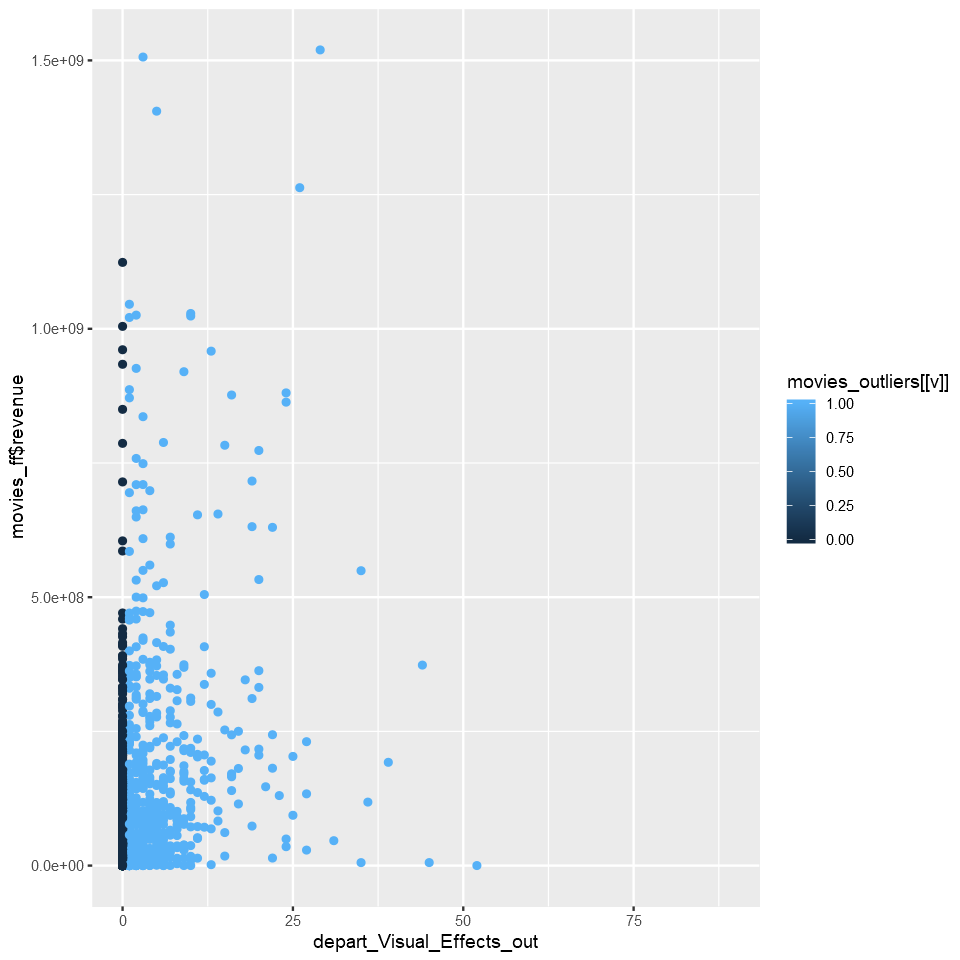

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


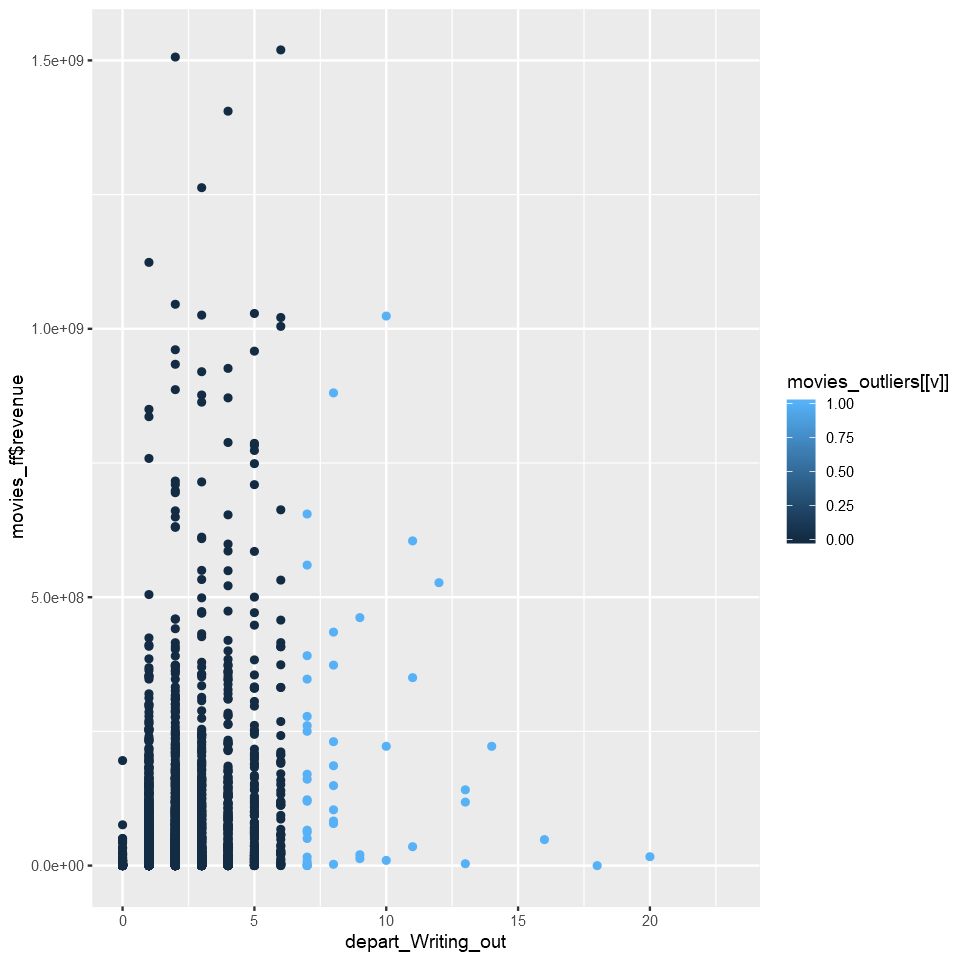

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


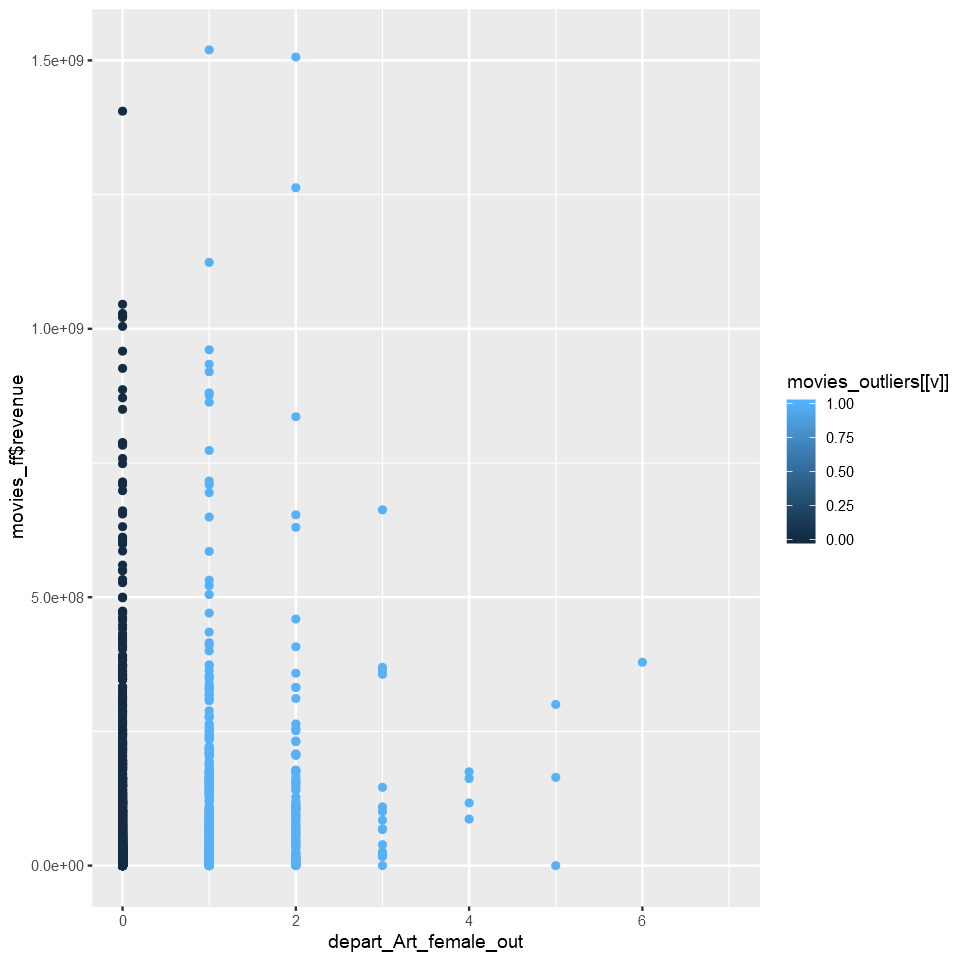

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


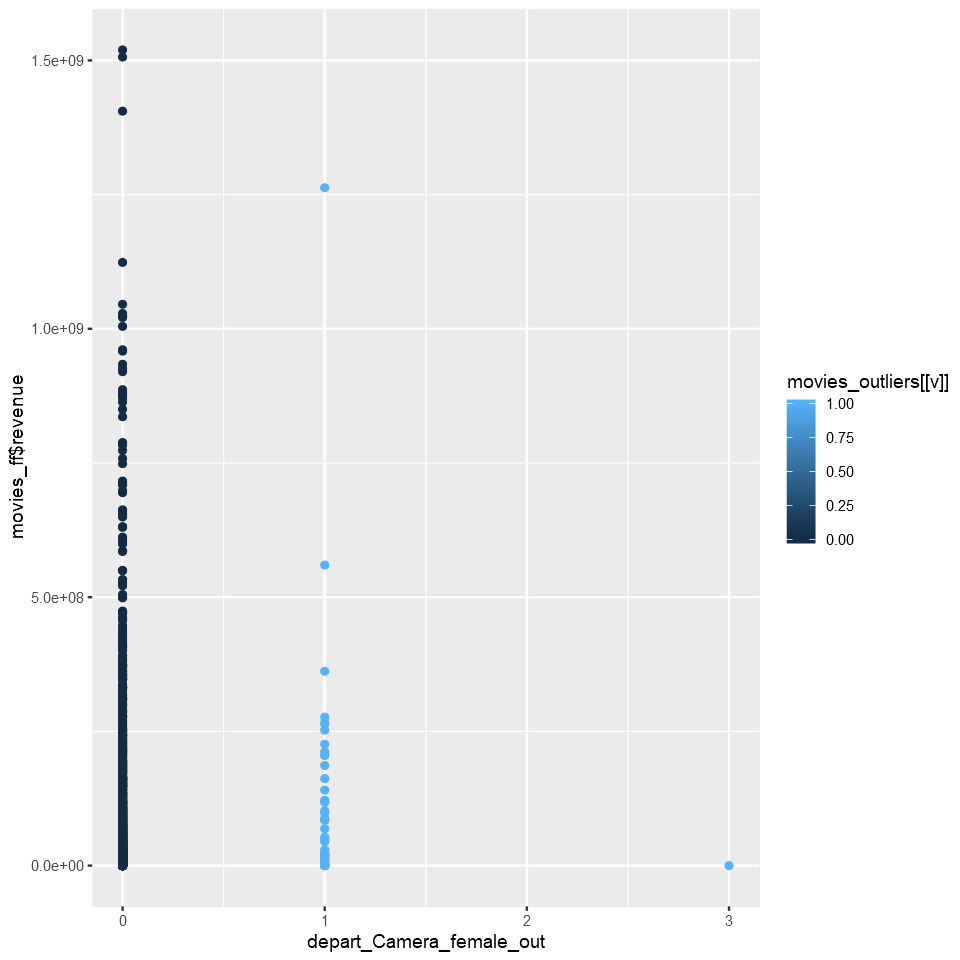

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


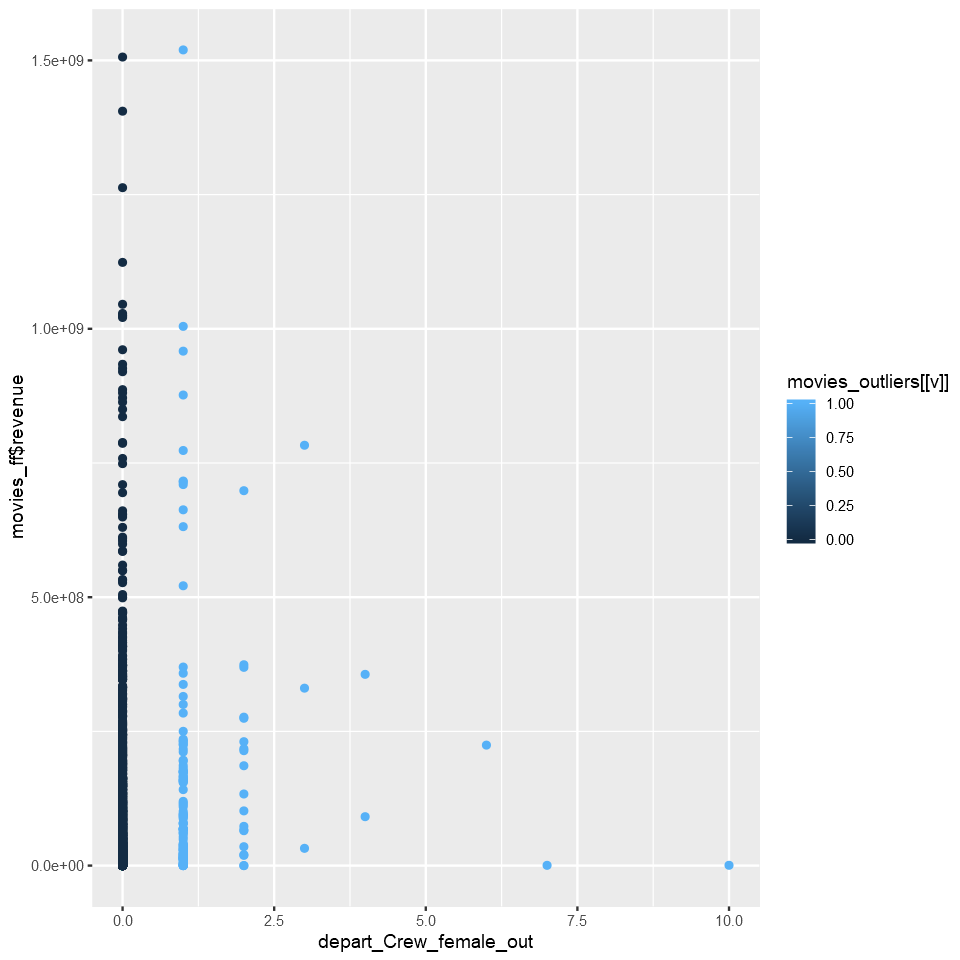

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


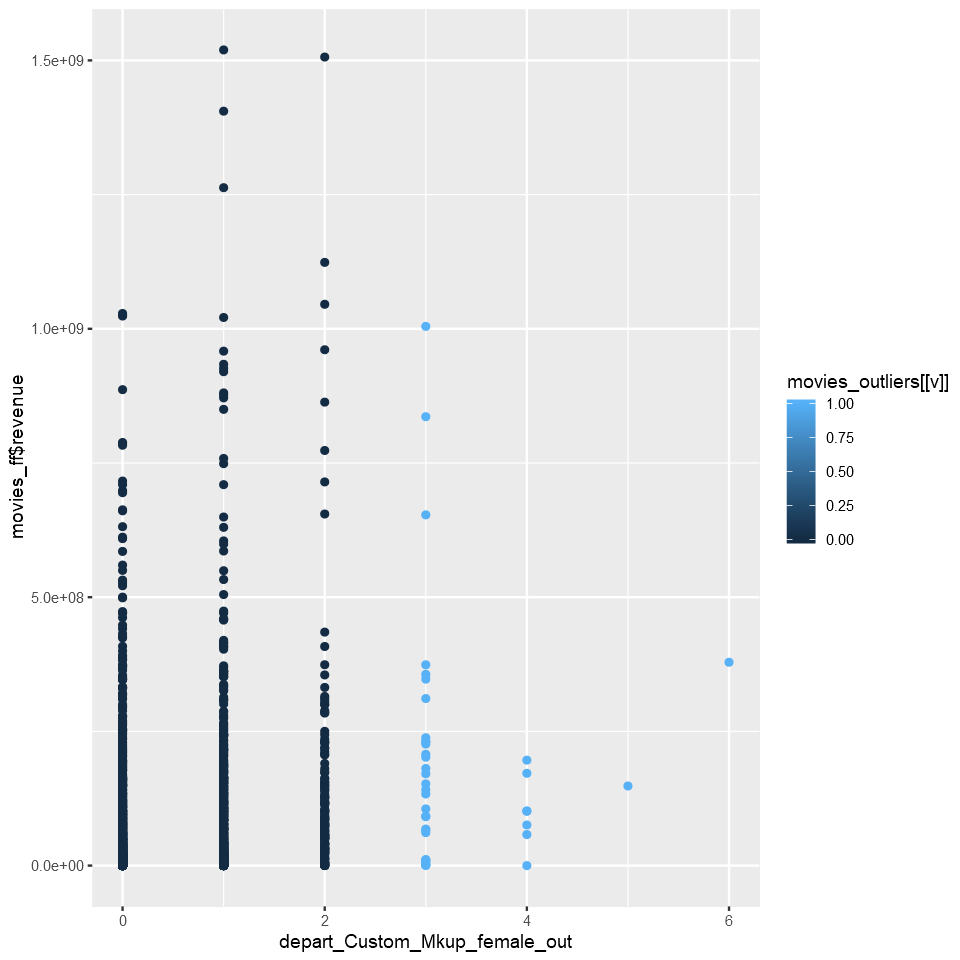

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


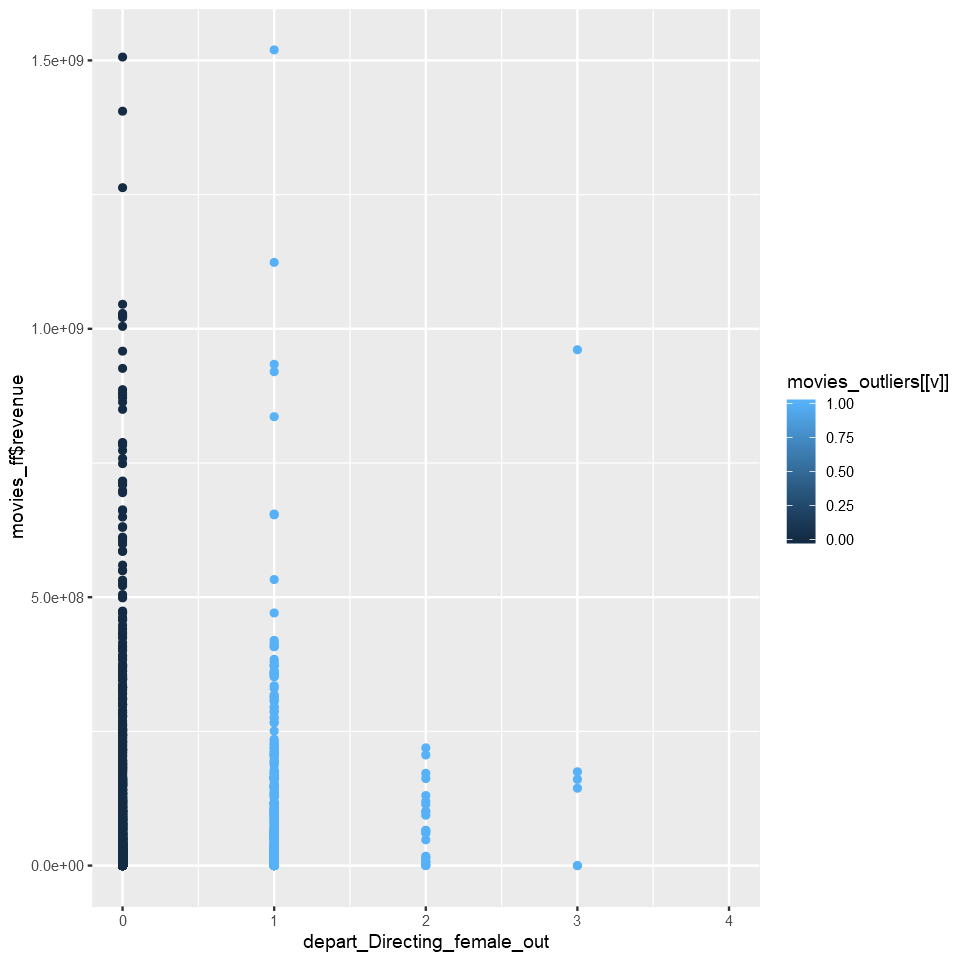

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


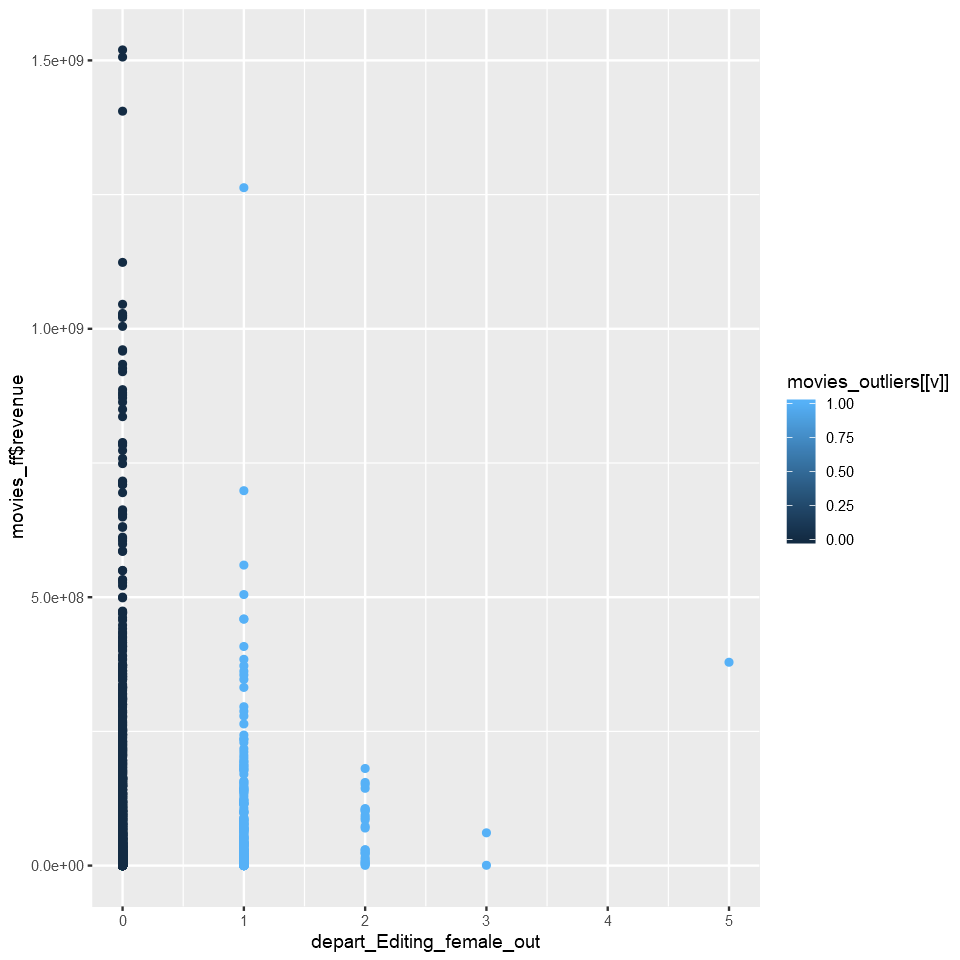

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


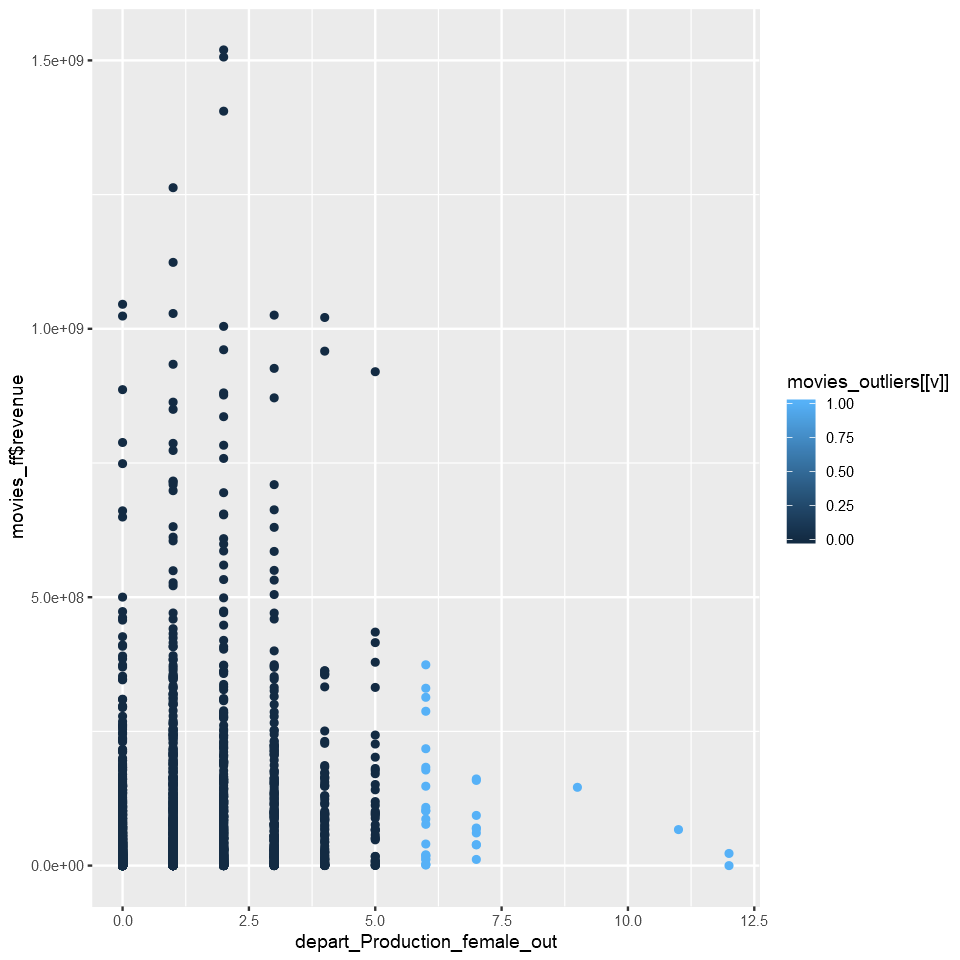

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


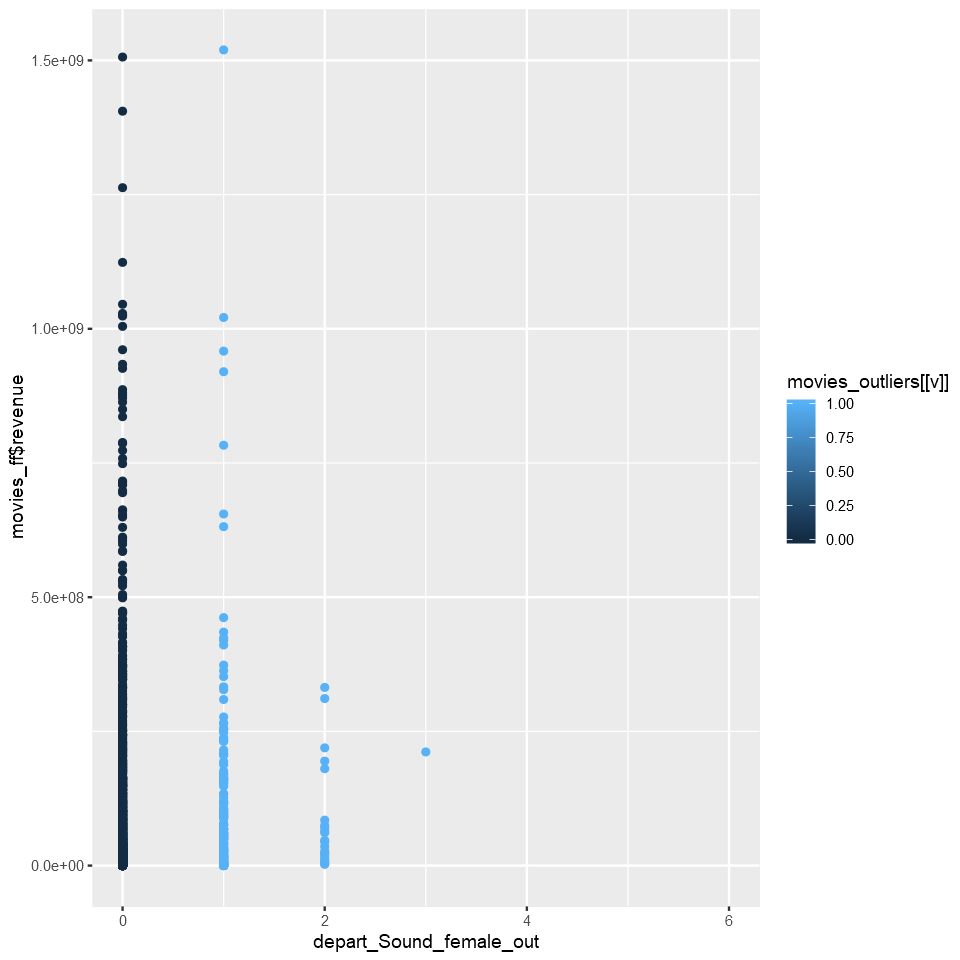

Warning message:
"Removed 4397 rows containing missing values (geom_point)."


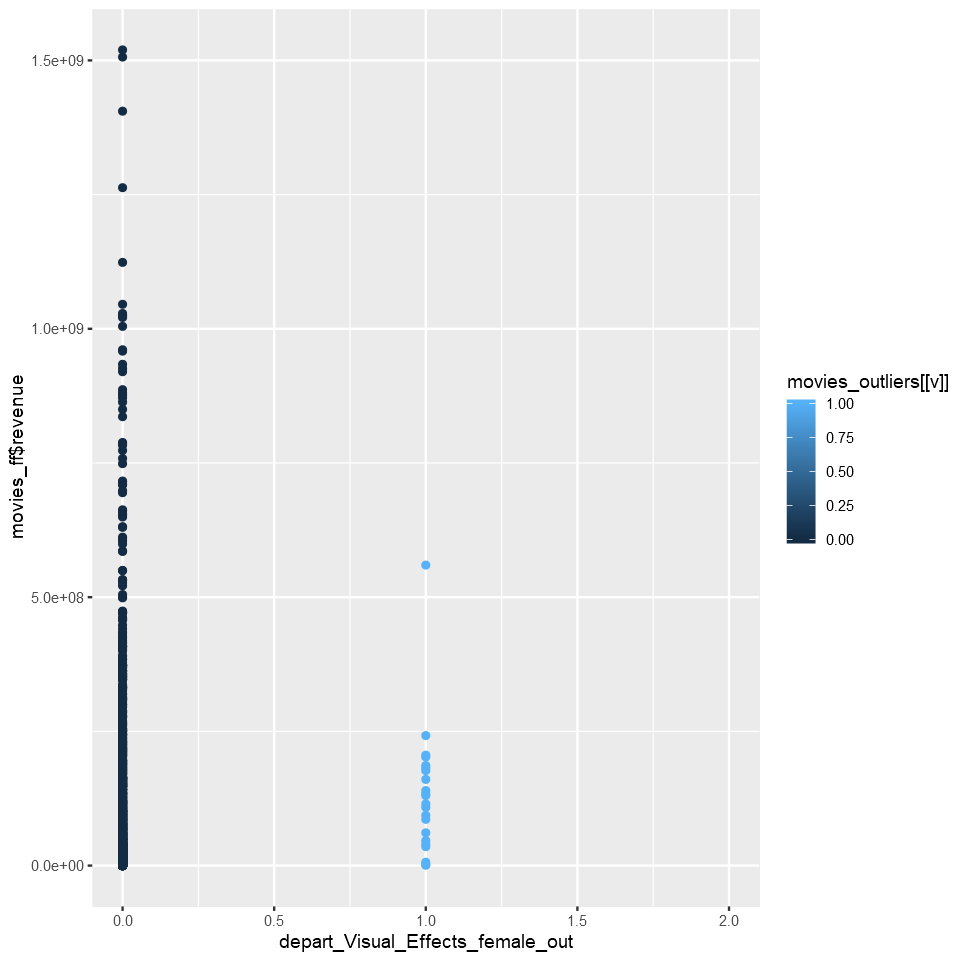

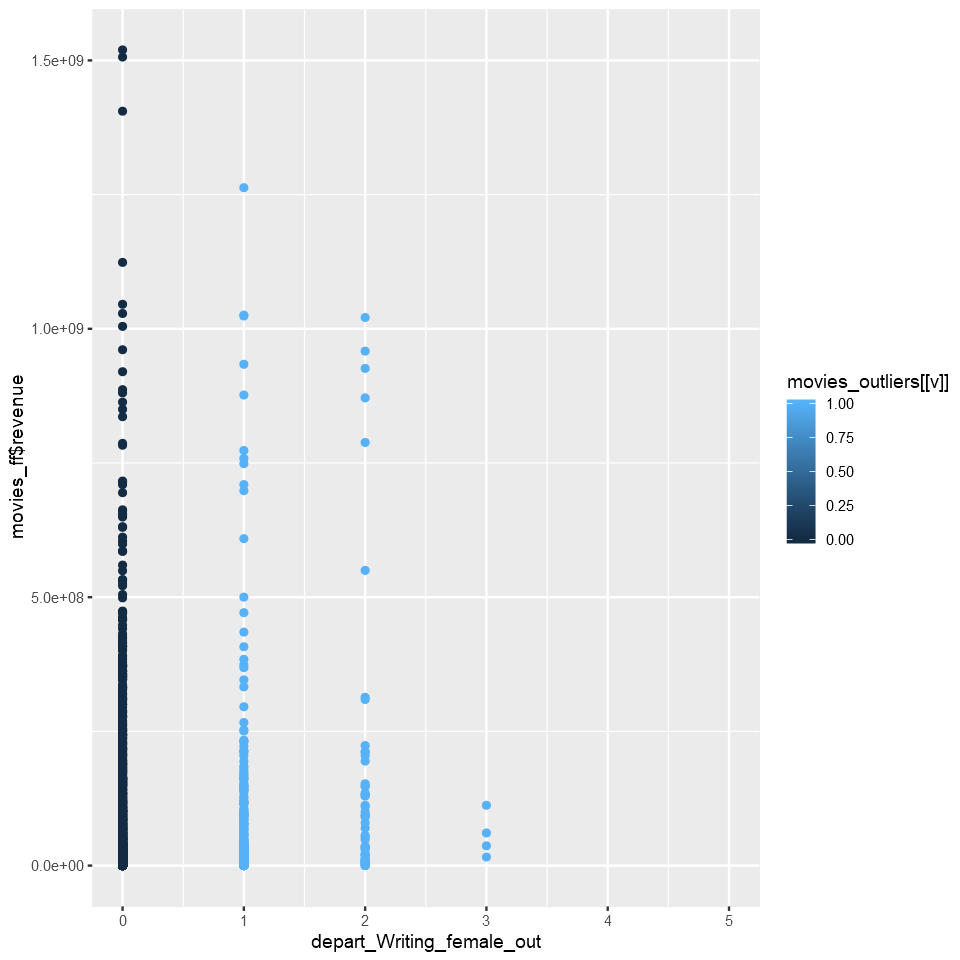

In [18]:

for (v in movies_continuous){
    print(ggplot (movies_ff,aes(x=movies_ff[[v]], y = movies_ff$revenue, group = movies_outliers[[v]],
                                color = movies_outliers[[v]])) + 
          geom_point() +
          xlab(paste(v,'out',sep='_')))
    options(repr.plot.width = 8, repr.plot.height = 8)
}

,movie_id,original_language,release_date,runtime_cat,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<dbl>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
13,13,en,1999-09-15,Large,122,15000000,20.726578,356296601,1,1,...,0,4,3,1,0,0,4,0,0,0
15,15,en,2002-06-20,Large,145,102000000,20.666063,358372926,1,0,...,0,1,1,1,0,0,4,0,0,0
31,31,fr,2011-11-02,Medium,112,13000000,16.086919,426480871,0,0,...,0,0,0,0,0,0,0,0,0,0
35,35,en,2007-08-08,Short,91,140000000,9.718111,258022233,1,0,...,0,0,1,0,0,0,0,0,0,0
38,38,en,1995-03-10,Large,127,50000000,13.676444,189859560,1,0,...,0,0,0,0,1,0,1,0,0,0
47,47,en,2006-03-23,Short,91,80000000,16.646029,660940780,1,1,...,0,0,0,0,0,0,0,0,0,0
58,58,en,1997-06-20,Large,125,125000000,17.038824,238207122,1,0,...,0,0,3,0,0,0,2,1,0,0
61,61,en,2006-11-14,Large,144,150000000,23.065078,599045960,1,1,...,0,0,1,0,0,0,2,0,0,0
91,91,en,2003-10-10,Medium,111,30000000,25.261865,180949000,1,1,...,0,0,3,0,2,0,5,0,0,1


Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


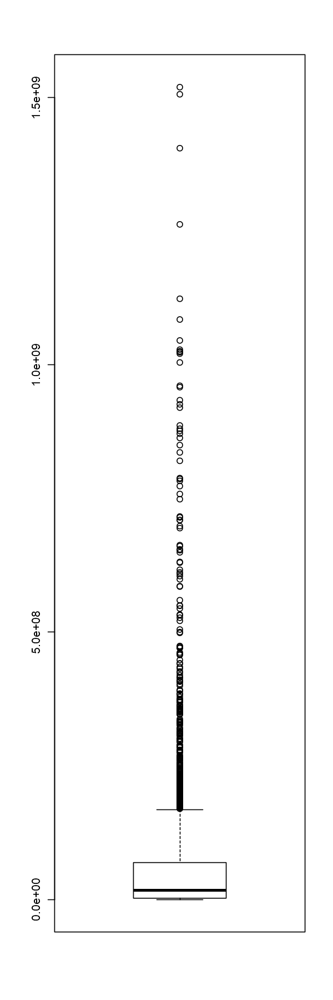

In [8]:
#Detecting lines with outilers
movies_ff[which(movies_ff$revenue %in% out_revenue$out),]
boxplot(movies_ff$revenue)

movie_id,original_language,release_date,runtime_cat,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<dbl>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,en,2015-02-20,Short,93,14000000,6.575393,12314651,1,0,...,0,0,0,0,0,0,0,0,0,0
2,en,2004-08-06,Medium,113,40000000,8.248895,95149435,1,0,...,0,0,0,0,0,0,3,0,0,1
3,en,2014-10-10,Medium,105,3300000,64.299990,13092000,1,1,...,0,1,0,0,0,0,2,0,0,0
4,hi,2012-03-09,Large,122,1200000,3.174936,16000000,0,1,...,0,0,0,0,0,0,0,0,0,0
5,ko,2009-02-05,Medium,118,0,1.148070,3923970,0,0,...,0,0,0,0,0,0,0,0,0,0
6,en,1987-08-06,Short,83,8000000,0.743274,3261638,1,0,...,0,0,0,0,0,0,0,0,0,0
7,en,2012-08-30,Short,92,14000000,7.286477,85446075,1,1,...,0,0,1,1,0,0,3,0,0,0
8,en,2004-01-15,Short,84,0,1.949044,2586511,1,0,...,0,0,0,1,0,0,0,0,0,0
9,en,1996-02-16,Medium,100,0,6.902423,34327391,1,0,...,0,0,0,0,0,0,0,0,0,0


Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"
Warning message in x[floor(d)] + x[ceiling(d)]:
"NAs produced by integer overflow"


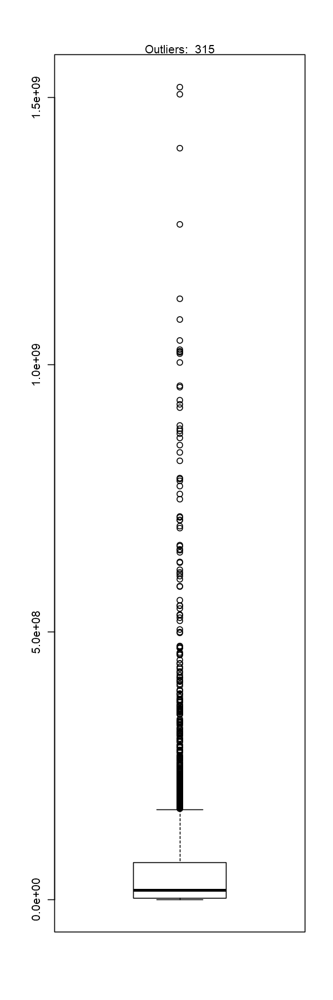

In [9]:
movies_ff_copy <- movies_ff
movies_ff_copy
boxplot(movies_ff_copy$revenue)
mtext(paste("Outliers: ", paste(length(boxplot(movies_ff_copy$revenue)$out)), collapse=", "), cex=1)

,movie_id,original_language,release_date,runtime_cat,runtime,budget,popularity,revenue,sw_lang_en,sw_web_presence,...,depart_Camera_female,depart_Crew_female,depart_Custom_Mkup_female,depart_Directing_female,depart_Editing_female,depart_Lighting_female,depart_Production_female,depart_Sound_female,depart_Visual_Effects_female,depart_Writing_female
,<int>,<chr>,<chr>,<chr>,<dbl>,<int>,<dbl>,<int>,<int>,<int>,...,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>,<int>
1,1,en,2015-02-20,Short,93,14000000,6.575393,12314651,1,0,...,0,0,0,0,0,0,0,0,0,0
2,2,en,2004-08-06,Medium,113,40000000,8.248895,95149435,1,0,...,0,0,0,0,0,0,3,0,0,1
3,3,en,2014-10-10,Medium,105,3300000,64.299990,13092000,1,1,...,0,1,0,0,0,0,2,0,0,0
4,4,hi,2012-03-09,Large,122,1200000,3.174936,16000000,0,1,...,0,0,0,0,0,0,0,0,0,0
5,5,ko,2009-02-05,Medium,118,0,1.148070,3923970,0,0,...,0,0,0,0,0,0,0,0,0,0
6,6,en,1987-08-06,Short,83,8000000,0.743274,3261638,1,0,...,0,0,0,0,0,0,0,0,0,0
7,7,en,2012-08-30,Short,92,14000000,7.286477,85446075,1,1,...,0,0,1,1,0,0,3,0,0,0
8,8,en,2004-01-15,Short,84,0,1.949044,2586511,1,0,...,0,0,0,1,0,0,0,0,0,0
9,9,en,1996-02-16,Medium,100,0,6.902423,34327391,1,0,...,0,0,0,0,0,0,0,0,0,0


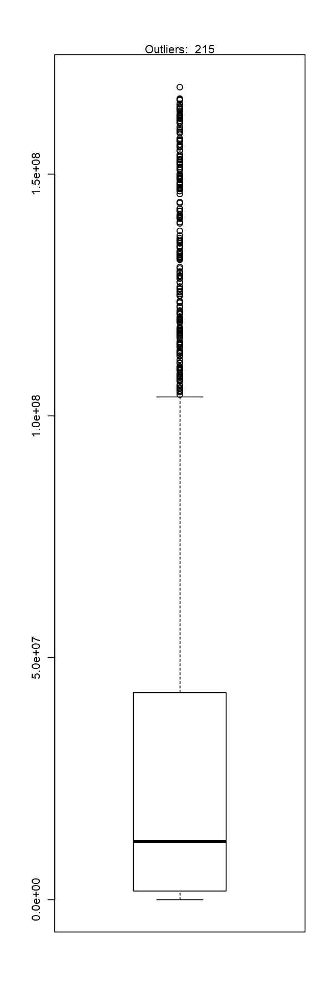

In [11]:
movies_ff_copy <- movies_ff[-which(movies_ff$revenue %in% out_revenue$out),]
movies_ff_copy
boxplot(movies_ff_copy$revenue)
mtext(paste("Outliers: ", paste(length(boxplot(movies_ff_copy$revenue)$out)), collapse=", "), cex=1)

Warning message:
"Continuous x aesthetic -- did you forget aes(group=...)?"
Warning message:
"Removed 4382 rows containing non-finite values (stat_boxplot)."


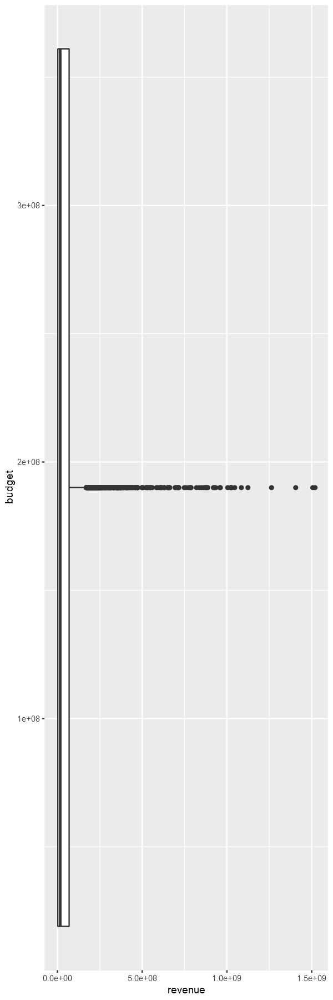

In [65]:
ggplot(movies_ff, aes(budget, revenue)) +
    geom_boxplot() +
    coord_flip()

In [ ]:
movies_ff_copy

 משתנים חסרים - ליצור מטריצת חסרים 
ליצור וקטור של שמות של עמודות עם משתנים רציפים ווקטור נוסף עם משתנים לא רציפים

In [59]:
help('remove_outliers')

In [11]:
vignette("ggplot2-specs")

starting httpd help server ...
 done



 גרף של חסרים שיוצר שני דנסיטי גרף ומשווה הרווח מול משתנים חסרים (1) או לא חסרים 0
geom_density(aes(x, hue = na, group=na))

In [29]:
dbDisconnect(con)

In [13]:
vn <- names(movies_ff[,2:84])
movies_continuous <- c('movie_id')
for(v in vn) {
        if((is.numeric(movies_ff[[v]])) & (max(movies_ff[[v]],na.rm=T)>1))
            {movies_continuous <- c(movies_continuous,v)}}
movies_continuous

[1] "movie_id"                     "runtime"                     
 [3] "budget"                       "popularity"                  
 [5] "revenue"                      "release_year"                
 [7] "release_month"                "release_day"                 
 [9] "seasonality"                  "sw_collection"               
[11] "producers_cnt"                "countries_cnt"               
[13] "keywords_cnt"                 "actor0_movies_cnt"           
[15] "actor0_movies_5y_cnt"         "actor1_movies_cnt"           
[17] "actor1_movies_5y_cnt"         "actor2_movies_cnt"           
[19] "actor2_movies_5y_cnt"         "actor0_prev_revenue"         
[21] "actor1_prev_revenue"          "actor2_prev_revenue"         
[23] "director_movies_cnt"          "director_movies_5y_cnt"      
[25] "depart_Art"                   "depart_Camera"               
[27] "depart_Crew"                  "depart_Custom_Mkup"          
[29] "depart_Directing"             "depart_Editing"              
[31] "depart_Lighting"              "depart_Production"           
[33] "depart_Sound"                 "depart_Visual_Effects"       
[35] "depart_Writing"               "depart_Art_female"           
[37] "depart_Camera_female"         "depart_Crew_female"          
[39] "depart_Custom_Mkup_female"    "depart_Directing_female"     
[41] "depart_Editing_female"        "depart_Production_female"    
[43] "depart_Sound_female"          "depart_Visual_Effects_female"
[45] "depart_Writing_female"

In [14]:
movies_categorial <- movies_ff[,c(2,4,9:12,15,18,21:25,33:38,43:62)]
len(names(movies_categorial))

ERROR: Error in len(names(movies_categorial)): could not find function "len"
